# RaceID3 on WD data

Here we perform the RaceID + StemID analysis on the Wolfgang Driever zebrafish data, using the pre-processed count matrix constructed in the [previous stage](0_contamination_qc.ipynb).

#### Load libs and data

In [1]:
source_matrix <- readRDS("source/cleaned_matrix.rds")
data.frame(dim(source_matrix), row.names=c("features","cells"))

,dim.source_matrix.
features,11237
cells,768


In [2]:
suppressPackageStartupMessages(source("source/RaceID3_StemID2_class.R"))

In [3]:
sc <- SCseq(data.frame(source_matrix))

In [4]:
data.frame(dim(sc@fdata), row.names=c("features","cells"))

,dim.sc.fdata.
features,11237
cells,768


## Initial Preview

Let's have a quick look at the data and see if we can derive any filtering thresholds

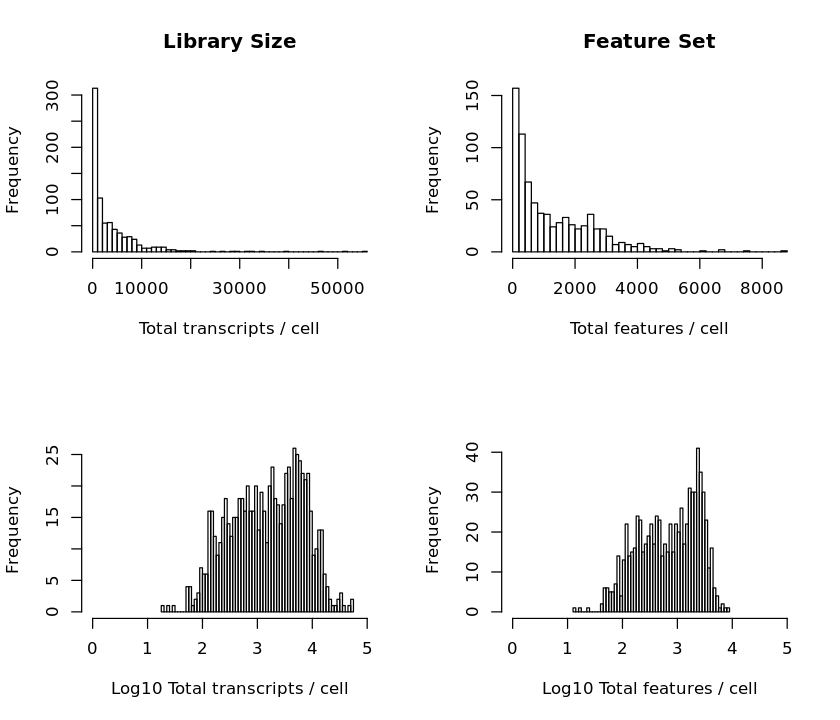

In [5]:
options(repr.plot.height = 6)
par(mfrow=c(2,2))
hist(colSums(sc@expdata), breaks = 50, main = "Library Size", xlab = "Total transcripts / cell")
hist(colSums(sc@expdata > 0), breaks = 50, main = "Feature Set", xlab = "Total features / cell")
hist(log10(colSums(sc@expdata)), breaks = 50, main = "", xlab = "Log10 Total transcripts / cell", xlim=c(0,5))
hist(log10(colSums(sc@expdata > 0)), breaks = 50, main = "", xlab = "Log10 Total features / cell", xlim=c(0,5))

A good range of 100 - 10,00 transcripts per cell, and a similar range of features per cell too.

# Filtering

Due to the good assurance that the protocol does not produce cell doublets, we do not need to set an upperbound threshold on how many transcripts a cell can have.

The main issue is defining a suitable lower-bound threshold to remove low-quality cells, whilst still retaining most of our cells. Another factor is determining the level of detectability for a feature; the minimum number of transcripts for a gene to be expressed in a particular cell for that cell to be said to express that gene (e.g. a level of > 10 transcripts, would ignore any cells with 10 or less transcripts for that gene).

We can also define detectability further, by defining a minimum number of cells that the feature must exist within:  
 
 * A gene must have > 10 hits across > 3 cells, with a hit being any count > 2 

In the interests of not overfiltering (i.e. retaining rare cells where a rare gene is highly expressed), and not needlessly complicating the analysis, we will assume:

 * A gene must have > X hits across >= 1 cell, with a hit being any count > Y


Here we will test several thresholds of X and Y and see if we can determine a nice balance between cell-quality and the number of remaining cells.

## Filtering Thresholds

In [6]:
# Attempt different filtering levels

sc_matrices <- list()
sc_metrics <- list()

range_mintotal <- c(10,seq(100,1000,100),seq(1500,5000,500))
range_minexprn <- c(1,2,5,10,20)
#range_mintotal <- c(10,1000)
#range_minexprn <- c(1,5)

tuples <- expand.grid(range_mintotal,range_minexprn)

res <- lapply(1:dim(tuples)[1], FUN=function(index){
    
    dat <- tuples[index,]
    mintotal <- tuples[index,1]
    minexprn <- tuples[index,2]
    
    key <- paste(minexprn, mintotal, sep="_")
    #print(key)
    
    mat <- filterdata(
        sc,
        mintotal = mintotal,
        minexpr  = minexprn,
        maxexpr  = Inf,
        # defaults
        downsample = F, sfn = F, hkn = F,
        dsn = 1, rseed = 17000, CGenes = NULL, FGenes = NULL
    )

    sc_matrices[[key]] <<- mat
    sc_metrics[[key]] <<- dim(mat@fdata)
})


In [7]:
df <- t(data.frame(sc_metrics))
df <- cbind(df, as.integer(100 * df[,c(1)] / length(rownames(sc@expdata))))  # Gene %
df <- cbind(df, as.integer(100 * df[,c(2)] / length(colnames(sc@expdata))))  # Cell %

df <- cbind(as.integer(sub("X(\\d+)_(\\d+)", "\\2", rownames(df))), df)
df <- cbind(as.integer(sub("X(\\d+)_(\\d+)", "\\1", rownames(df))), df)

colnames(df) <- c("MinExp", "MinTotal", "Genes", "Cells", "Genes(%)", "Cells(%)")
rownames(df) <- NULL

#t(df) #[df[,c("Genes(%)")]])
#(df[df[,c("Cells(%)")] > 60 & df[,c("Genes")] > 200,])
t(df)



MinExp,1,1,1,1,1,1,1,1,1,1,⋯,20,20,20,20,20,20,20,20,20,20
MinTotal,10,100,200,300,400,500,600,700,800,900,⋯,900,1000,1500,2000,2500,3000,3500,4000,4500,5000
Genes,37,802,1948,2926,3871,4431,5556,5349,5865,6630,⋯,46,54,83,110,139,152,191,231,280,288
Cells,768,744,679,627,592,562,533,509,490,474,⋯,474,455,401,352,318,297,269,241,223,198
Genes(%),0,7,17,26,34,39,49,47,52,59,⋯,0,0,0,0,1,1,1,2,2,2
Cells(%),100,96,88,81,77,73,69,66,63,61,⋯,61,59,52,45,41,38,35,31,29,25


Warning message:
“Transformation introduced infinite values in continuous x-axis”

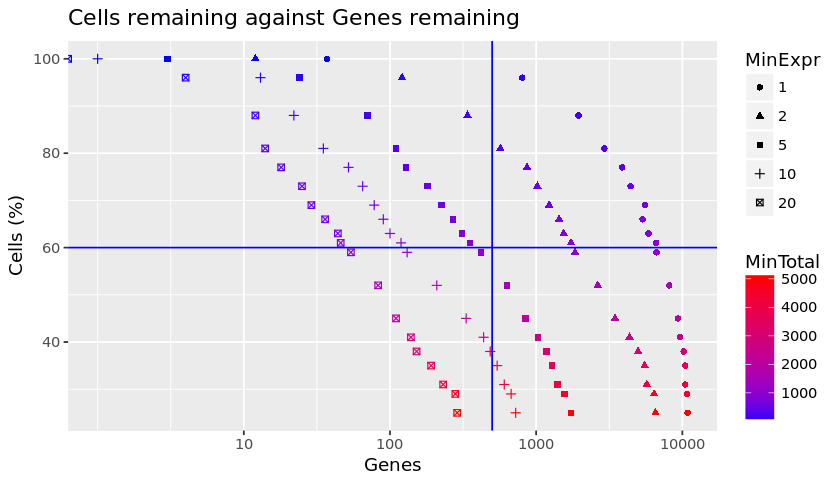

In [13]:
# Let's visualise the above

suppressPackageStartupMessages(library(ggplot2))
options(repr.plot.height = 4)

ggplot(data = data.frame(df), aes(
    x = df[,c("Genes")],
    y = df[,c("Cells(%)")]
)) + geom_point(aes(
    shape = factor(df[,c("MinExp")]),
    color = df[,c("MinTotal")]
)) + scale_colour_gradient(
    low="blue",
    high="red"
) + ggtitle("Cells remaining against Genes remaining") + labs(
    x = "Genes",
    y = "Cells (%)",
    shape = "MinExpr",
    colour = "MinTotal"
) + scale_x_continuous(
    trans='log10',
    breaks=c(10,100,1000,10000)
) + geom_vline(xintercept=500, col="blue") + geom_hline(yintercept=60, col="blue")

From the above chart we can see that the colour gradient is more vertical than horizontal, indicating that an increasing Mintotal threshold affects the number of cells more than the number of genes.

We can also see the distinct trends of the effect that the MinExpr threshold has, which is stratified horizontally Gene-wise, and shows that expression limits of 20 ([X]), 10( + ) are unacceptable limits if we wish to retain  a good portion of our cells and genes in our analysis matrix.

Blue lines are added to indicate where our ideal threshold should be:

 * Assuming a cell retention limit of **60%** is imposed and a minimum starting set of **500 genes** to analyse, we can see  that we must use a MinTotal range between 10-1000 and MinExpr of 1 or 2.

In [14]:
t(df[df[,c("Cells(%)")] >= 60 & df[,c("Genes")] > 500, !(colnames(df) %in% c("Genes(%)"))])

MinExp,1,1,1,1,1,1,1,1,1,2,2,2,2,2,2,2
MinTotal,100,200,300,400,500,600,700,800,900,300,400,500,600,700,800,900
Genes,802,1948,2926,3871,4431,5556,5349,5865,6630,569,865,1019,1226,1434,1542,1732
Cells,744,679,627,592,562,533,509,490,474,627,592,562,533,509,490,474
Cells(%),96,88,81,77,73,69,66,63,61,81,77,73,69,66,63,61


At the far right we can see that we can retain 61% of our cells (474) and still retain 1735 genes for analysis, for thresholds of MinExp=2 and MinTotal=900

We will proceed with these parameters for the rest of the analysis.

# Analysis


### Methods 

In [152]:
suppressPackageStartupMessages(library(scater))
suppressPackageStartupMessages(require(biomaRt))

options(repr.plot.height = 5)

# @filter_truth: mintotal
# @minex : mininum expression

allForOne <- function(sc, filter_truth, minex, 
                      clna=NULL, semeth="Tibs2001SEmax", discover_cc = T,
                     fgenes=NULL, cgenes=NULL, docc=T)
{
    new_sc <- filterdata(
        sc,
        mintotal = filter_truth,
        minexpr  = minex,
        maxexpr  = Inf,
        # defaults
        downsample = F, sfn = F, hkn = F,
        dsn = 1, rseed = 17000, CGenes = cgenes, FGenes = fgenes
    )

    mart <- useMart(biomart = "ENSEMBL_MART_ENSEMBL", dataset = "drerio_gene_ensembl")

    k <- getBM(
        filters = "ensembl_gene_id",
        attributes = c("ensembl_gene_id", "external_gene_name", "name_1006"),
        values = rownames(new_sc@fdata),
        mart = mart
    )
    
    sce <- SingleCellExperiment(assays=list(counts = as.matrix(new_sc@fdata)))
    sce <- calculateQCMetrics(sce)

    options(repr.plot.height = 5)
    par(mfrow=c(1,2))
    hist(sce$total_counts, breaks = 50, main = "Library Size")

    # - Feature set is empty because all cells have the same number of genes (1247)
    #hist(colSums(counts(sce) > 0), breaks = 100, main = "Feature Set")
    #unique(colSums(counts(sce) > 0))

    print(plotQC(sce, type = "high"))

    if (docc){
        if (discover_cc){
            ccg <- unique(k[k$name_1006 == "cell cycle",]$mgi_symbol)
            cpg <- unique(k[k$name_1006 == "cell proliferation",]$mgi_symbol)
            vset <- unique(c(ccg,cpg))
        } else {
            custom_cGenes = c("Malat1", "Lars2", "Mki67", "Pcna-ps2")
            custom_sGenes = c("Hsp90aa1", "Jun", "Fos")
            vset <- c(custom_cGenes, custom_sGenes)
        }    

        length(vset)

        x <- CCcorrect(
            new_sc@fdata, vset=vset, CGenes=NULL, ccor=.4, nComp=NULL, pvalue=.05, quant=.01, mode="pca"
        )
    
        new_sc@fdata <- x$xcor
    }

    batch_vars <- data.frame(
        row.names = names(new_sc@fdata), batch = sub("P\\d+_B([0-9]+)_.*", "\\1", names(new_sc@fdata))
    )
    
    new_sc@fdata <- varRegression(new_sc@fdata, batch_vars)

    if (is.null(clna)){
        zzz <- capture.output(new_sc <- clustexp(new_sc, do.gap = T))
    } else {
        zzz <- capture.output(new_sc <- clustexp(new_sc, cln = clna, SE.method = semeth))
    }

    rbind(new_sc@clusterpar)
    
    par(mfrow=c(2,2), mar=c(0,0,0,0))
    plotsaturation(new_sc,disp=F)
    if (is.null(clna)){
        plotgap(new_sc)
    }
    plotjaccard(new_sc)
    plotsilhouette(new_sc)
    
    new_sc <- comptsne(new_sc)    
    new_sc <- findoutliers(new_sc)
    new_sc <- rfcorrect(new_sc)
    cdiff <- clustdiffgenes(new_sc, pvalue = .01)
    
    x <- clustheatmap(new_sc, final=T, hmethod="single")
    
    plottsne(new_sc, final=F)
    plottsne(new_sc, final=T)
    
    attributes(new_sc)$sce_obj <- sce
    attributes(new_sc)$kmart <- k
    attributes(new_sc)$cdiffer <- cdiff
    
    return(new_sc)
}


## Main

### Mintotal = 900, MinExp = 2

sigma summary: Min. : 0.139351227188837 |1st Qu. : 0.181548417322462 |Median : 0.203917974338022 |Mean : 0.214452856470275 |3rd Qu. : 0.238502160850084 |Max. : 0.385185014908282 |
Epoch: Iteration #100 error is: 0.818352256606646
Epoch: Iteration #200 error is: 0.806724358796911
Epoch: Iteration #300 error is: 0.802029813298943
Epoch: Iteration #400 error is: 0.799739010010223
Epoch: Iteration #500 error is: 0.799515836395115
Epoch: Iteration #600 error is: 0.79945264955739
Epoch: Iteration #700 error is: 0.799431773062439
Epoch: Iteration #800 error is: 0.799423984307185
Epoch: Iteration #900 error is: 0.799420931308398
Epoch: Iteration #1000 error is: 0.799419671995423


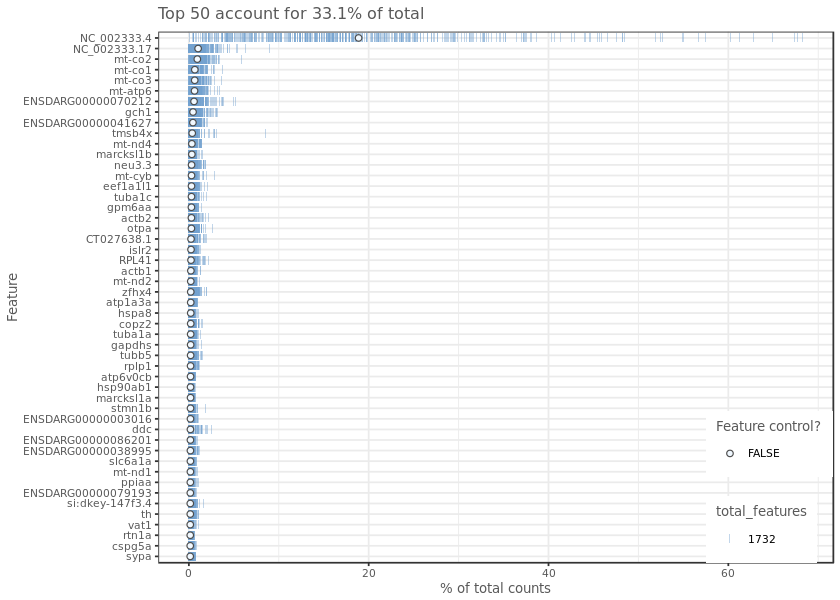

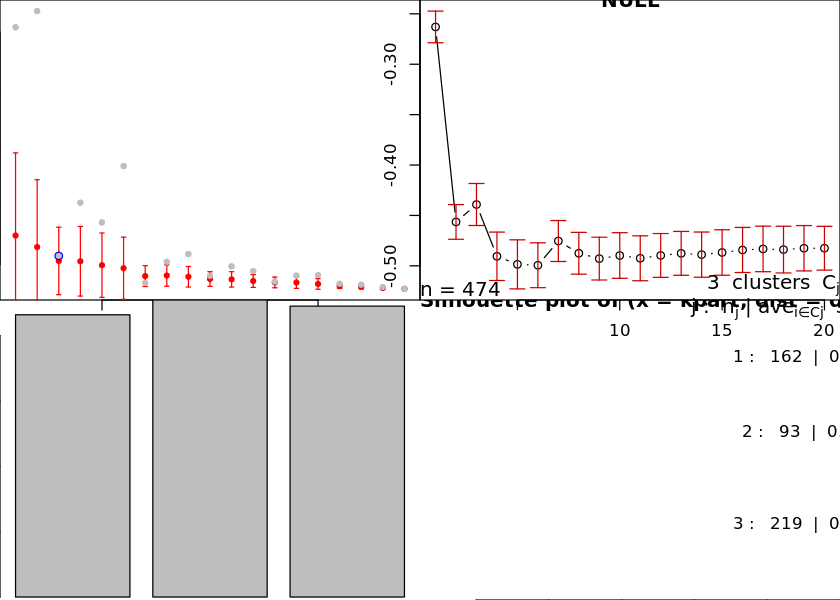

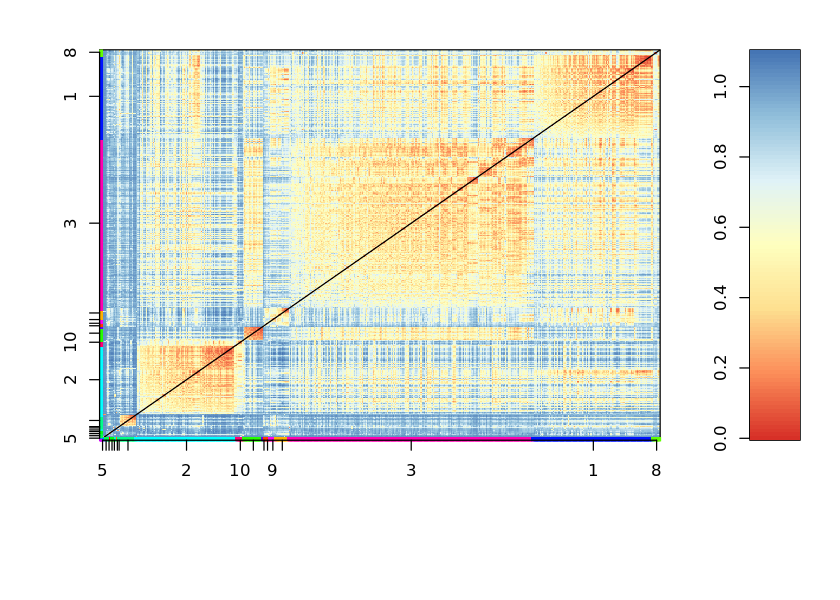

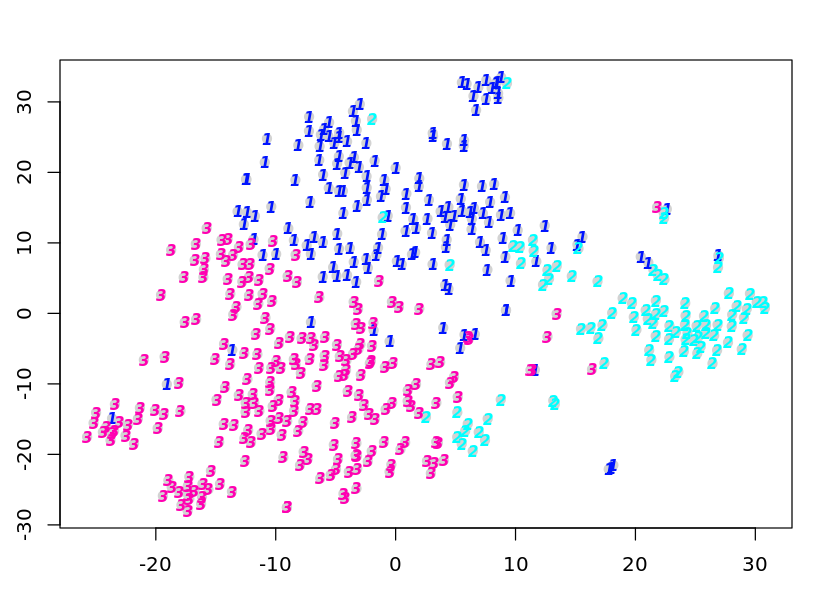

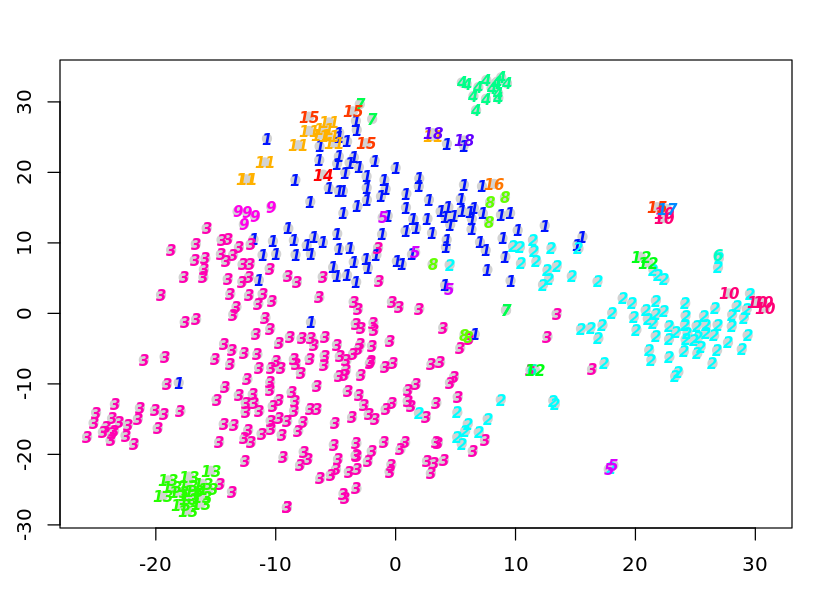

In [22]:
sc_2_900_dogap <- allForOne(sc, 900, 2, clna=NULL, semeth="Tibs2001SEmax", discover_cc = F)

It appears that we have one transcript with an extremely high level of expression in all cells.
 * [NC_002333.4](https://www.ensembl.org/Danio_rerio/Gene/Summary?db=core;g=ENSDARG00000080337;r=MT:2043-3725;t=ENSDART00000117596) mitochondrial gene, nothing shown about it.
 
 Let us do an expression plot of the top 2 most DE genes and see if they cluster anywhere.

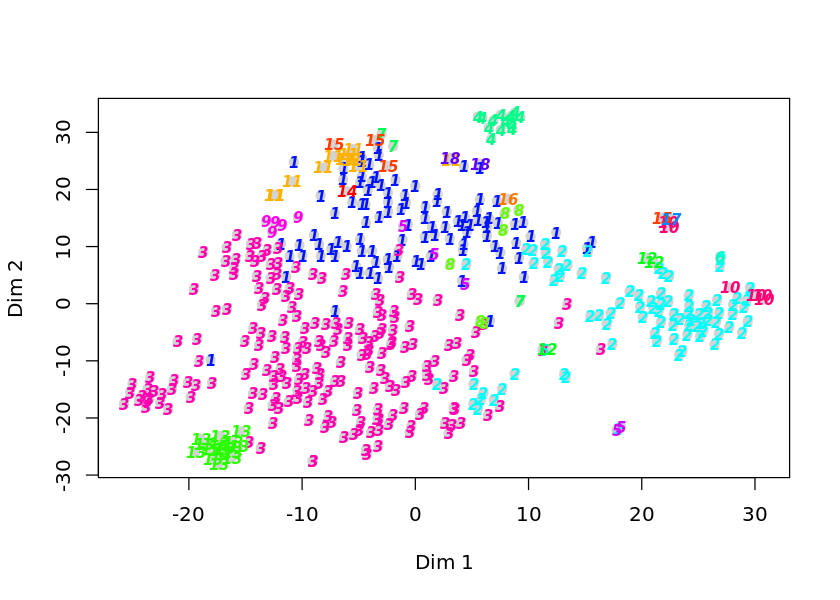

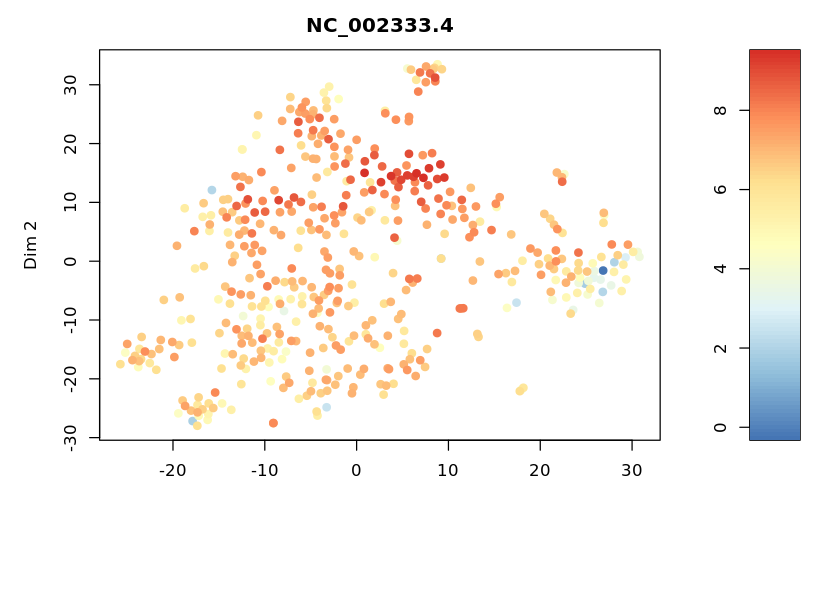

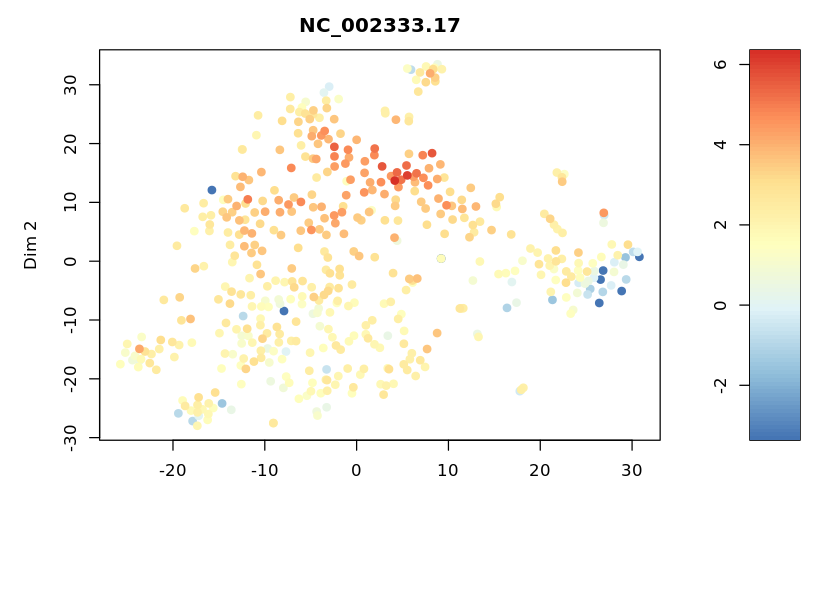

In [25]:
plottsne(sc_2_900_dogap)
plotexptsne(sc_2_900_dogap, "NC_002333.4", logsc=T)
plotexptsne(sc_2_900_dogap, "NC_002333.17", logsc=T)


NC_002333.4 appears to be expressed everywhere, with the highest concentration at cluster 1. But is too prevalent to be a rare transcript or a cell marker. We will remove this from the analysis (not correlated genes, just this gene) and repeat

### Without NC_002333.4

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924037915334
Epoch: Iteration #200 error is: 0.813208051320676
Epoch: Iteration #300 error is: 0.807802176613029
Epoch: Iteration #400 error is: 0.806775597176864
Epoch: Iteration #500 error is: 0.805200689156289
Epoch: Iteration #600 error is: 0.805131273348226
Epoch: Iteration #700 error is: 0.80511103067897
Epoch: Iteration #800 error is: 0.805104515063503
Epoch: Iteration #900 error is: 0.805102205284546
Epoch: Iteration #1000 error is: 0.805101357200888


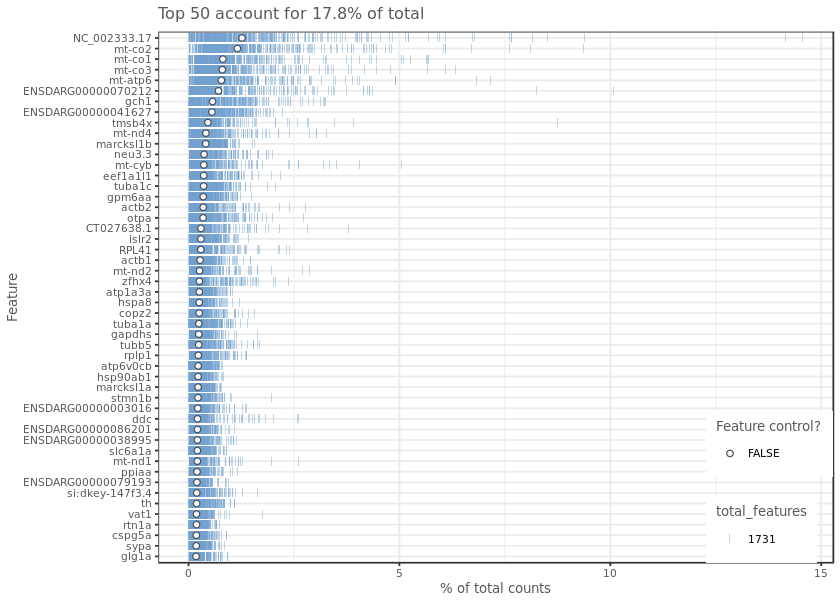

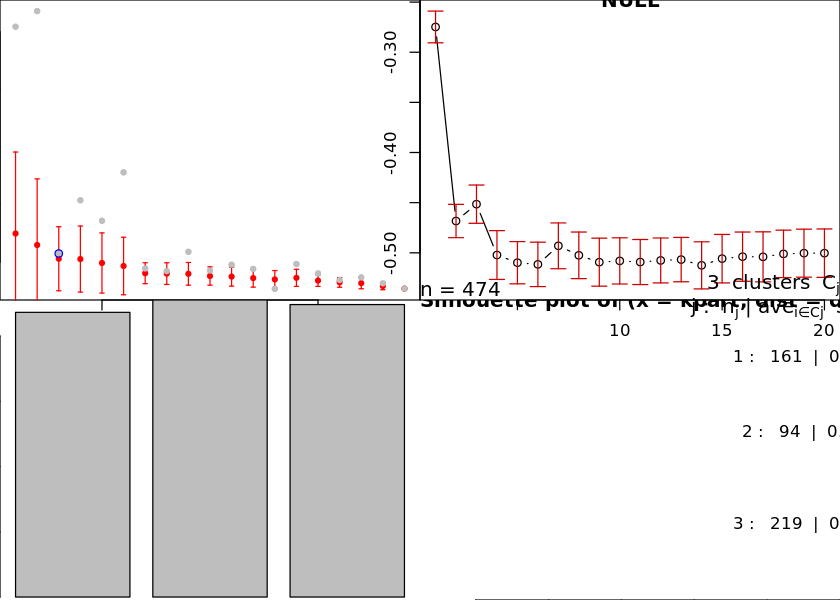

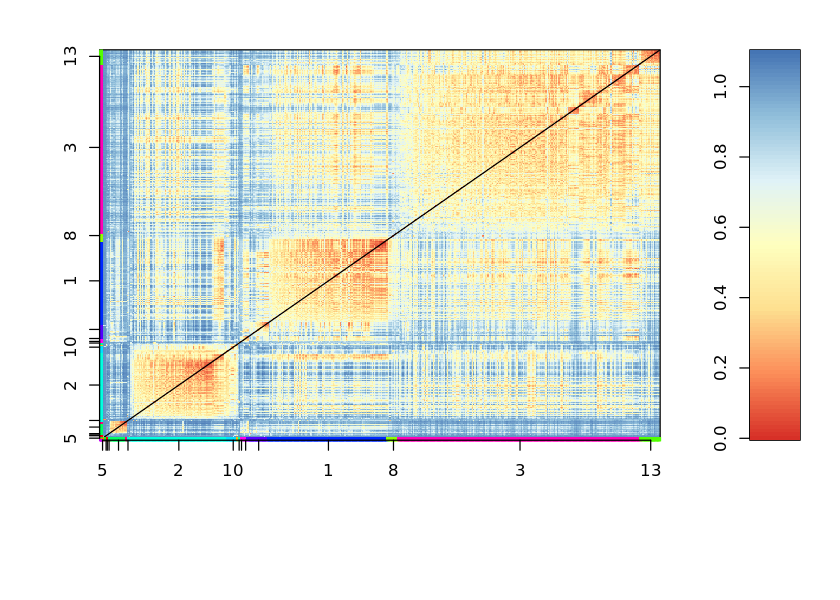

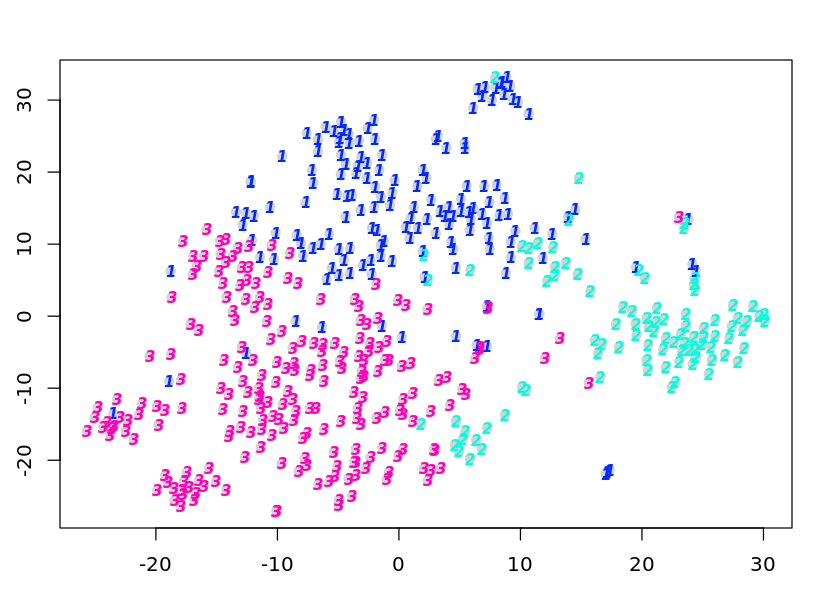

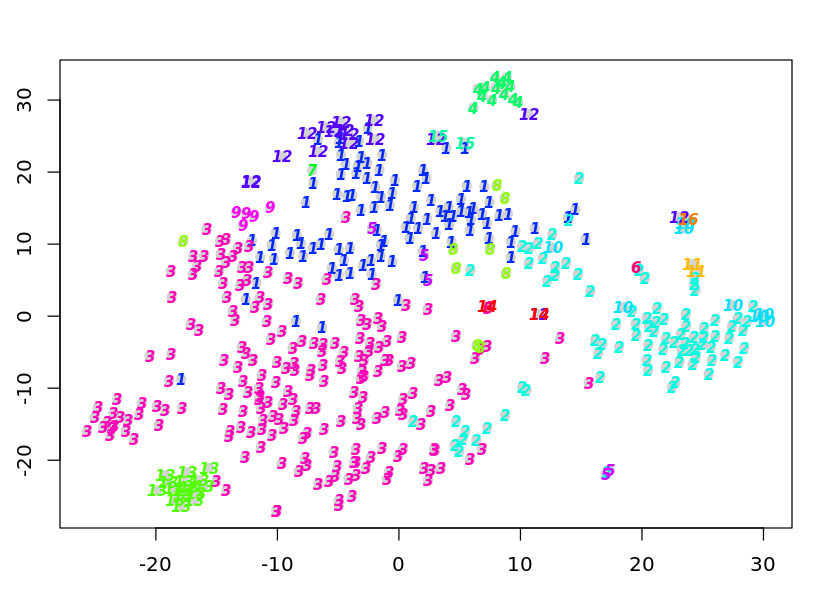

In [31]:
sc_2_900_dogap_fgenes <- allForOne(sc, 900, 2, clna=NULL, 
                            semeth="Tibs2001SEmax", discover_cc = F, fgenes = "NC_002333.4")

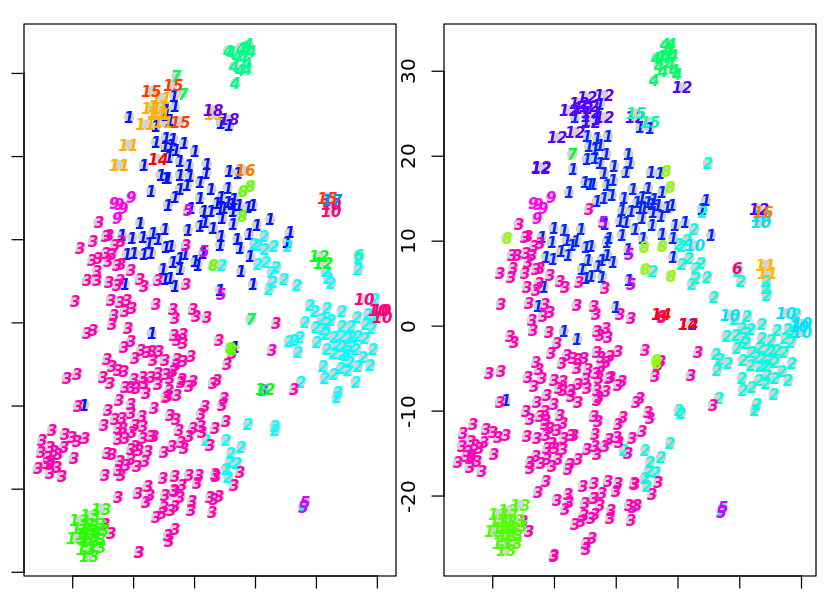

In [33]:
par(mfrow=c(1,2),mar=c(1,1,1,1))
plottsne(sc_2_900_dogap)
plottsne(sc_2_900_dogap_fgenes)

Very little change in final clustering. Let us repeat, the analysis, but discarding significantly correlated genes too.

### Without NC_002333.4 + correlated

Warning message in summary.lm(fit):
“essentially perfect fit: summary may be unreliable”Warning message in summary.lm(fit):
“essentially perfect fit: summary may be unreliable”Warning message in summary.lm(fit):
“essentially perfect fit: summary may be unreliable”sigma summary: Min. : 0.117061506944902 |1st Qu. : 0.189822734871496 |Median : 0.208848638602281 |Mean : 0.222053004621267 |3rd Qu. : 0.241257947650746 |Max. : 0.39265743443911 |
Epoch: Iteration #100 error is: 0.816566603359444
Epoch: Iteration #200 error is: 0.802878014801532
Epoch: Iteration #300 error is: 0.794762054393511
Epoch: Iteration #400 error is: 0.790515204632311
Epoch: Iteration #500 error is: 0.789626810970113
Epoch: Iteration #600 error is: 0.789451092299562
Epoch: Iteration #700 error is: 0.789420194686048
Epoch: Iteration #800 error is: 0.789350665606111
Epoch: Iteration #900 error is: 0.789347239299711
Epoch: Iteration #1000 error is: 0.78934621079088


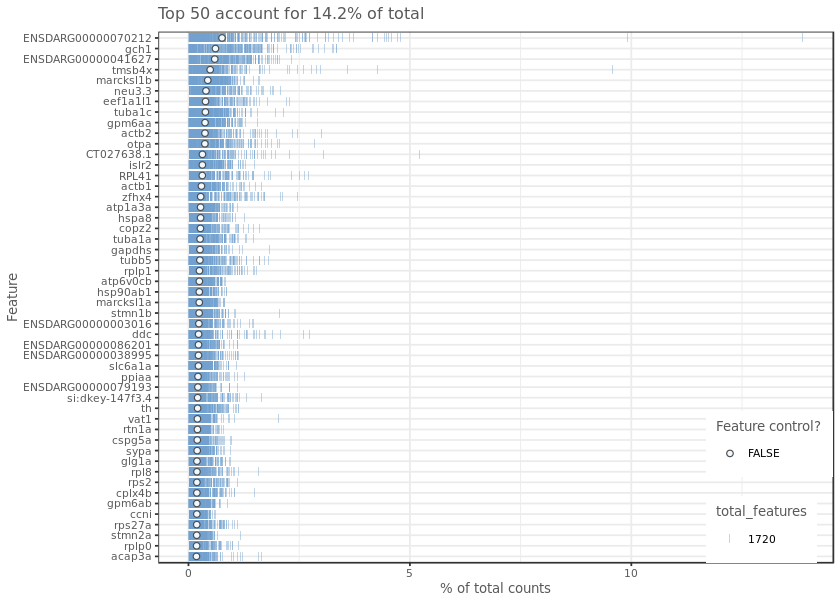

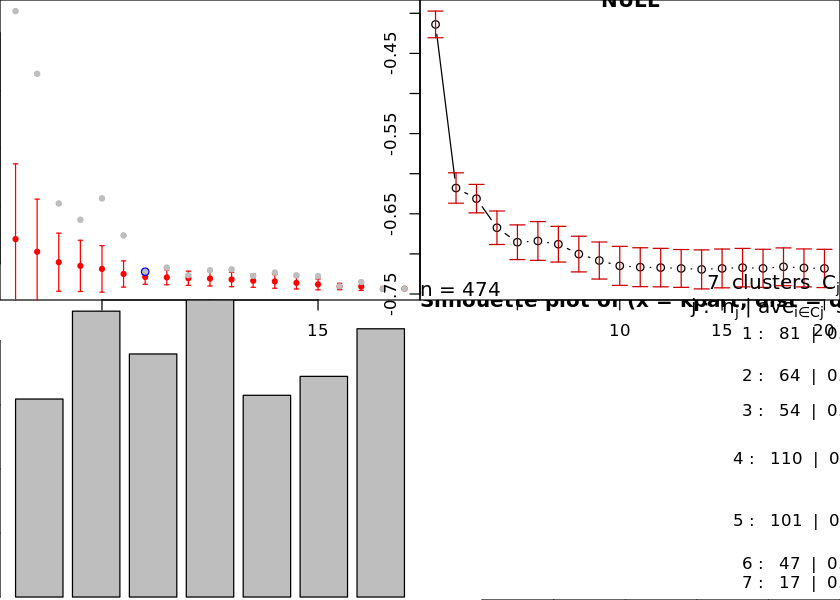

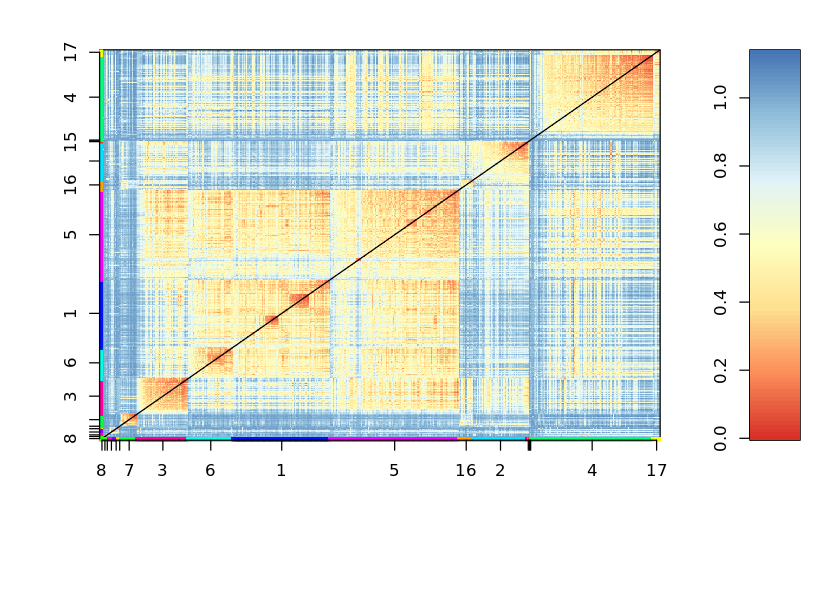

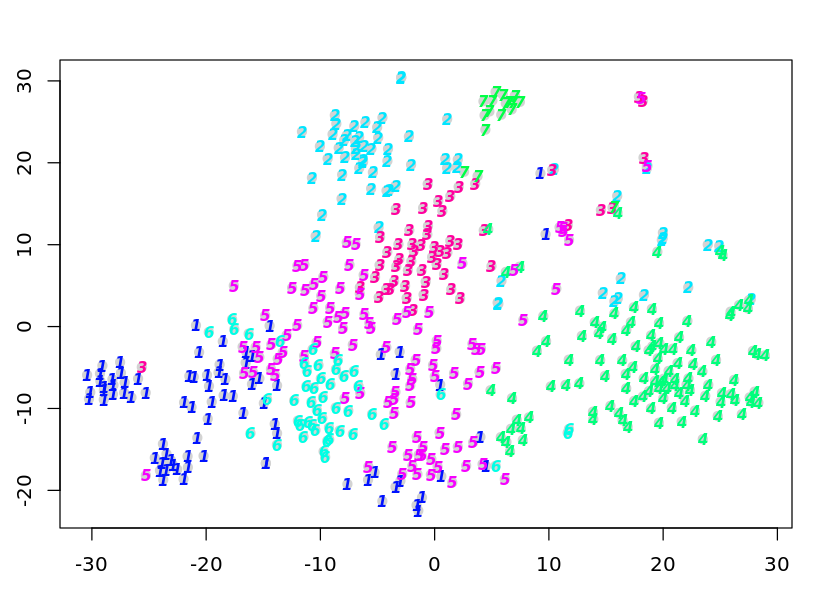

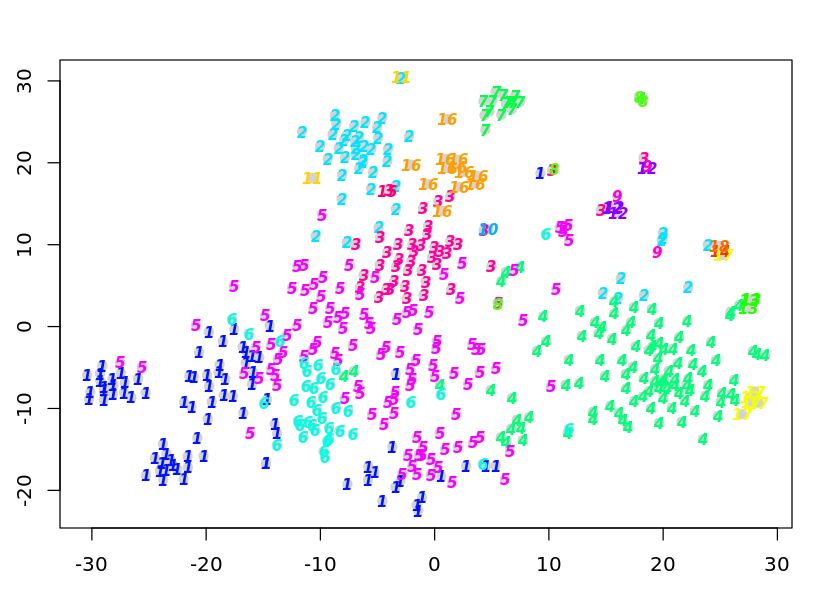

In [35]:
sc_2_900_dogap_cgenes <- allForOne(sc, 900, 2, clna=NULL, 
                            semeth="Tibs2001SEmax", discover_cc = F, cgenes = "NC_002333.4")

Clustering is clearly worse. (DE from 17.8 → 14.2 %)  
Very noisy (esp clust5), and we have lost our distinct cluster in the bottom left.

Instead of removing correlated genes, let us remove all "NC_" transcripts, and any mitochondrial genes.

### Without NC_* + Mito

[1] "mt-nd1"       "mt-nd2"       "mt-co1"       "mt-co2"       "mt-atp8"     
 [6] "mt-atp6"      "mt-co3"       "mt-nd3"       "mt-nd4l"      "mt-nd4"      
[11] "mt-nd5"       "mt-nd6"       "mt-cyb"       "NC_002333.4"  "NC_002333.9" 
[16] "NC_002333.17"

sigma summary: Min. : 0.116264133783216 |1st Qu. : 0.188725611483298 |Median : 0.208629050520617 |Mean : 0.221782079052939 |3rd Qu. : 0.241665779937643 |Max. : 0.392682378473095 |
Epoch: Iteration #100 error is: 0.813854981944931
Epoch: Iteration #200 error is: 0.803500700221418
Epoch: Iteration #300 error is: 0.795215000890186
Epoch: Iteration #400 error is: 0.791789592503903
Epoch: Iteration #500 error is: 0.790921410193515
Epoch: Iteration #600 error is: 0.790773102241792
Epoch: Iteration #700 error is: 0.790741064715498
Epoch: Iteration #800 error is: 0.790729638635012
Epoch: Iteration #900 error is: 0.790725254777611
Epoch: Iteration #1000 error is: 0.790723153441969


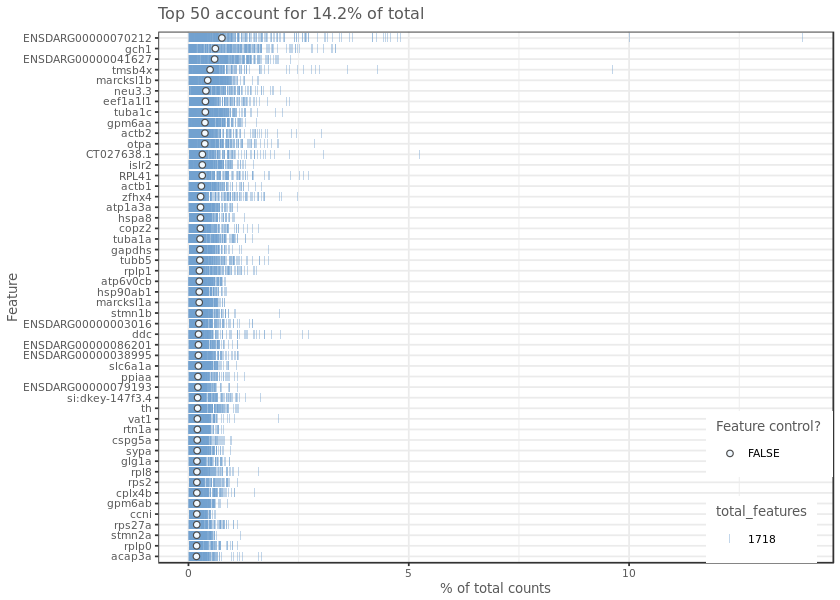

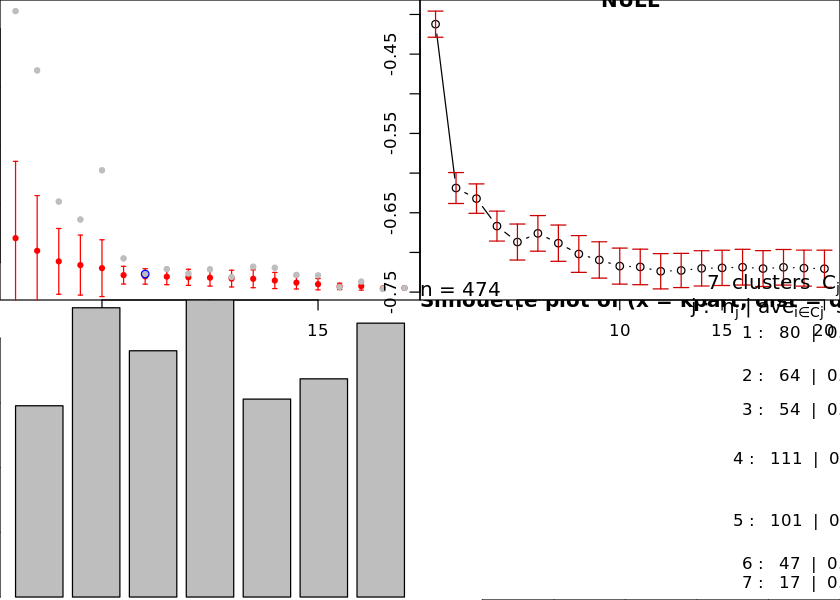

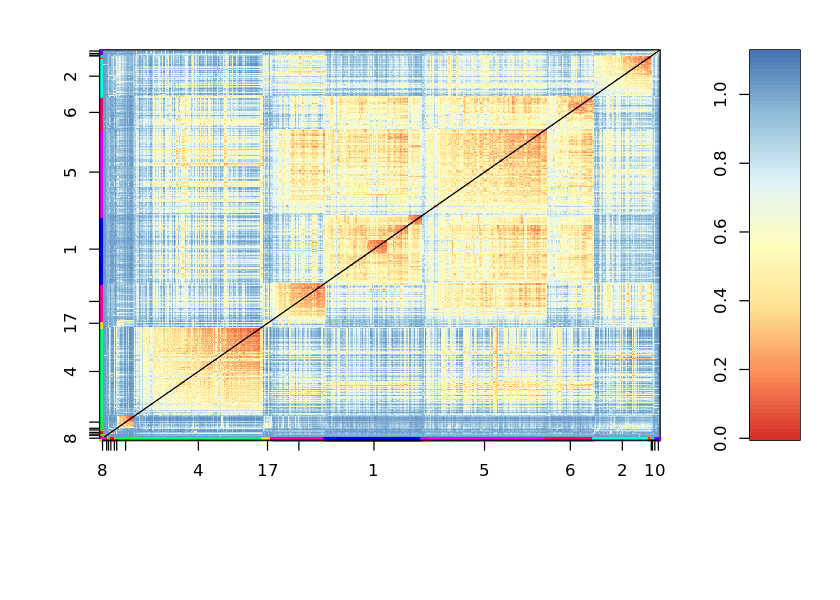

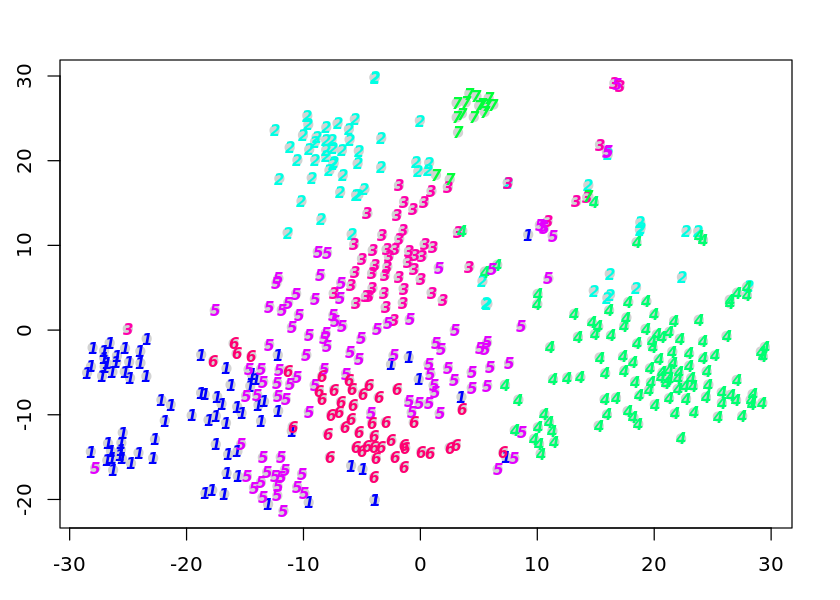

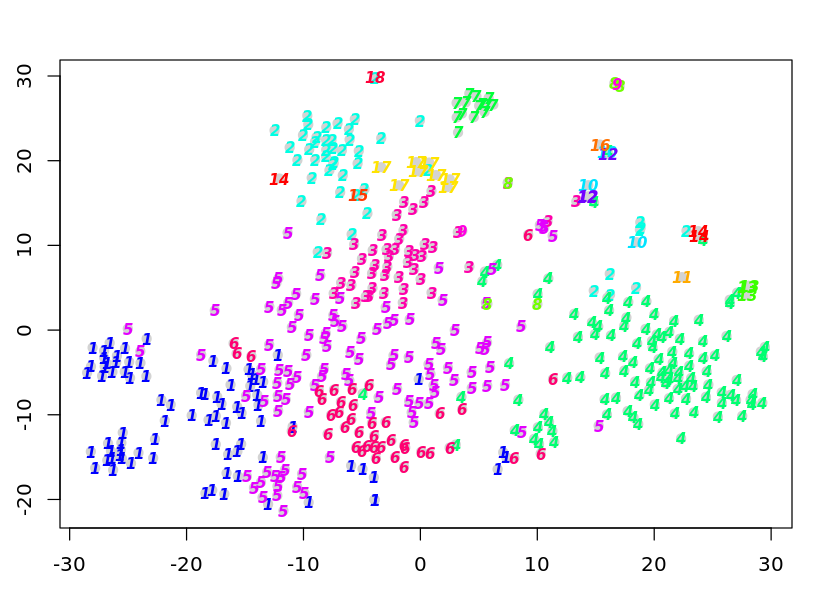

In [45]:
nam <- rownames(sc@expdata)

rem_mito <- nam[grepl("^mt-", nam)]
rem_ncod <- nam[grepl("NC_", nam)]

fgen <- c(rem_mito, rem_ncod)
fgen

sc_2_900_dogap_fgenes_mito <- allForOne(
    sc, 900, 2, clna=NULL, semeth="Tibs2001SEmax", 
    discover_cc = F, fgenes = fgen)

The clustering is virtually indifferent from the CGenes removal stage previously (i.e. still worse).

We will revert to the better clustering of **Without NC_002333.4** stage, and also try to see if not performing cell-cycle correction reduces some noise.

### Without NC_002333.4 + noCC

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


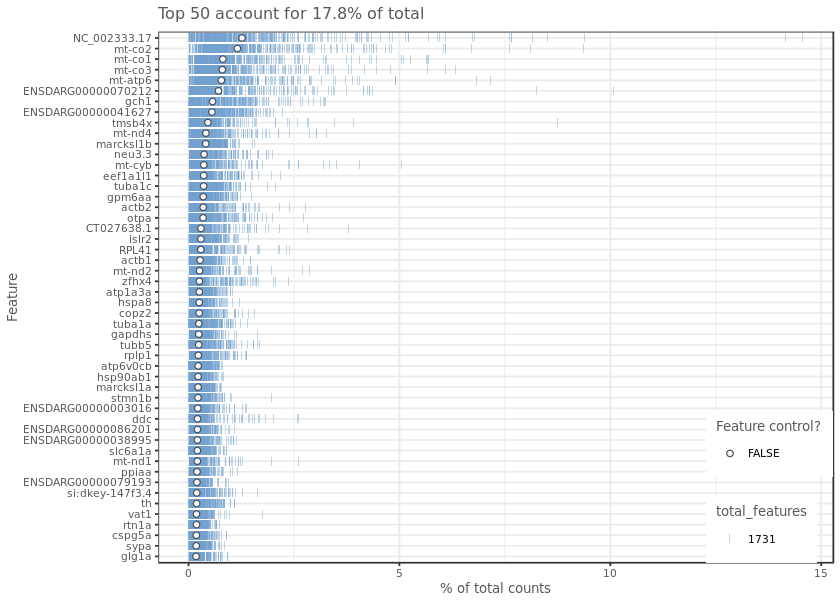

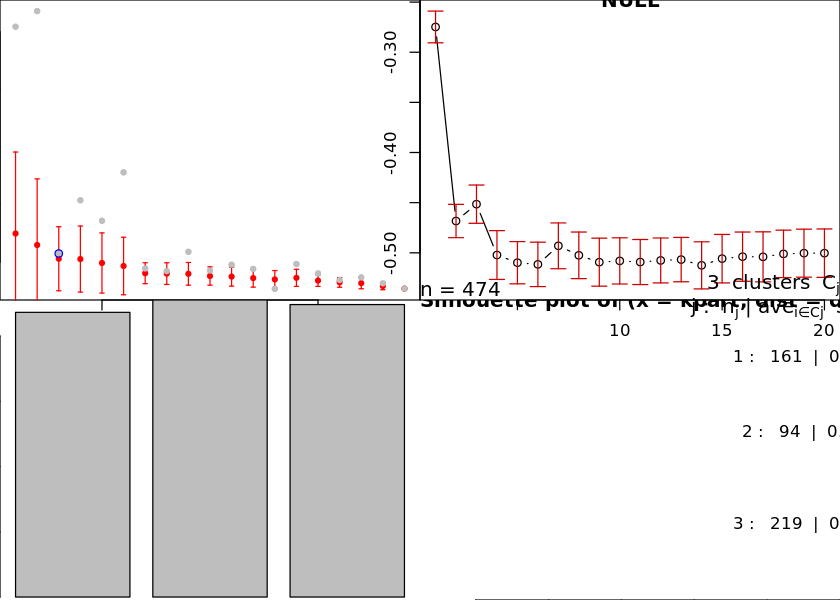

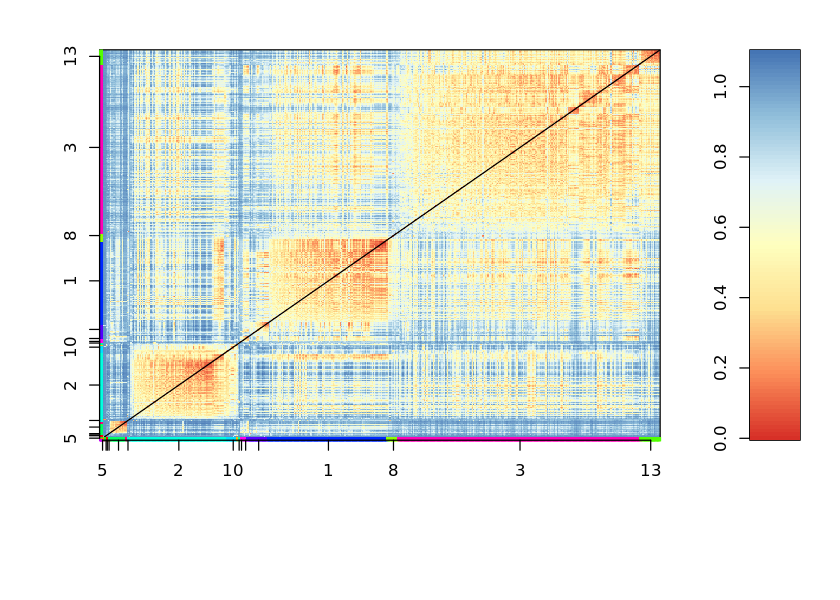

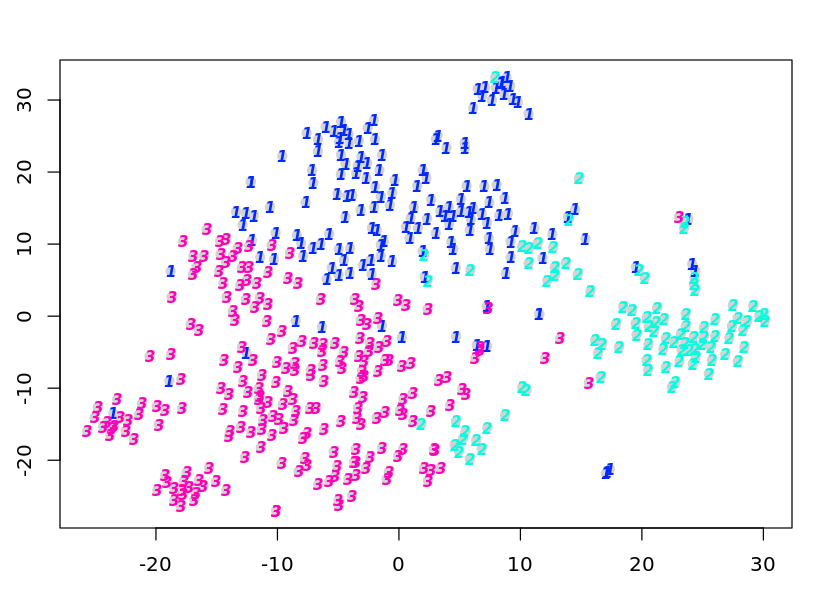

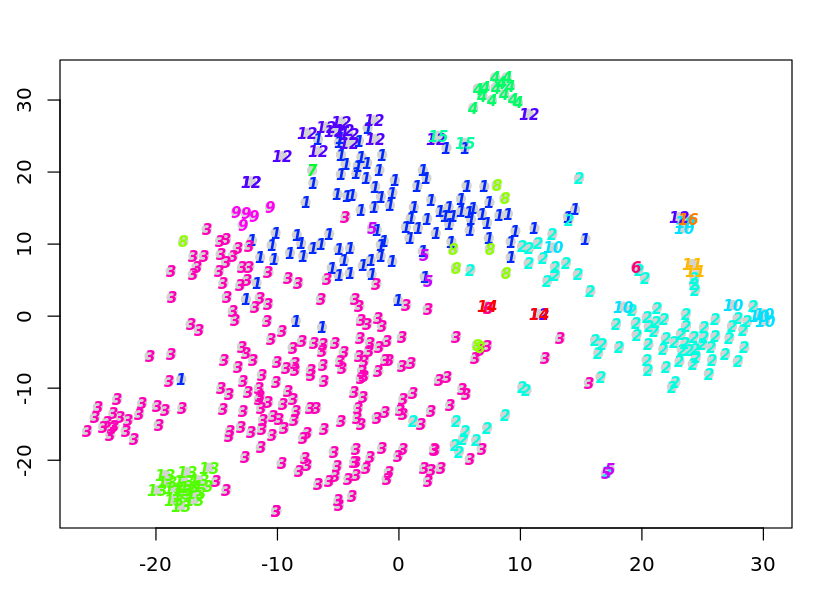

In [49]:
sc_2_900_dogap_fgenes_noCC <- allForOne(
    sc, 900, 2, clna=NULL, 
    semeth="Tibs2001SEmax", 
    discover_cc = F, fgenes = "NC_002333.4",
    docc=F
)

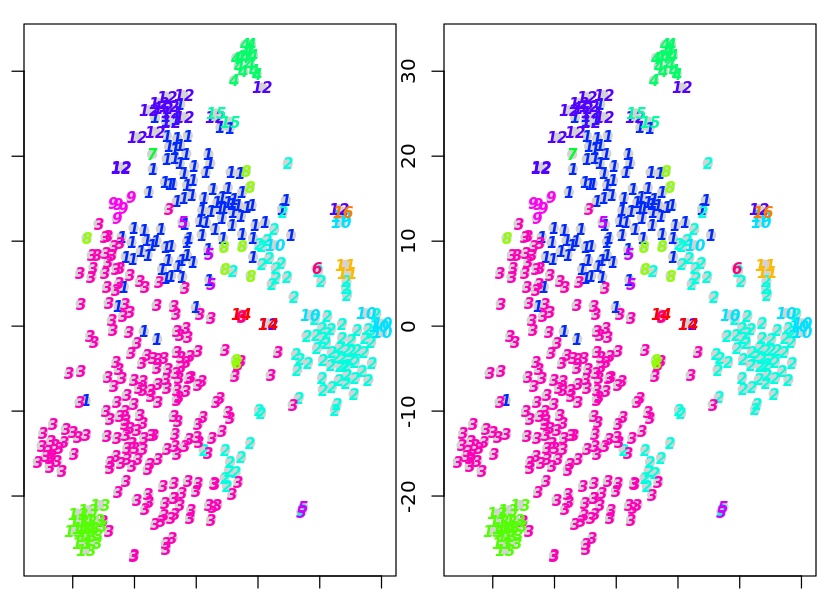

In [52]:
par(mfrow=c(1,2),mar=c(1,1,1,1))
plottsne(sc_2_900_dogap_fgenes)
plottsne(sc_2_900_dogap_fgenes_noCC)

We can see no difference between cell-cycle corrected analysis for a small set of known CC genes, and the analysis with no CC

Lastly, let us see if we can detect any changes between automatically cell-cycle corrected analysis (using BioMart for genes of cell-cycle and cell-proliferation detection)

### Without NC_002333.4 + AutoCC

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924037915334
Epoch: Iteration #200 error is: 0.813208051320676
Epoch: Iteration #300 error is: 0.807802176613029
Epoch: Iteration #400 error is: 0.806775597176864
Epoch: Iteration #500 error is: 0.805200689156289
Epoch: Iteration #600 error is: 0.805131273348226
Epoch: Iteration #700 error is: 0.80511103067897
Epoch: Iteration #800 error is: 0.805104515063503
Epoch: Iteration #900 error is: 0.805102205284546
Epoch: Iteration #1000 error is: 0.805101357200888


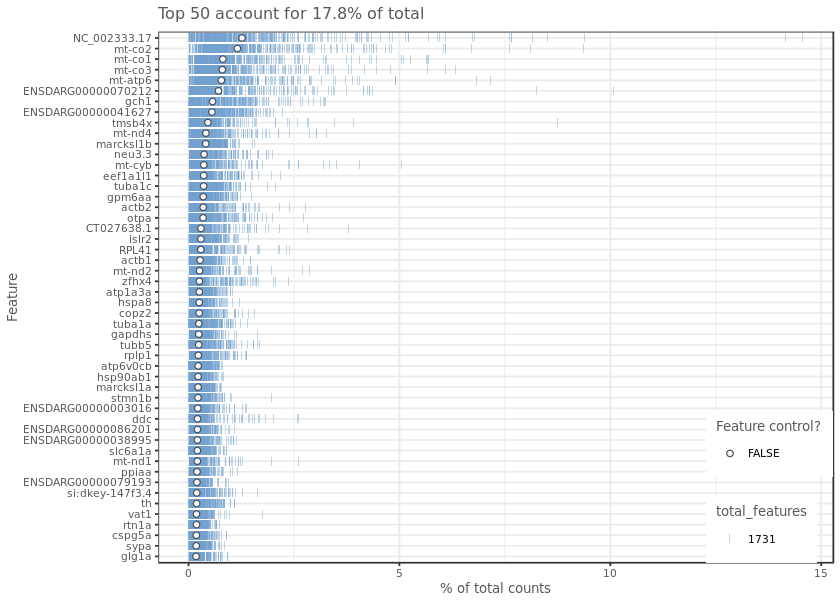

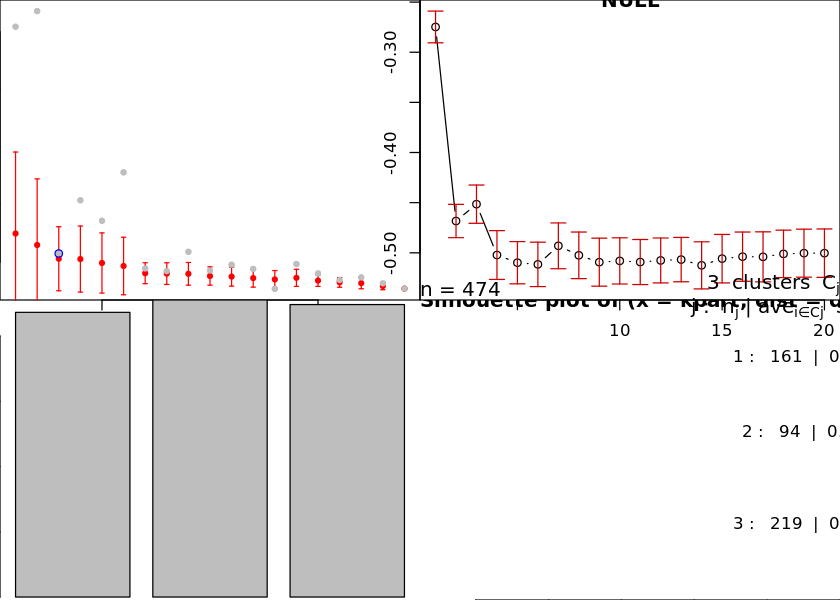

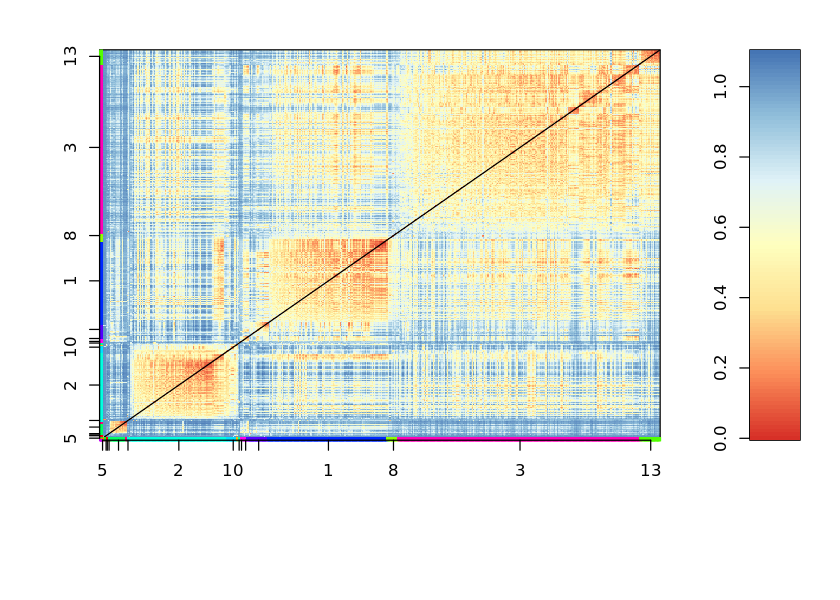

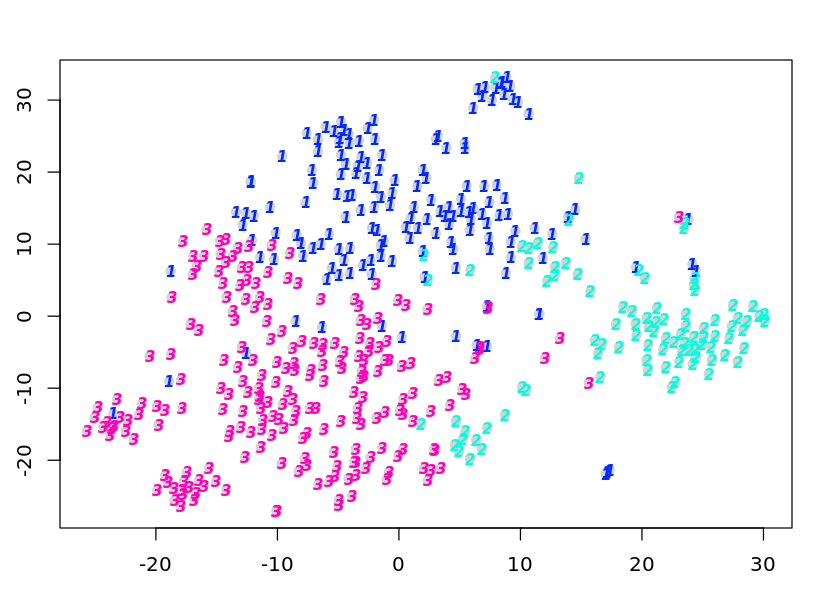

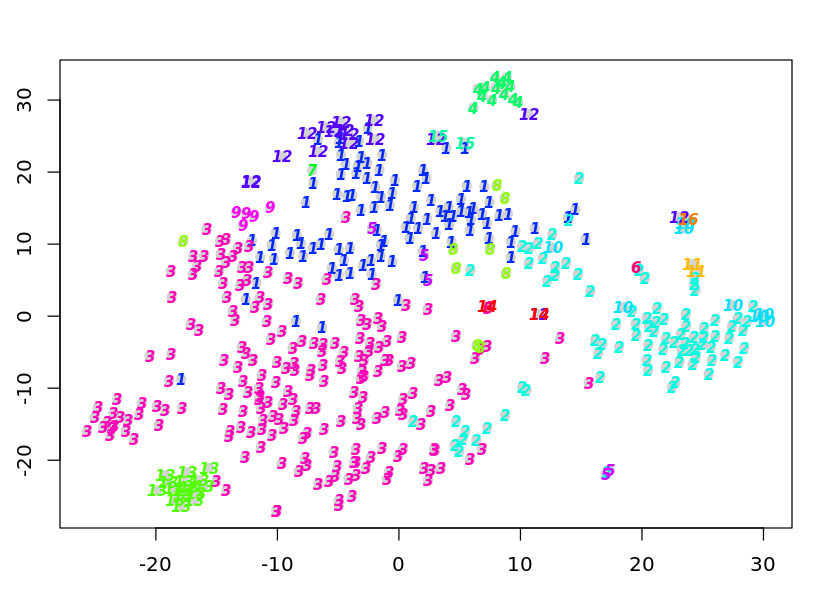

In [54]:
sc_2_900_dogap_fgenes_discoverT <- allForOne(
    sc, 900, 2, clna=NULL, 
    semeth="Tibs2001SEmax", 
    discover_cc = T, fgenes = "NC_002333.4",
    docc=T
)

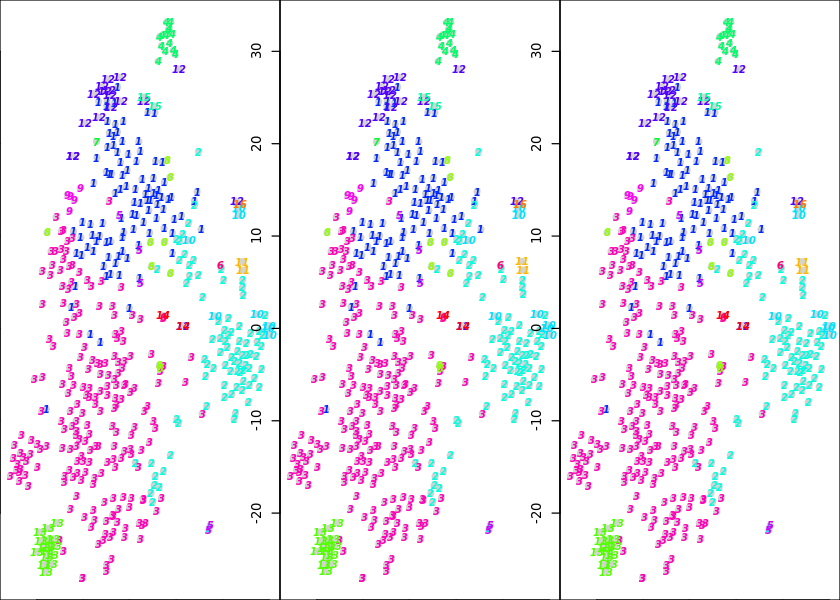

In [57]:
par(mfrow=c(1,3),mar=c(0,0,0,0))
plottsne(sc_2_900_dogap_fgenes)
plottsne(sc_2_900_dogap_fgenes_noCC)
plottsne(sc_2_900_dogap_fgenes_discoverT)

We can now say with reasonable certainty that **cell-cycle and cell-proliferation** genes do not impact our analysis.

## Identifying the cells in cluster 13

We should better characterise the well-defined cluster in the bottom left, so that we can use it as a guide

In [65]:
cdiff1 <- clustdiffgenes(sc_2_900_dogap_fgenes, pvalue=0.1)
cdiff2 <- clustdiffgenes(sc_2_900_dogap_fgenes_noCC, pvalue=0.1)
cdiff3 <- clustdiffgenes(sc_2_900_dogap_fgenes_discoverT, pvalue=0.1)

In [70]:
head(cdiff1[[13]], 20)
# They all give the same
#head(cdiff2[[13]])
#head(cdiff3[[13]])

,mean.ncl,mean.cl,fc,pv,padj
gch1,2.1762000,10.0075477,4.5986341,9.909310e-17,1.715302e-13
onecut1,0.4696788,2.4161875,5.1443396,1.349241e-12,1.167768e-09
atp1b1b,0.2411181,1.3385666,5.5514978,7.219556e-10,4.165684e-07
syt1a,0.3565594,1.6302245,4.5720984,1.991246e-09,7.197518e-07
adgrb1b,0.1848372,1.2143161,6.5696526,2.079006e-09,7.197518e-07
slc6a1b,0.4719750,1.8159689,3.8475954,2.738054e-08,7.899285e-06
ENSDARG00000041627,3.0851595,8.3172253,2.6958818,2.746083e-07,6.790670e-05
ENSDARG00000077736,0.9830879,2.8700377,2.9194112,7.490604e-07,1.620779e-04
slc6a3,0.3968826,1.3657827,3.4412760,1.987085e-06,3.475320e-04
ENSDARG00000087386,0.1649877,0.8883984,5.3846350,2.007695e-06,3.475320e-04


No difference in most expressive genes between the last 3 analyses. We can also see four levels of gene characterisation:

 | Level | P Adj. | Genes |
 |-------
 | L1 | -13 | gch1 |
 | L2 | -09 | onecut1, [L1] |
 | L3 | -07 | atp1b1b, syt1a, adgrb1b, [L2] |
 | L4 | -06 | slc6a1b [L3] |
 
 ### Inclusive Levelling

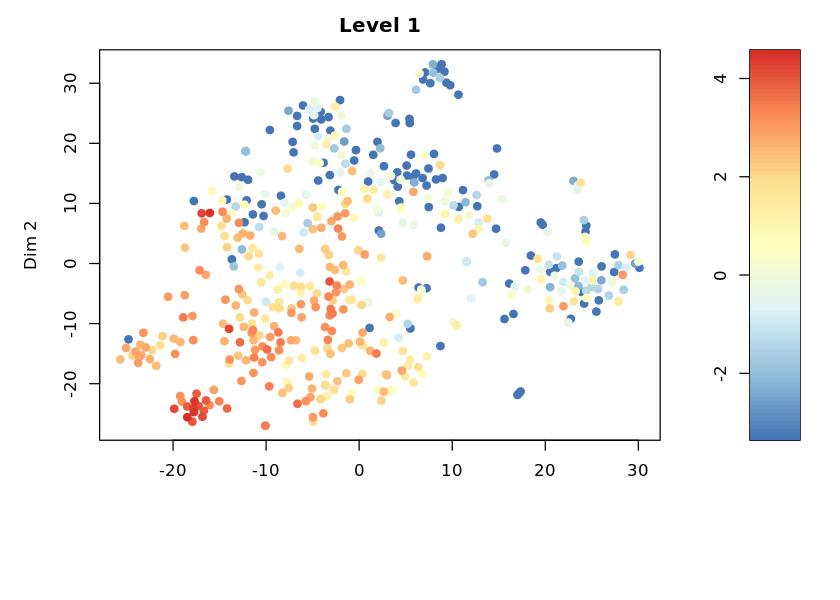

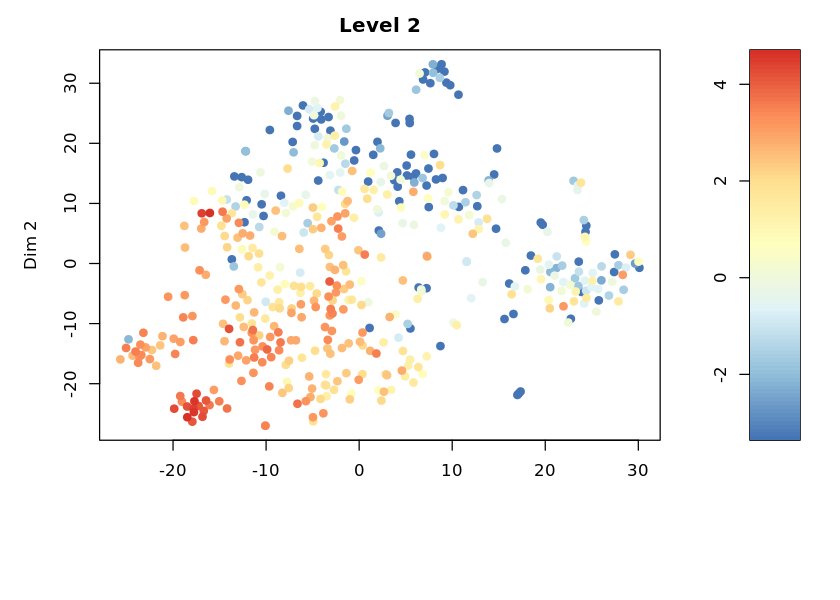

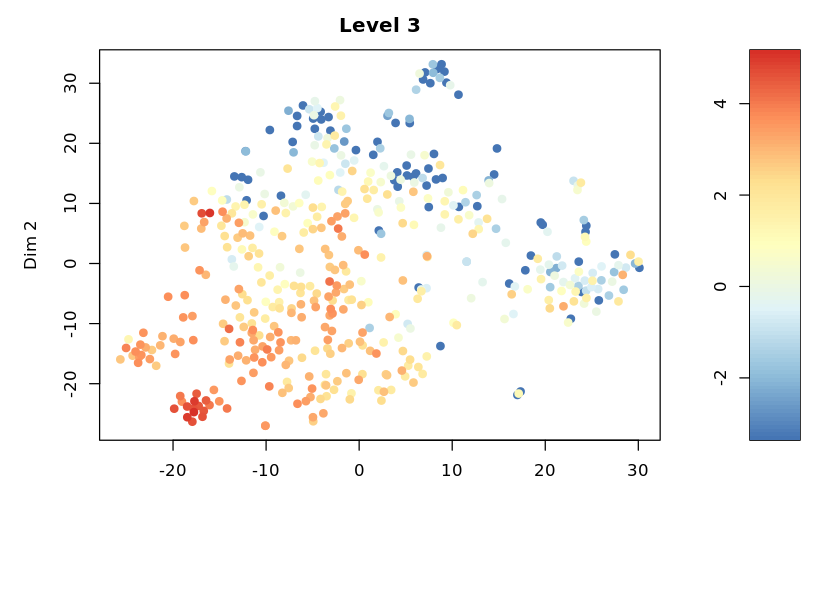

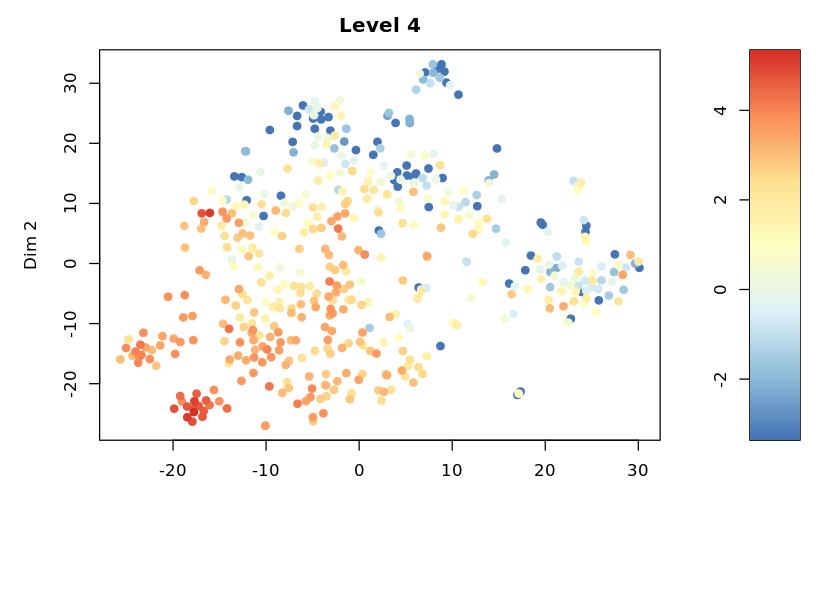

In [84]:
L1 <- "gch1"
L2 <- c("onecut1", L1)
L3 <- c("atp1b1b", "syt1a", "adgrb1b", L2)
L4 <- c("slc6a1b", L3)

par(mfrow=c(2,2),mar=c(0,0,0,0))
plotexptsne(sc_2_900_dogap_fgenes, L1, n="Level 1", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, L2, n="Level 2", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, L3, n="Level 3", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, L4, n="Level 4", logsc=T)

Inclusive levelling does not really reveal much, other than that **ghc1** has a powerful level of expression in these cells.

Let us not include the previous layer in our plots

### Exclusive Levelling

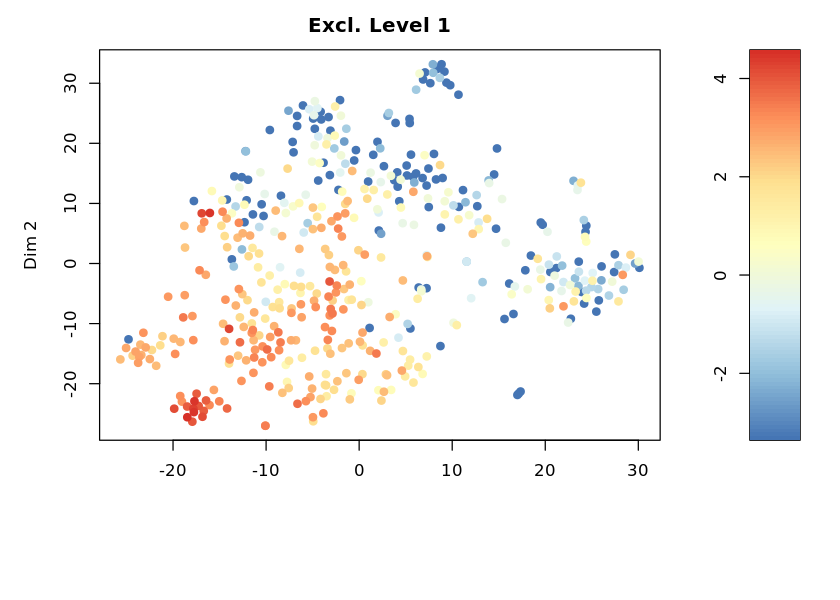

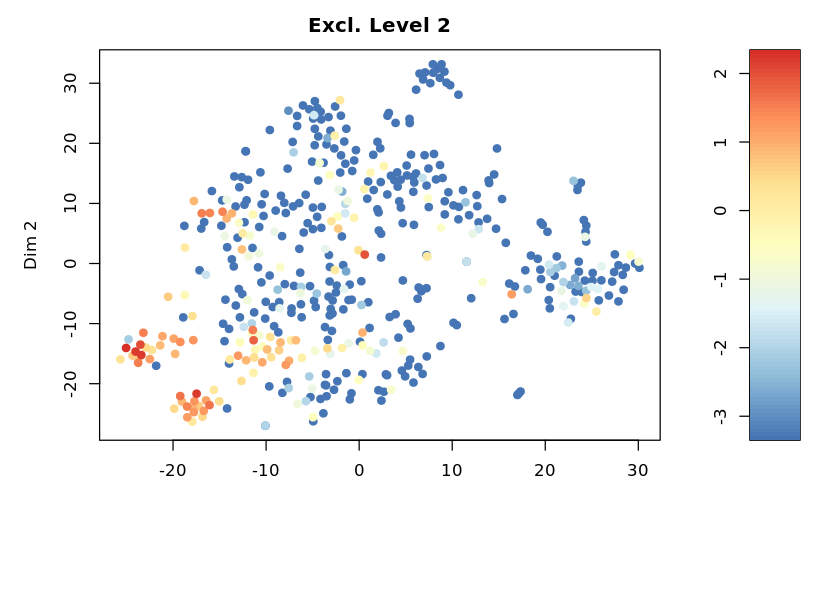

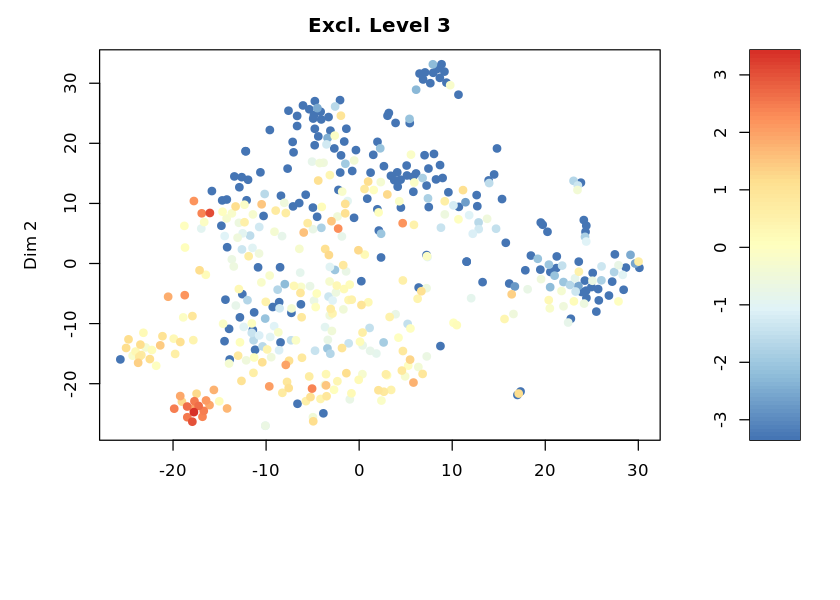

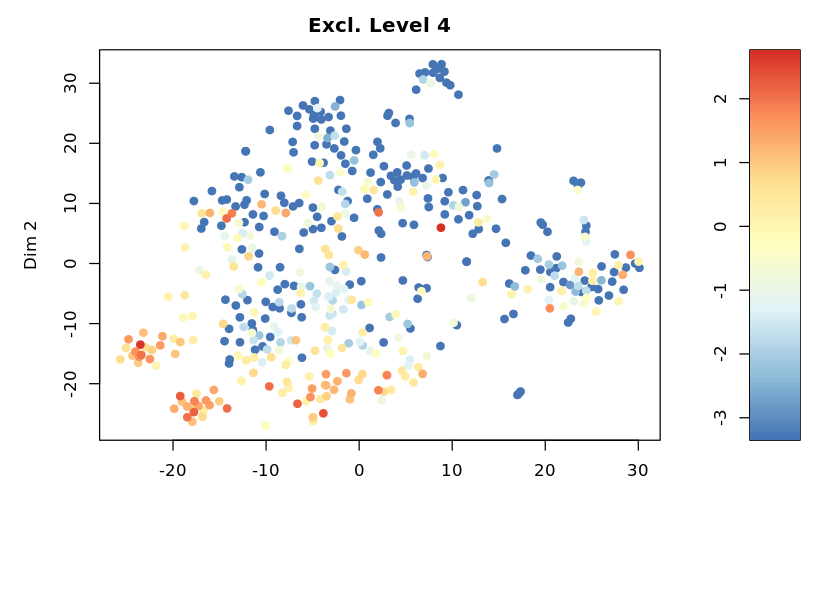

In [86]:
XL1 <- "gch1"
XL2 <- "onecut1"
XL3 <- c("atp1b1b", "syt1a", "adgrb1b")
XL4 <- "slc6a1b"

par(mfrow=c(2,2),mar=c(0,0,0,0))
plotexptsne(sc_2_900_dogap_fgenes, XL1, n="Excl. Level 1", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, XL2, n="Excl. Level 2", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, XL3, n="Excl. Level 3", logsc=T)
plotexptsne(sc_2_900_dogap_fgenes, XL4, n="Excl. Level 4", logsc=T)

The level 2 gene (onecut) and level 4 genes had noticeable expression in other clusters.
Level 1 (gch1) and Level 3 (atp1b1b, syt1a, adgrb1b) showed good characterisation however.

### Gene Descriptions

Let us explore these genes and see if they can tell us anything about our cells.


In [100]:
our_interest <- c("gch1", "atp1b1b", "syt1a", "adgrb1b")

mart <- useMart(
    biomart = "ENSEMBL_MART_ENSEMBL", 
    dataset = "drerio_gene_ensembl"
)

k <- getBM(
    filters = "external_gene_name",
    attributes = c("external_gene_name", "namespace_1003", "name_1006", "description"),
    values = our_interest,
    mart = mart
)

In [130]:
library(tidyr)

genes_of_interest <- our_interest

kk1 <- unique(k[,c("external_gene_name","name_1006")])
kk_nest1 <- kk1 %>% nest(name_1006)

# -- namespace 1003 (GO Domain) was not that informative
kk2 <- unique(k[,c("external_gene_name","namespace_1003")])
kk_nest2 <- kk2 %>% nest(namespace_1003)

tab <- cbind(kk_nest1, kk_nest2[,2])
colnames(tab) <- c("external_gene_name", "name_1006", "Go Domain")
tab




external_gene_name,name_1006,Go Domain
atp1b1b,"membrane , integral component of membrane , ion transport , sodium ion transport , potassium ion transport , sodium:potassium-exchanging ATPase complex","cellular_component, biological_process"
adgrb1b,"membrane , integral component of membrane , transmembrane signaling receptor activity , signal transducer activity , G-protein coupled receptor activity , signal transduction , G-protein coupled receptor signaling pathway , cell surface receptor signaling pathway , negative regulation of angiogenesis , apoptotic cell clearance , engulfment of apoptotic cell , phagolysosome assembly involved in apoptotic cell clearance,","cellular_component, molecular_function, biological_process,"
gch1,"cytoplasm , zinc ion binding , tetrahydrofolate biosynthetic process , GTP binding , GTP cyclohydrolase I activity , tetrahydrobiopterin biosynthetic process,","cellular_component, molecular_function, biological_process,"
syt1a,"membrane , integral component of membrane , plasma membrane , calcium ion binding , calcium-dependent phospholipid binding , neurotransmitter secretion , synaptic vesicle , syntaxin binding , clathrin binding , vesicle fusion , regulation of calcium ion-dependent exocytosis , calcium ion-regulated exocytosis of neurotransmitter, synaptic vesicle endocytosis , synaptic vesicle membrane","cellular_component, molecular_function, biological_process"


Whilst interesting, there is actually very little this reveals about what type of cells are in this cluster. (Perhaps there is prior labelling I was not made aware of.)

Nonetheless, we will use the profile of these 4 genes to act as our positive control when we attempt to brute-force the clustering for other parameters in order to measure the robustness of our clusters.

## Brute Force Clustering

We know that cell cycle and cell-proliferation does not impact the analysis signficantly, so we can play around slightly with our thresholds

We know that CC correction has no effect, so we will not use these. We also know that CGene correction leads to faulty results, and that FGene removal of (NC_002333.4) does not impact the analysis too much, but reduces the DE of the top 50 genes without affecting the median DE too much (33% → 17%, with NC_002333.4 providing the main change).

We will also look for well-defined clusters in each clustering, and see how well they persist into other clusterings.

#### Methods

In [247]:
investigateClusters <- function(sc_obj, clust_nums, pval=1e-10){
    ## Cluster 8 seems well-defined.
    cdiff <- clustdiffgenes(sc_obj, pvalue=pval)
    
    tab2 <- lapply(
        cdiff[clust_nums], FUN=function(table){
            deb <- cbind(rownames(table), table)
            rownames(deb) <- NULL
            return(deb)        
    })

    formatted_tab <- do.call(rbind, lapply(names(tab2), FUN=function(cln){
        tt <- tab2[[cln]]
        if (dim(tt)[1] > 0){
            return(cbind(cln, tab2[[cln]]))
        }
        return(NULL)
    }))
    #colnames(formatted_tab) <- c("cln", "Gene", "mean.ncl", "mean.cl", "fc", "pv", "padj")
    
    name_table <- cbind(lapply(
        cdiff[clust_nums], rownames
    ))
    #colnames(name_table) <- c("Cluster", "Sig. Genes")
    
    return(list(
        table = formatted_tab,
        names = name_table
    ))
}

### MinTotal = 1500, MinExp = 3

sigma summary: Min. : 0.088243382729588 |1st Qu. : 0.183566556090681 |Median : 0.209408792035807 |Mean : 0.219967379199104 |3rd Qu. : 0.24485693111084 |Max. : 0.399406596533054 |
Epoch: Iteration #100 error is: 0.749449366334441
Epoch: Iteration #200 error is: 0.73904060480283
Epoch: Iteration #300 error is: 0.733658581894726
Epoch: Iteration #400 error is: 0.732407085513687
Epoch: Iteration #500 error is: 0.730532195790118
Epoch: Iteration #600 error is: 0.730316272827661
Epoch: Iteration #700 error is: 0.730280819322583
Epoch: Iteration #800 error is: 0.730208502483138
Epoch: Iteration #900 error is: 0.729520186501287
Epoch: Iteration #1000 error is: 0.72780938172969


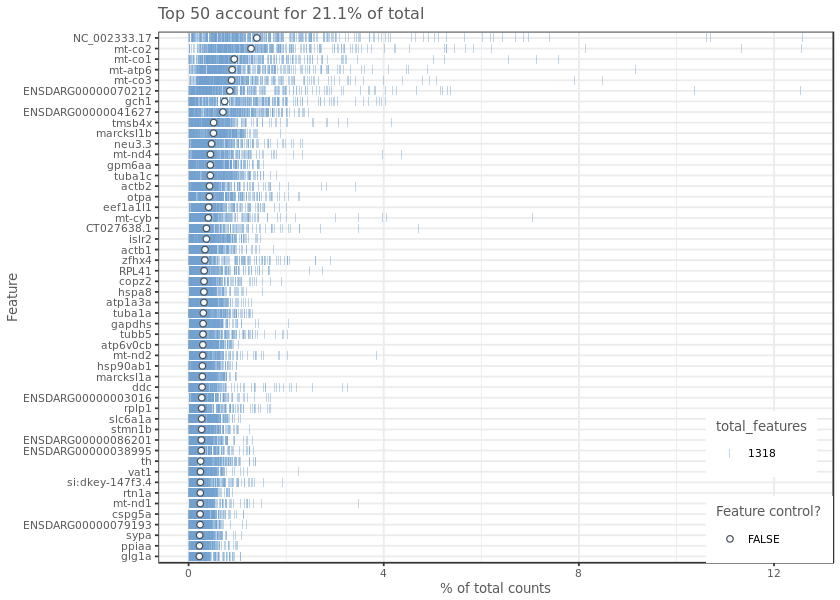

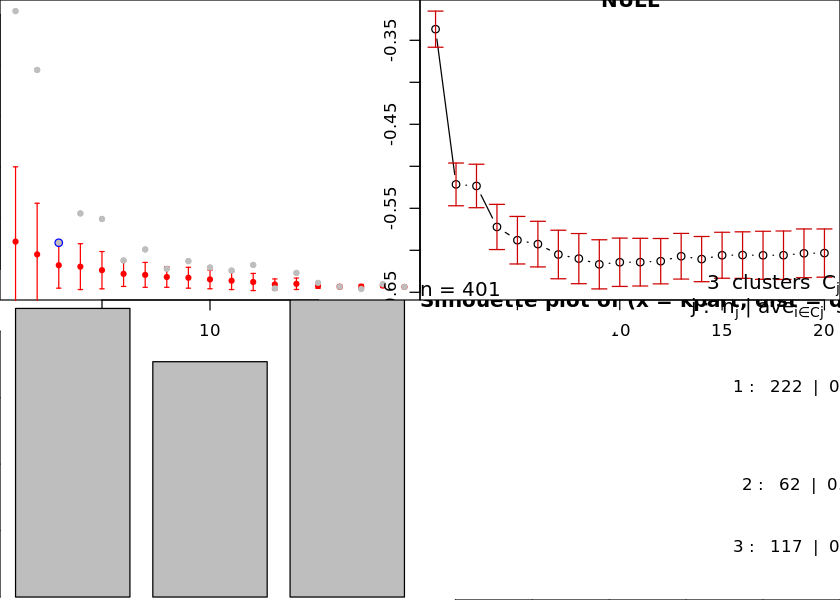

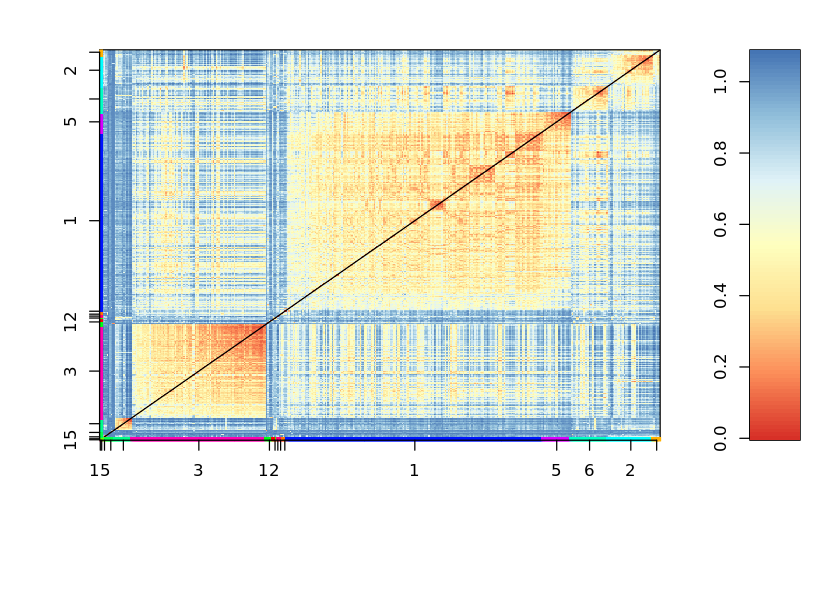

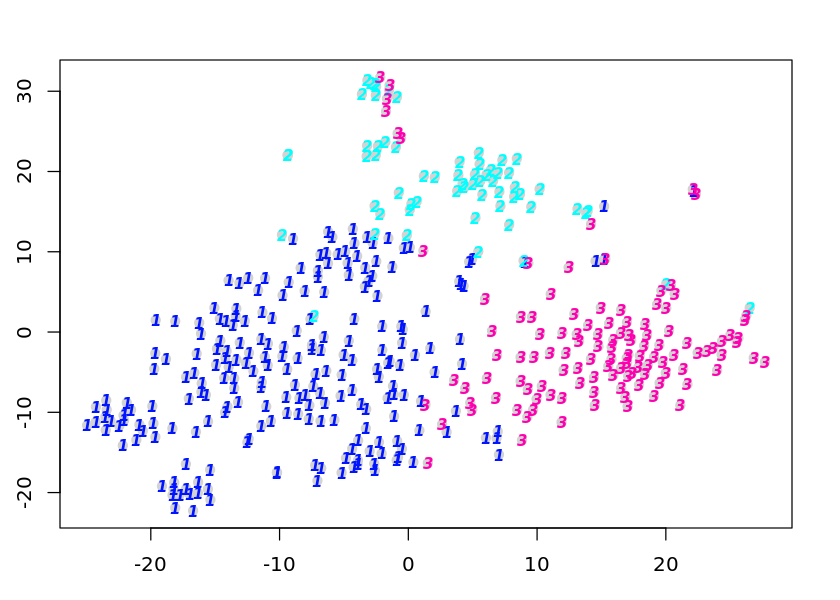

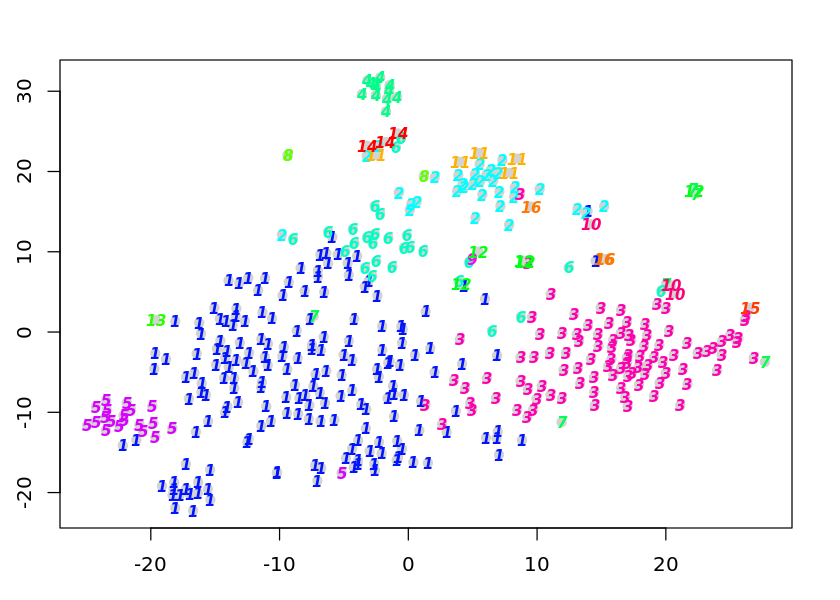

In [134]:
sc_3_1500_dogap <- allForOne(sc, 1500, 3, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

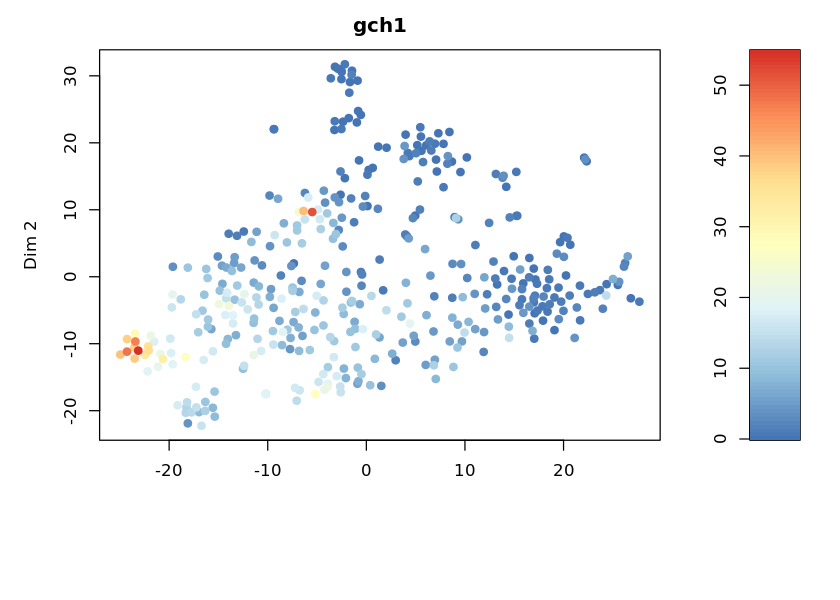

In [146]:
plotexptsne(sc_3_1500_dogap, our_interest)

In [248]:
# Clusters 4 and 5 seem well defined.
cmap_3_1500  <- investigateClusters(sc_3_1500_dogap, c(4,5), pval = 1e-10)
cmap_3_1500

cln,rownames(table),mean.ncl,mean.cl,fc,pv,padj
cl.4,ENSDARG00000027464,0.1503545,2.049619,13.631912,8.177415e-17,6.481758e-14
cl.4,lgmn,0.2630988,2.606266,9.906037,1.431329e-16,6.481758e-14
cl.4,havcr1,0.1412253,1.978724,14.011117,1.475362e-16,6.481758e-14
cl.4,ctsz,0.1400298,1.903418,13.592945,6.563520e-16,1.710252e-13
cl.4,zgc:173915,0.1971996,2.271106,11.516789,6.625447e-16,1.710252e-13
cl.4,CR318588.4,0.4195326,3.288998,7.839670,7.785671e-16,1.710252e-13
cl.4,slc7a7,0.1380651,1.876498,13.591399,4.735569e-15,8.916400e-13
cl.4,si:dkey-5n18.1,0.1823141,1.909338,10.472789,8.167780e-14,1.345642e-11
cl.4,mfap4,0.1215404,1.595922,13.130795,1.228316e-13,1.798800e-11
cl.4,arpc1b,0.1243594,1.592976,12.809458,1.659731e-13,2.187525e-11


### MinTotal = 1500, MinExp = 2

sigma summary: Min. : 0.0913950039179919 |1st Qu. : 0.181209342991109 |Median : 0.202803977642927 |Mean : 0.213786380845406 |3rd Qu. : 0.238446036376891 |Max. : 0.387757743747857 |
Epoch: Iteration #100 error is: 0.744019489385313
Epoch: Iteration #200 error is: 0.735393871800022
Epoch: Iteration #300 error is: 0.730052280332772
Epoch: Iteration #400 error is: 0.72648876584673
Epoch: Iteration #500 error is: 0.72625514908329
Epoch: Iteration #600 error is: 0.723064022137873
Epoch: Iteration #700 error is: 0.723048923668529
Epoch: Iteration #800 error is: 0.723046143552205
Epoch: Iteration #900 error is: 0.723045422242136
Epoch: Iteration #1000 error is: 0.723045232074164


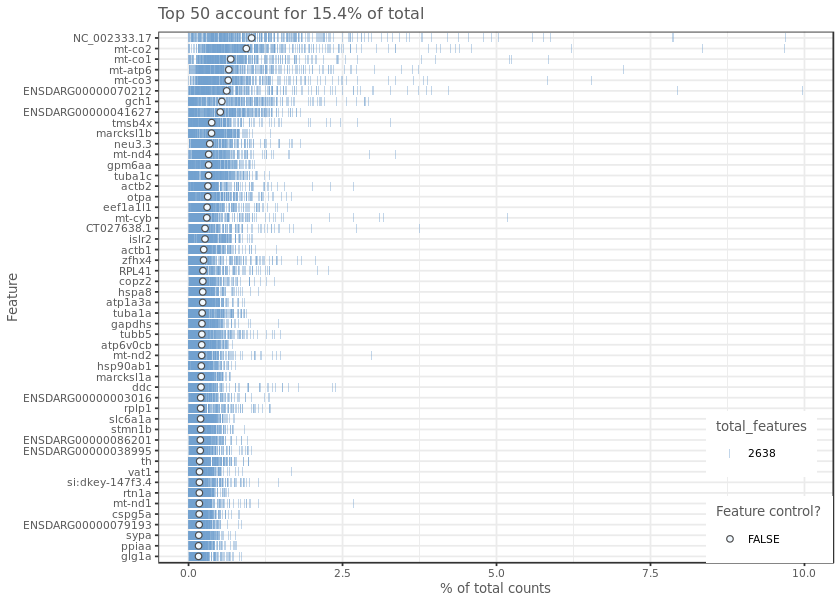

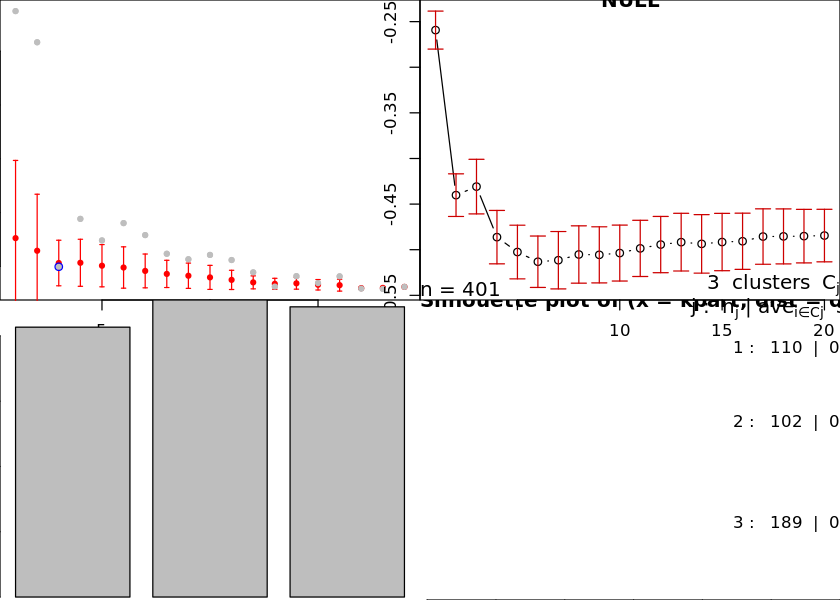

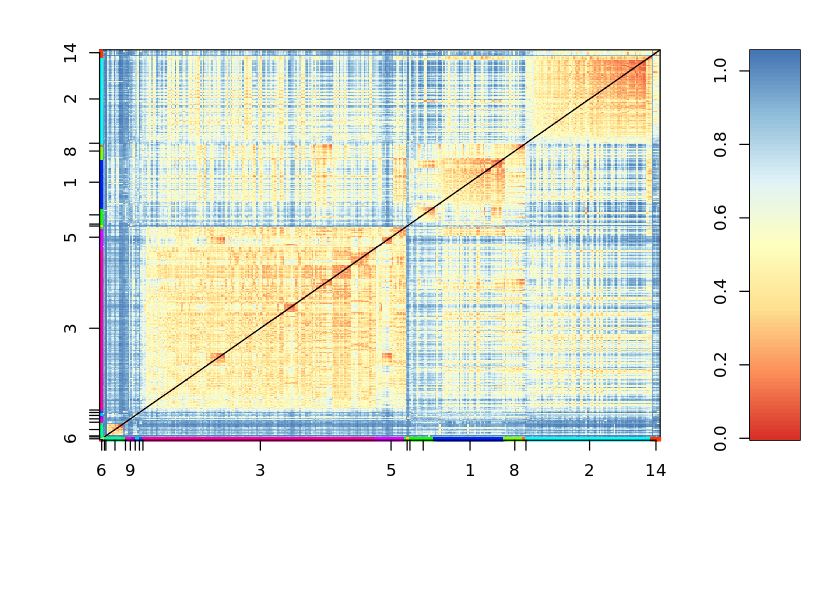

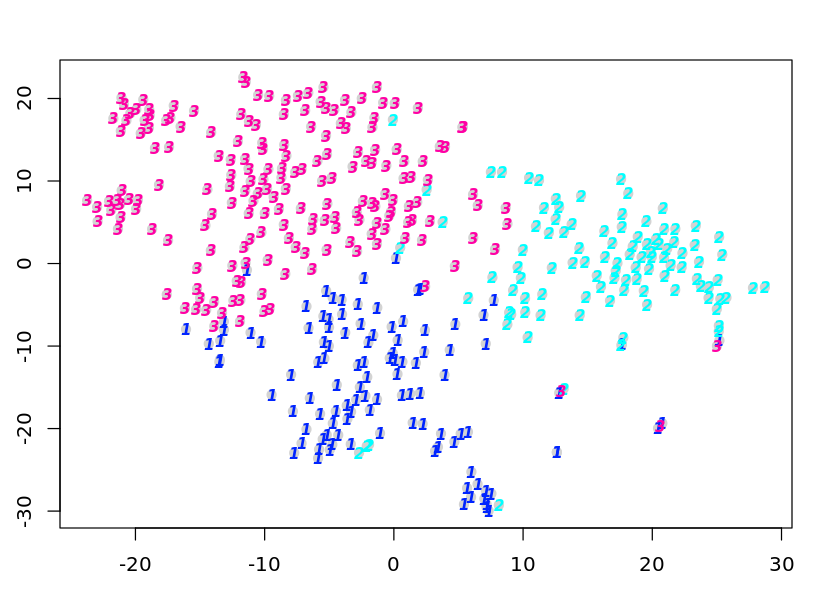

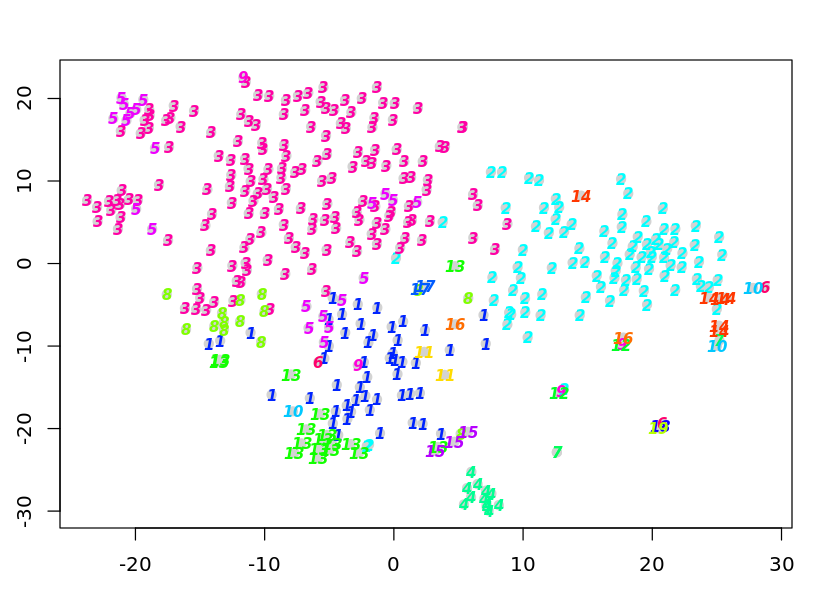

In [135]:
sc_2_1500_dogap <- allForOne(sc, 1500, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

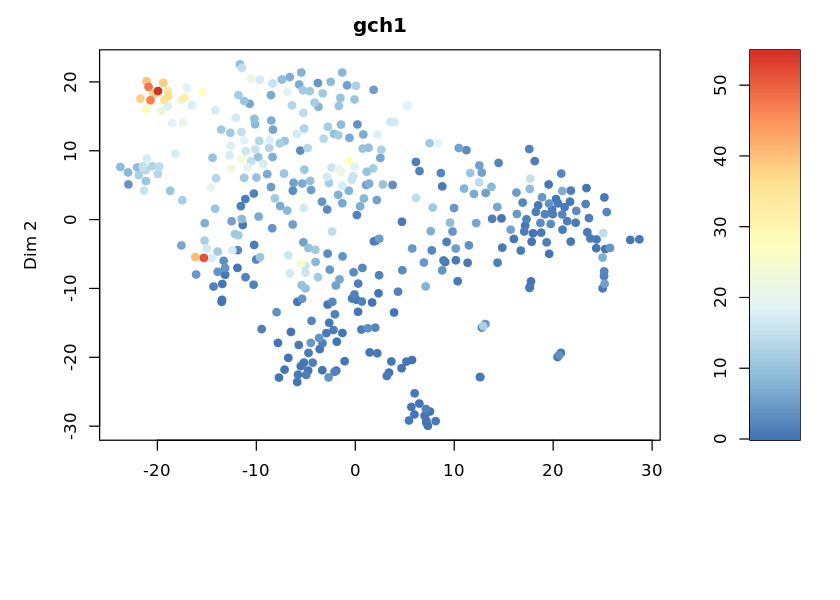

In [147]:
plotexptsne(sc_2_1500_dogap, our_interest)

In [249]:
# Clusters 4 and 13 seem well defined.
cmap_2_1500  <- investigateClusters(sc_2_1500_dogap, c(4,13), pval = 1e-10)
cmap_2_1500

cln,rownames(table),mean.ncl,mean.cl,fc,pv,padj
cl.4,ENSDARG00000027464,0.1503545,2.0496186,13.63191176,8.665669e-17,1.706121e-13
cl.4,havcr1,0.1412253,1.9787240,14.01111665,1.293496e-16,1.706121e-13
cl.4,lgmn,0.2630988,2.6062659,9.90603673,2.646501e-16,2.327157e-13
cl.4,ctsz,0.1400298,1.9034178,13.59294476,5.109293e-16,3.369578e-13
cl.4,zgc:173915,0.1971996,2.2711060,11.51678877,8.462175e-16,4.464644e-13
cl.4,CR318588.4,0.4195326,3.2889975,7.83967036,2.397873e-15,1.054265e-12
cl.4,slc7a7,0.1380651,1.8764979,13.59139943,3.613234e-15,1.361673e-12
cl.4,zgc:171509,0.2492399,2.7088296,10.86836096,4.575421e-14,1.508745e-11
cl.4,mfap4,0.1215404,1.5959218,13.13079521,6.314549e-14,1.818521e-11
cl.4,si:dkey-5n18.1,0.1823141,1.9093376,10.47278932,6.893561e-14,1.818521e-11


### MinTotal = 2000, MinExp = 2

* Final clusters seem to seperate really well.

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


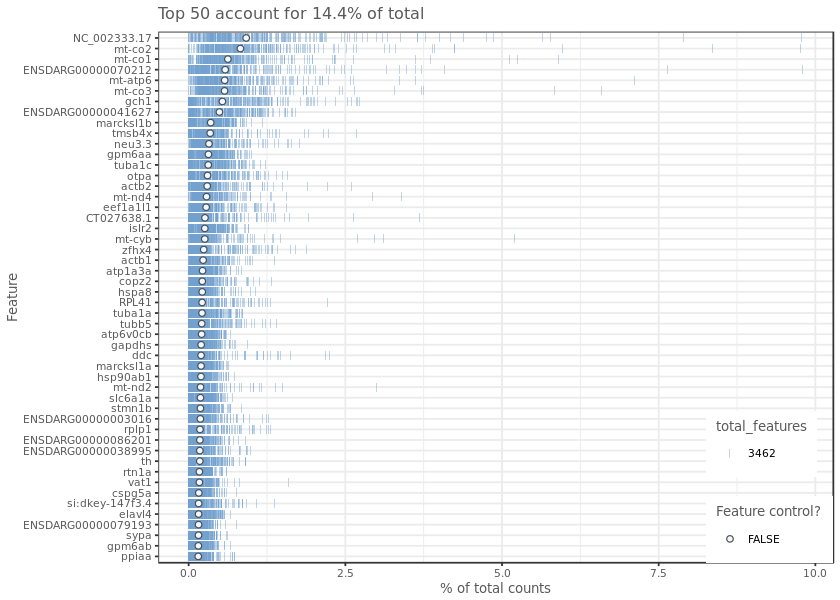

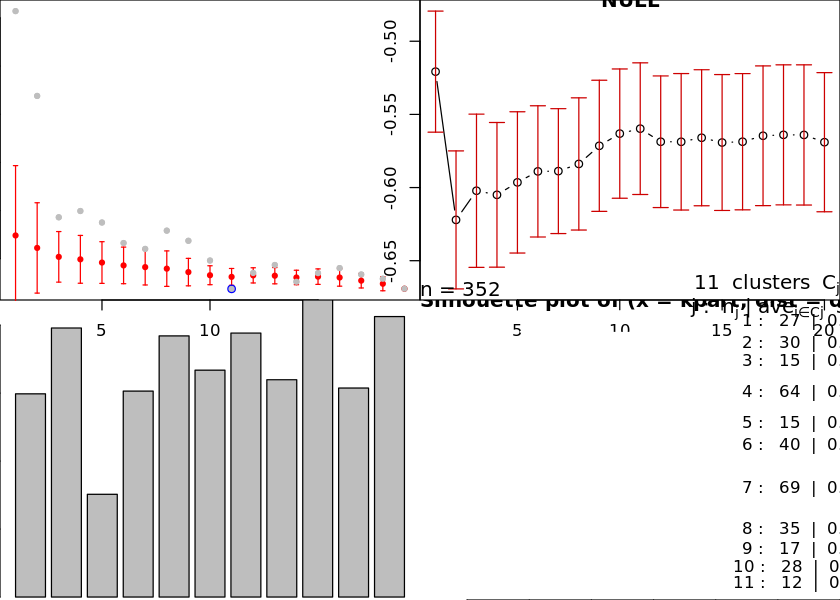

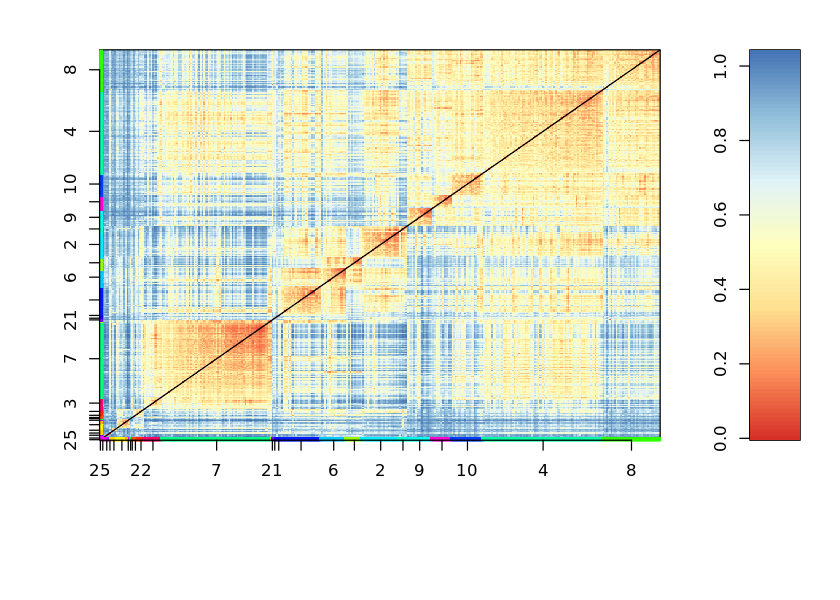

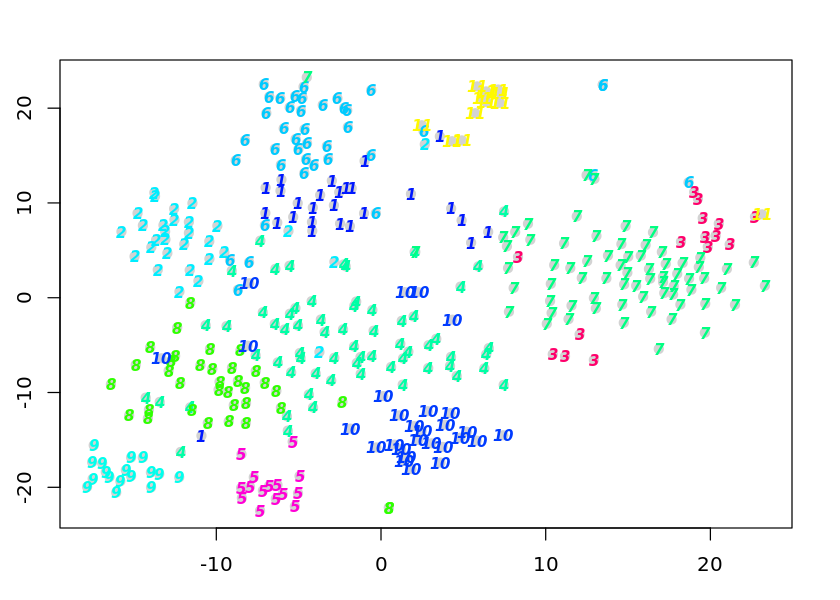

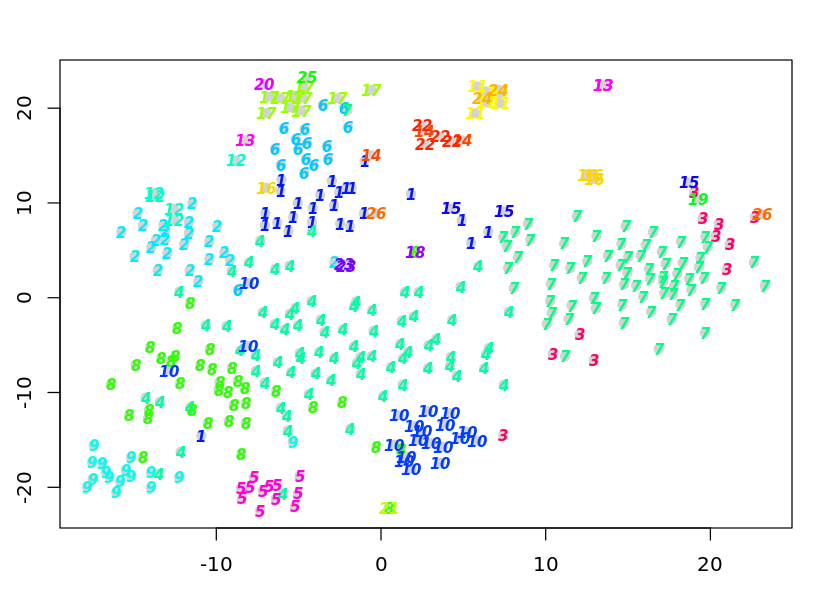

In [138]:
sc_2_2000_dogap <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

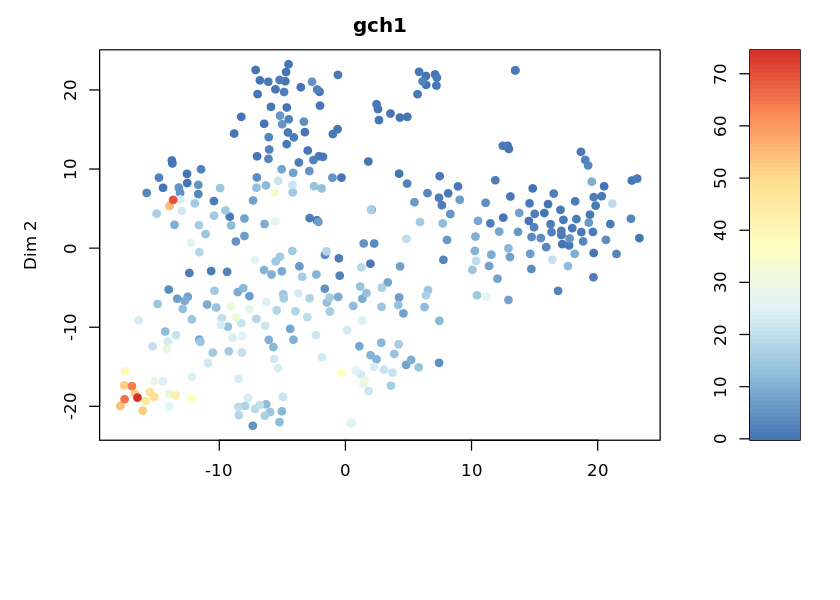

In [148]:
plotexptsne(sc_2_2000_dogap, our_interest)

In [250]:
cmap_2_2000  <- investigateClusters(sc_2_2000_dogap, c(5,6,9,10,22), pval = 1e-10)
cmap_2_2000

cln,rownames(table),mean.ncl,mean.cl,fc,pv,padj
cl.5,epha4b,0.3530780,2.916937,8.261451,2.615140e-14,9.053614e-11
cl.5,onecut1,0.9327617,5.254410,5.633175,2.588862e-13,4.481320e-10
cl.6,hapln1a,0.2645968,2.467831,9.326760,1.236595e-17,4.281090e-14
cl.6,rplp1,2.2150629,8.144162,3.676718,8.941377e-12,1.547752e-08
cl.6,RPL41,2.1240264,7.712599,3.631122,3.211923e-11,3.706559e-08
cl.9,gch1,5.1872186,23.369141,4.505139,9.688584e-21,3.354188e-17
cl.9,atp1b1b,0.4960292,3.244476,6.540898,9.758309e-16,1.689163e-12
cl.9,adgrb1b,0.2986036,2.199237,7.365072,6.248669e-15,7.210964e-12
cl.9,onecut1,0.9074556,4.705425,5.185295,1.287792e-14,1.114584e-11
cl.9,ENSDARG00000087386,0.2292354,1.797167,7.839831,8.411079e-14,5.823831e-11


### MinTotal = 3000,  MinExp = 2

Bad: Oversaturated clusters

sigma summary: Min. : 0.141486311153474 |1st Qu. : 0.180861693289481 |Median : 0.204789777149481 |Mean : 0.210291507274531 |3rd Qu. : 0.235214649477555 |Max. : 0.317243529739732 |
Epoch: Iteration #100 error is: 0.675727632690112
Epoch: Iteration #200 error is: 0.672891250375554
Epoch: Iteration #300 error is: 0.672190997666504
Epoch: Iteration #400 error is: 0.671889947385535
Epoch: Iteration #500 error is: 0.671884567789196
Epoch: Iteration #600 error is: 0.671884235823064
Epoch: Iteration #700 error is: 0.67188421242416
Epoch: Iteration #800 error is: 0.671884210800792
Epoch: Iteration #900 error is: 0.671884210686043
Epoch: Iteration #1000 error is: 0.6718842106779


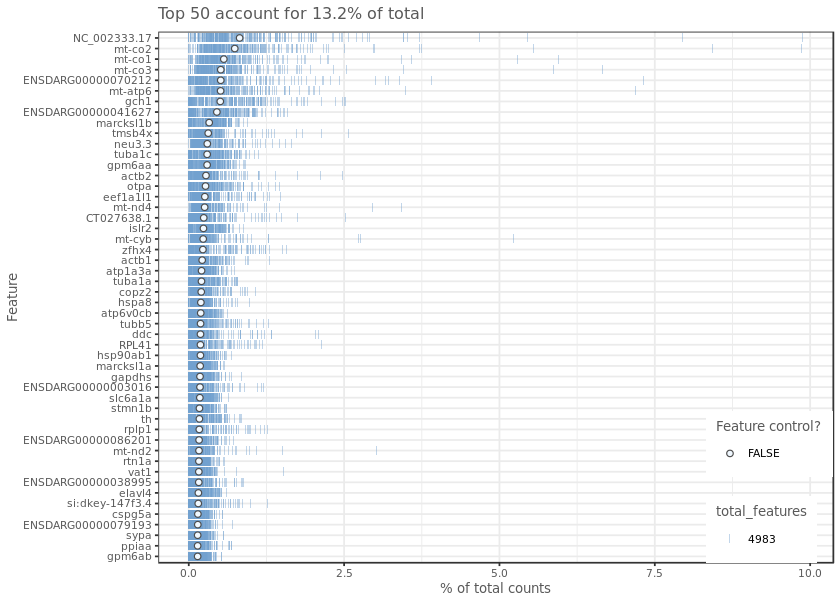

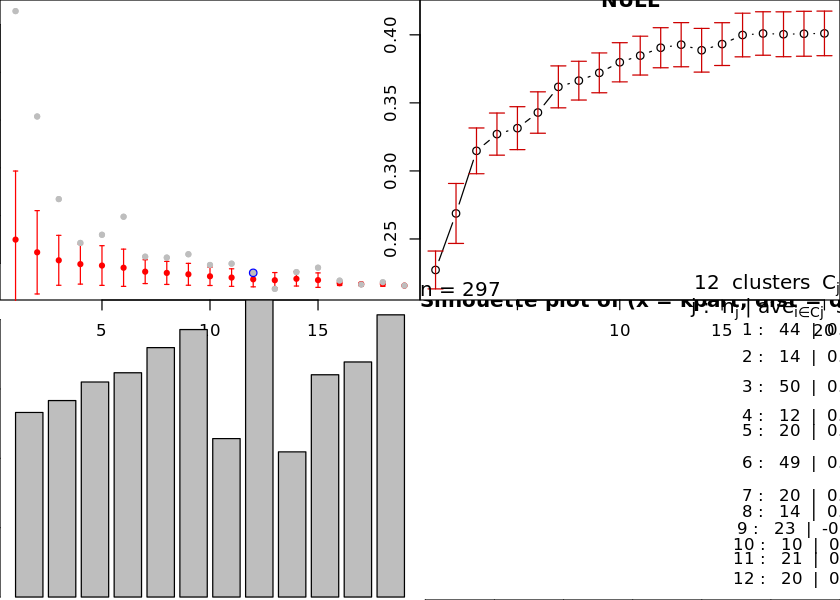

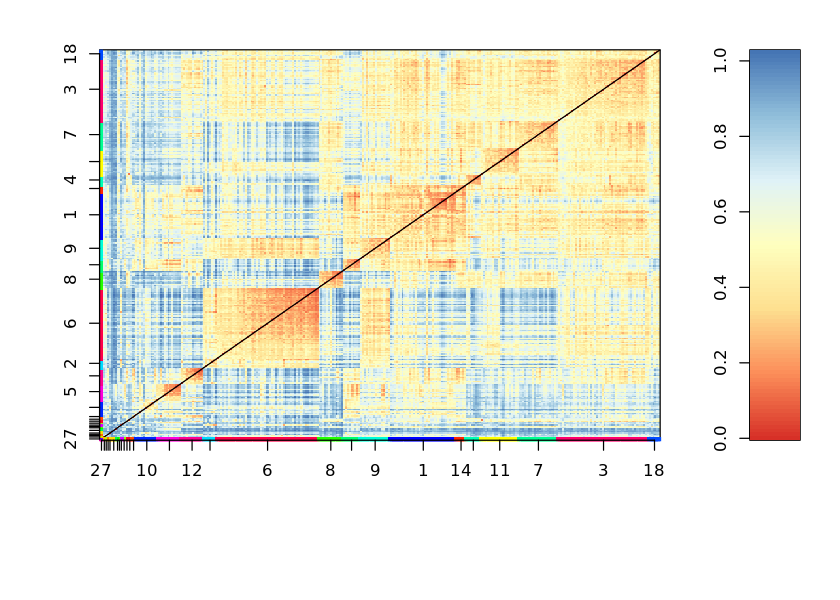

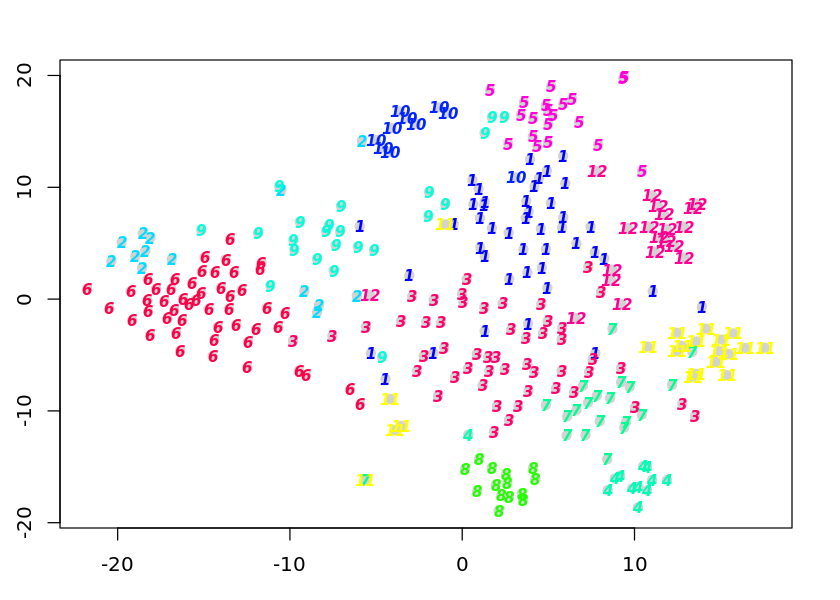

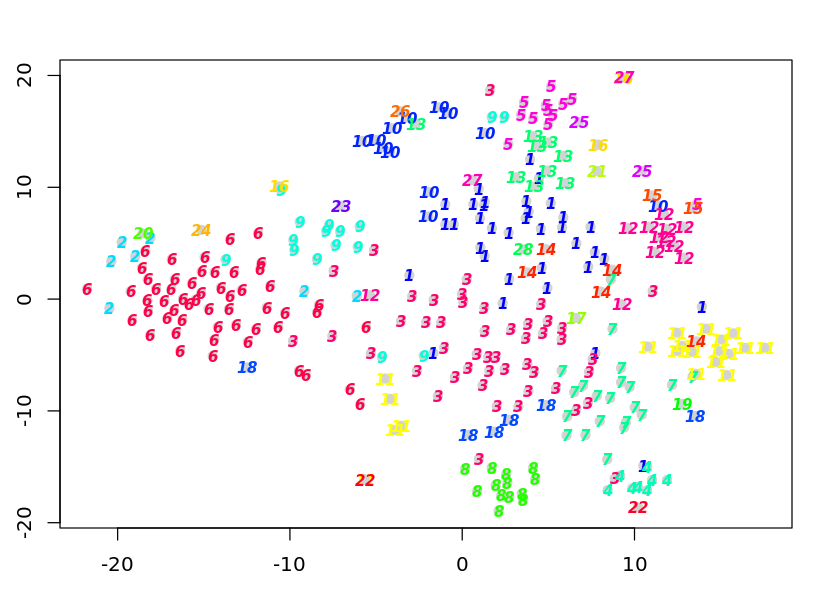

In [139]:
sc_2_3000_dogap <- allForOne(sc, 3000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

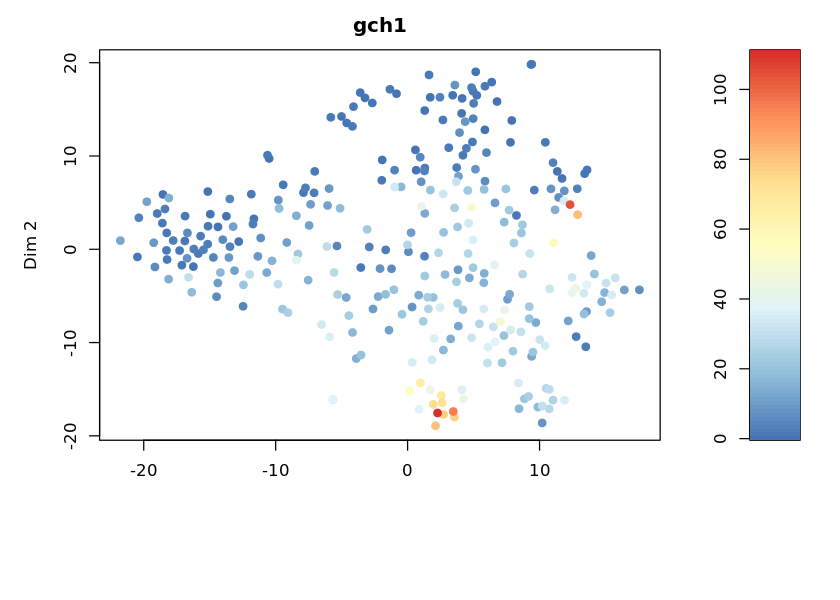

In [149]:
plotexptsne(sc_2_3000_dogap, our_interest)

In [251]:
# Clusters 8, 11, and 12 seem well defined.
cmap_2_3000  <- investigateClusters(sc_2_3000_dogap, c(8,11,12), pval = 1e-10)
cmap_2_3000

cln,rownames(table),mean.ncl,mean.cl,fc,pv,padj
cl.8,gch1,7.3875774,34.071537,4.612004,1.519687e-18,7.572599e-15
cl.8,atp1b1b,0.7269027,5.212322,7.170591,9.025178e-17,2.248623e-13
cl.8,ENSDARG00000087386,0.3090875,2.760492,8.931101,7.030024e-15,1.167687e-11
cl.8,adgrb1b,0.3927837,3.038495,7.735797,9.512824e-14,1.185060e-10
cl.8,onecut1,1.5318878,7.609731,4.967551,2.654765e-13,2.645739e-10
cl.8,ENSDARG00000091371,0.4359907,2.984083,6.844374,9.772230e-13,8.115837e-10
cl.11,zfhx4,3.6369823,24.056167,6.614321,4.141323e-30,2.063621e-26
cl.11,nhlh2,0.8465224,4.827592,5.702852,2.860121e-18,7.125993e-15
cl.11,otpa,4.9418418,16.424213,3.323500,2.874792e-13,4.775030e-10
cl.11,unc5db,0.1926448,1.288607,6.689032,7.127605e-12,8.879214e-09


Cluster 8 has the same genes as Cluster 5 in our original 2_900 analysis, with a two extra (retired) genes.

### MinTotal = 900, MinExp = 3

sigma summary: Min. : 0.125603004528493 |1st Qu. : 0.17497772426564 |Median : 0.194034354617298 |Mean : 0.205432665195978 |3rd Qu. : 0.223396428132117 |Max. : 0.380382550658106 |
Epoch: Iteration #100 error is: 0.839059196525959
Epoch: Iteration #200 error is: 0.825315026072401
Epoch: Iteration #300 error is: 0.818796699097482
Epoch: Iteration #400 error is: 0.815941812570164
Epoch: Iteration #500 error is: 0.815346823394567
Epoch: Iteration #600 error is: 0.81520278600095
Epoch: Iteration #700 error is: 0.81515467515021
Epoch: Iteration #800 error is: 0.815136329470773
Epoch: Iteration #900 error is: 0.815128771570286
Epoch: Iteration #1000 error is: 0.815125378325386


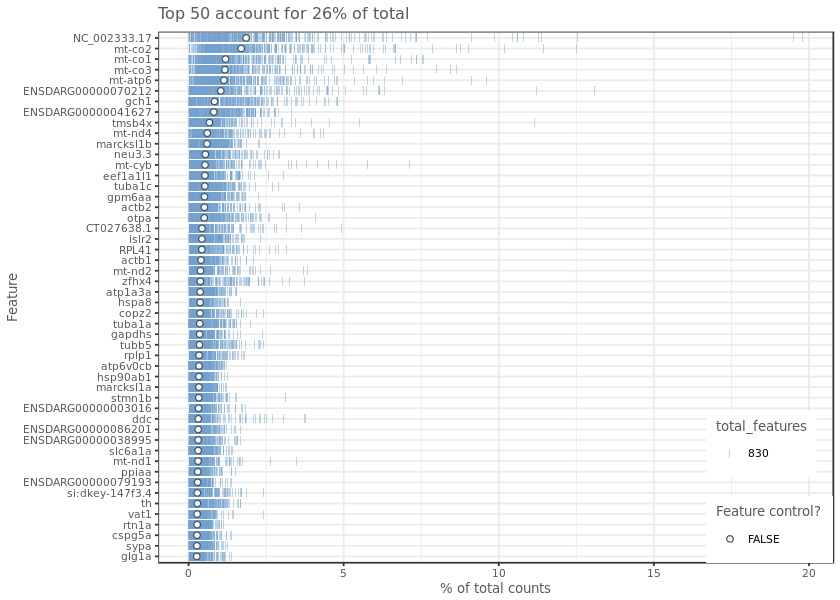

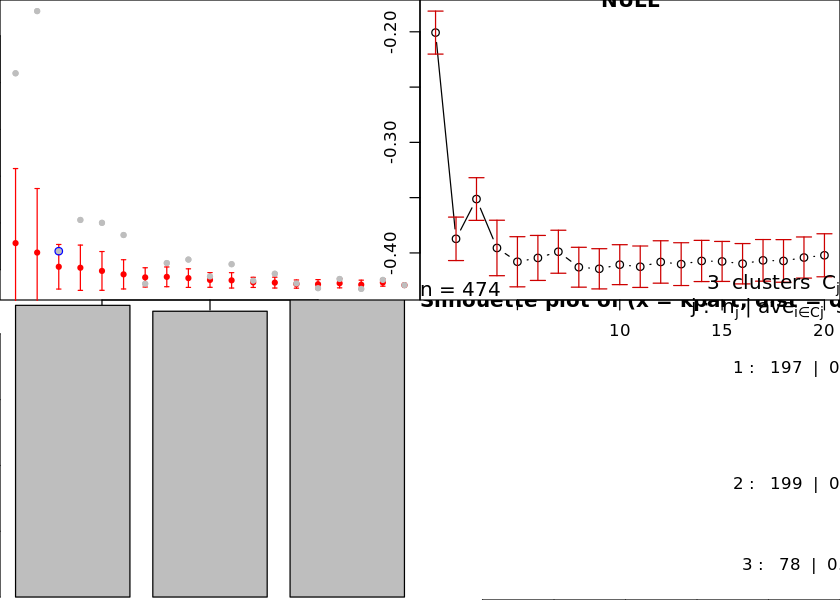

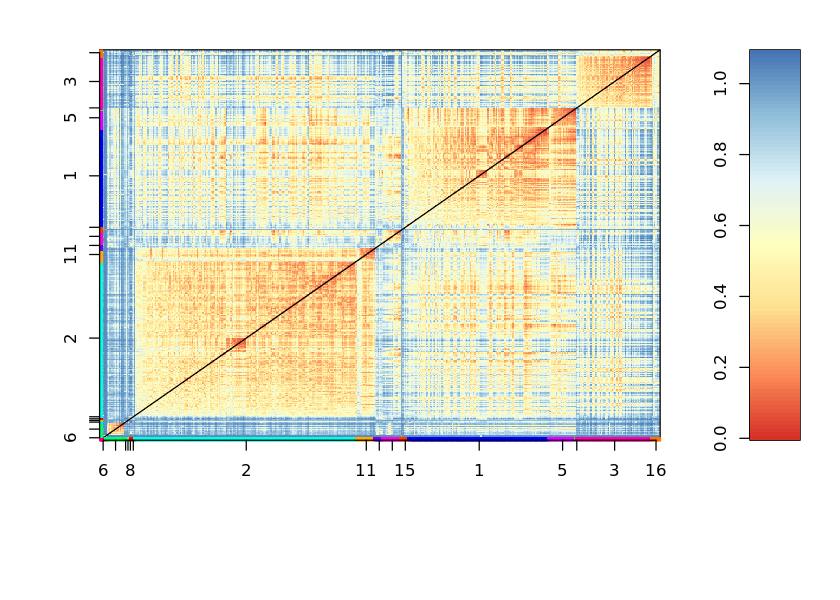

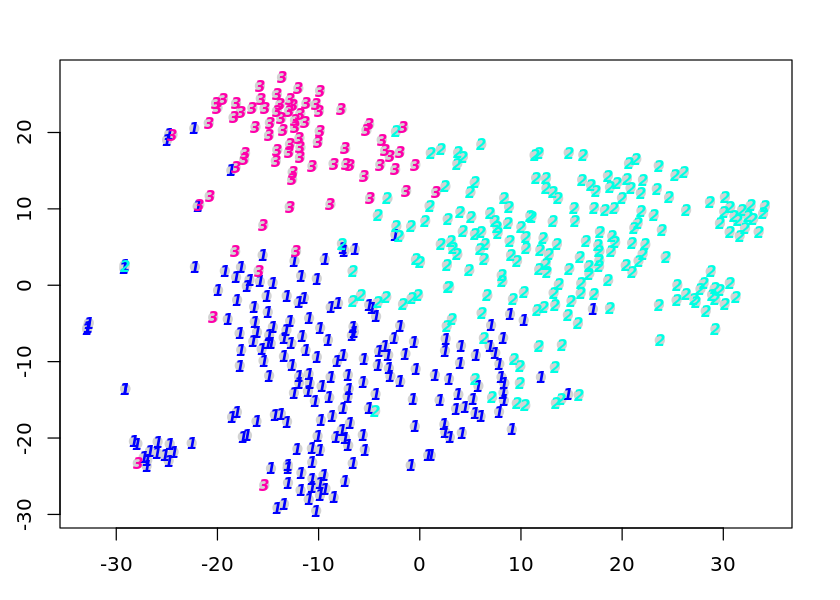

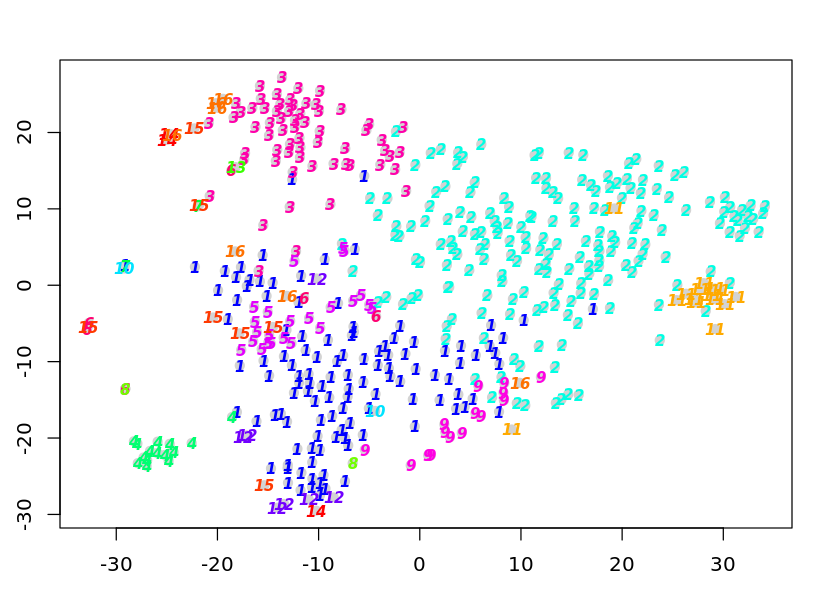

In [140]:
sc_3_900_dogap <- allForOne(sc, 900, 3, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

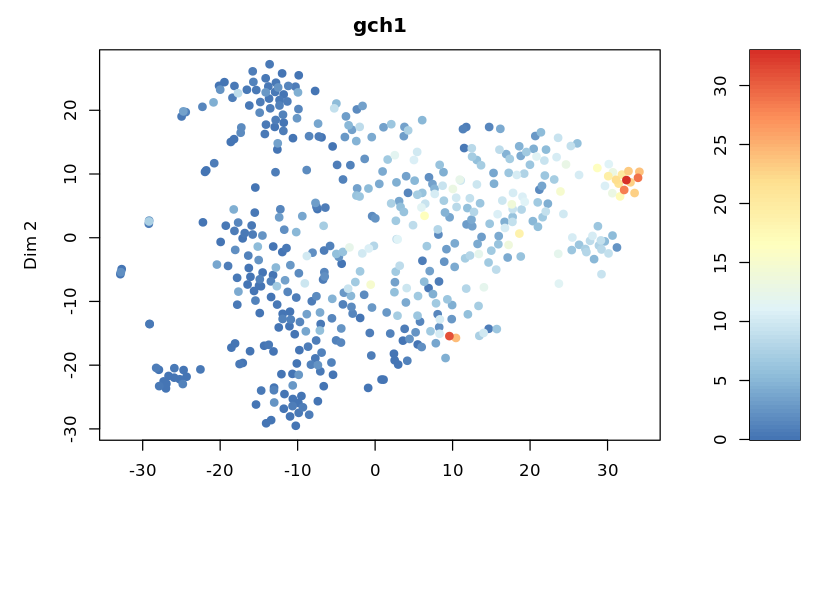

In [150]:
plotexptsne(sc_3_900_dogap, our_interest)
# Bad clustering - our interest 

In [252]:
# Clusters 4 and 11 seem well defined.
cmap_3_900  <- investigateClusters(sc_3_900_dogap, c(4,11), pval = 1e-10)
cmap_3_900


cln,rownames(table),mean.ncl,mean.cl,fc,pv,padj
cl.4,lgals3bpb,0.1188597,1.4405496,12.11974902,1.732522e-14,1.437993e-11
cl.4,ctsz,0.1261862,1.3964758,11.06678898,4.051302e-14,1.681290e-11
cl.4,ctsd,0.1997094,1.9126269,9.57705067,1.576644e-13,4.362047e-11
cl.4,slc40a1,0.1233107,1.3366361,10.83957636,2.620360e-13,5.437248e-11
cl.4,zgc:92066,0.3887046,2.1542214,5.54205333,9.718096e-13,1.448004e-10
cl.4,BX322618.1,0.1540349,1.3967591,9.06781038,1.046750e-12,1.448004e-10
cl.4,CR318588.4,0.3331144,1.9743325,5.92689028,1.249413e-12,1.481447e-10
cl.4,zgc:173915,0.1689150,1.8093835,10.71179891,1.454561e-12,1.509107e-10
cl.4,havcr1,0.1223356,1.2804855,10.46699337,1.670795e-12,1.540845e-10
cl.4,mfap4,0.1106379,1.2123432,10.95775224,3.709498e-12,3.078884e-10


### MinTotal = 900, MinExp = 5

sigma summary: Min. : 0.11939882919528 |1st Qu. : 0.168972819910123 |Median : 0.18935670877539 |Mean : 0.200070978462388 |3rd Qu. : 0.217458938377542 |Max. : 0.383876699412291 |
Epoch: Iteration #100 error is: 0.830734225259433
Epoch: Iteration #200 error is: 0.817013819841027
Epoch: Iteration #300 error is: 0.812048689114842
Epoch: Iteration #400 error is: 0.808798973666818
Epoch: Iteration #500 error is: 0.808325075112712
Epoch: Iteration #600 error is: 0.80816713938066
Epoch: Iteration #700 error is: 0.808100694445812
Epoch: Iteration #800 error is: 0.808069528314307
Epoch: Iteration #900 error is: 0.808054402828642
Epoch: Iteration #1000 error is: 0.808046859274361


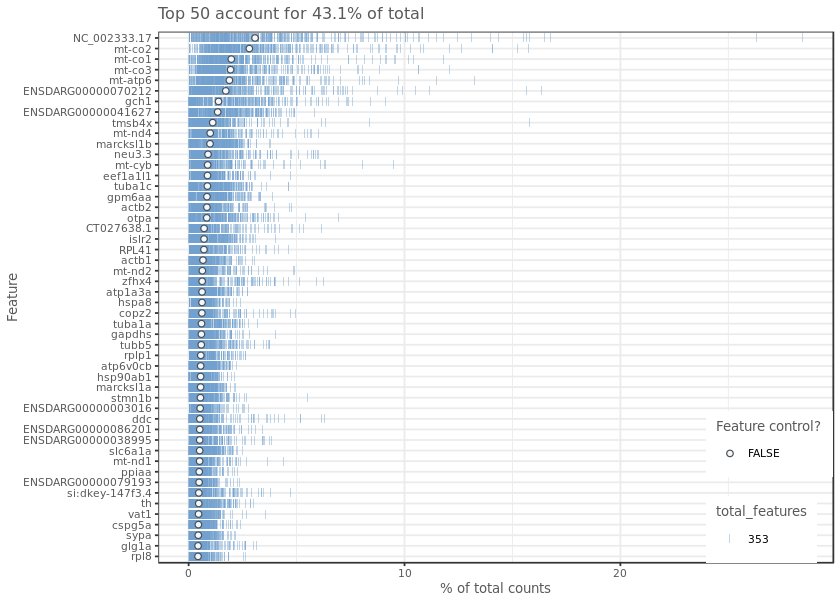

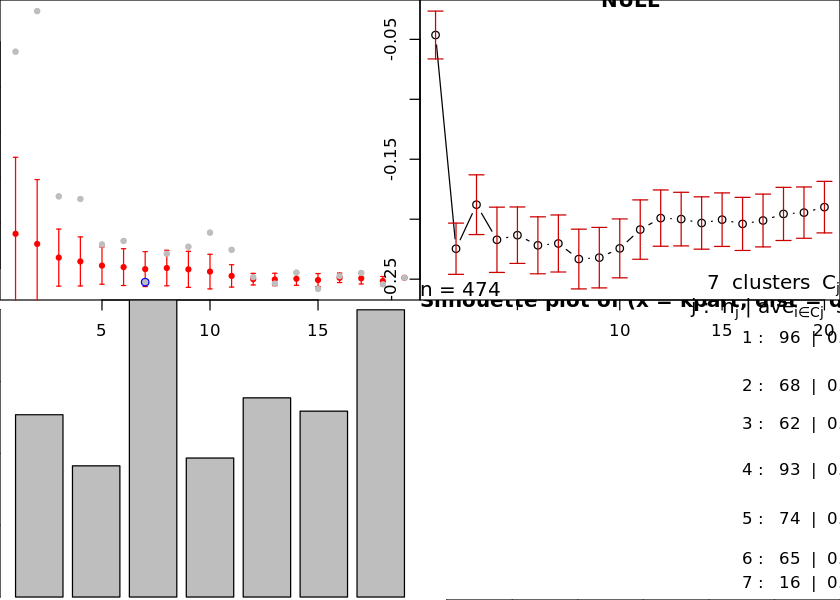

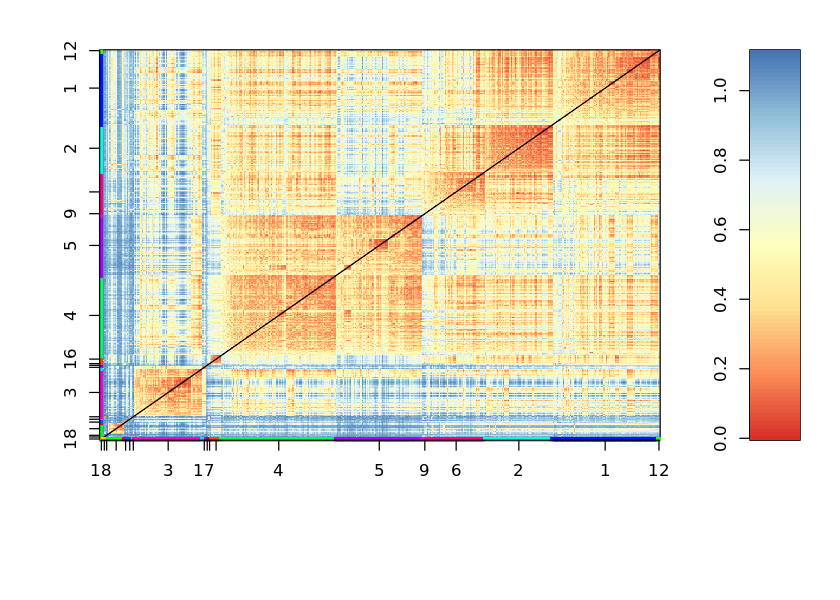

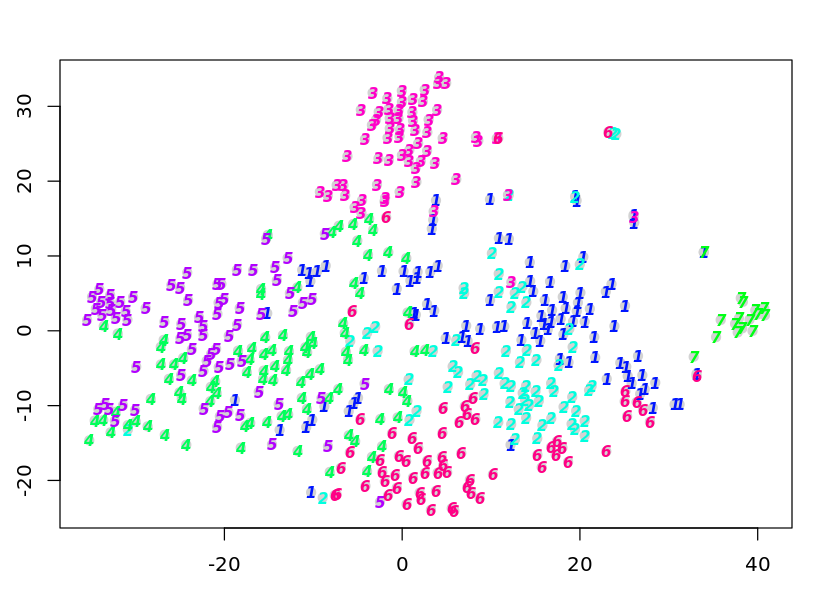

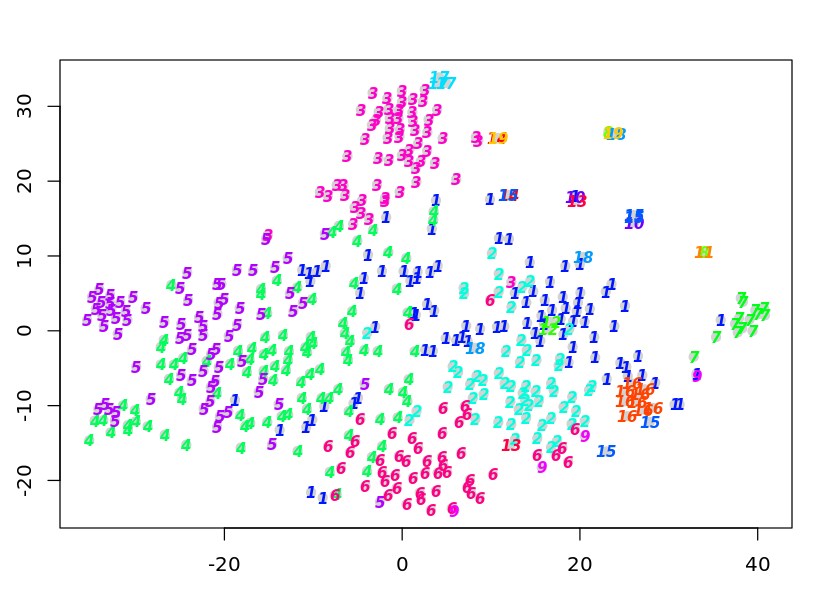

In [141]:
sc_5_900_dogap <- allForOne(sc, 900, 5, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=NULL, semeth="Tibs2001SEmax")

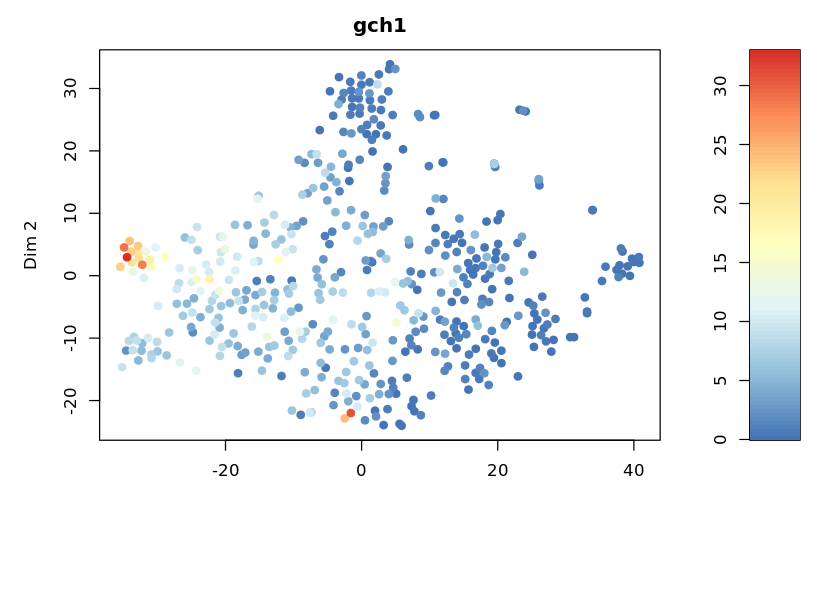

In [153]:
plotexptsne(sc_5_900_dogap, our_interest)
# Bad clustering with 5

In [253]:
## Cluster 7 seems well defined
cmap_5_900  <- investigateClusters(sc_5_900_dogap, c(7), pval = 1e-10)
cmap_5_900

$table
   cln    rownames(table)  mean.ncl  mean.cl        fc           pv
1 cl.7 ENSDARG00000018806 0.1186435 1.649971 13.906961 1.982619e-15
2 cl.7         zgc:173915 0.1740226 1.758739 10.106384 3.341351e-14
3 cl.7            slc40a1 0.1247279 1.376738 11.037932 1.333100e-12
4 cl.7         CR318588.4 0.3330777 2.092769  6.283127 5.028651e-12
5 cl.7         BX322618.1 0.1563285 1.410164  9.020519 4.057457e-11
          padj
1 6.998646e-13
2 5.897485e-12
3 1.568614e-10
4 4.437784e-10
5 2.864565e-09

$names
     [,1]       
cl.7 Character,5

## Generating a Cell "Atlas"

Here we will attempt to find common genes between noticeable clusters across different analyses aggregated from the Brute force methods we have just perfomed, and we will measure their robustness by their frequency.

In [299]:
#cmap_2_900
summ1 <- rbind(
    cbind("2_1500", rownames(cmap_2_1500$names), cmap_2_1500$names),
    cbind("2_2000", rownames(cmap_2_2000$names), cmap_2_2000$names),
    cbind("2_3000", rownames(cmap_2_3000$names), cmap_2_3000$names),
    cbind("3_900", rownames(cmap_3_900$names), cmap_3_900$names),
    cbind("3_1500", rownames(cmap_3_1500$names), cmap_3_1500$names),
    cbind("5_900", rownames(cmap_5_900$names), cmap_5_900$names)
)
rownames(summ1) <- sapply(1:dim(summ1)[1], FUN=function(n){
    intToUtf8(n + 64)
})
colnames(summ1) <- c("Thresh", "Clust.", "Significant Genes (pval < 1e-10)")
summ1

,Thresh,Clust.,Significant Genes (pval < 1e-10)
A,2_1500,cl.4,"ENSDARG00000027464, havcr1 , lgmn , ctsz , zgc:173915 , CR318588.4 , slc7a7 , zgc:171509 , mfap4 , si:dkey-5n18.1 , arpc1b , ctsd , BX901920.1 , cd63 , tmsb4x , BX322618.1 , npc2 , cx32.2 , cmklr1"
B,2_1500,cl.13,"si:ch211-133n4.6, mdka , krt8 , stm , rplp1 , rpl36a , rps2 , rps9 , RPL41 , eef1a1l1 , rpl8 , gch1 , rplp2l , eef1b2 , rpl18a , rpl15 , rpl10a , rplp0"
C,2_2000,cl.5,"epha4b , onecut1"
D,2_2000,cl.6,"hapln1a, rplp1 , RPL41"
E,2_2000,cl.9,"gch1 , atp1b1b , adgrb1b , onecut1 , ENSDARG00000087386"
F,2_2000,cl.10,"zfhx4, nhlh2, otpa"
G,2_2000,cl.22,
H,2_3000,cl.8,"gch1 , atp1b1b , ENSDARG00000087386, adgrb1b , onecut1 , ENSDARG00000091371"
I,2_3000,cl.11,"zfhx4 , nhlh2 , otpa , unc5db"
J,2_3000,cl.12,"vip , ENSDARG00000096145"


### Similarity Matrix

Let's create a similarity matrix to see how well these gene clusters overlap.

In [311]:
A = summ1[,3]
B = A
x = matrix(,nrow = length(A), ncol = length(B));

for (i in 1:length(A)){
    for (j in 1:length(B)){
        #print(A[[i]][A[[i]] %in% B[[j]]])
        if (i >= j){
            x[i,j]<- length(A[[i]][A[[i]] %in% B[[j]]])
        } else {
            x[i,j] <- -Inf
        }        
    }
}
colnames(x) <- sub("_cl.", ".", rownames(summ1))
rownames(x) <- colnames(x)
x

getThoseCommon <- function(let1, let2){
    return(
        summ1[[let1,3]][
            summ1[[let1,3]] %in% summ1[[let2,3]]
        ]
    )
}


#lapply()
#summ1[[1,3]] %in% summ1[[2,3]]

,A,B,C,D,E,F,G,H,I,J,K,L,M,N,O
A,19,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
B,0,18,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
C,0,0,2,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
D,0,2,0,3,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
E,0,1,1,0,5,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
F,0,0,0,0,0,3,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
G,0,0,0,0,0,0,0,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
H,0,1,1,0,5,0,0,6,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
I,0,0,0,0,0,3,0,0,4,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
J,0,0,0,0,0,0,0,0,0,2,-Inf,-Inf,-Inf,-Inf,-Inf


Many of these clusters overlap between different Thresholds (analyses), and we can piece together some common patterns:

 * A, M, K have 14 genes in common:
    * BX901920.1 , BX322618.1  
    * CR318588.4 , ctsz , ctsd , cd63  
    * ENSDARG00000027464  
    * havcr1  
    * lgmn  
    * mfap4  
    * slc7a7 , si:dkey-5n18.1  
    * zgc:173915 , zgc:171509
 * A, K, O have 3 genes in common:
    * BX322618.1  
    * CR318588.4  
    * zgc:173915
 * E, H, N have 4 genes in common:
    * atp1b1b , adgrb1b  
    * gch1  
    * onecut1    
 * F, I have 3 genes in common:
    * nhlh2  
    * otpa  
    * zfhx4


From these we will define our cell types, and search for them in the original (2_900) clustering and the 2_2000 clustering. (Note that A,K,O genes overlap the A,M,K set, and so these will be merged)

### Defining our Atlas + measuring validity

In [591]:
cell.AMKO <- getThoseCommon("M","K")
cell.EHN <- getThoseCommon("N","H")
cell.FI <- getThoseCommon("F","I")

options(repr.plot.height = 5)

[1] "ENSDARG00000027464" "lgmn"               "havcr1"            
 [4] "ctsz"               "zgc:173915"         "CR318588.4"        
 [7] "slc7a7"             "si:dkey-5n18.1"     "mfap4"             
[10] "zgc:171509"         "cd63"               "BX901920.1"        
[13] "BX322618.1"         "ctsd"

[1] "gch1"    "onecut1" "atp1b1b" "adgrb1b"

[1] "zfhx4" "nhlh2" "otpa"

#### AMKO cells

[Plot 2_900]

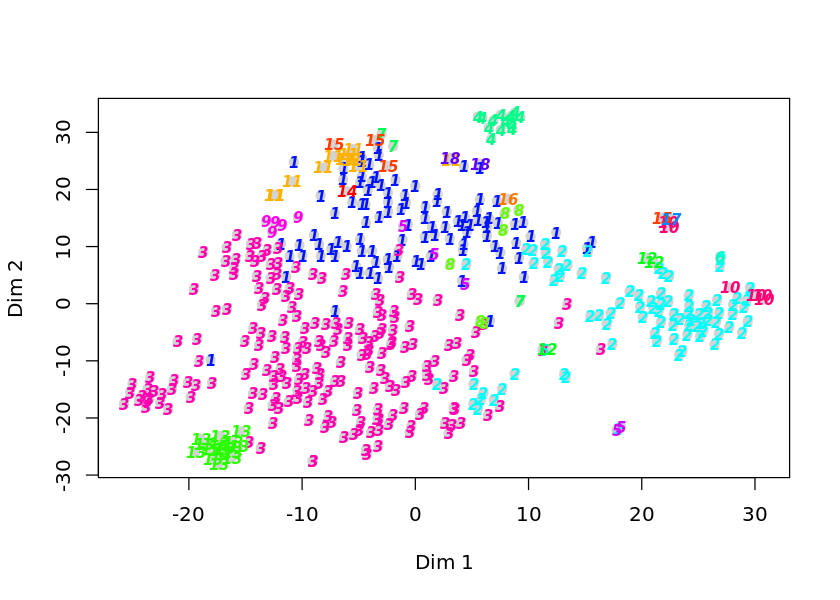

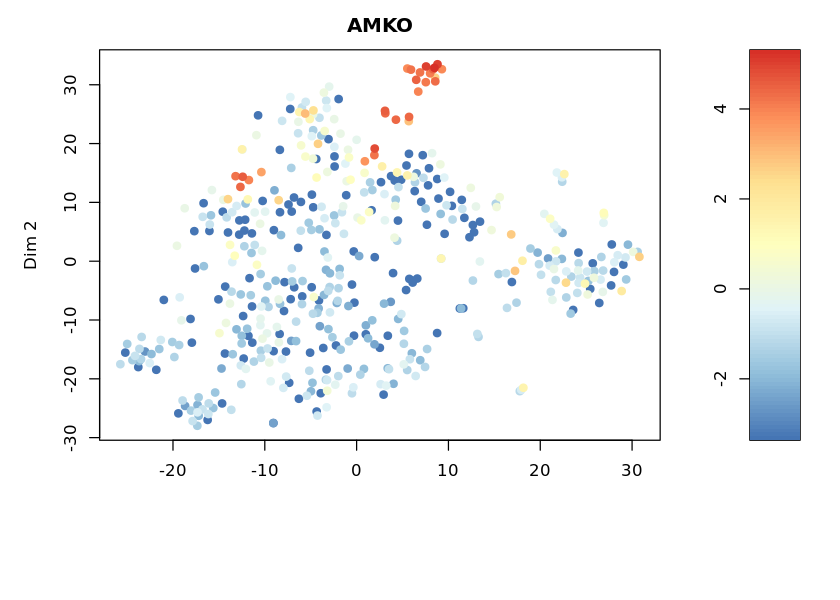

In [351]:
plottsne(sc_2_900_dogap)
plotexptsne(sc_2_900_dogap, cell.AMKO, n = "AMKO", logsc=T)

The AMK= cells span clusters 4, 18, the near edge of 1, and some remote 11 cells.

[Plot 2_2000]

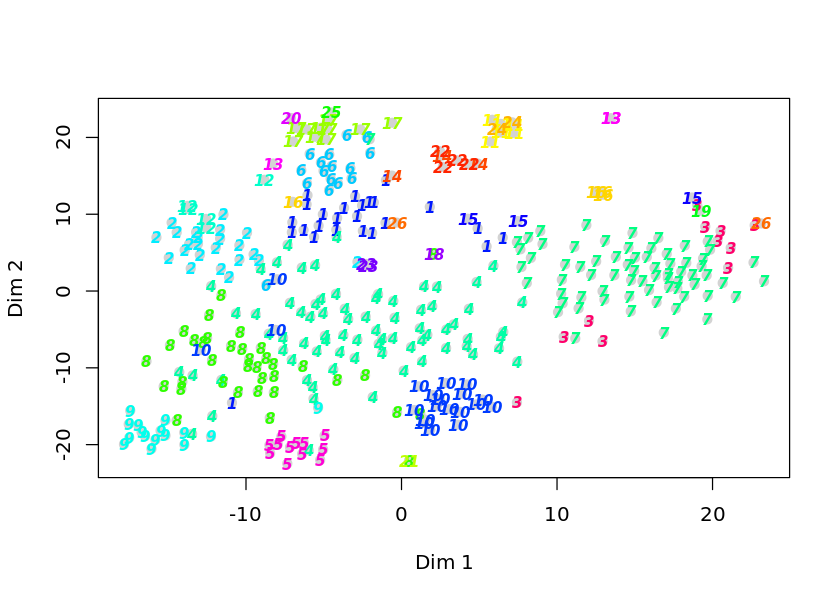

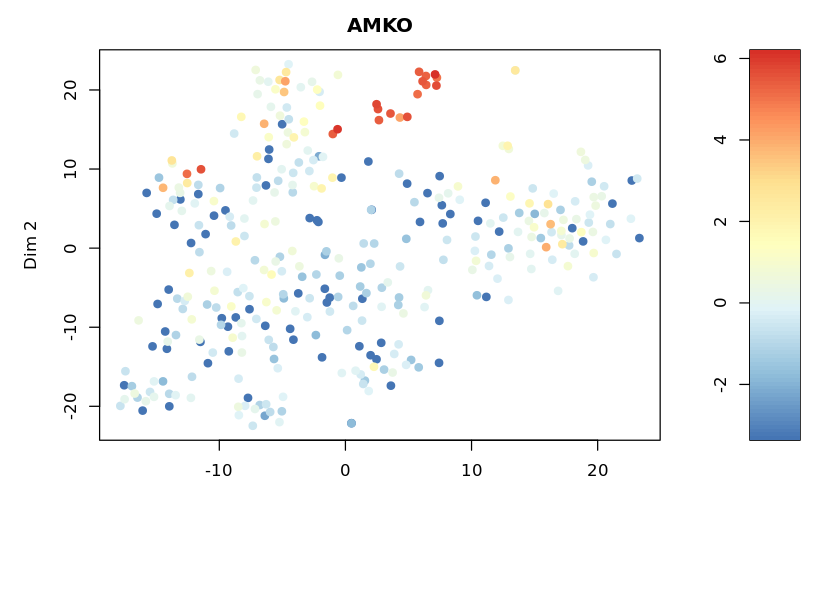

In [352]:
plottsne(sc_2_2000_dogap)
plotexptsne(sc_2_2000_dogap, cell.AMKO, n = "AMKO", logsc=T)

We see a more concentrated expression of AMK cells around clusters 11, 24, and 22.

-- Verdict: 2_2000 clustering is better for AMK

#### EHN Cells

[Plot 2_900]

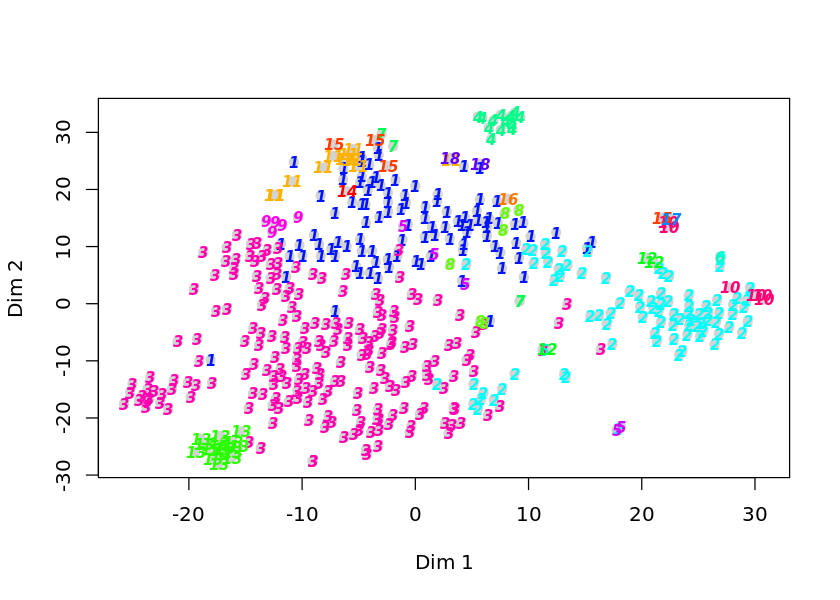

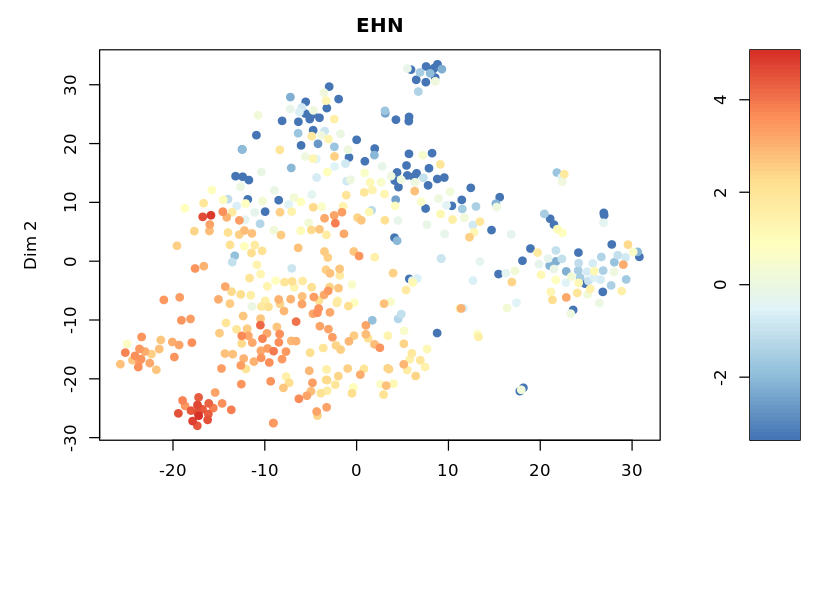

In [348]:
plottsne(sc_2_900_dogap)
plotexptsne(sc_2_900_dogap, cell.EHN, n = "EHN", logsc=T)

Our EHN cells are localised mostly in cluster 13, but are also prevalent throughout cluster 3.

[Plot 2_2000]

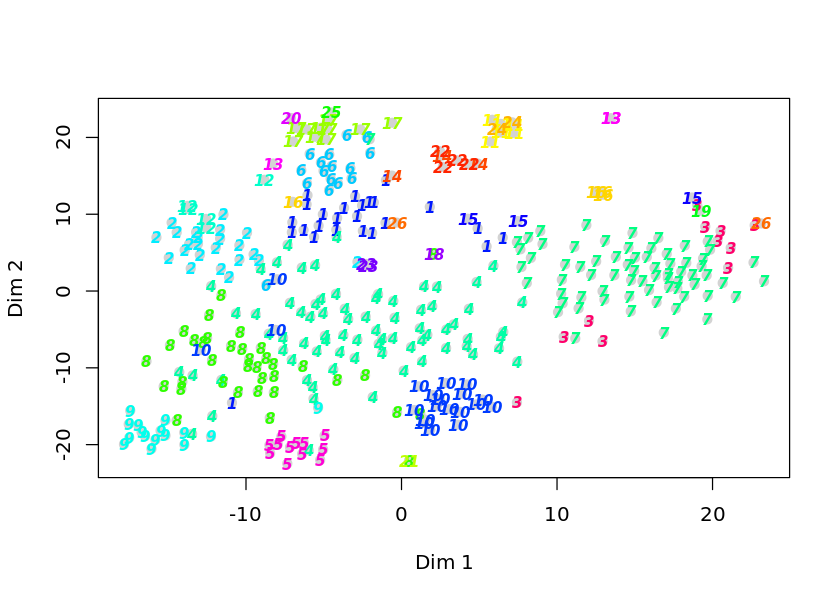

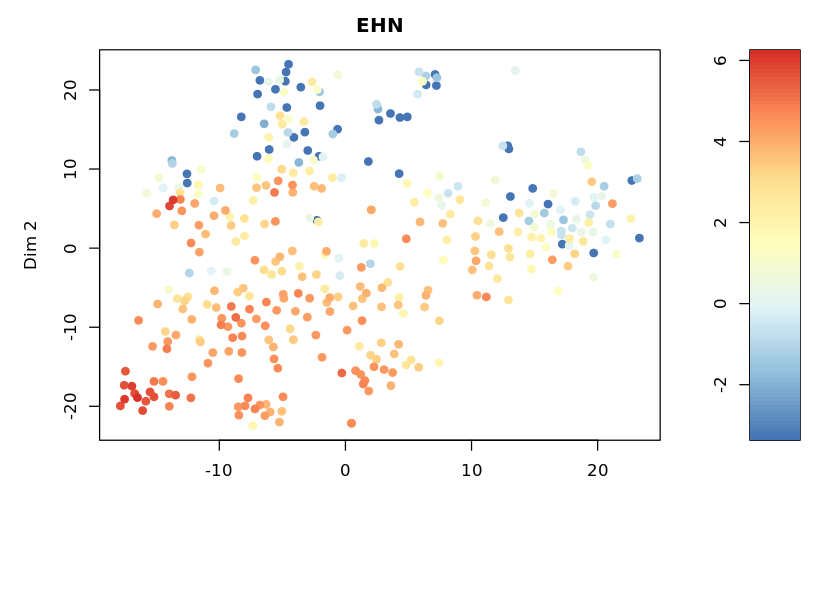

In [353]:
plottsne(sc_2_2000_dogap)
plotexptsne(sc_2_2000_dogap, cell.EHN, n = "EHN", logsc=T)

Same as before, localised in cluster 9 and prevalent throughout many nearby others.

-- Verdict: Plot 2_900, localises this expression group better than the 2_2000 one does.

#### FI Cells

[Plot 2_900]

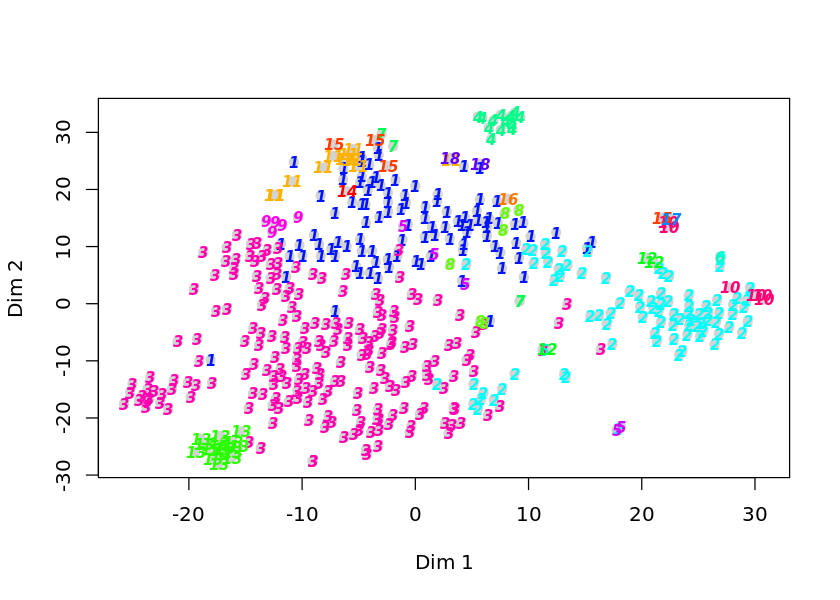

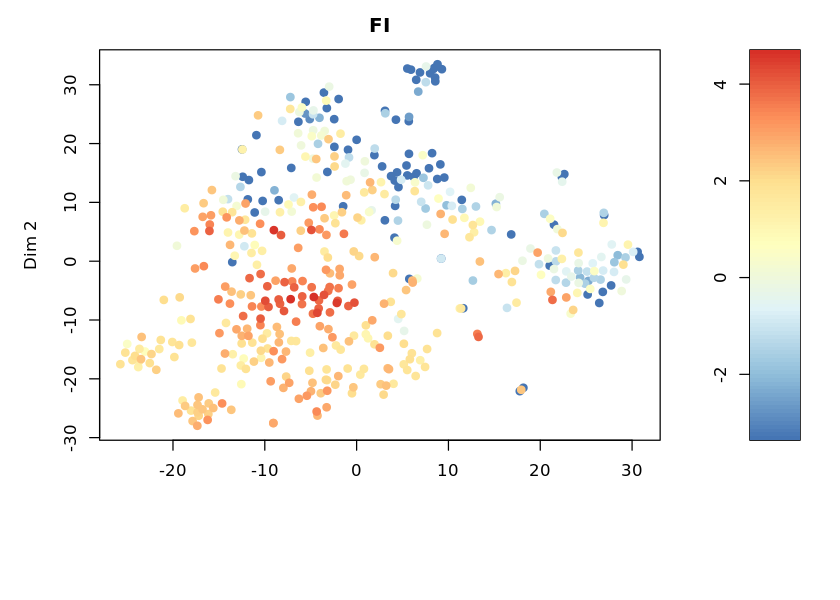

In [354]:
plottsne(sc_2_900_dogap)
plotexptsne(sc_2_900_dogap, cell.FI, n = "FI", logsc=T)

The main expression seems to be in the center of cluster 3, but doesnot actually define the cluster.

[Plot 2_2000]

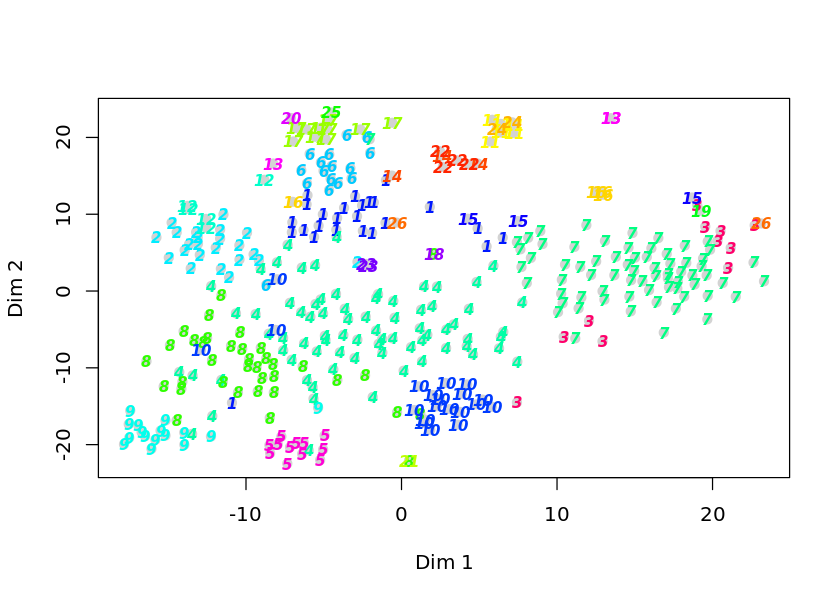

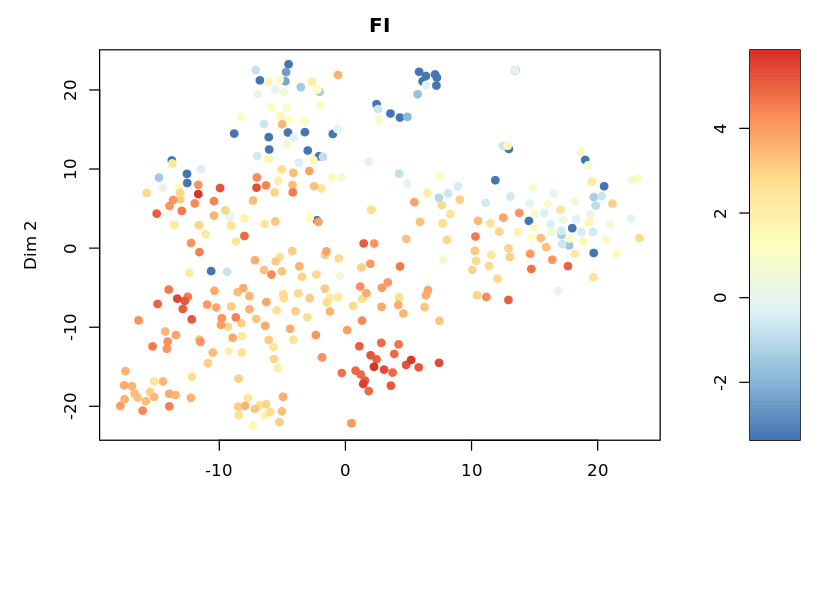

In [356]:
plottsne(sc_2_2000_dogap)
plotexptsne(sc_2_2000_dogap, cell.FI, n = "FI", logsc=T)

Cluster 10 seems to fit the profile better, even though a few cells expressing it a far from the 10 cluster.

-- Verdict: Hard to say, if plot 2_900 had an internal subcluster, it would have fit the profile a lot better. But plot 2_2000 seems to localise most of the expression in one cluster (with a few but perhaps unignorable outliers). Grudgingly say that plot 2_2000 is better.

Here are the 8 clusterings we have processed so far:

Warning message in par(mfrow = c(2, 3), mar = c(0, 0, 0, 0), ann = F, cex = 0.5, :
“"main" is not a graphical parameter”

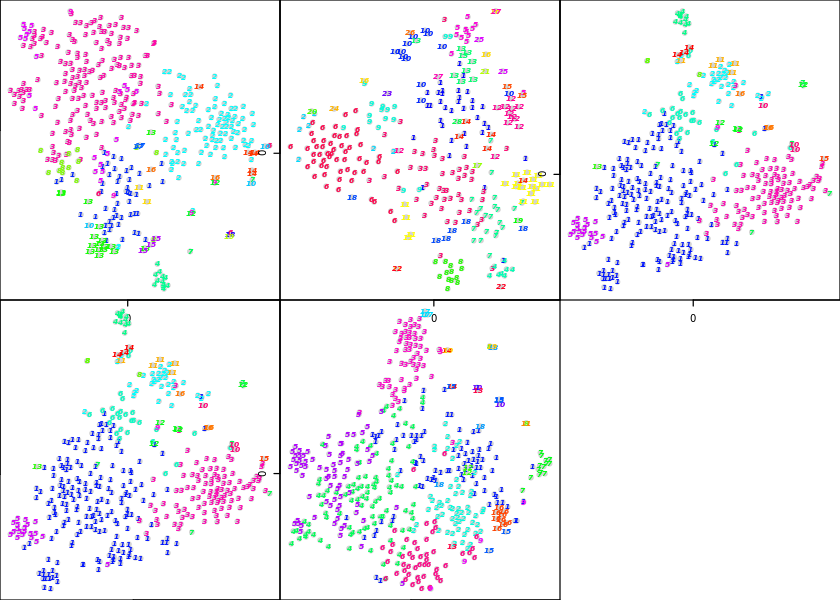

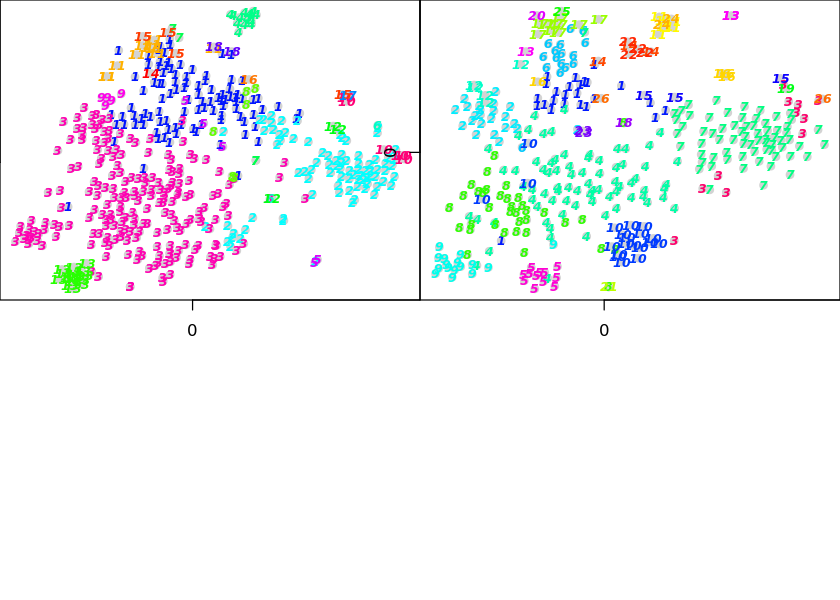

In [381]:
par(mfrow=c(2,3), mar=c(0,0,0,0), ann = F, cex = 0.5, lab = c(1,1, 5), main="ASD")
plottsne(sc_2_1500_dogap, final=T)
plottsne(sc_2_3000_dogap, final=T)
plottsne(sc_3_1500_dogap, final=T)
plottsne(sc_3_1500_dogap, final=T)
plottsne(sc_5_900_dogap, final=T)

par(mfrow=c(2,2), mar=c(0,0,0,0), ann = F,lab = c(1,1, 5))
plottsne(sc_2_900_dogap, final=T)
plottsne(sc_2_2000_dogap, final=T)

#plotexptsne(sc_2_900_dogap, c(cell.AMK, cell.EHN, cell.FI))
#plotexptsne(sc_2_2000_dogap, c(cell.AMK, cell.EHN, cell.FI))


The above two (2_900, and 2_2000) show us our most promising clusters.

One final measure we can do to test the stability of our clusters is to manually set the number of clusters by not setting it via the gap statistic. Here we will experiment with all ranges from 4-12 main clusters.

## Outlier sensitivity (MinTotal = 900, MinExp = 2)

### Clusters = 4

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


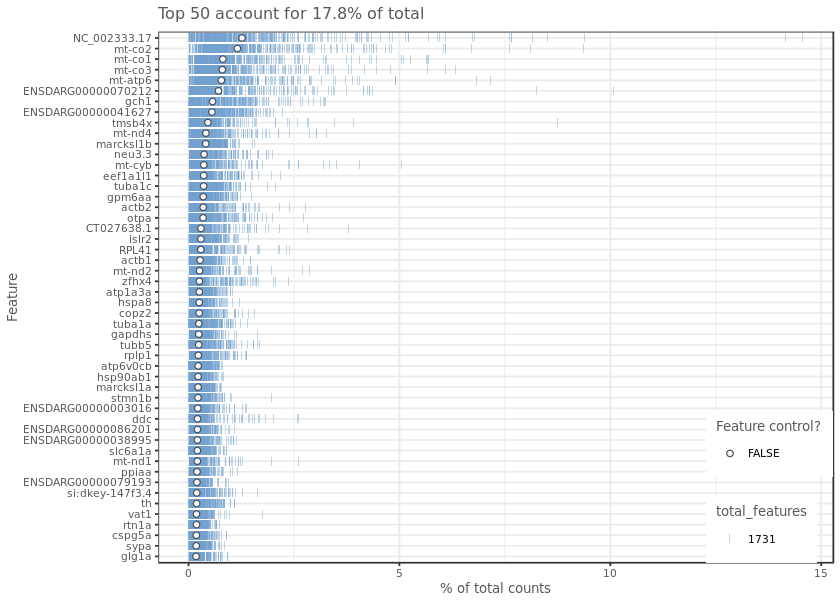

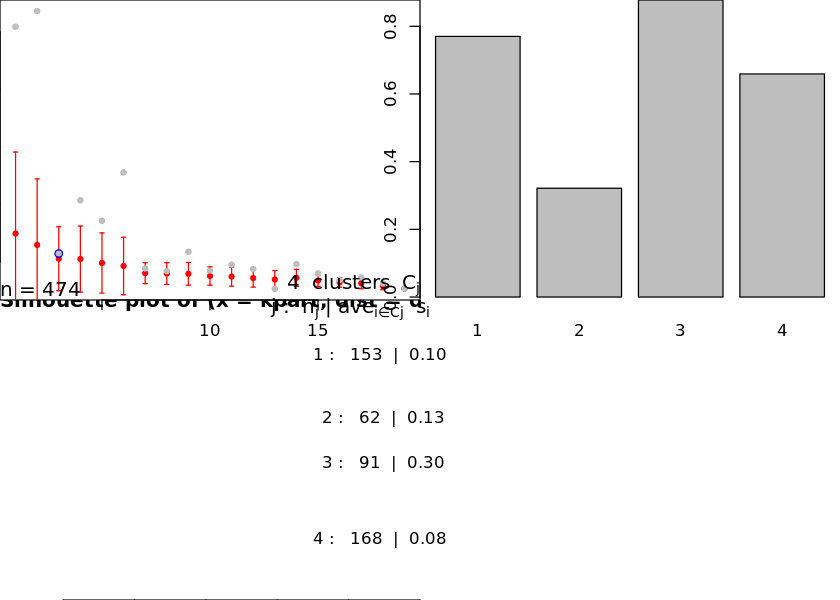

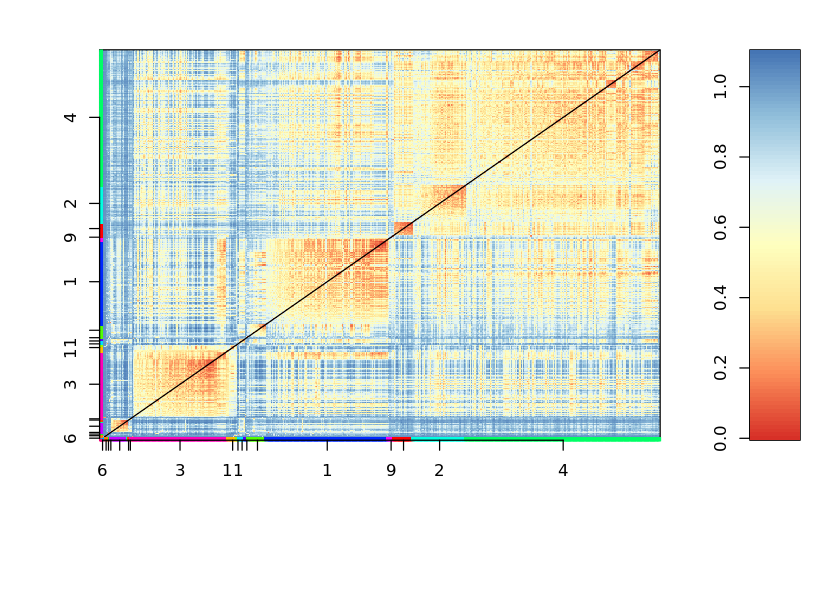

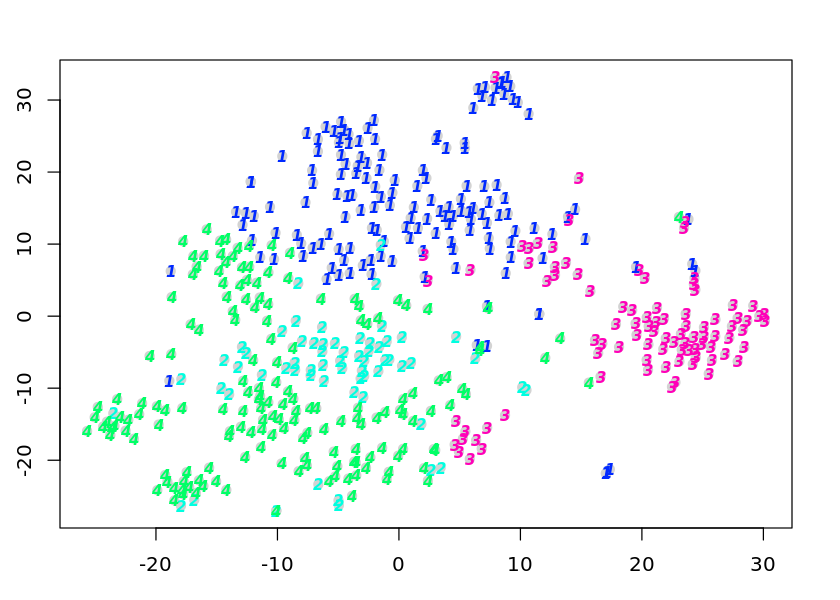

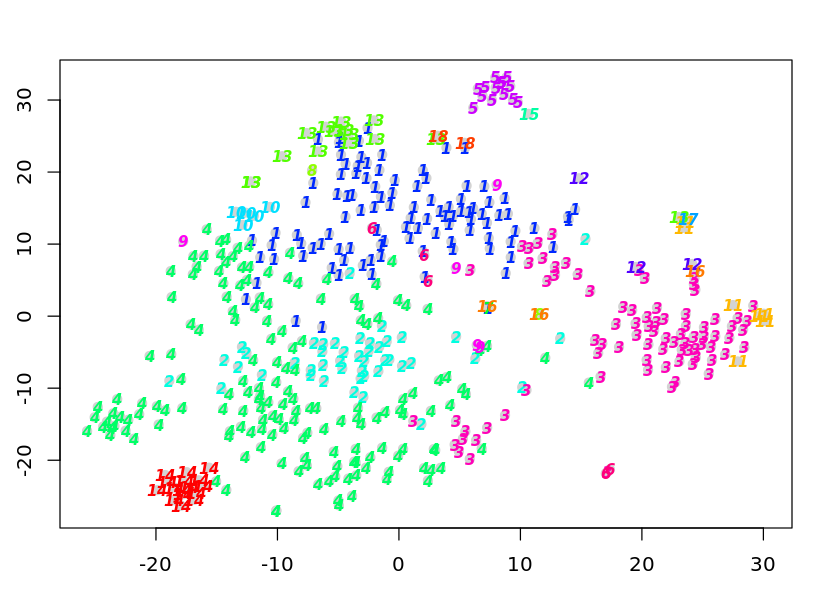

In [383]:
sc_2_900_cl4 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=4, semeth="Tibs2001SEmax")

### Clusters = 5

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


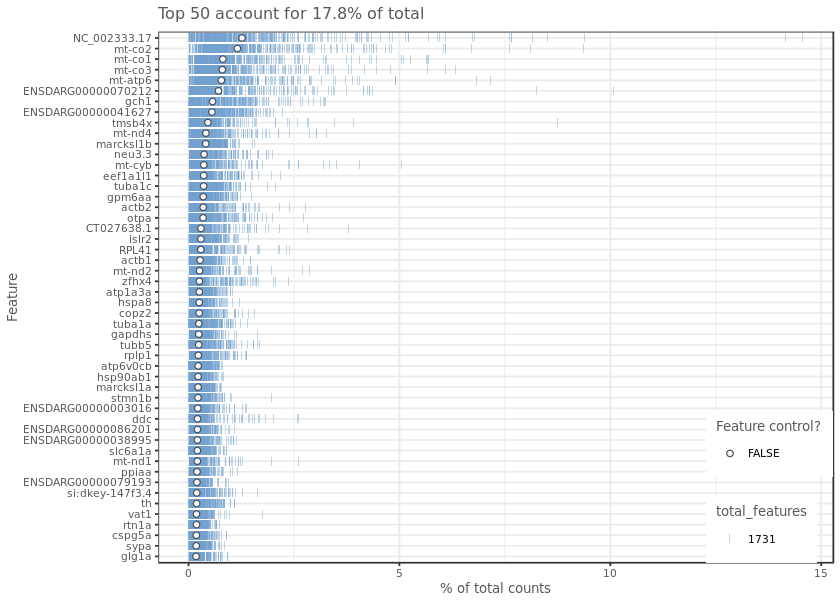

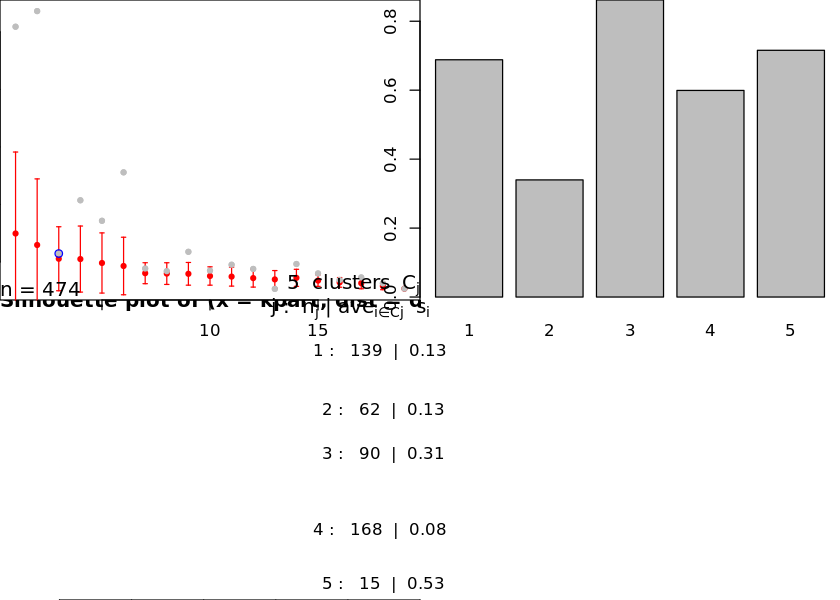

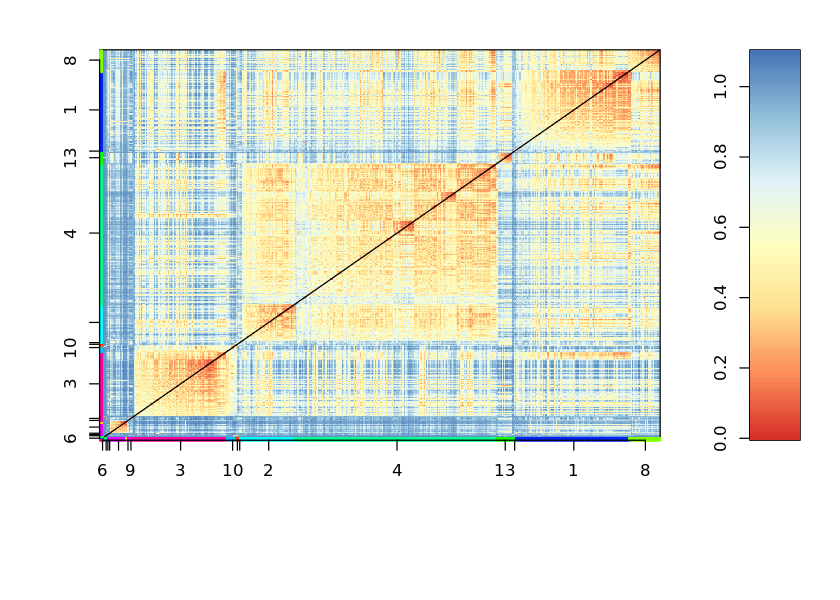

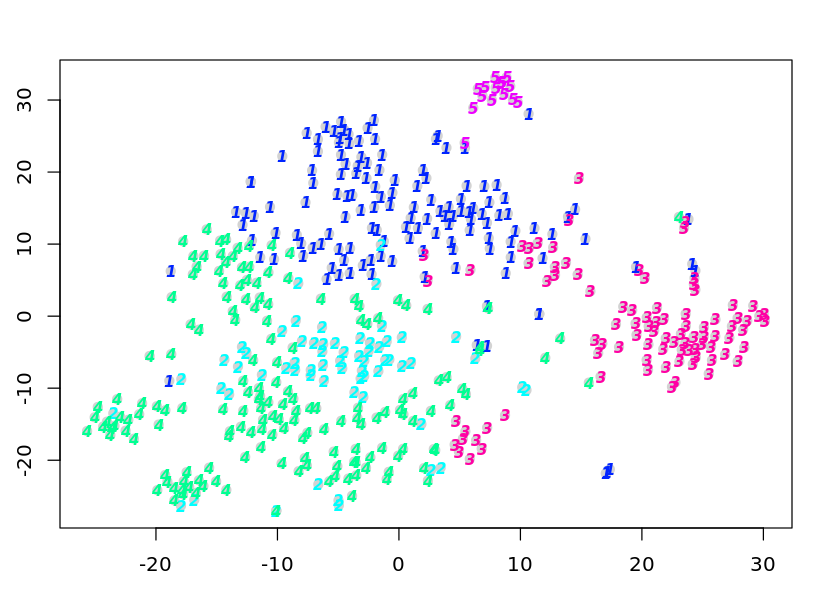

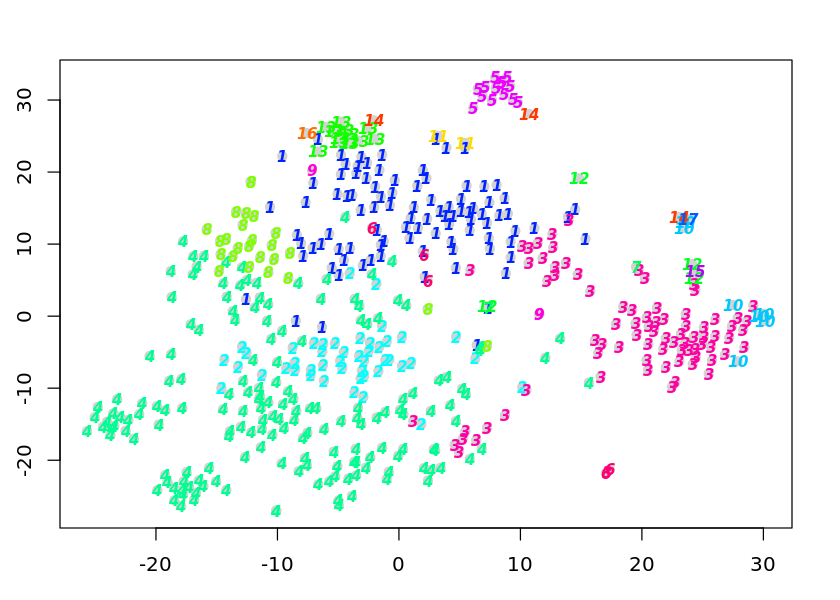

In [384]:
sc_2_900_cl5 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=5, semeth="Tibs2001SEmax")

### Clusters = 6

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


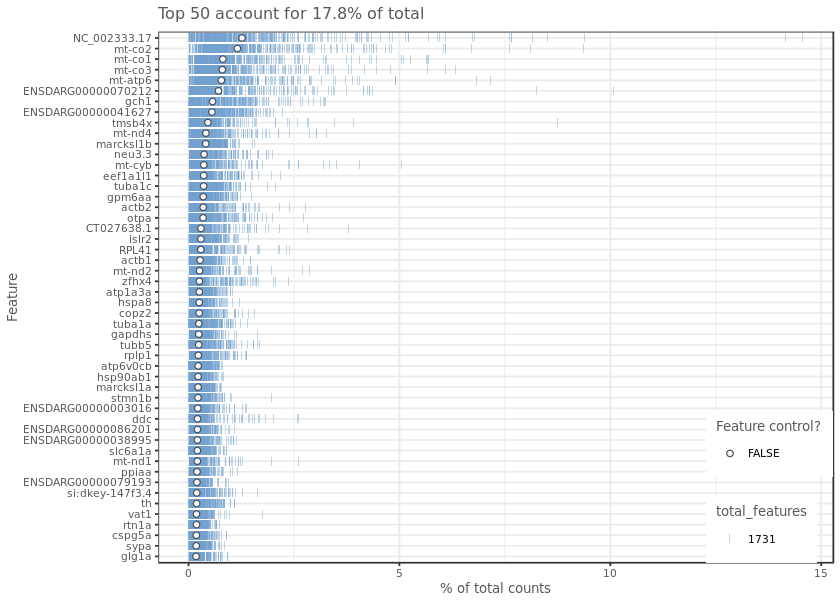

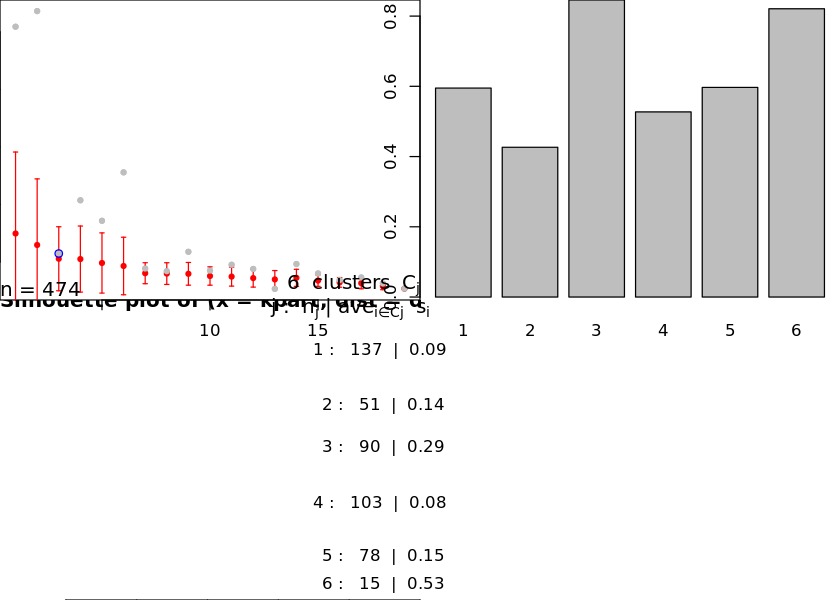

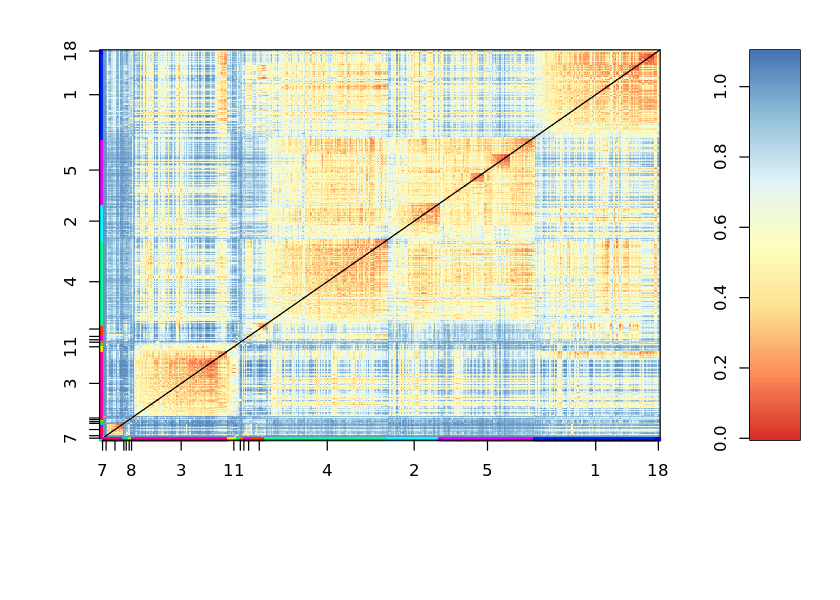

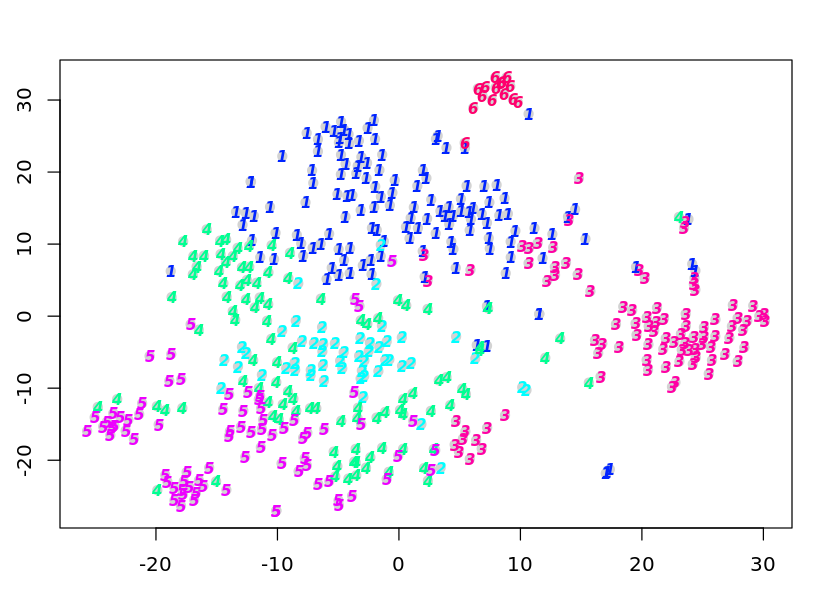

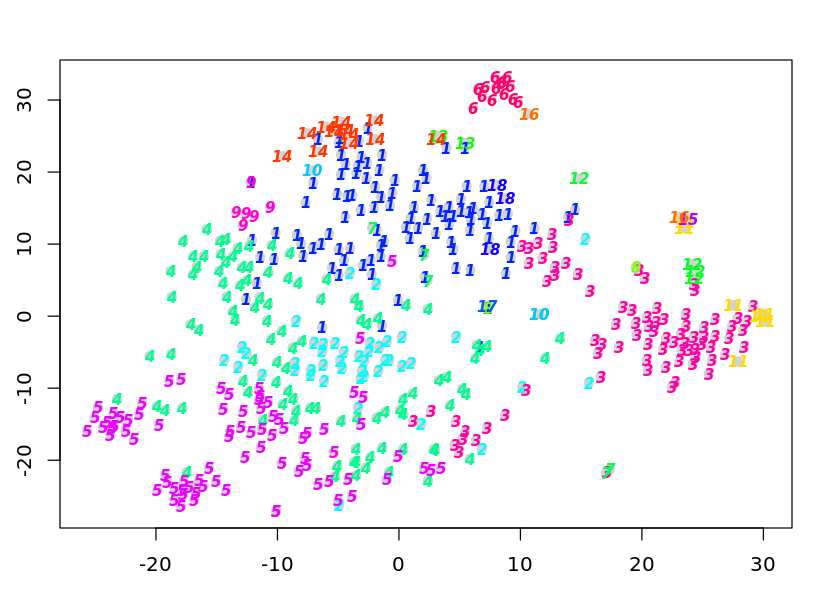

In [385]:
sc_2_900_cl6 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=6, semeth="Tibs2001SEmax")

### Clusters = 7

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


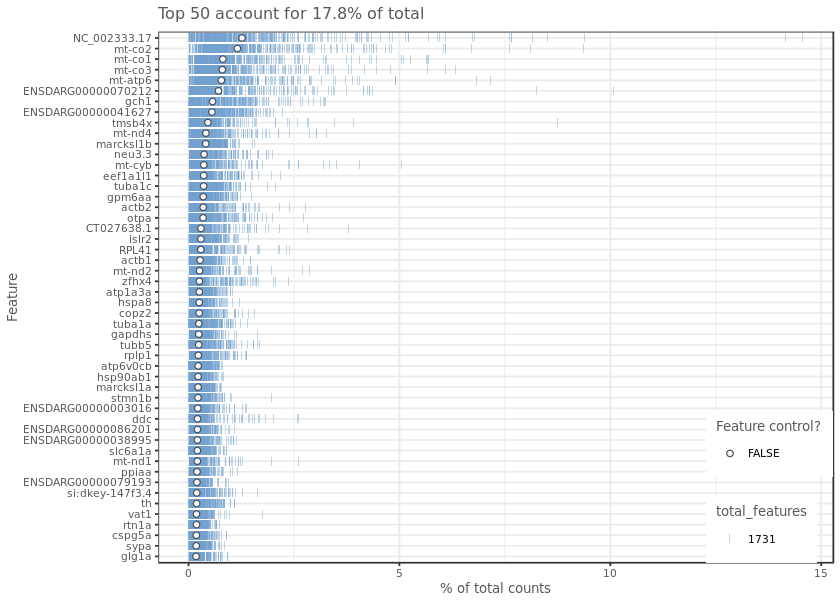

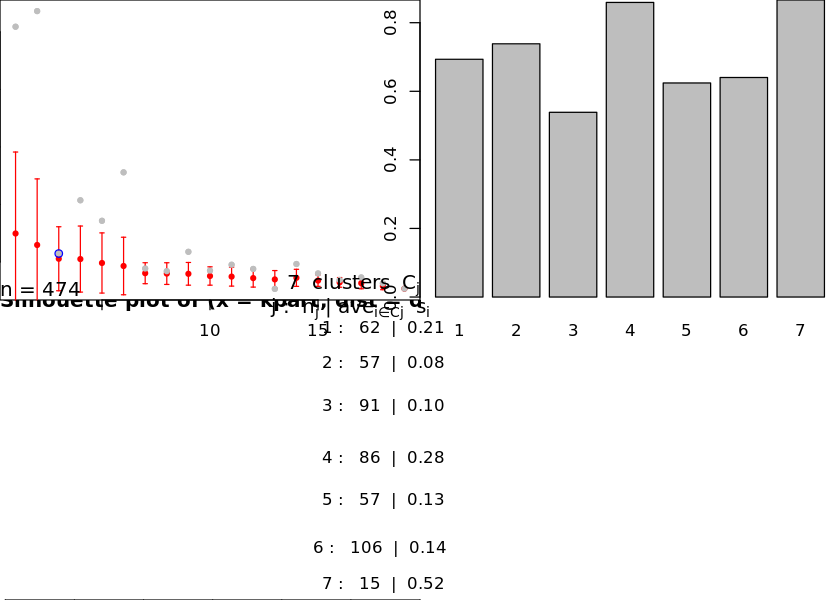

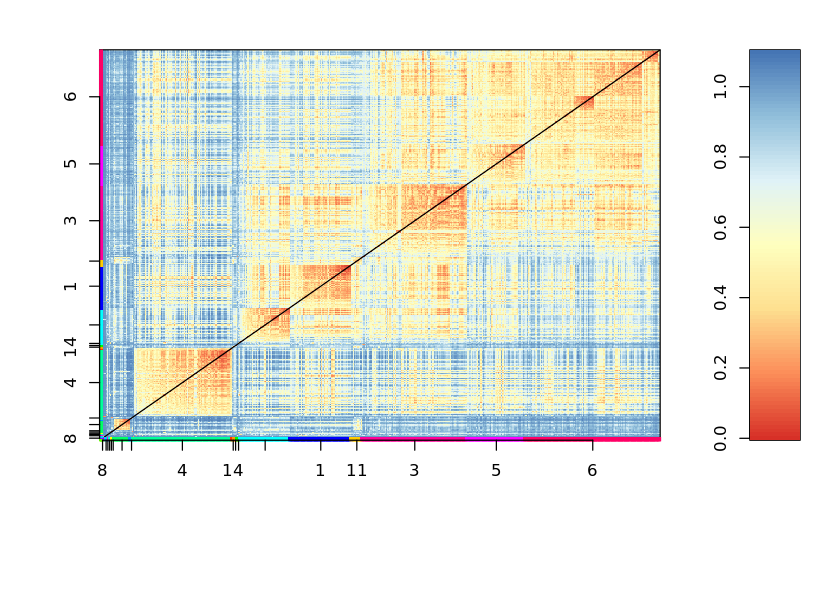

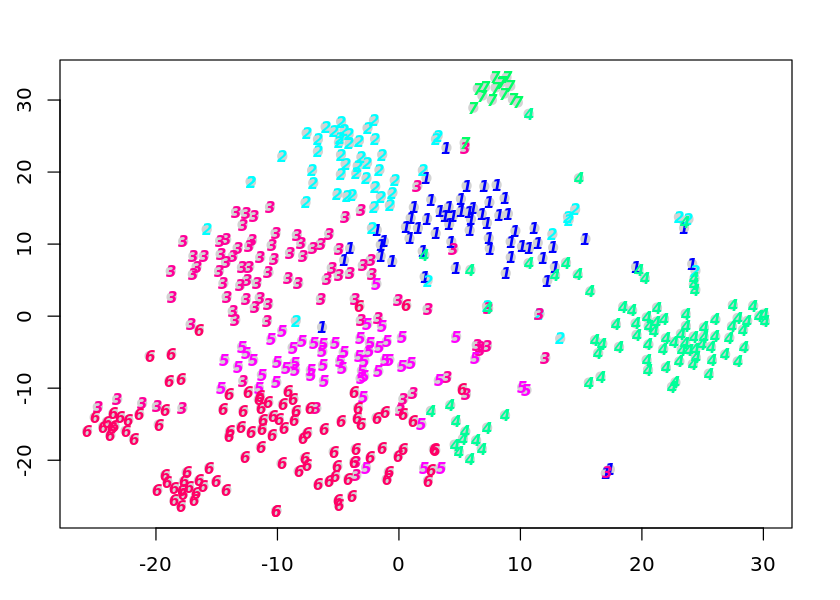

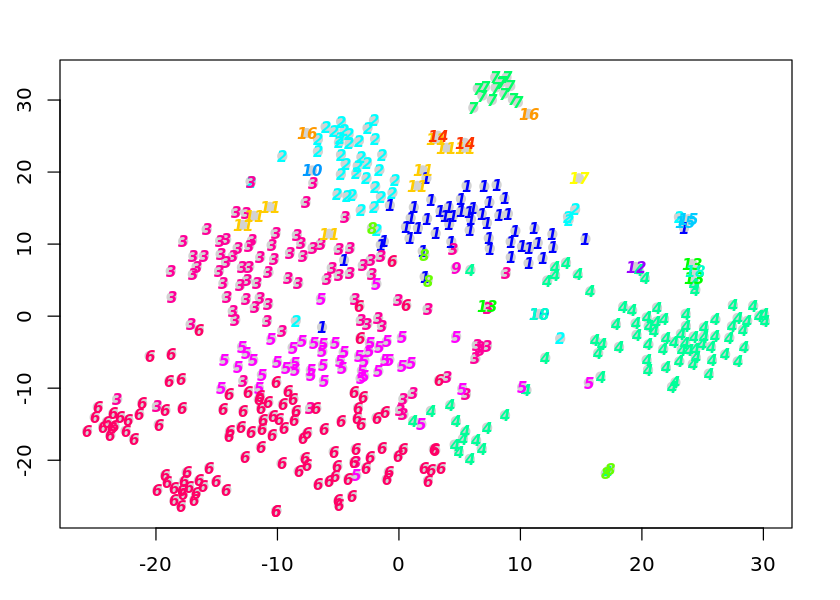

In [386]:
sc_2_900_cl7 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=7, semeth="Tibs2001SEmax")

### Clusters = 8

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


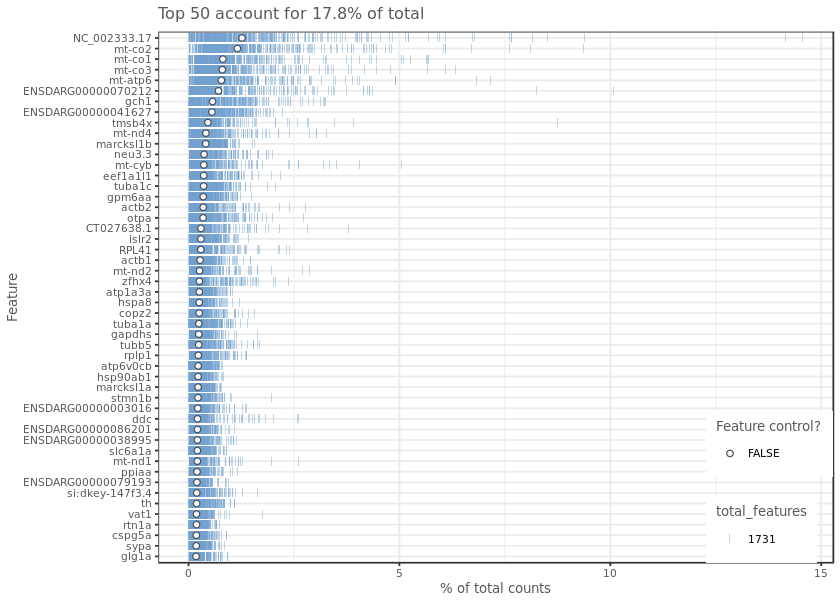

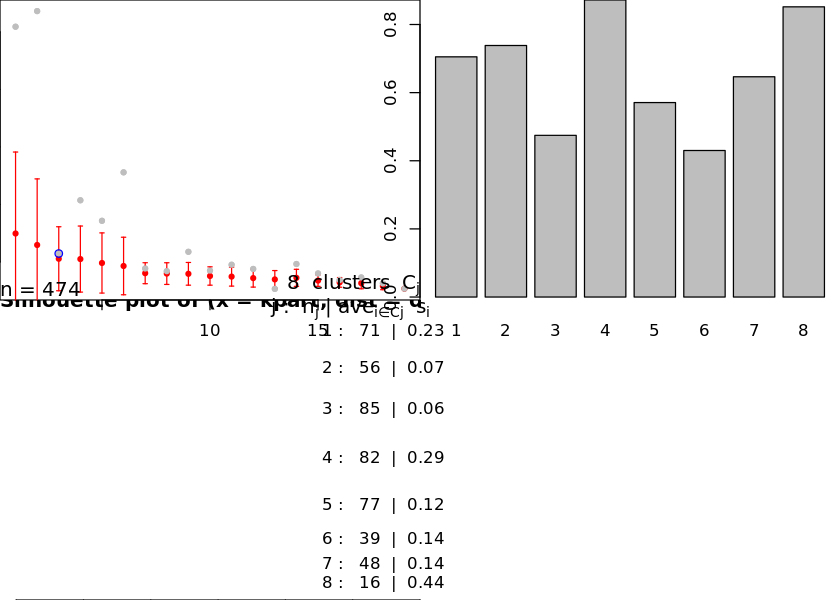

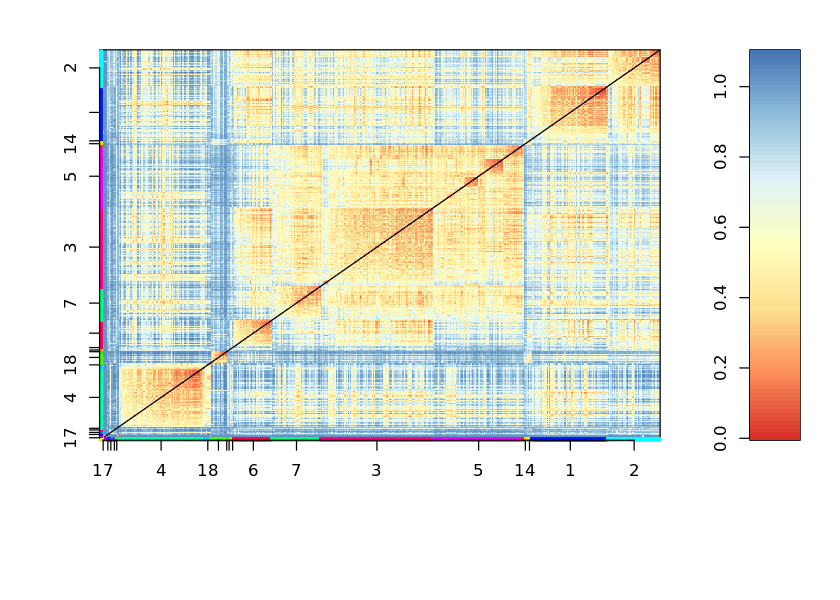

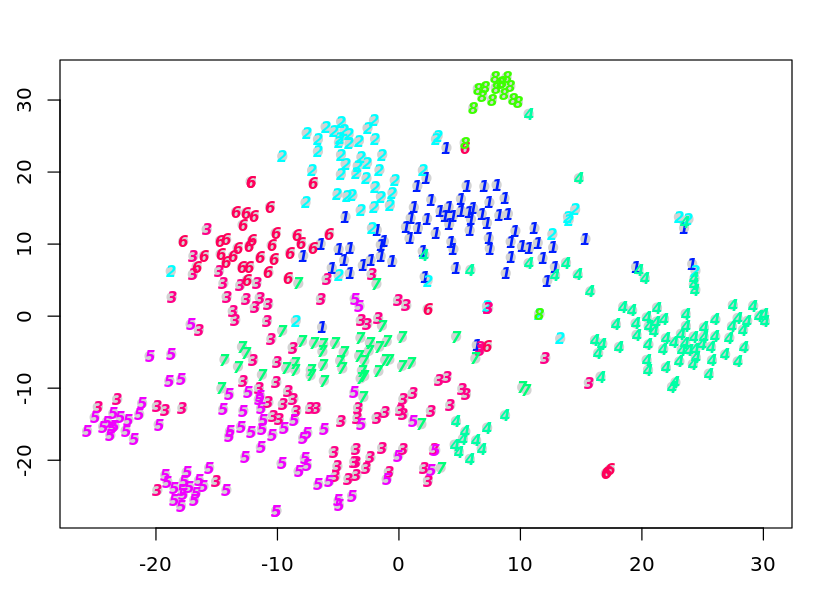

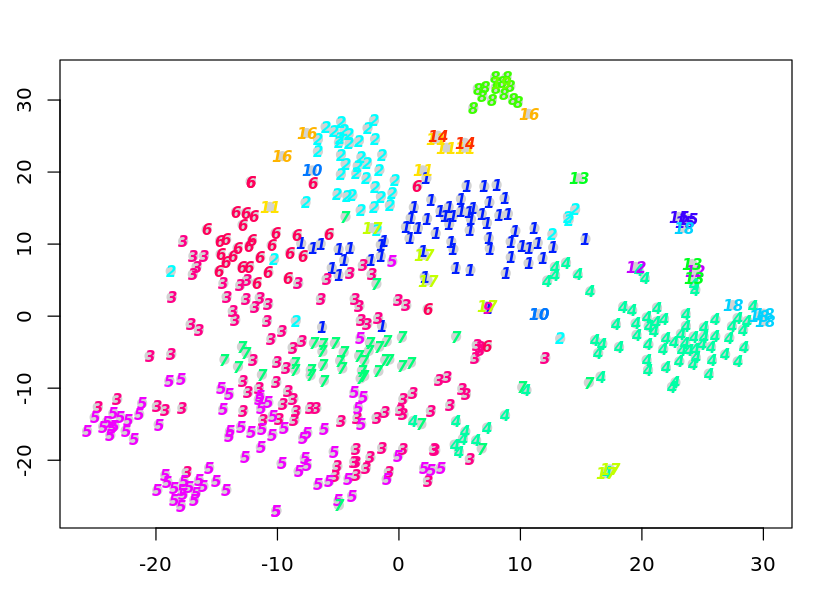

In [387]:
sc_2_900_cl8 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=8, semeth="Tibs2001SEmax")

### Clusters = 9

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


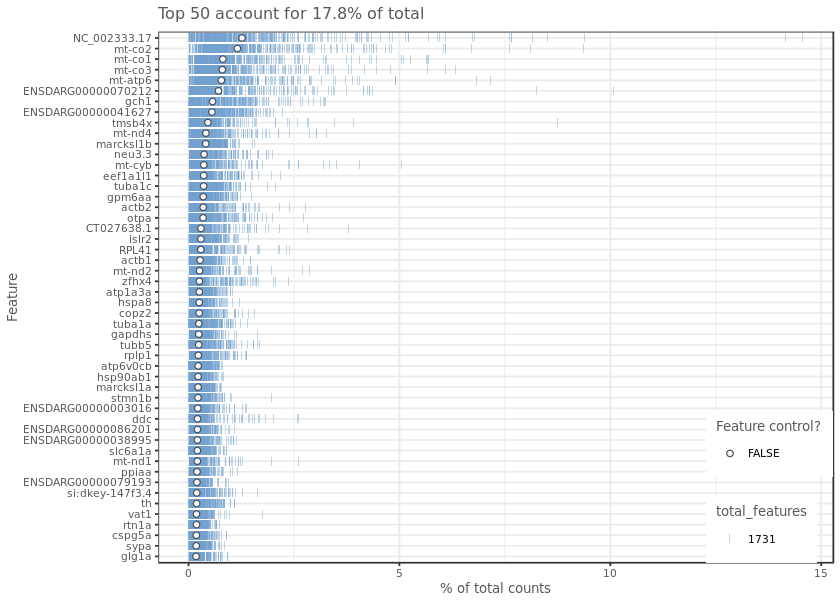

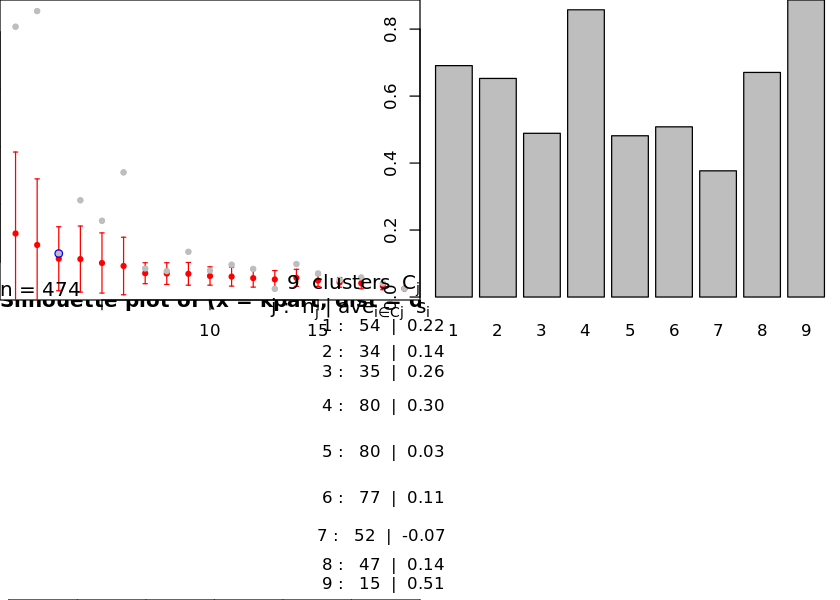

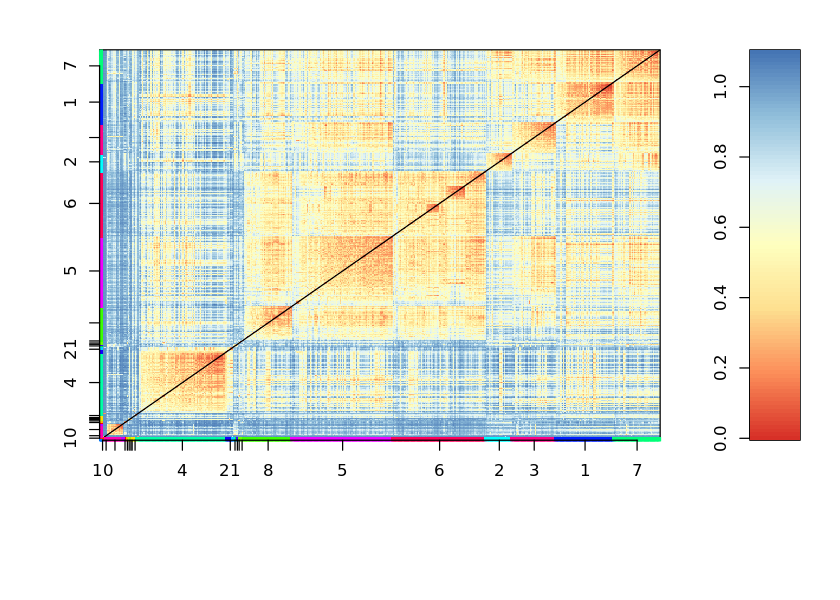

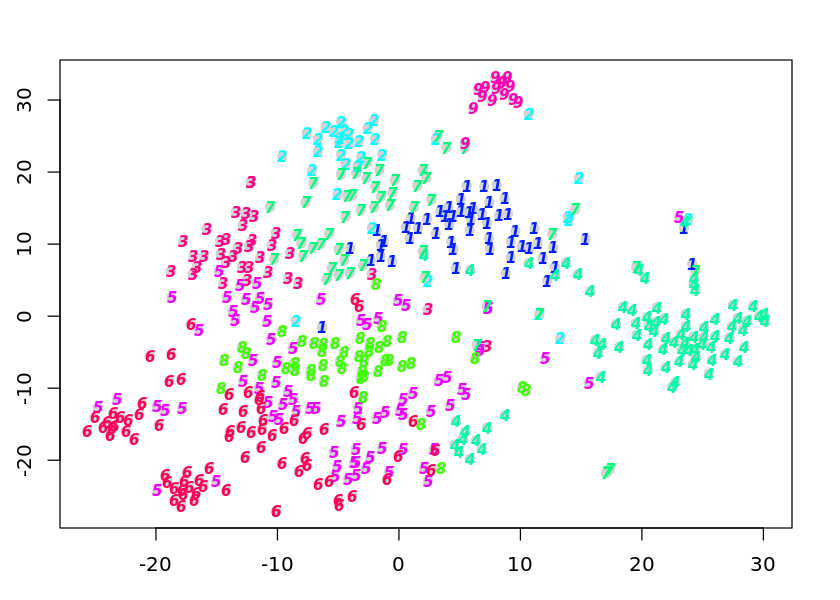

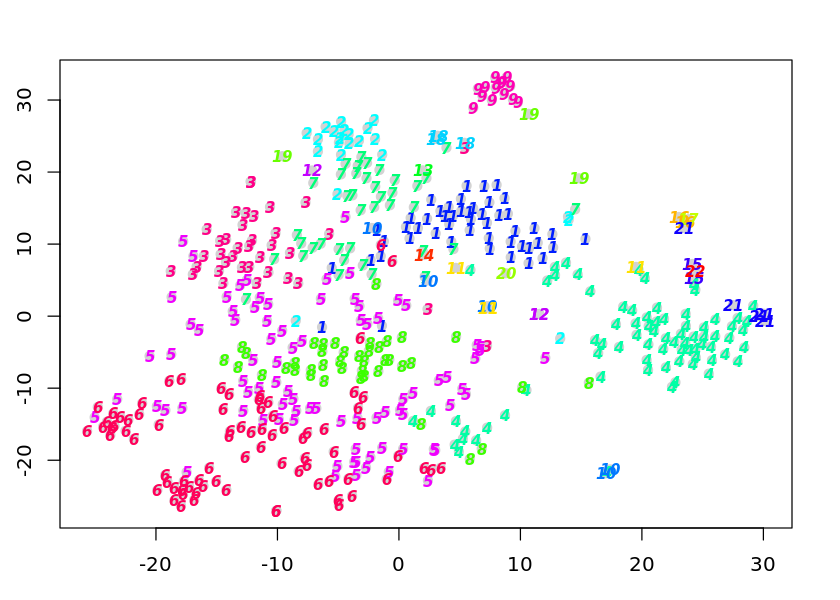

In [388]:
sc_2_900_cl9 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=9, semeth="Tibs2001SEmax")

### Clusters = 10

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


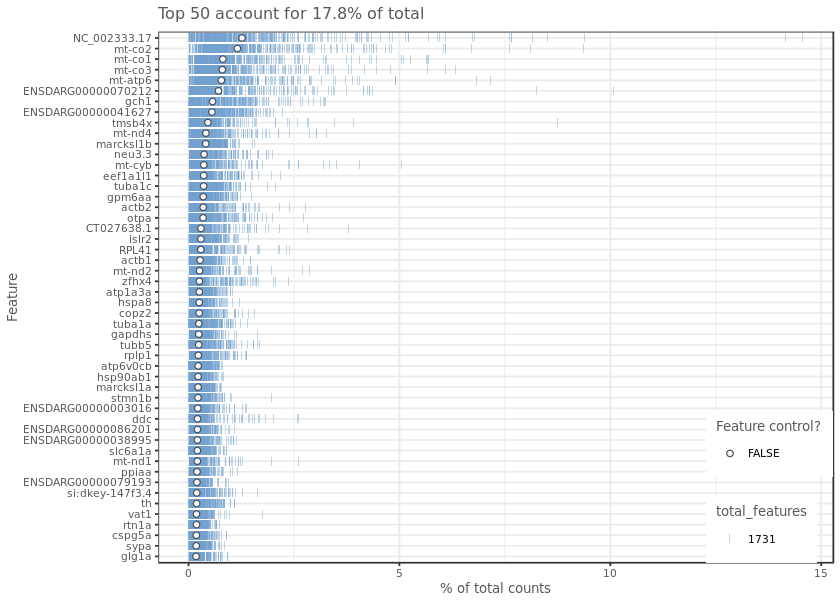

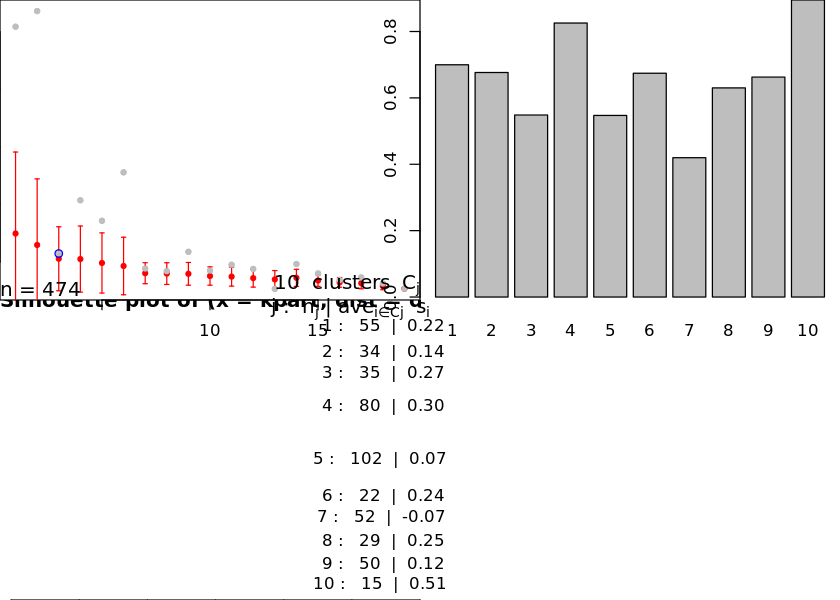

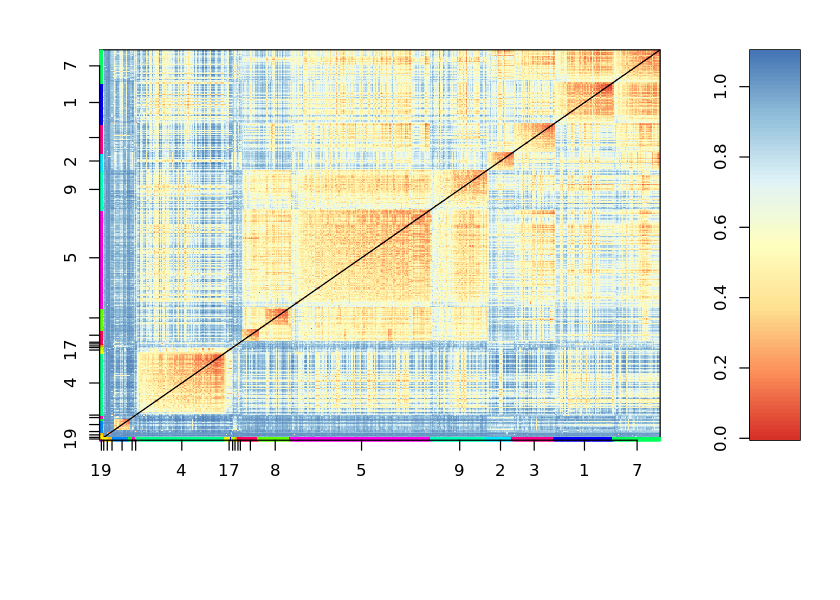

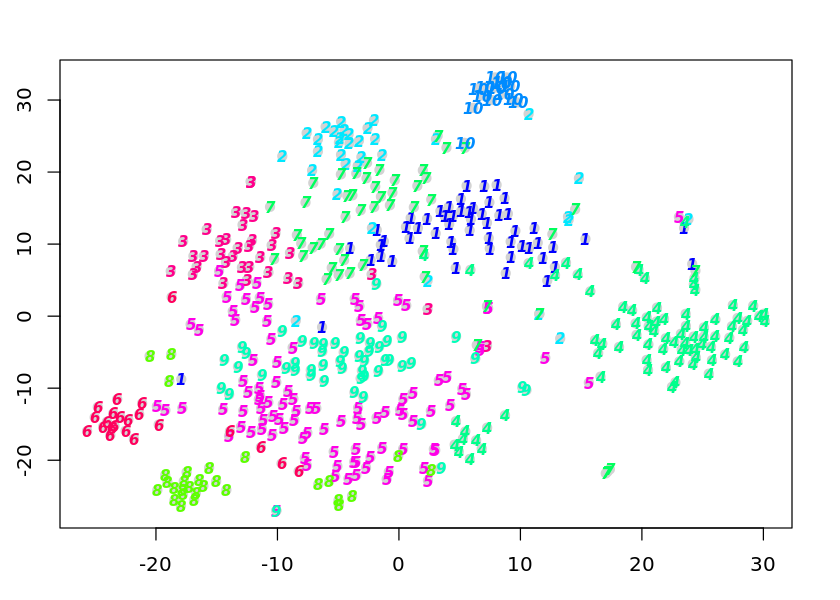

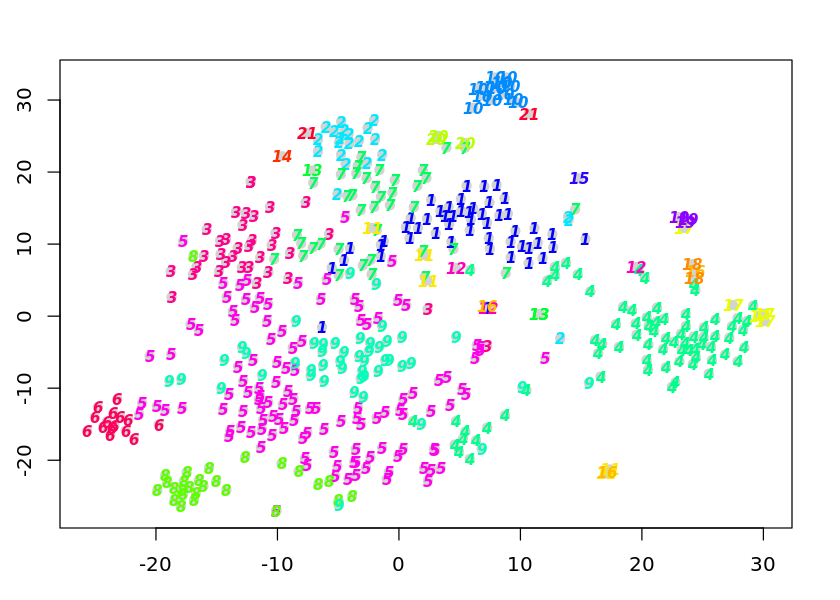

In [389]:
sc_2_900_cl10 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=10, semeth="Tibs2001SEmax")

### Clusters = 11

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


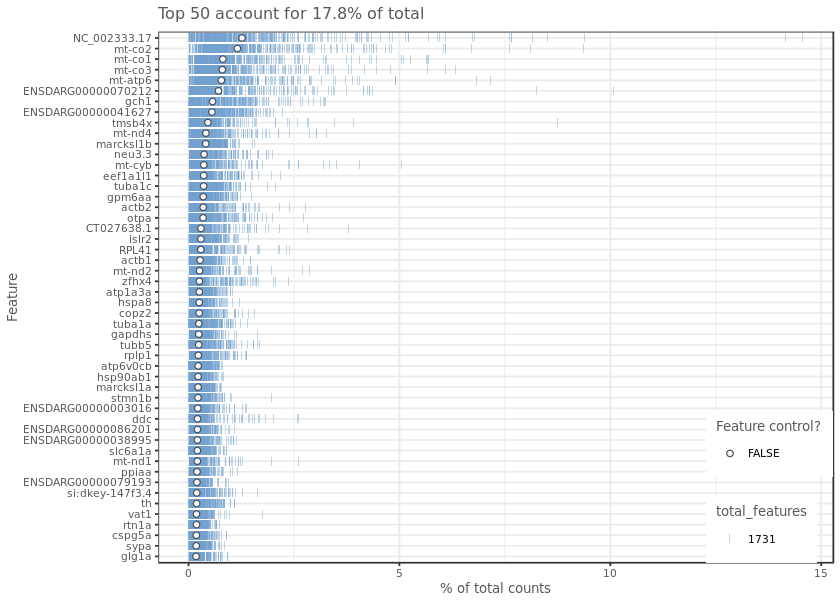

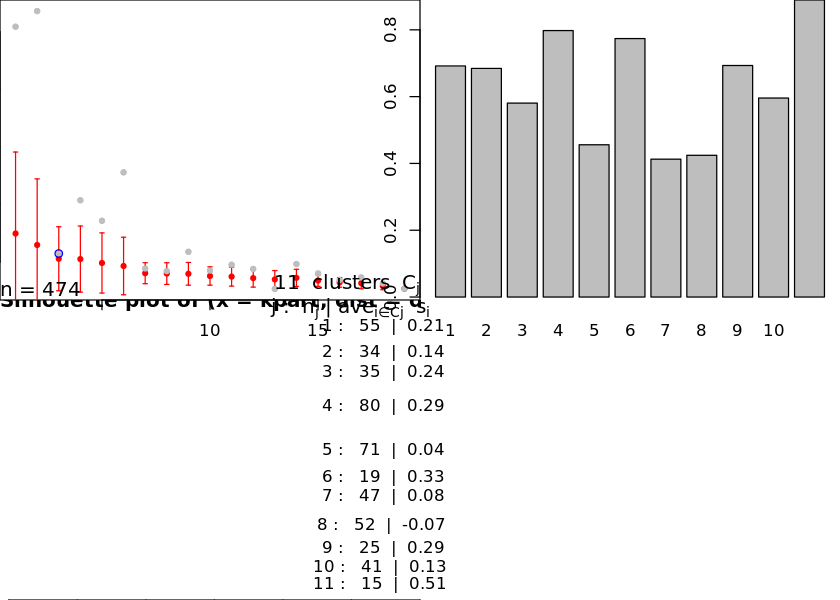

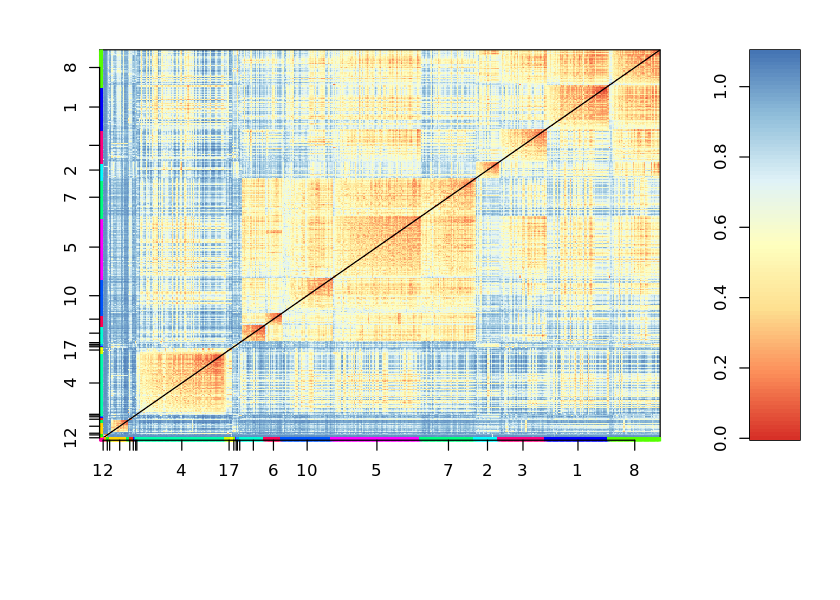

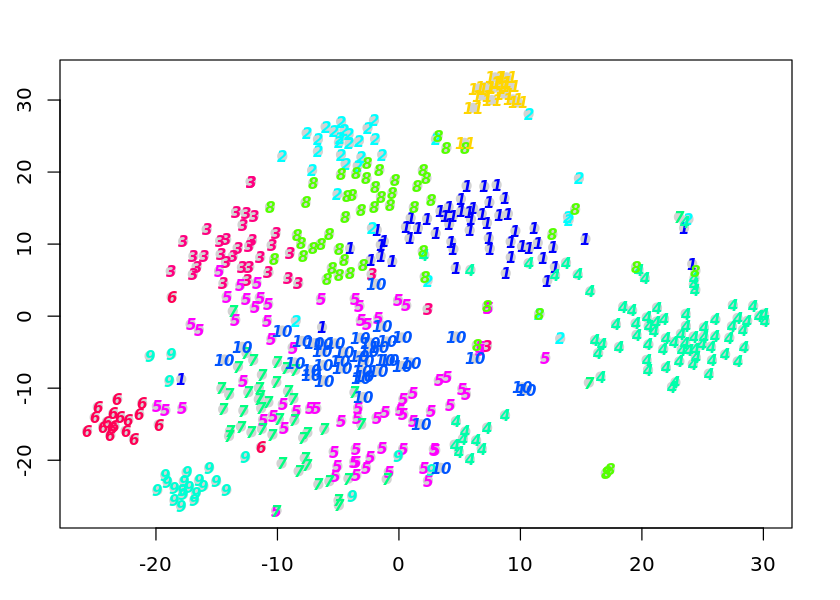

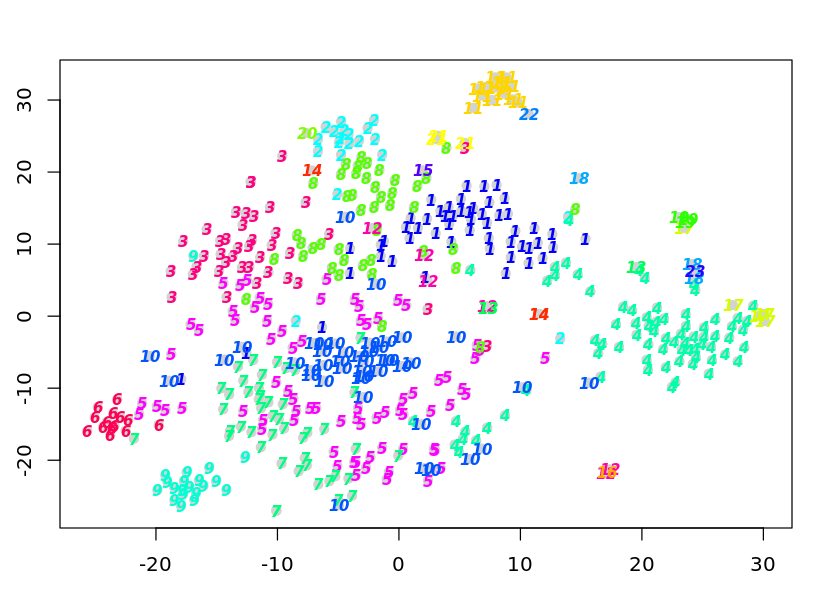

In [390]:
sc_2_900_cl11 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=11, semeth="Tibs2001SEmax")

### Clusters = 12

sigma summary: Min. : 0.140286124766379 |1st Qu. : 0.181952599559756 |Median : 0.20394528971602 |Mean : 0.214572885201141 |3rd Qu. : 0.237372687110352 |Max. : 0.38534207515956 |
Epoch: Iteration #100 error is: 0.824924000394762
Epoch: Iteration #200 error is: 0.813275851421686
Epoch: Iteration #300 error is: 0.807826180338861
Epoch: Iteration #400 error is: 0.806836712554909
Epoch: Iteration #500 error is: 0.805297288843276
Epoch: Iteration #600 error is: 0.805140223510088
Epoch: Iteration #700 error is: 0.805112842477365
Epoch: Iteration #800 error is: 0.805104920939533
Epoch: Iteration #900 error is: 0.805102298432815
Epoch: Iteration #1000 error is: 0.80510138261622


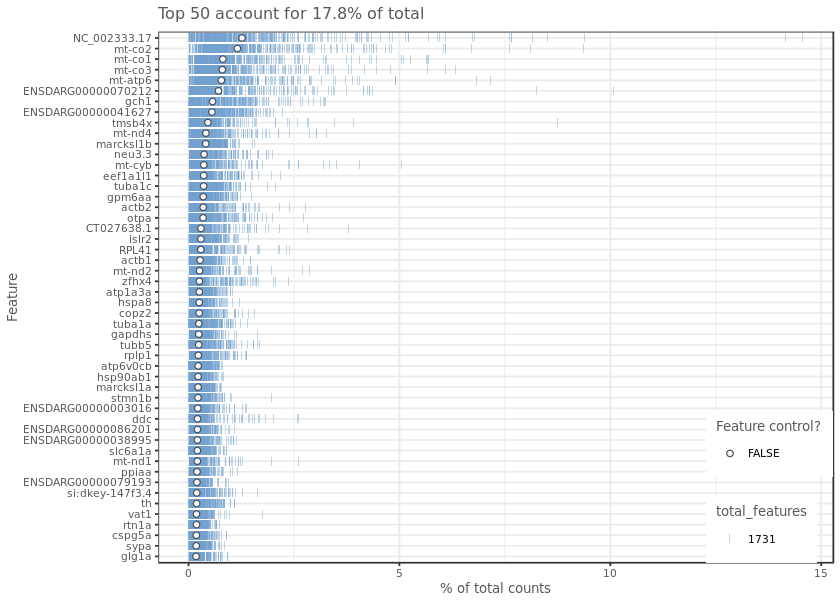

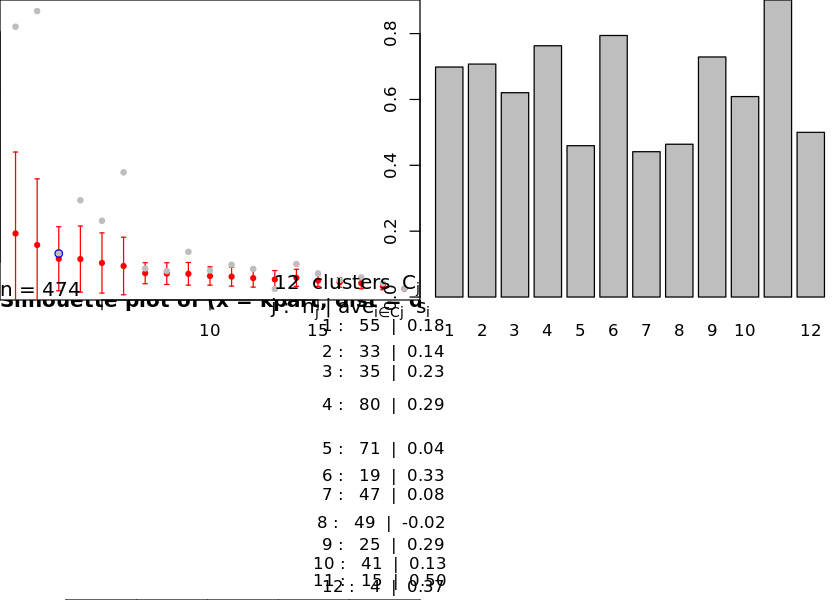

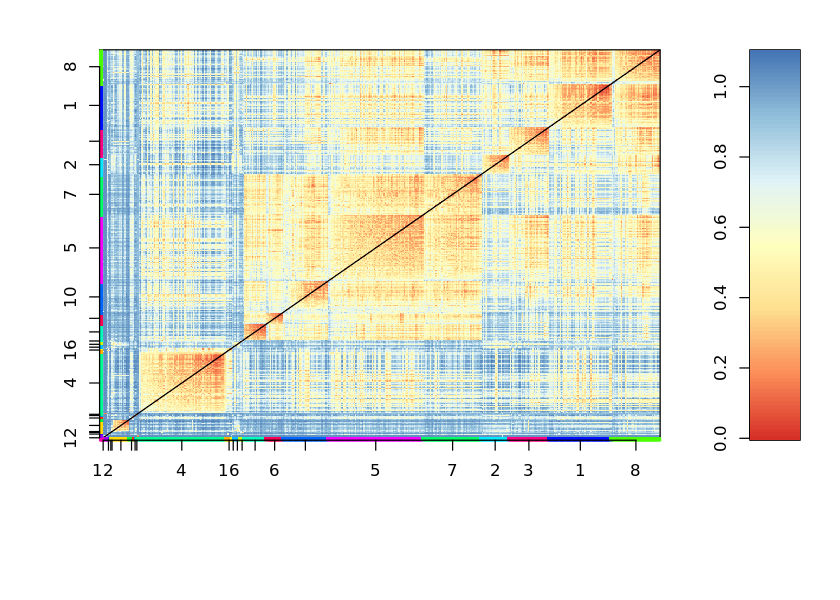

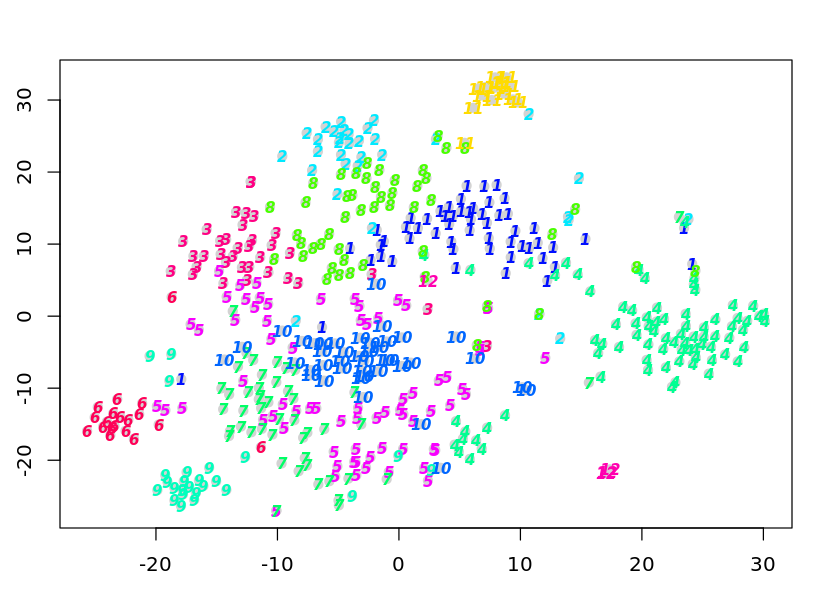

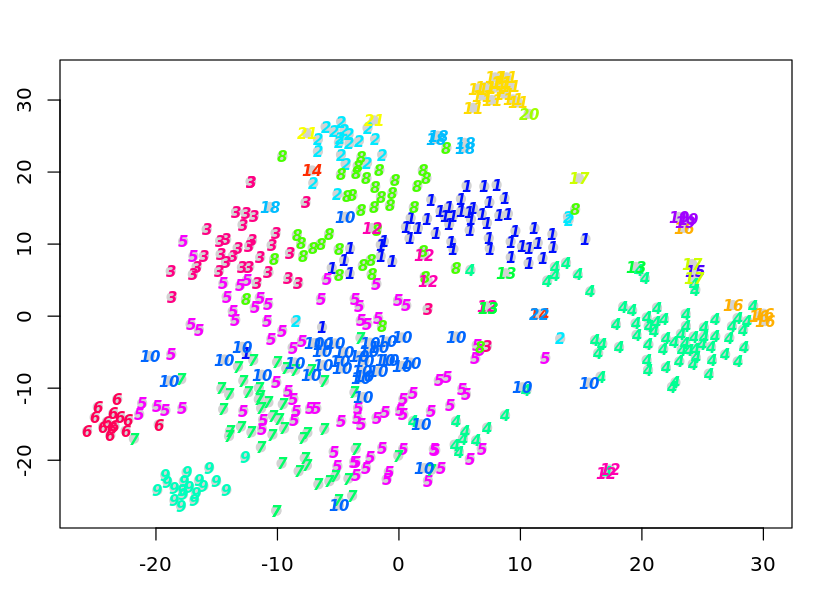

In [391]:
sc_2_900_cl12 <- allForOne(sc, 900, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=12, semeth="Tibs2001SEmax")

### Summary

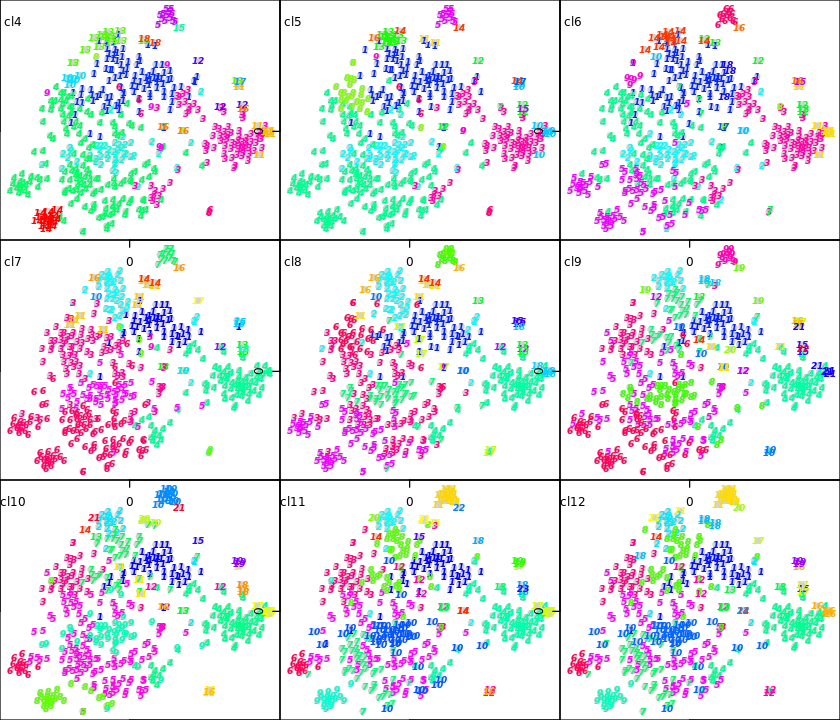

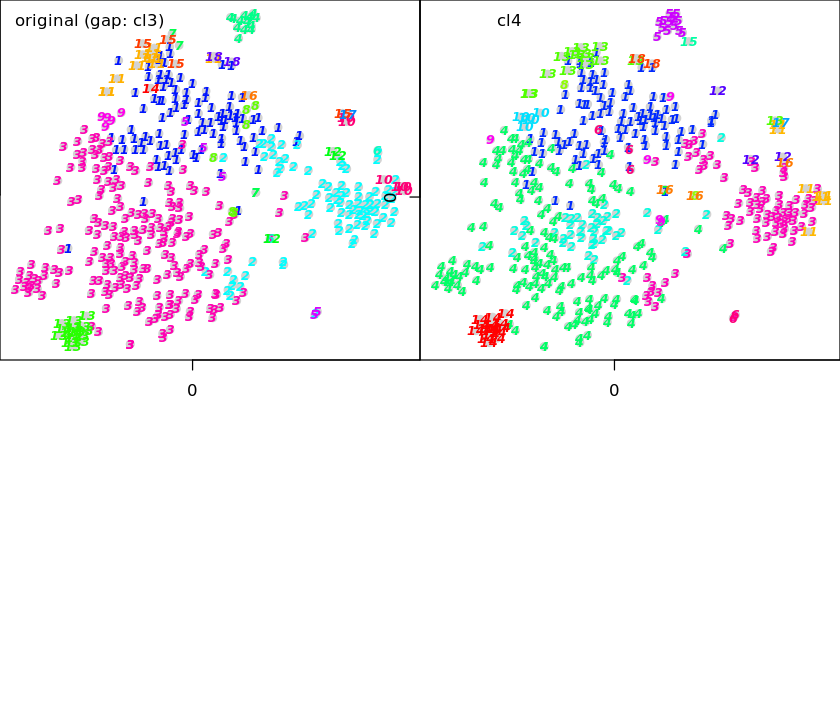

In [422]:
options(repr.plot.height=6)
par(mfrow=c(3,3), mar=c(0,0,0,0), ann = F, cex = 0.6, lab = c(1,1, 5))
res <- lapply(4:12, FUN=function(n){
    cl_name <- sprintf("cl%d", n)
    var_name <- sprintf("sc_2_900_%s", cl_name)
    eval(parse(text = sprintf("plottsne(%s, final=T)", var_name)))
    text(x=-25, y=30, labels=cl_name)
})

par(mfrow=c(2,2))
plottsne(sc_2_900_dogap, final=T)
text(x=-15, y=32, labels="original (gap: cl3)")
plottsne(sc_2_900_cl4, final=T)
text(x=-15, y=32, labels="cl4")



It seems as if our original clustering of 3 main clusters gives the least noise between clusters.

Let us repeat the same for the 2_2000 plots.

## Outlier sensitivity (MinTotal = 2000, MinExp = 2)

### Clusters = 4

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


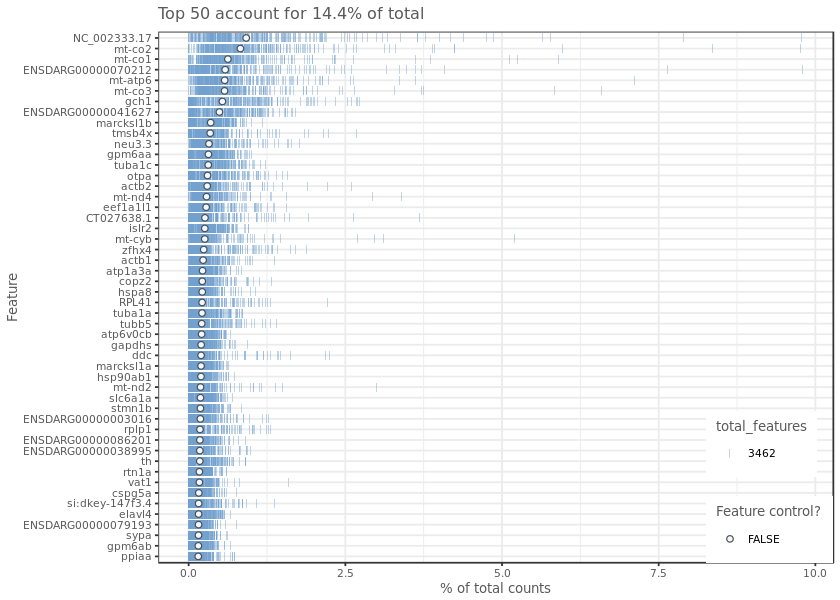

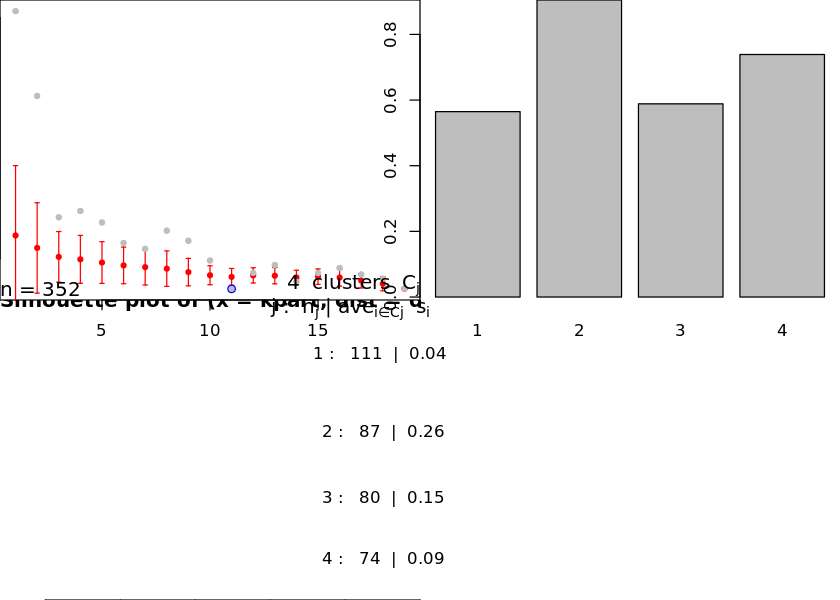

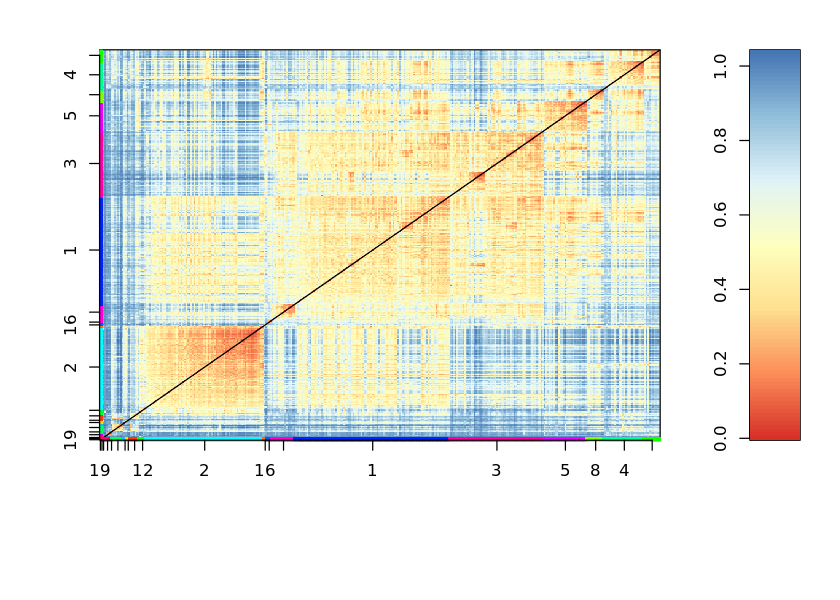

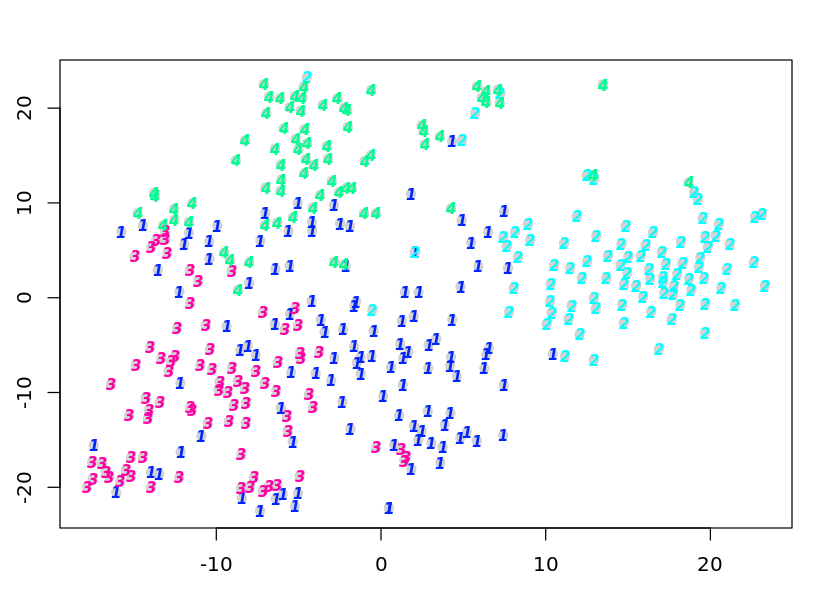

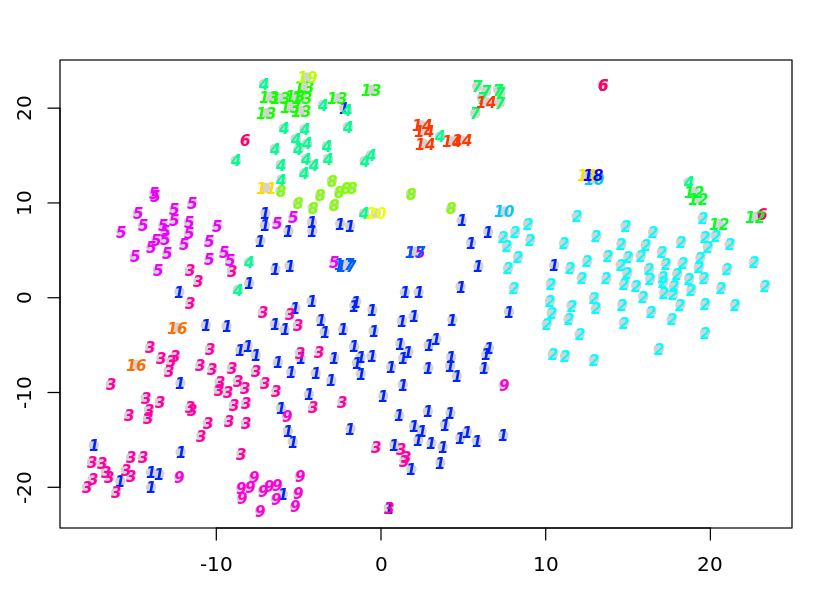

In [423]:
sc_2_2000_cl4 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=4, semeth="Tibs2001SEmax")

### Clusters = 5

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


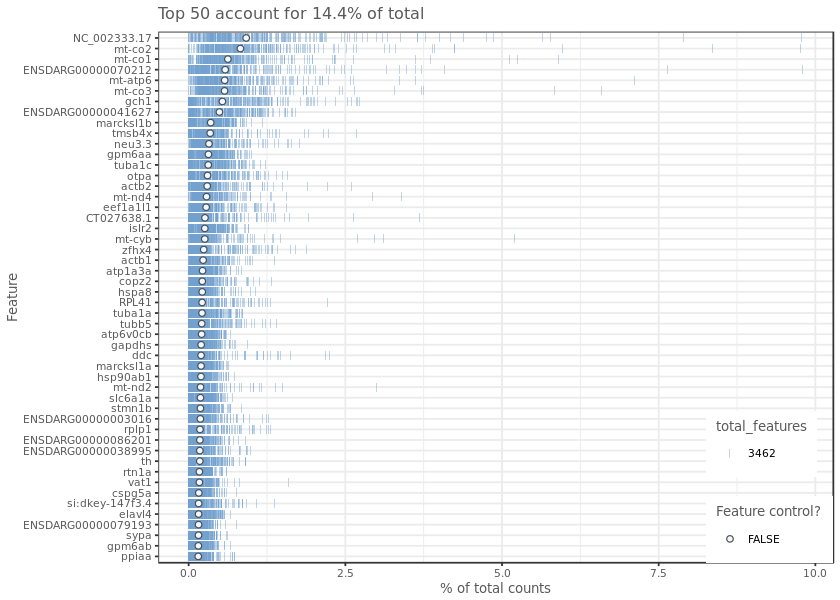

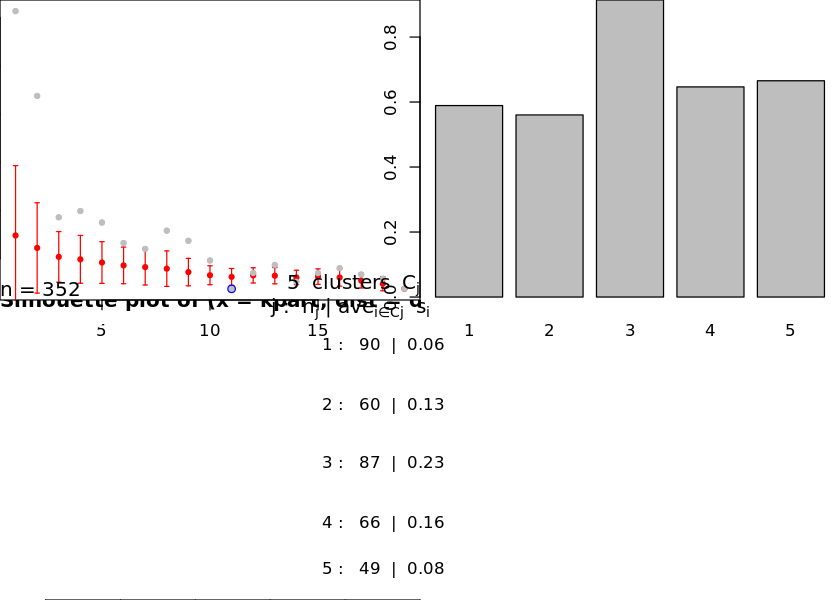

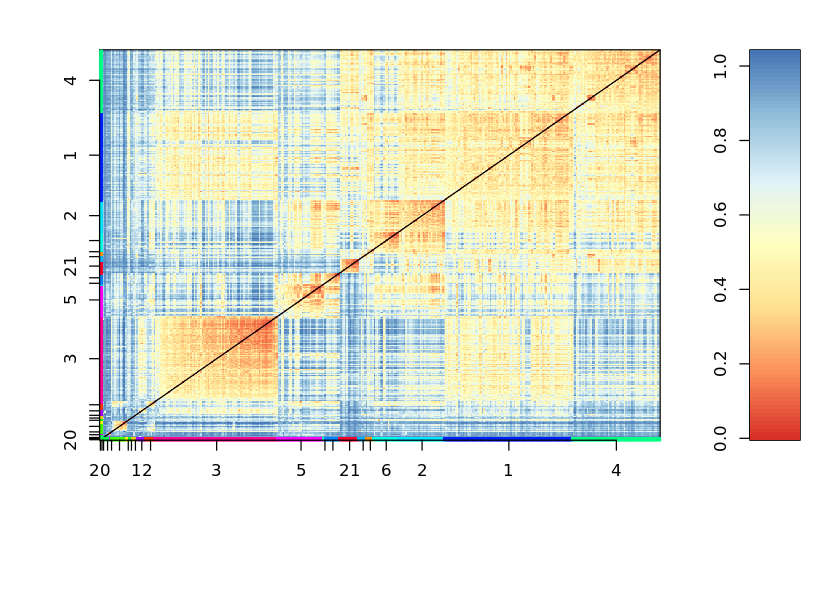

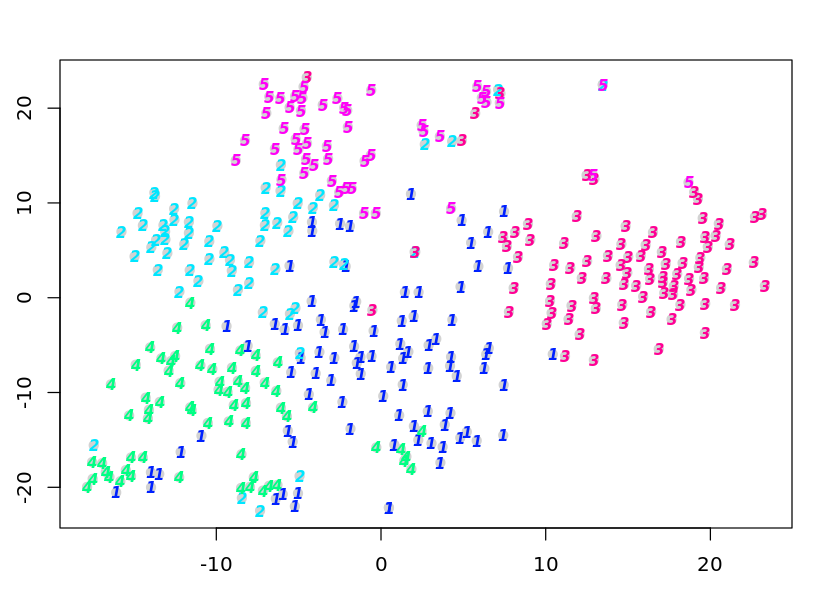

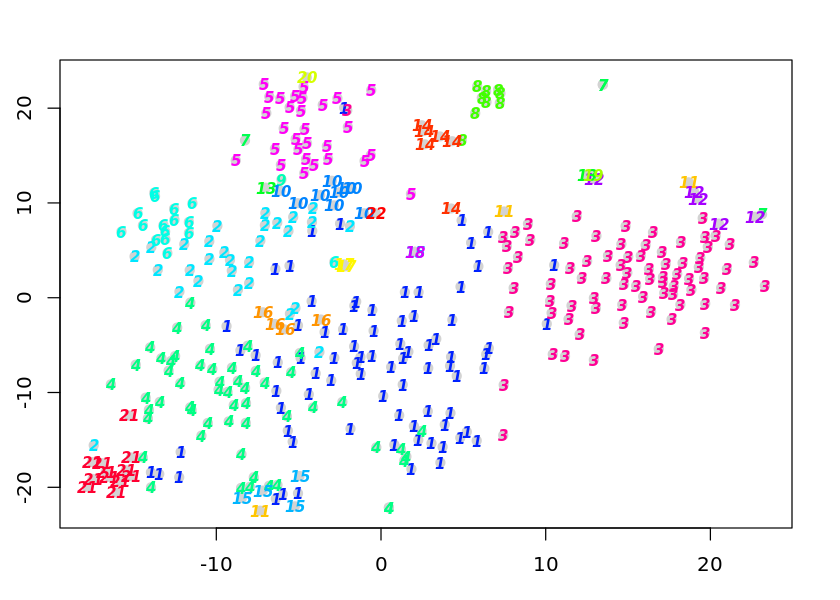

In [424]:
sc_2_2000_cl5 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=5, semeth="Tibs2001SEmax")

### Clusters = 6

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


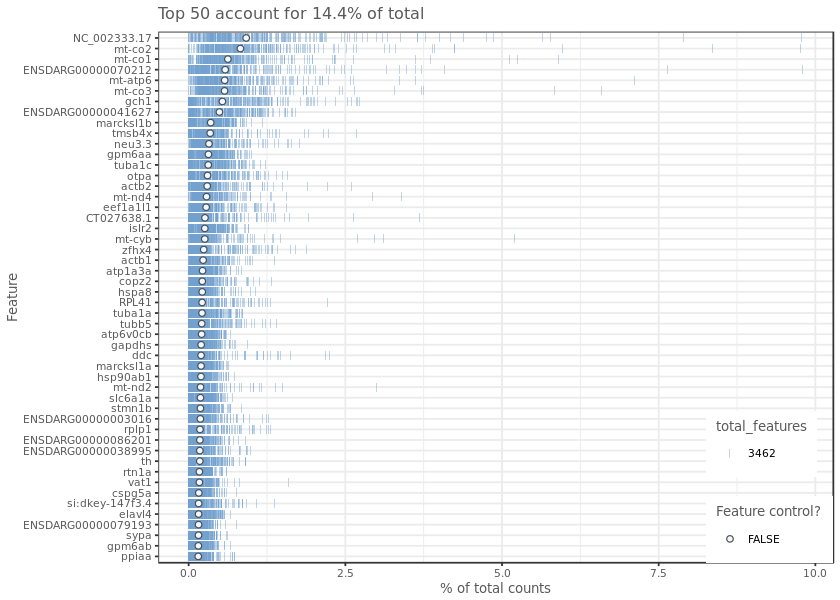

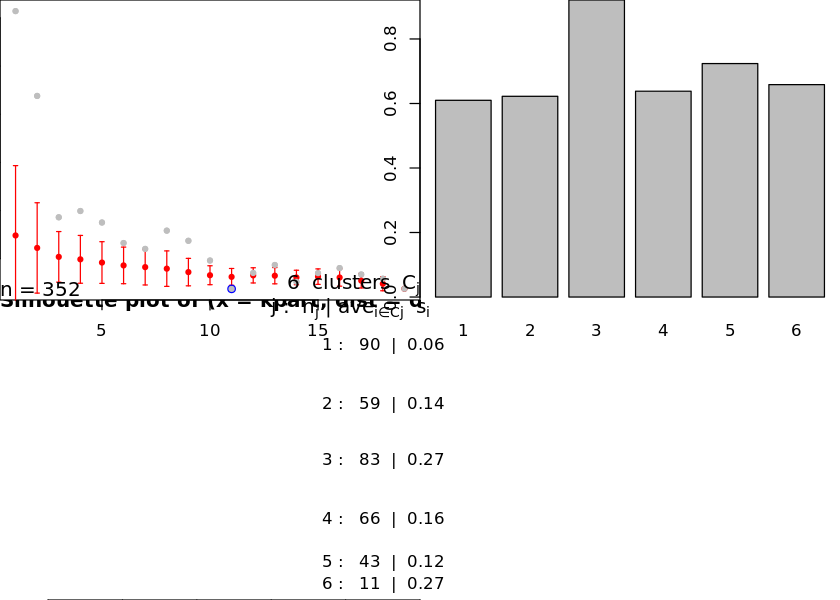

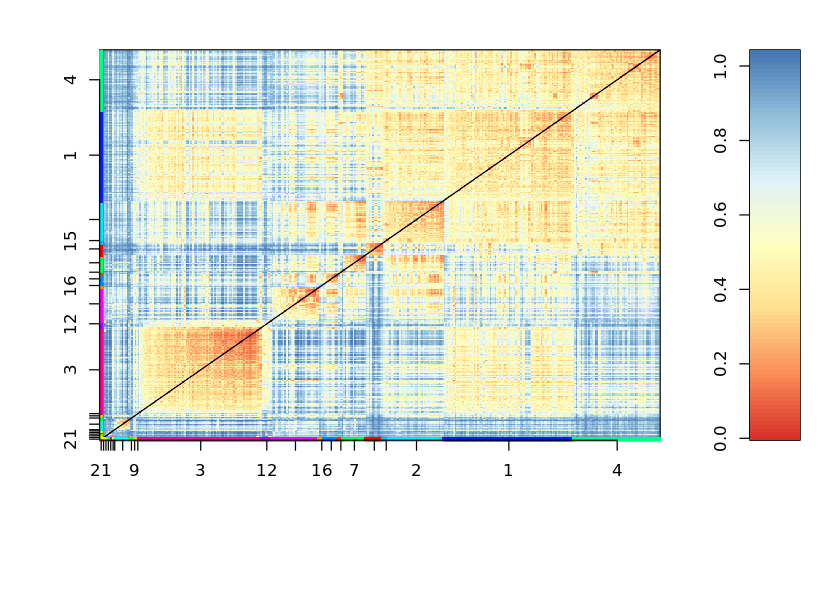

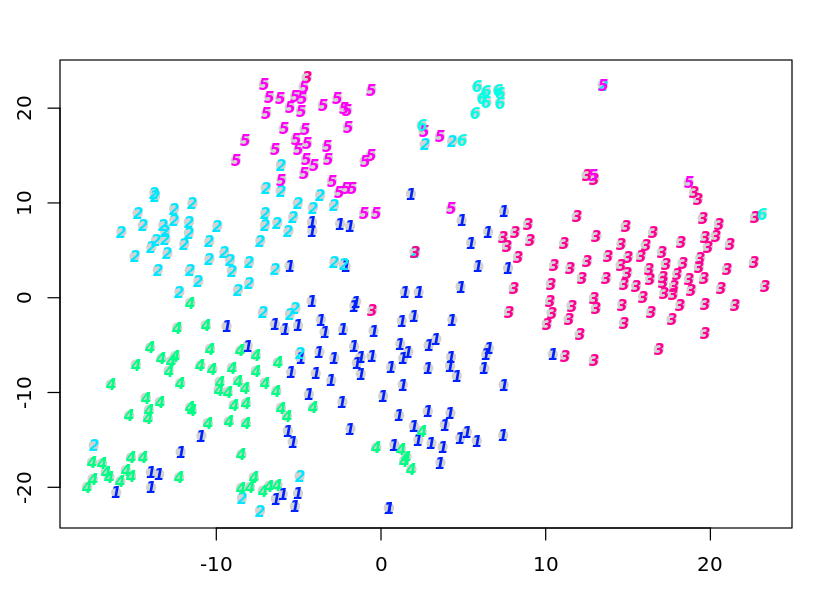

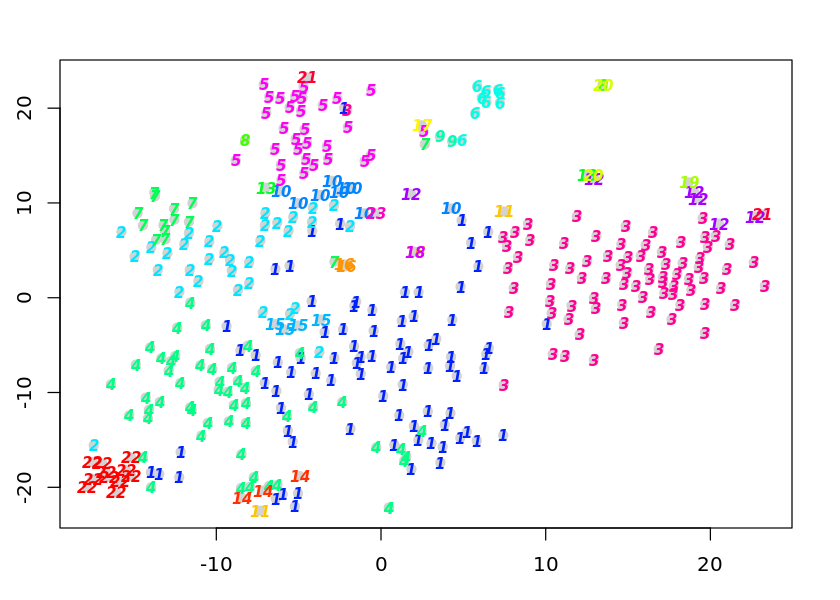

In [425]:
sc_2_2000_cl6 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=6, semeth="Tibs2001SEmax")

### Clusters = 7

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


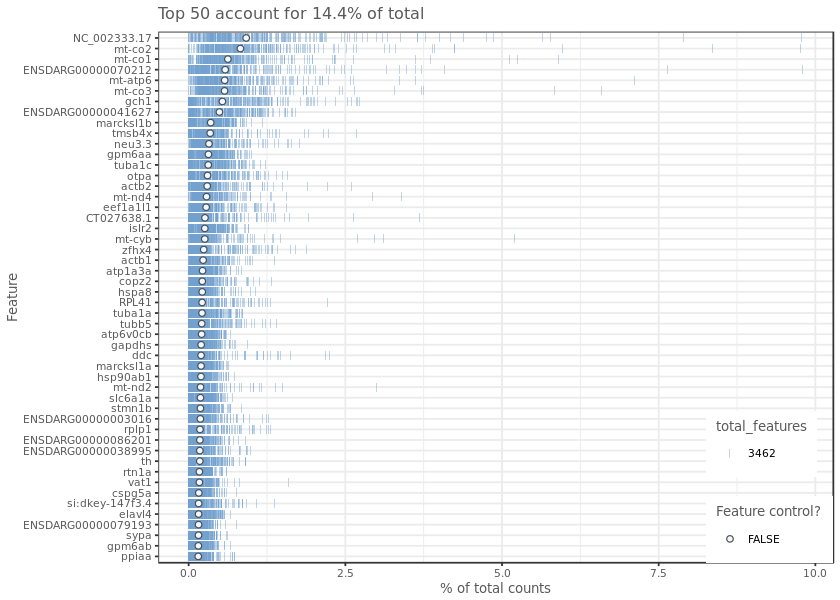

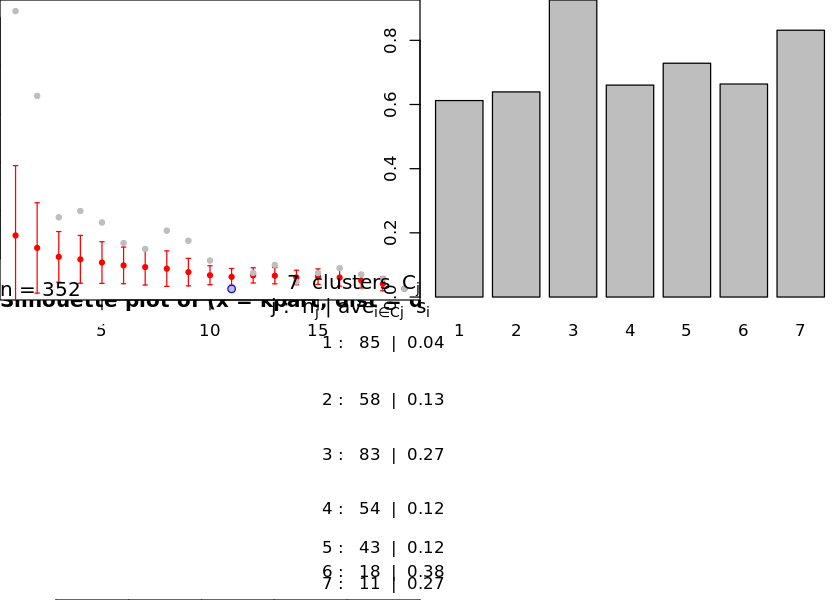

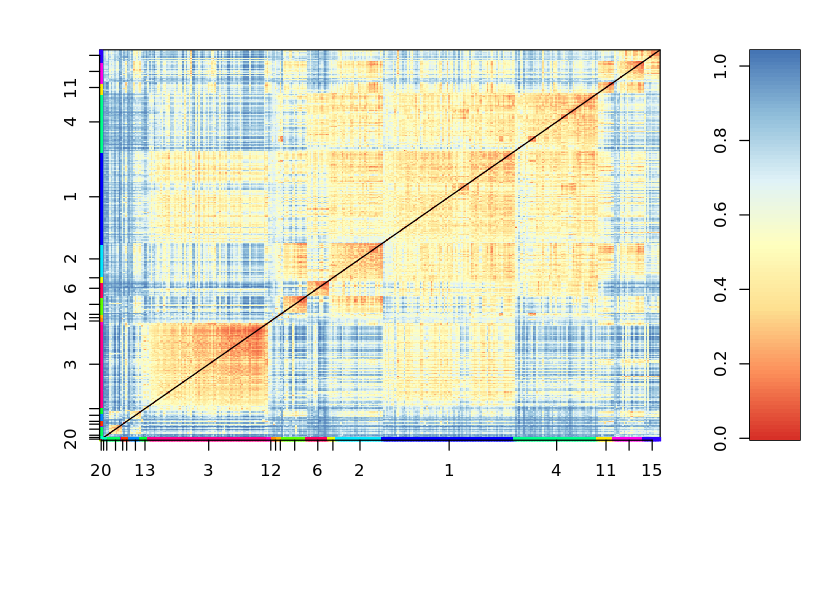

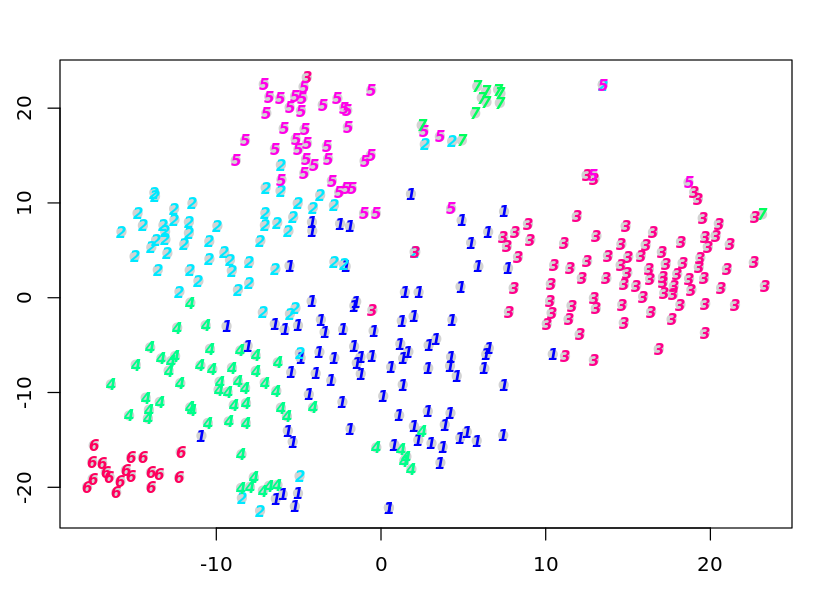

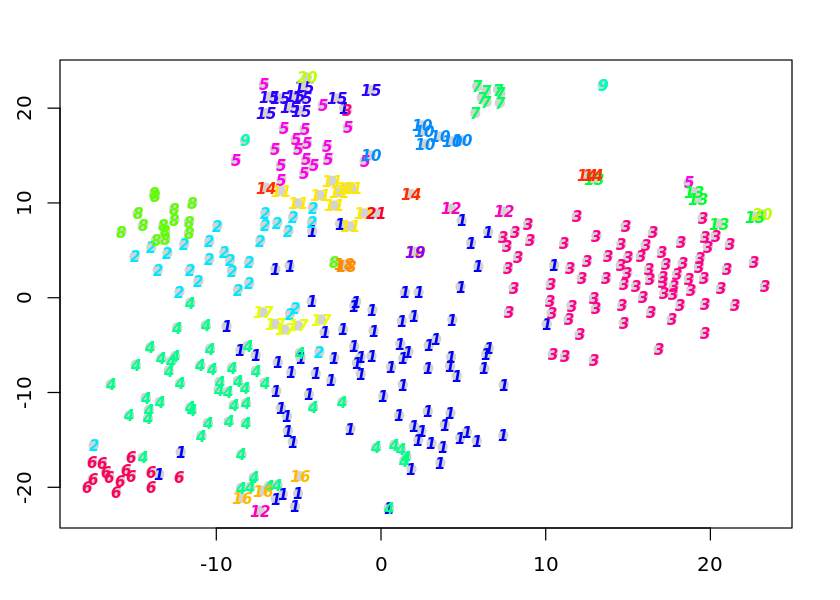

In [426]:
sc_2_2000_cl7 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=7, semeth="Tibs2001SEmax")

### Clusters = 8

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


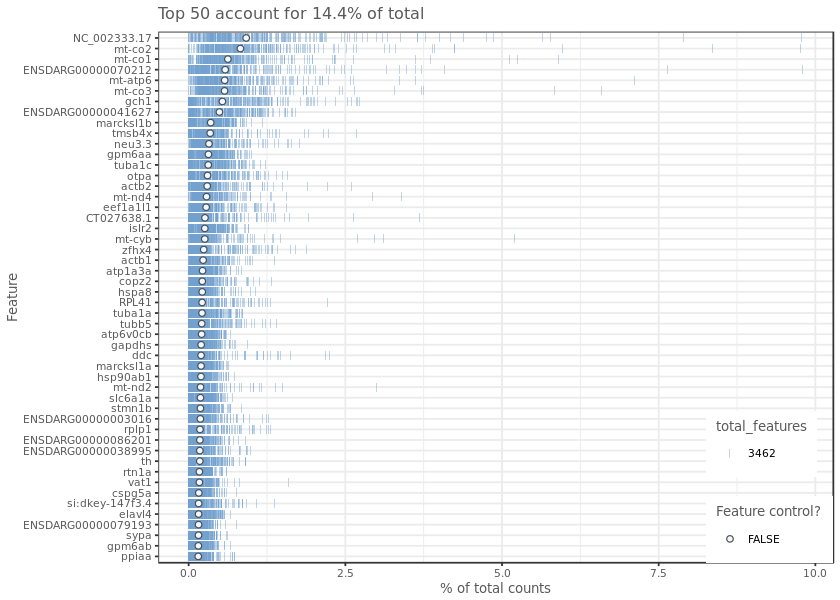

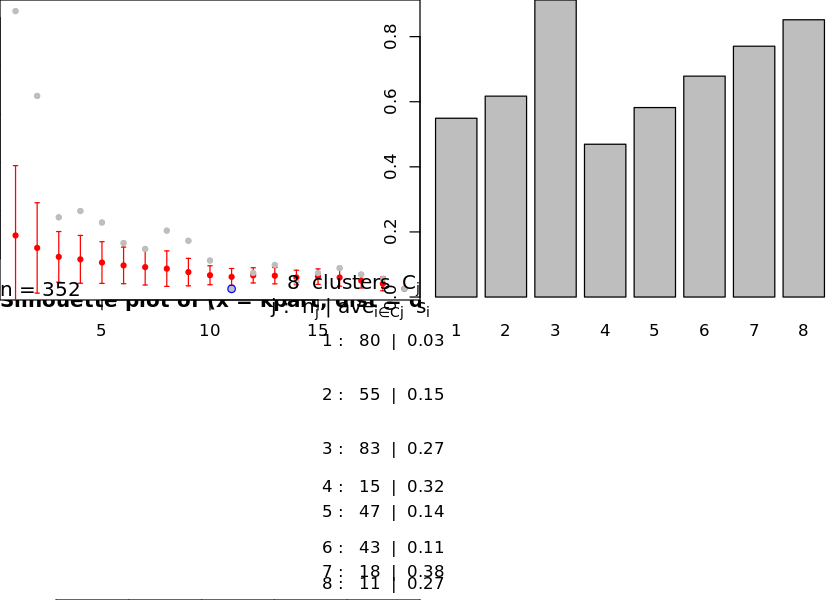

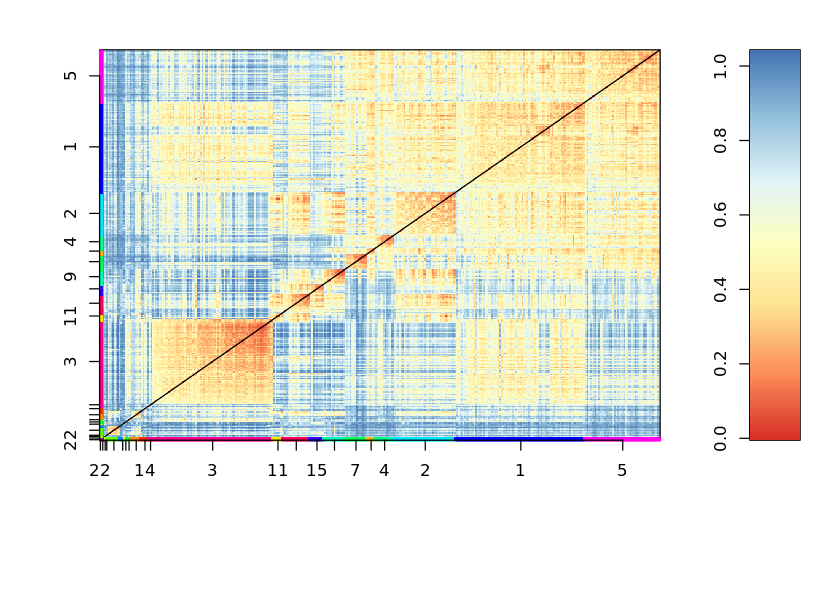

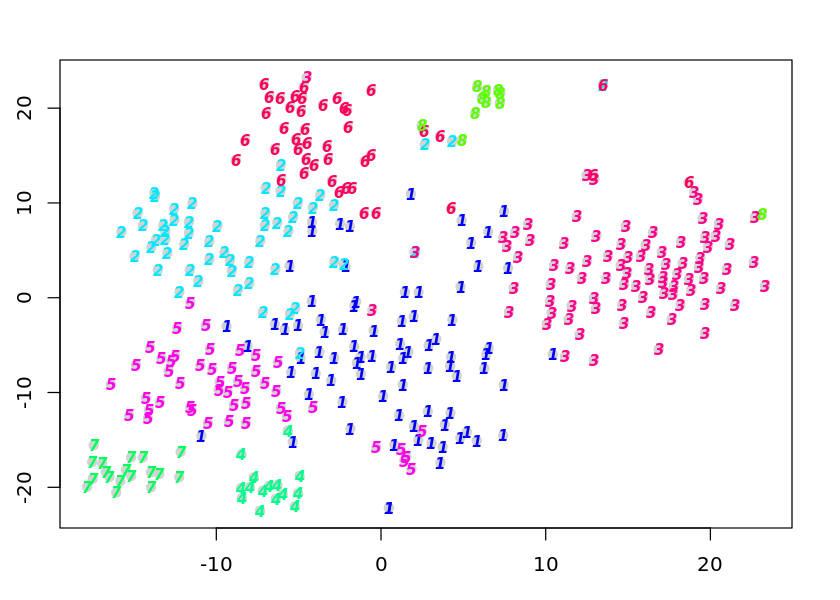

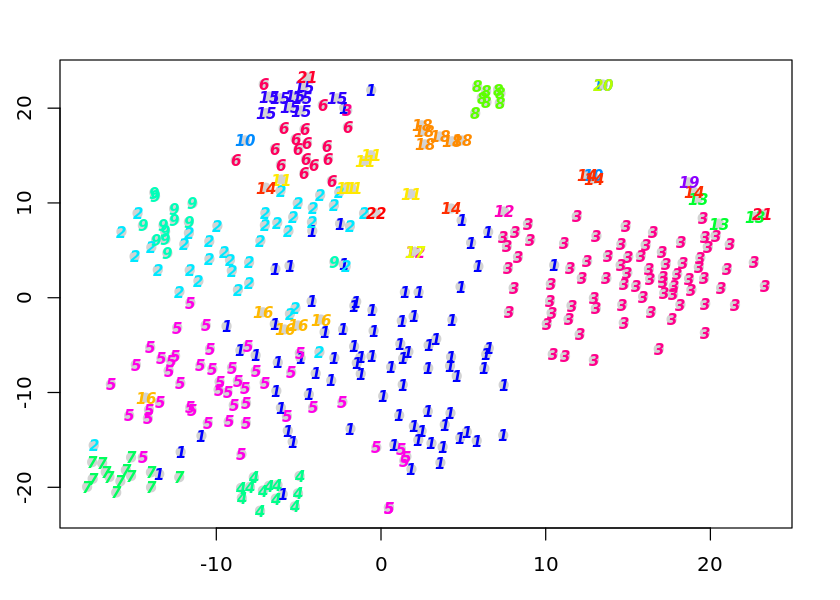

In [427]:
sc_2_2000_cl8 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=8, semeth="Tibs2001SEmax")

### Clusters = 9

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


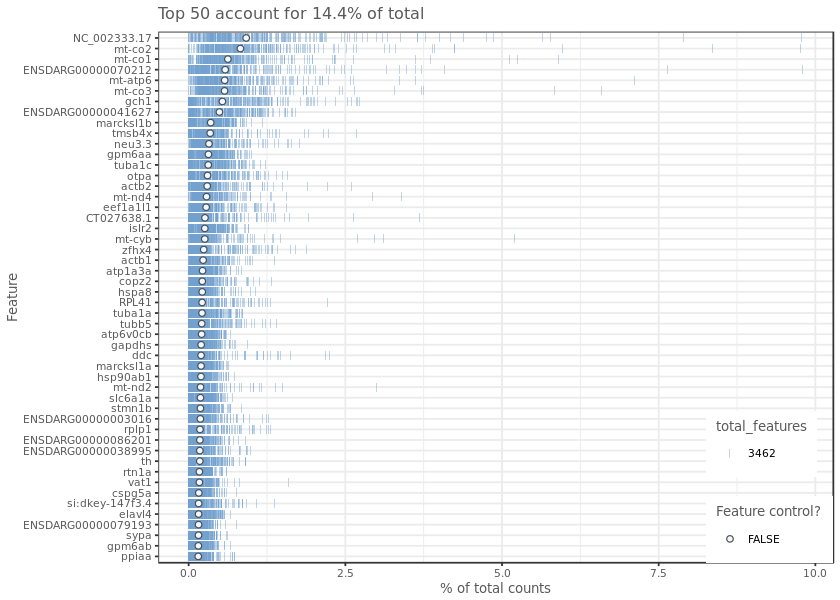

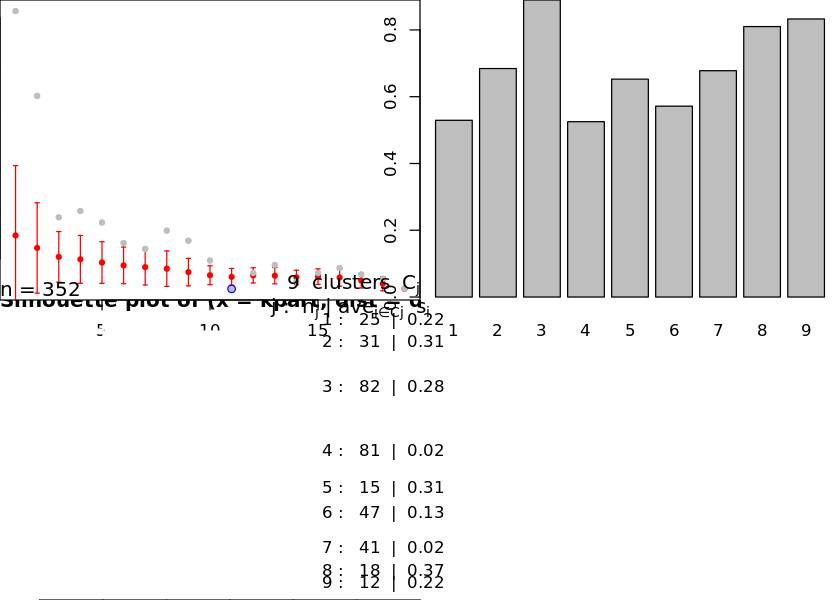

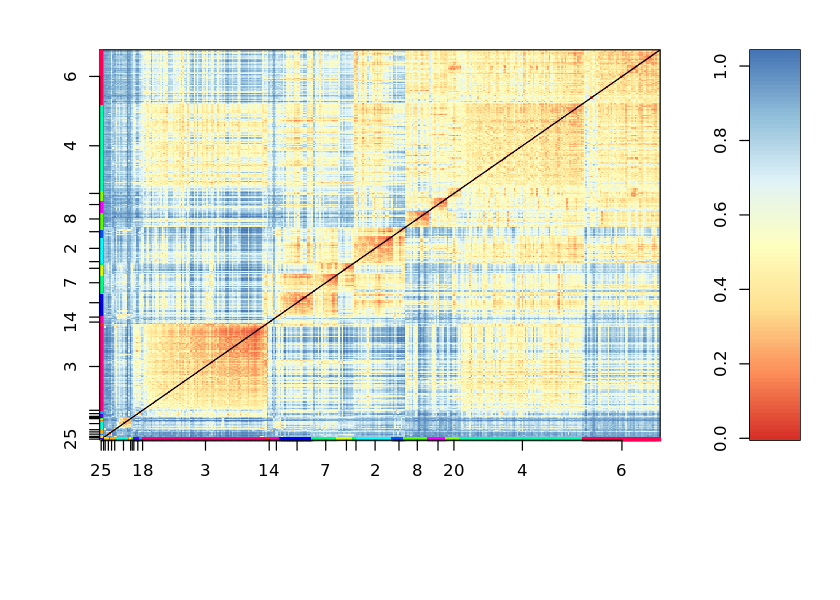

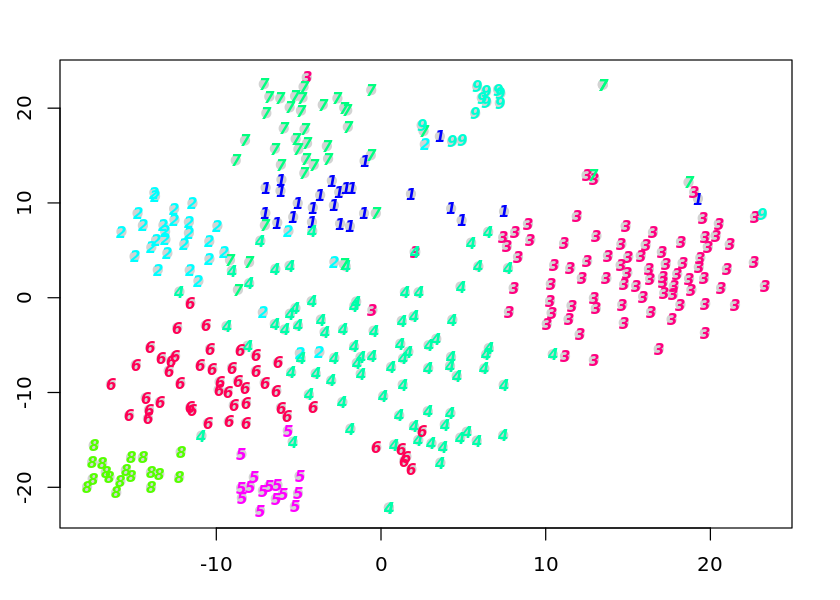

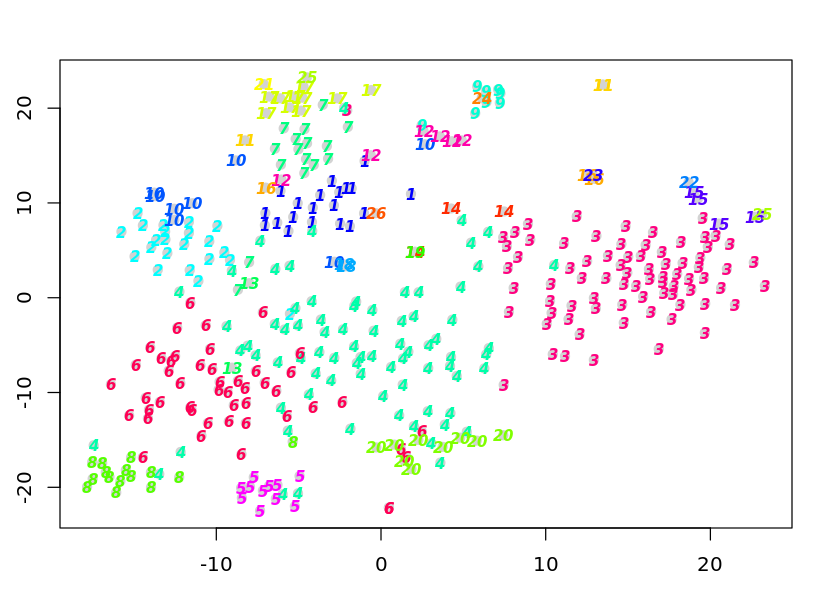

In [428]:
sc_2_2000_cl9 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=9, semeth="Tibs2001SEmax")

### Clusters = 10

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


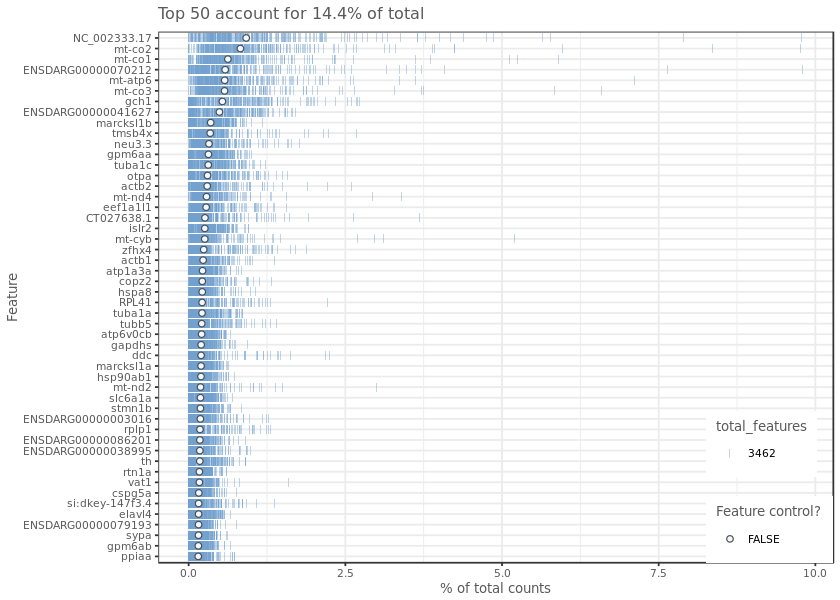

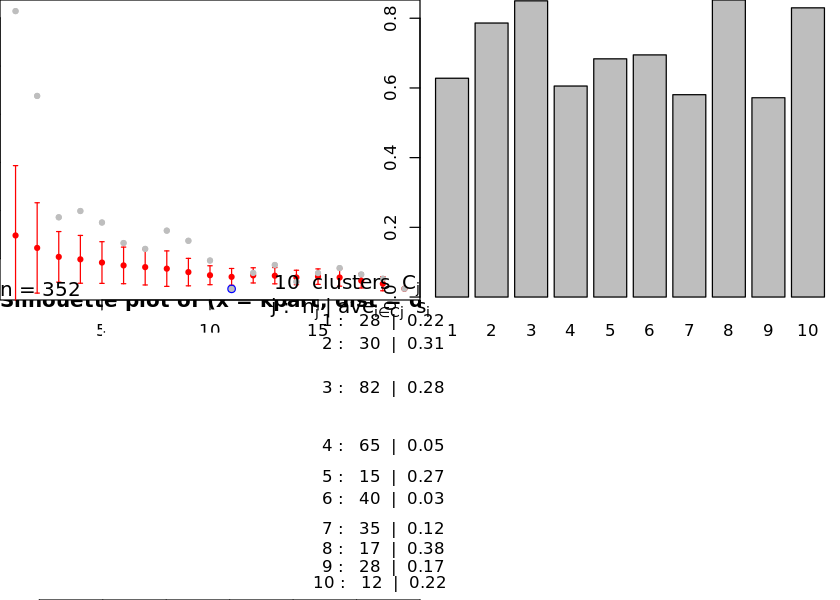

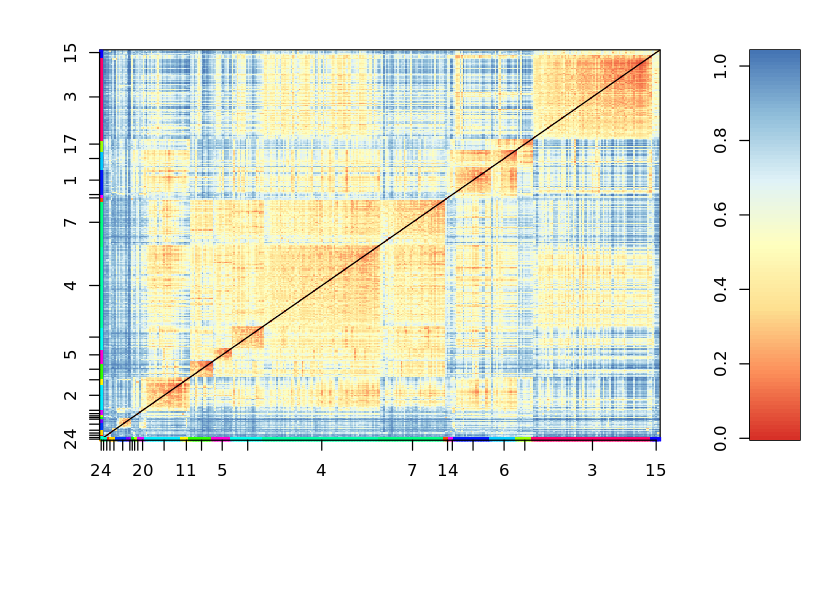

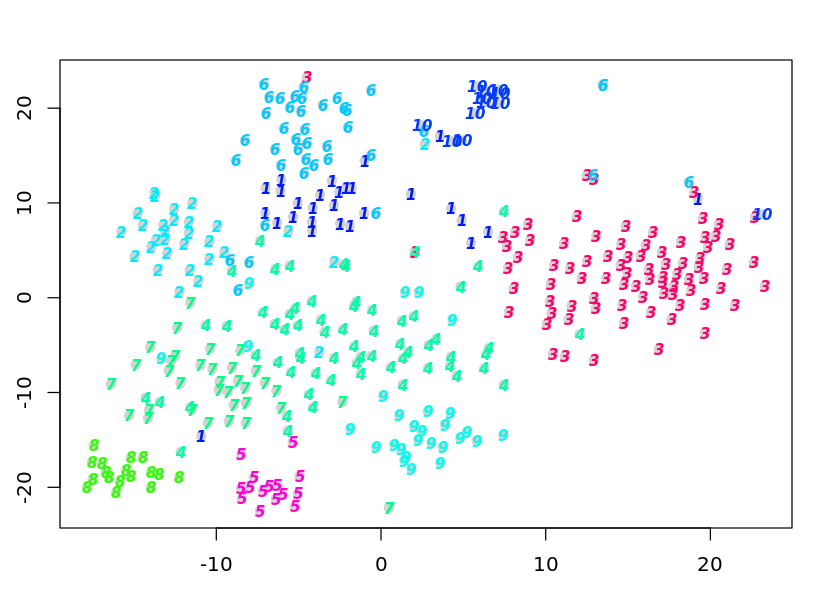

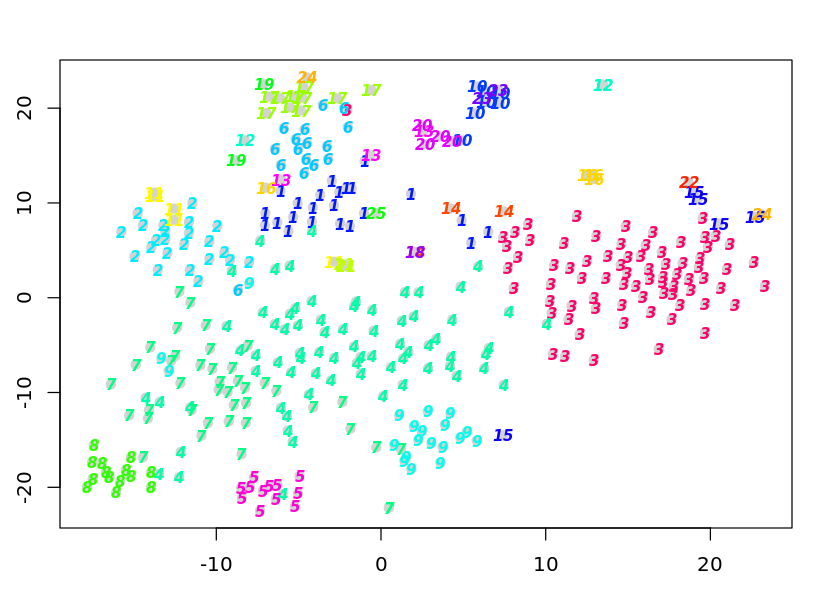

In [429]:
sc_2_2000_cl10 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=10, semeth="Tibs2001SEmax")

### Clusters = 11

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


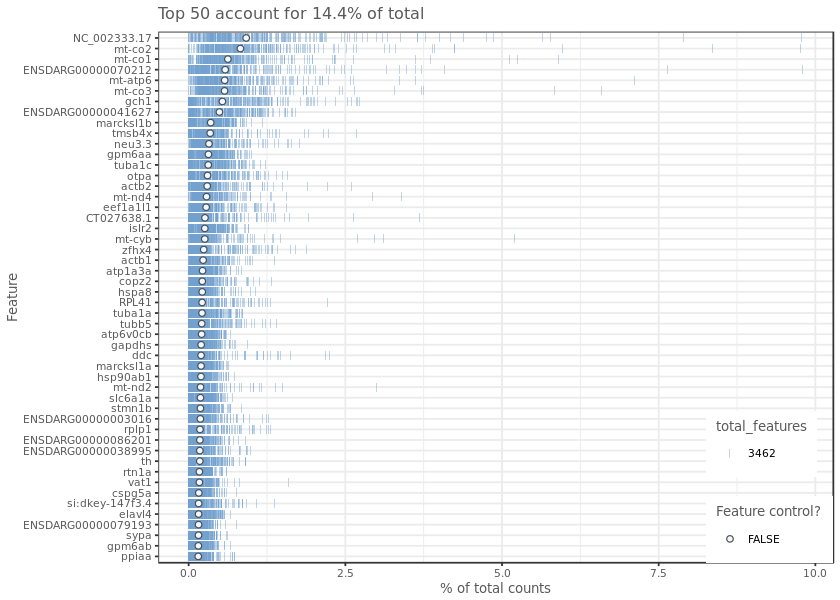

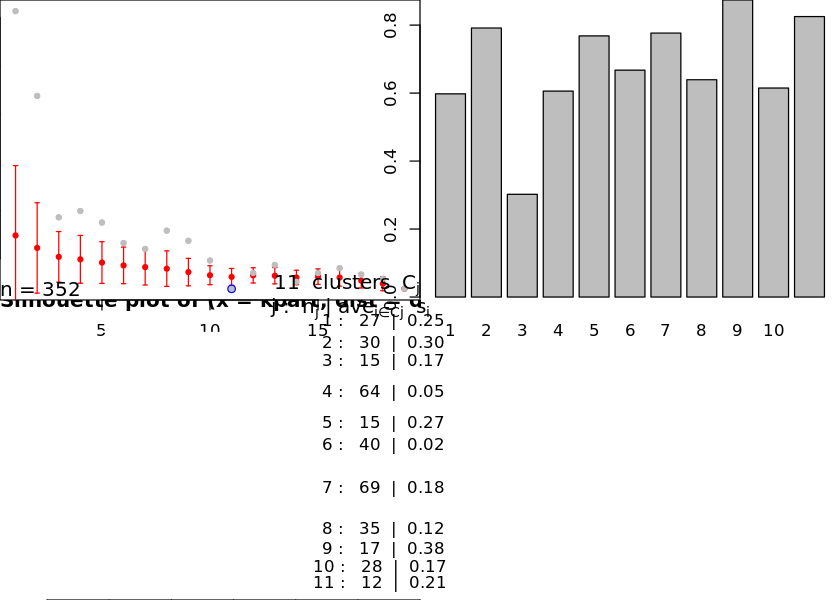

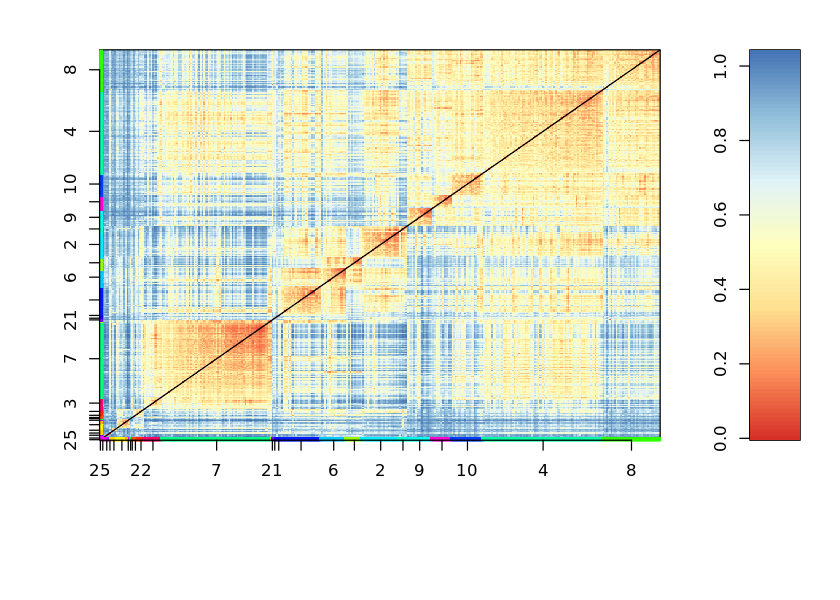

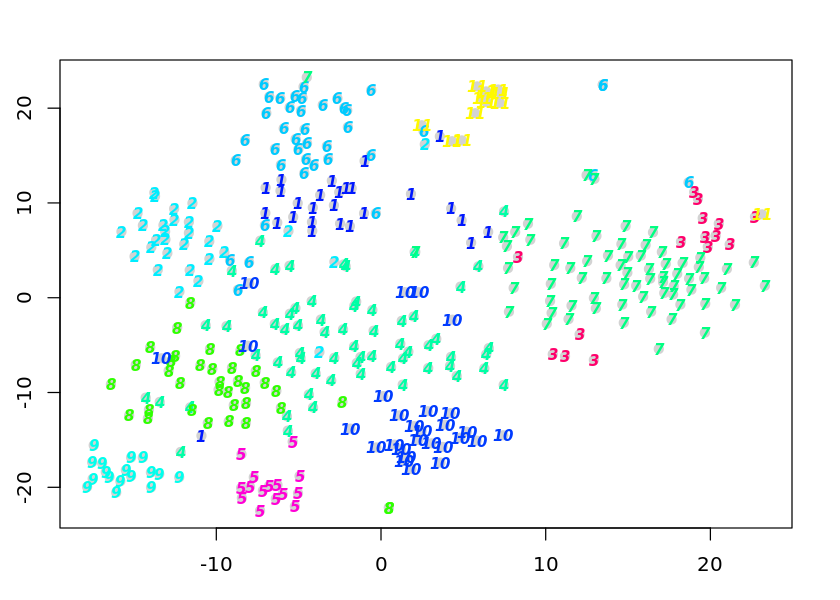

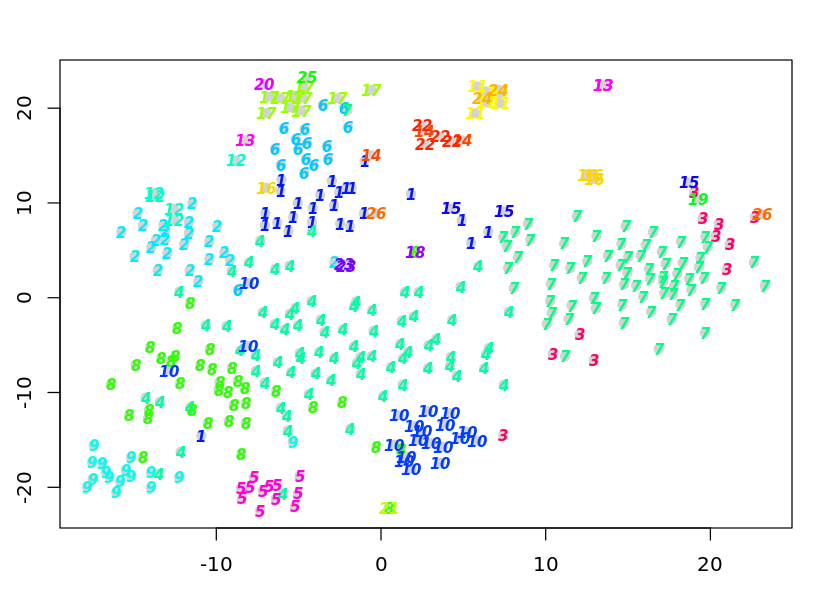

In [430]:
sc_2_2000_cl11 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=11, semeth="Tibs2001SEmax")

### Clusters = 12

sigma summary: Min. : 0.140468469859002 |1st Qu. : 0.182085751556955 |Median : 0.203354024002691 |Mean : 0.211552111902655 |3rd Qu. : 0.235692422168818 |Max. : 0.357476359005594 |
Epoch: Iteration #100 error is: 0.71448394937546
Epoch: Iteration #200 error is: 0.703418912142655
Epoch: Iteration #300 error is: 0.699161674249381
Epoch: Iteration #400 error is: 0.698354031450121
Epoch: Iteration #500 error is: 0.697821956644677
Epoch: Iteration #600 error is: 0.697809321586403
Epoch: Iteration #700 error is: 0.697807403767967
Epoch: Iteration #800 error is: 0.697806982367248
Epoch: Iteration #900 error is: 0.697806884301437
Epoch: Iteration #1000 error is: 0.697806861901015


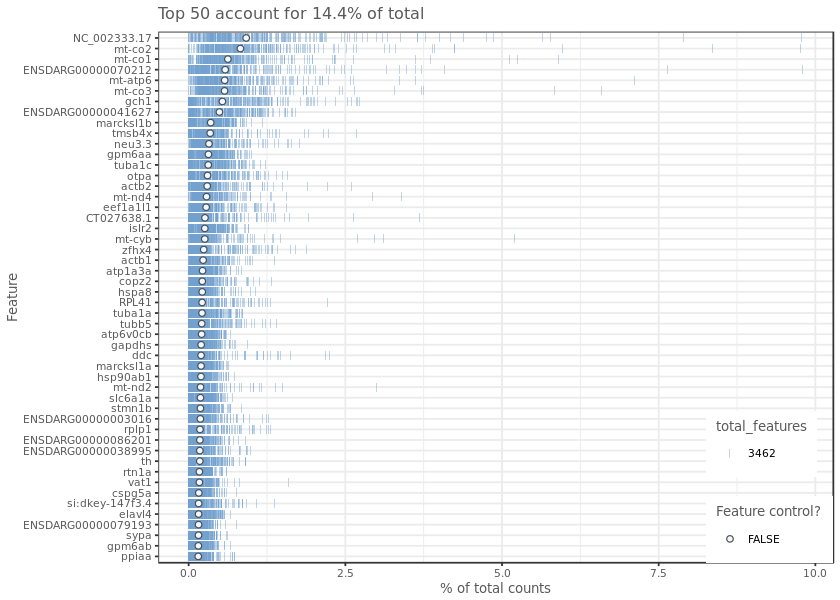

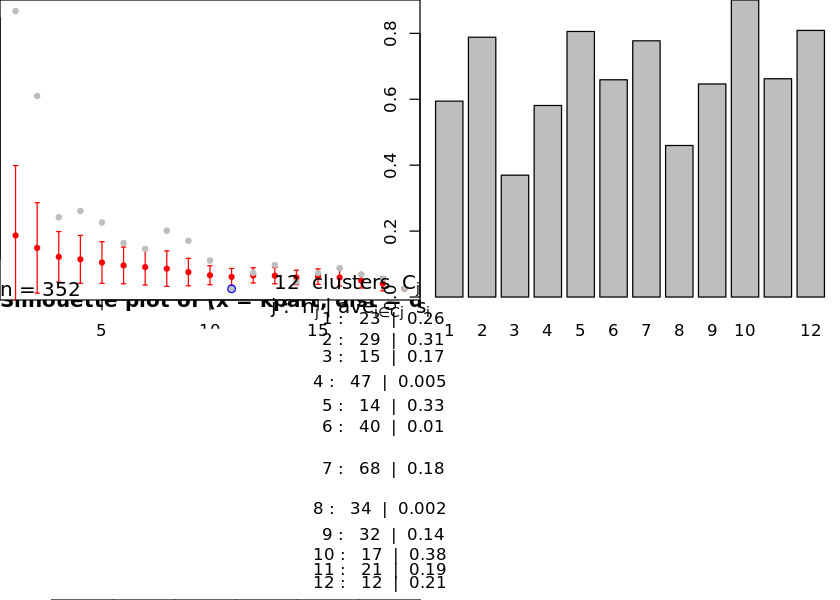

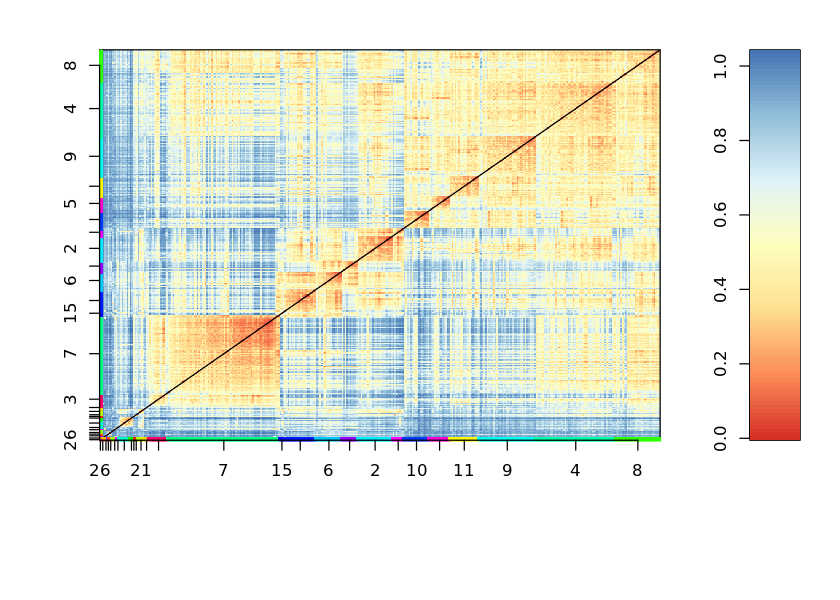

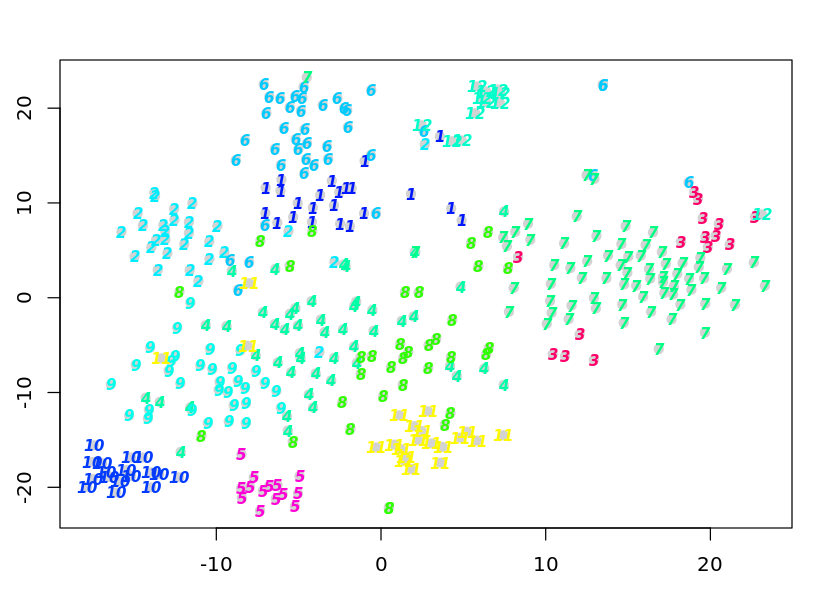

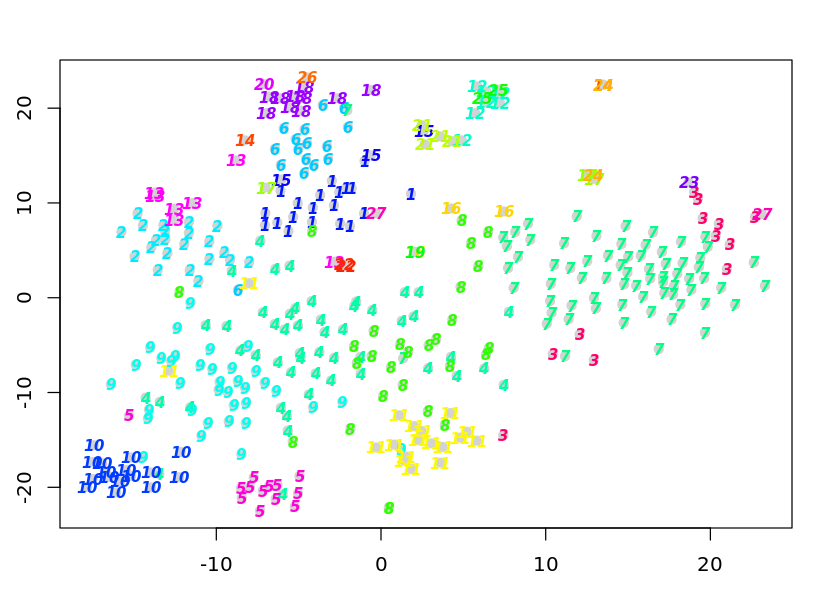

In [431]:
sc_2_2000_cl12 <- allForOne(sc, 2000, 2, fgenes = "NC_002333.4",
                            discover_cc = F, docc=F, clna=12, semeth="Tibs2001SEmax")

### Summary

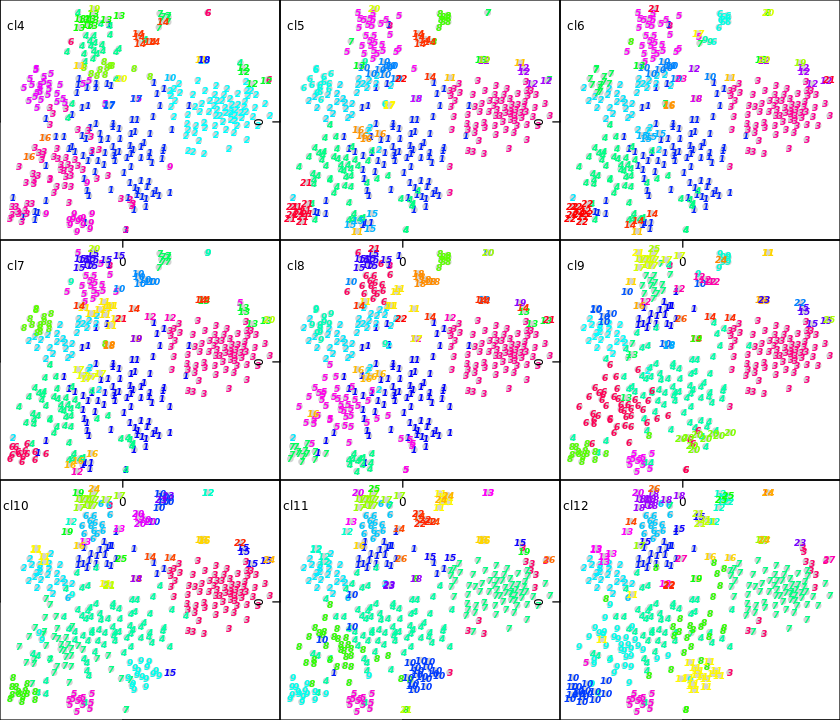

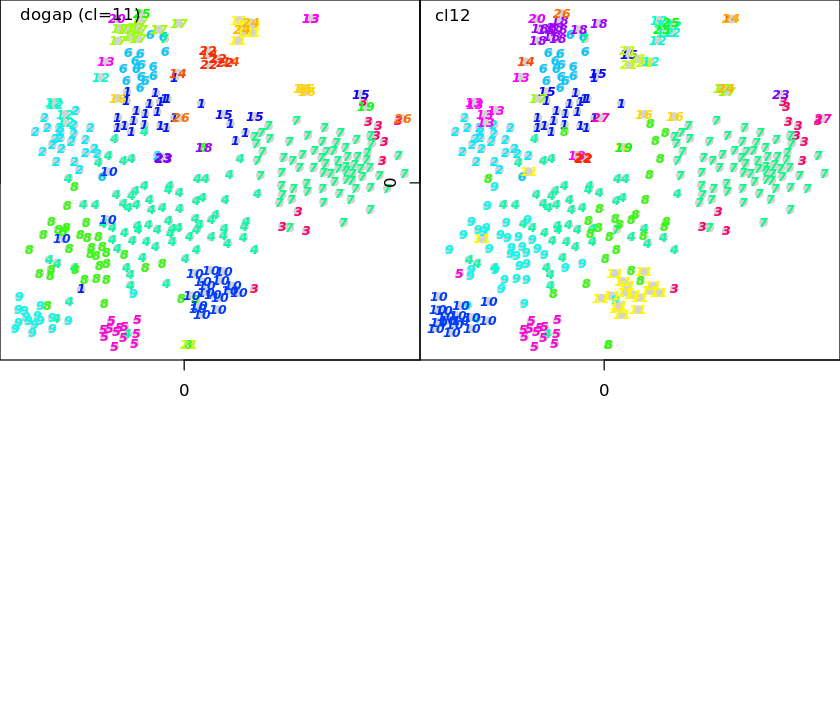

In [460]:
options(repr.plot.height=6)
par(mfrow=c(3,3), mar=c(0,0,0,0), ann = F, cex = 0.6, lab = c(1,1, 5))
res <- lapply(4:12, FUN=function(n){
    cl_name <- sprintf("cl%d", n)
    var_name <- sprintf("sc_2_2000_%s", cl_name)
    eval(parse(text = sprintf("plottsne(%s, final=T)", var_name)))
    text(x=-17, y=20, labels=cl_name)
})

par(mfrow=c(2,2))
plottsne(sc_2_2000_dogap, final=T)
text(x=-11, y=23, labels="dogap (cl=11)")
plottsne(sc_2_2000_cl12, final=T)
text(x=-16, y=23, labels="cl12")



Here we see that the original (cln=11) is virtually identical to the cln12 plot, except that there is less noise assosciated with the '1' cluster, which is better defined in the the cln12.

### Outlining Clusters

One final ***final*** test we can perform to assess the quality of our clusters, is to assess whether the significant genes in each cluster (pval < 1e-10) overlap with any genes in other clusters of the same clustering. 

If we see a lot of overlap, then we can assume that the clusters are poorly defined. If we see clusters defined by a great many number of genes, then we can assume the same. Ideally there should only be one cluster made up of many genes.

#### Methods

In [586]:
interClusterSimilarity <- function(inv_clust_names){
    summ1 <- inv_clust_names
    
    # Filter out clusters from names table without any 
    # genes at all.
    newl = list()
    xxx <- lapply(rownames(summ1), FUN=function(key){
        list_row <- summ1[c(key),]
        if (length(unlist(list_row)) > 0){
            newl[key] <<- list_row
        }
    })

    summ1 <- cbind(newl)
    colnames(summ1) <- c("Sig Genes")
    summ1

    # Generate similarity matrix
    A = summ1
    B = A
    x = matrix(,nrow = length(A), ncol = length(B));

    for (i in 1:length(A)){
        for (j in 1:length(B)){
            #print(A[[i]][A[[i]] %in% B[[j]]])
            if (i >= j){
                x[i,j]<- length(A[[i]][A[[i]] %in% B[[j]]])
            } else {
                x[i,j] <- -Inf
            }        
        }
    }
    colnames(x) <- sub("_cl.", ".", rownames(summ1))
    rownames(x) <- colnames(x)
    
    return(list(table = summ1, similarity = x))
}

getThoseCommon <- function(let1, let2){
    return(
        summ1[[let1,3]][
            summ1[[let1,3]] %in% summ1[[let2,3]]
        ]
    )
}

####  2000_2_cl12

In [587]:
cmap_2_2000_cl12  <- investigateClusters(sc_2_2000_cl12, , pval = 1e-10)
ics_2_2000_cl12 <- interClusterSimilarity(cmap_2_2000_cl12$names)
ics_2_2000_cl12$table
ics_2_2000_cl12$similarity           

Sig Genes                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

,cl.1,cl.2,cl.3,cl.4,cl.5,cl.6,cl.7,cl.8,cl.9,cl.10,cl.11,cl.12,cl.13,cl.18
cl.1,1,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.2,0,2,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.3,0,0,17,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.4,0,0,0,6,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.5,0,0,0,0,2,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.6,0,0,0,0,0,3,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.7,0,1,10,3,1,0,232,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.8,0,0,0,2,0,0,2,3,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.9,0,0,1,3,0,0,5,2,9,-Inf,-Inf,-Inf,-Inf,-Inf
cl.10,0,0,0,0,1,0,2,0,0,6,-Inf,-Inf,-Inf,-Inf


* Cluster 7 has 232(!!!) sig genes, with an overlap of 10 with Cluster 3 which are dispersed slightly around it.

* Clusters 4, 7, and 9 share 50% of their genes (3) which is normal given their proximity.

#### 2000_2_dogap

In [588]:
cmap_2_2000_dogap <- investigateClusters(sc_2_2000_dogap, , pval = 1e-10)
ics_2_2000_dogap <- interClusterSimilarity(cmap_2_2000_dogap$names)
ics_2_2000_dogap$table
ics_2_2000_dogap$similarity

Sig Genes                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

,cl.1,cl.2,cl.3,cl.4,cl.5,cl.6,cl.7,cl.8,cl.9,cl.10,cl.17
cl.1,4,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.2,1,3,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.3,0,0,17,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.4,1,1,1,9,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.5,0,0,0,0,2,-Inf,-Inf,-Inf,-Inf,-Inf,-Inf
cl.6,0,0,0,0,0,3,-Inf,-Inf,-Inf,-Inf,-Inf
cl.7,1,2,9,4,1,0,236,-Inf,-Inf,-Inf,-Inf
cl.8,1,1,1,4,0,0,7,12,-Inf,-Inf,-Inf
cl.9,0,0,0,0,1,0,2,0,5,-Inf,-Inf
cl.10,0,0,0,0,0,0,0,0,0,3,-Inf


The dogap shows the same relationships as described above for the cln12 analysis. No surprises here.

#### 900_2_dogap

In [589]:
cmap_2_900_dogap <- investigateClusters(sc_2_900_dogap, , pval = 1e-10)
ics_2_900_dogap <- interClusterSimilarity(cmap_2_900_dogap$names)
ics_2_900_dogap$table
ics_2_900_dogap$similarity

,Sig Genes
cl.1,"NC_002333.17 , ENSDARG00000089963, NC_002333.4 , AL935210.1 , apoeb , gch1 , mt-atp6 , apoc1 , mt-co2 , hbae3 , mt-cyb , mt-nd2 , otpa , mt-co1 , ddc , mt-co3 , CU459089.1 , islr2 , mt-nd4 , tuba1c , tubb5 , elavl4"
cl.2,"CABZ01033205.1 , cplx4b , si:ch73-194h10.2 , neu3.3 , ENSDARG00000026900, pnpla2 , si:dkey-147f3.4 , si:dkey-150i13.2 , slc17a7b , asns , ENSDARG00000090148, ENSDARG00000086346, thumpd3 , copz2 , adcy7 , si:dkey-234i14.3 , si:ch211-132g1.6 , trim65 , CU459089.1 , pcyt1aa , ENSDARG00000038995, ENSDARG00000060189, ENSDARG00000088902, pak7 , glg1a , ENSDARG00000090712, ENSDARG00000074925, ENSDARG00000014802, pdgfd , slc22a7b.3 , ecel1 , ranbp10 , nudt3a , prickle3 , lyrm2 , faah , hyal2a , ENSDARG00000095356, ptpn11b , si:ch1073-111c8.3 , FAM72B , ccndbp1 , ENSDARG00000079720, gch1 , syt10 , dynlt1 , scube1 , cep126 , ENSDARG00000094834, gnaia , ccny , ENSDARG00000057430, dcun1d3 , phldb1a , prkceb , tmx2b , hectd2 , ENSDARG00000095253, apoeb , sspn , MARCH4 (1 of many), ENSDARG00000005901, ezh1 , susd5 , ENSDARG00000035683, dbf4 , ENSDARG00000060472, ENSDARG00000043692, fdxr , ttyh3a , ENSDARG00000087387, ENSDARG00000091818, tuba1a , ENSDARG00000061945, card11 , slc5a3a , ENSDARG00000086201, ENSDARG00000080381, sart3 , ENSDARG00000070212, si:dkey-75b17.1 , ENSDARG00000090667, ENSDARG00000039134, mcl1b , il10rb , zgc:162472 , si:dkeyp-19e1.3 , ENSDARG00000008350, ENSDARG00000090493, cers3a , ENSDARG00000088910, zgc:123297 , caly , ENSDARG00000093300, apoc1 , ENSDARG00000017704, crip3 , vipr1b , BX248501.1 , ENSDARG00000087815, tubb5 , slc29a1b , atp1b2b , ENSDARG00000015831, si:ch211-213a13.1 , ENSDARG00000093507, ENSDARG00000070804, ENSDARG00000061005, zgc:101664 , peli1b , ENSDARG00000079888, spata4 , si:ch211-246e12.3 , faxca , slc47a2.1 , ENSDARG00000025846, ENSDARG00000078528, pparaa , osbp , gprc5ba , tuba1c , ENSDARG00000087514, acsbg1 , ENSDARG00000076141, snrnp40 , si:ch211-235i11.5 , inpp4b , ENSDARG00000078373, unc93b1 , mrvi1 , lancl2 , CABZ01088229.1 , ENSDARG00000088003, NEK3 , commd1 , CR753844.1 , ENSDARG00000059295, si:ch1073-441p17.1, si:rp71-36a1.5 , ccs , zgc:154061 , ENSDARG00000087007, valopa , tspan4a , ENSDARG00000022001, aifm4 , atmin , ENSDARG00000086260, slc35d2 , ENSDARG00000095117, LUC7L2 , ddc , dnajb12b"
cl.3,"apoeb , apoc1 , ENSDARG00000089963, AL935210.1 , otpa , npb , tubb5 , tuba1a , tuba1c , islr2 , sulf2b , hbae3 , elavl4 , gch1 , zfhx4 , ENSDARG00000073681, slc6a1a , sv2a , ccl34b.1 , gpm6aa , kidins220b , opn1mw2 , cspg5a , col1a1a , ENSDARG00000041627, stmn1b , atp1a3a , celf4 , th , ENSDARG00000015775, rtn1a , pou2f2a , vat1 , atp6v0cb , marcksl1b , nova1 , basp1 , gpm6ab , col2a1a , sypa , stmn2a , stx1b , c1ql3b , marcksl1a , ENSDARG00000089464, lhx1a , maptb , CABZ01033205.1 , ENSDARG00000089997, xpr1a , dnajc5aa , calm3a , cd99l2 , stmn2b , NC_002333.17 , RPL41 , si:dkey-147f3.4 , gnao1a , mt-cyb , crhbp , vamp2 , nhlh2 , pvalb2 , psap , CU459089.1 , ENSDARG00000026900, ENSDARG00000038198, slc6a3 , tuba2 , ckbb , nova2 , zgc:92066 , slc17a6a , rab6bb , h2afx1 , egr4 , rplp2l , clstn1 , dpysl3 , rplp1 , slc17a7b , dner , syngr3a , pnpla2 , pcdh19 , ywhag2 , si:ch73-194h10.2 , marcksb , mapta , si:dkey-150i13.2 , elavl3 , ywhaba , otpb , hmgb3a , ENSDARG00000004148, FO704736.1 , hist2h2l , rab3ab , si:dkey-276j7.1 , ENSDARG00000091395, ENSDARG00000091444, ctsba , pfn1 , mt-co3 , hbbe2 , pak7 , trim65"
cl.4,"lgals3bpb , slc40a1 , ctsz , mfap4 , CR318588.4 , havcr1 , zgc:171509 , lgmn , cd63 , ENSDARG00000027464, si:dkey-5n18.1"
cl.11,krt8
cl.13,"gch1 , onecut1"


,cl.1,cl.2,cl.3,cl.4,cl.11,cl.13
cl.1,22,-Inf,-Inf,-Inf,-Inf,-Inf
cl.2,7,153,-Inf,-Inf,-Inf,-Inf
cl.3,15,16,107,-Inf,-Inf,-Inf
cl.4,0,0,0,11,-Inf,-Inf
cl.11,0,0,0,0,1,-Inf
cl.13,1,1,1,0,0,2


* Clusters 2 and 3 have over 100 "significant" genes, with an overlap of 16. 

Given their proximity to one another, and the sheer numbers of genes in each, I would expect a much greater overlap.

# Overall Verdict and Recap of previous stages

 1. **Cell/Gene filtering** revealed that we could keep a decent number of our cells and our genes within a MinTotal range of 900-2000, and a MinExpr range of 2 or 3.  
  - Initial parameters of Mintotal=900 and MinExpr=2 (2_900) was chosen for initial gene filtering.
  
 2. **Gene QC** revealed that NC_002333.4 was highly saturated in all cells, and so was removed from the analysis
   
   * Removing all genes signficantly correlated with NC_002333.4 created too much noise.
 
   * Removing all NC_* transcripts reduced the quality of the clustering, and removing mitochondrial genes similarly had no benefit.
   
   * The impact of removing cell-cycle or cell-proliferation genes was negligible.
 
 3. **Parameter Robustness** was performed over a variety of MinTotal and MinExp values (within the 'good' zone defined in our Cell/Gene filtering stage).
 
   * Persistent clustering was searched for in each, helping us determine a ***Cell Atlas*** of sorts using the most significant genes using a similarity metric across different clusterings.
   
     * Here we outlined three main cell types described by:
       1. AMKO:
          * 'ENSDARG00000027464' 'lgmn' 'havcr1' 'ctsz' 'zgc:173915' 'CR318588.4' 'slc7a7' 'si:dkey-5n18.1' 'mfap4' 'zgc:171509' 'cd63' 'BX901920.1' 'BX322618.1' 'ctsd'  
       2. EHN:
          * 'gch1' 'onecut1' 'atp1b1b' 'adgrb1b'   
       3. FI:
          * 'zfhx4' 'nhlh2' 'otpa'
          
     * The clustering with the best overlap of these types, defined by the least amount of the sparseness, was determined to be the *2_2000* and the *2_900* plot.
            
 4. **Outlier Sensitivity** was performed on both of these plots so that the number of clusterings was not determined by the gap statistic, but was set beforehand in order to see if this would improve the clusterings of some of the more extreme groupings of cells that were somehow clustered together.
   
   * 2_900
     - The original gapped plot gave better clusterings than the set valued plots.
   * 2_2000
     - The original gapped plot did not seperate one cluster very well, which the 2_2000_cl12 plot managed to do.
     
 5. **Cluster Sensitivity** was performed on both 2_2000 plots and the original 2_900 plot by comparing the similarity of different clusters in the same plot under the assumption that different clusters should have different significant genes.
 
   * 2_900 revealed 2 main neighbouring clusters with more than 100 genes in each yet with only an overlap of 10.
   * 2_2000 (in both) appeared to have merged these clusters into one giant cluster but with more better defined clusters surrounding it.
   * 2_2000_cln12 was chosen for the subsequent StemID analysis.
   


# StemID

Init. lineage tree, measure entropy of each cell type, and determine cell projections.

https://github.com/dgrun/RaceID3_StemID2/blob/master/RaceID3_StemID2_class.R

In [596]:
ltr <- Ltree(sc_2_2000_cl12)
ltr <- compentropy(ltr)
ltr <- projcells(ltr, cthr = 2, nmode=F)

In [597]:
# apply randomisation
ltr <- projback(ltr, nmode=F)

pdishuffle: 1 
pdishuffle: 2 
pdishuffle: 3 
pdishuffle: 4 
pdishuffle: 5 
pdishuffle: 6 
pdishuffle: 7 
pdishuffle: 8 
pdishuffle: 9 
pdishuffle: 10 
pdishuffle: 11 
pdishuffle: 12 
pdishuffle: 13 
pdishuffle: 14 
pdishuffle: 15 
pdishuffle: 16 
pdishuffle: 17 
pdishuffle: 18 
pdishuffle: 19 
pdishuffle: 20 
pdishuffle: 21 
pdishuffle: 22 
pdishuffle: 23 
pdishuffle: 24 
pdishuffle: 25 
pdishuffle: 26 
pdishuffle: 27 
pdishuffle: 28 
pdishuffle: 29 
pdishuffle: 30 
pdishuffle: 31 
pdishuffle: 32 
pdishuffle: 33 
pdishuffle: 34 
pdishuffle: 35 
pdishuffle: 36 
pdishuffle: 37 
pdishuffle: 38 
pdishuffle: 39 
pdishuffle: 40 
pdishuffle: 41 
pdishuffle: 42 
pdishuffle: 43 
pdishuffle: 44 
pdishuffle: 45 
pdishuffle: 46 
pdishuffle: 47 
pdishuffle: 48 
pdishuffle: 49 
pdishuffle: 50 
pdishuffle: 51 
pdishuffle: 52 
pdishuffle: 53 
pdishuffle: 54 
pdishuffle: 55 
pdishuffle: 56 
pdishuffle: 57 
pdishuffle: 58 
pdishuffle: 59 
pdishuffle: 60 
pdishuffle: 61 
pdishuffle: 62 
pdishuffle: 63 
p

#### Lineage Tree

Assemble the lineage tree

In [598]:
ltr <- lineagetree(ltr,pth=0.01, nmode = F, fast=F)
ltr <- comppvalue(ltr, pethr=0.01, nmode = F, fast = F)

#### Visualization of lineage tree

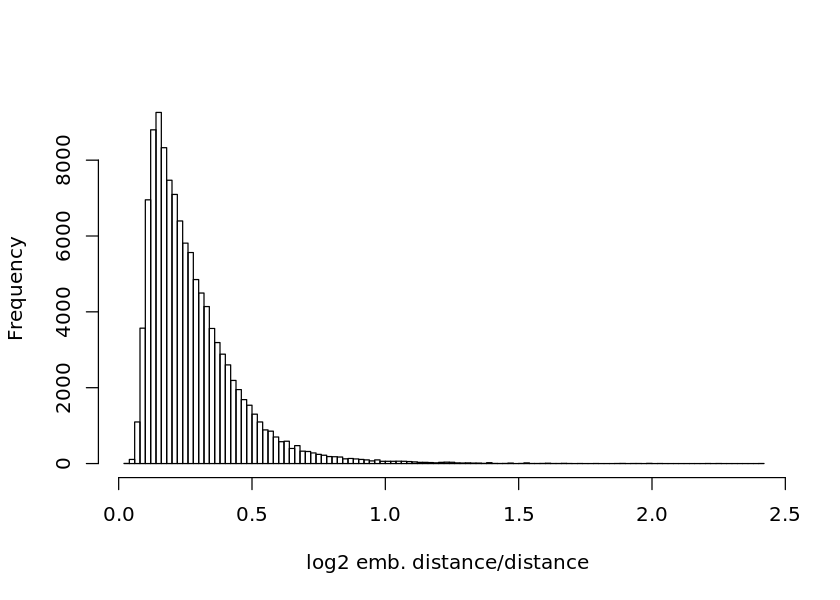

In [599]:
plotdistanceratio(ltr)

Visualisation of cell-to-cell distances in the embedded space. Values close to zero show good conservation of these distances.

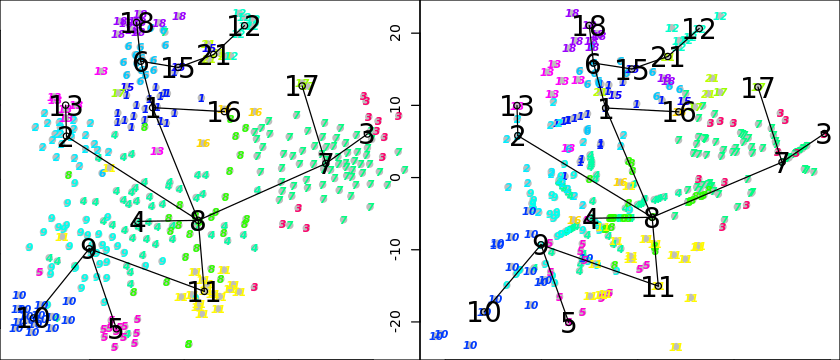

In [647]:
options(repr.plot.height = 3)
par(mfrow=c(1,2), mar=c(0,0,0,0), cex=0.7)
plotmap(ltr)
plotmapprojections(ltr)

Left: Minimum spanning tree  
Right: Same, but with cells projected along the inter-cluster links.

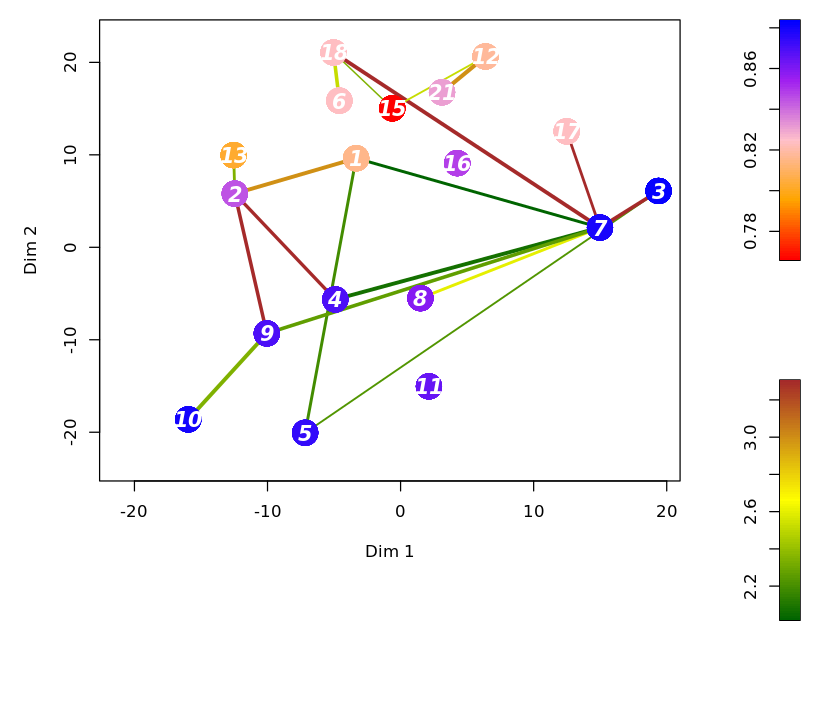

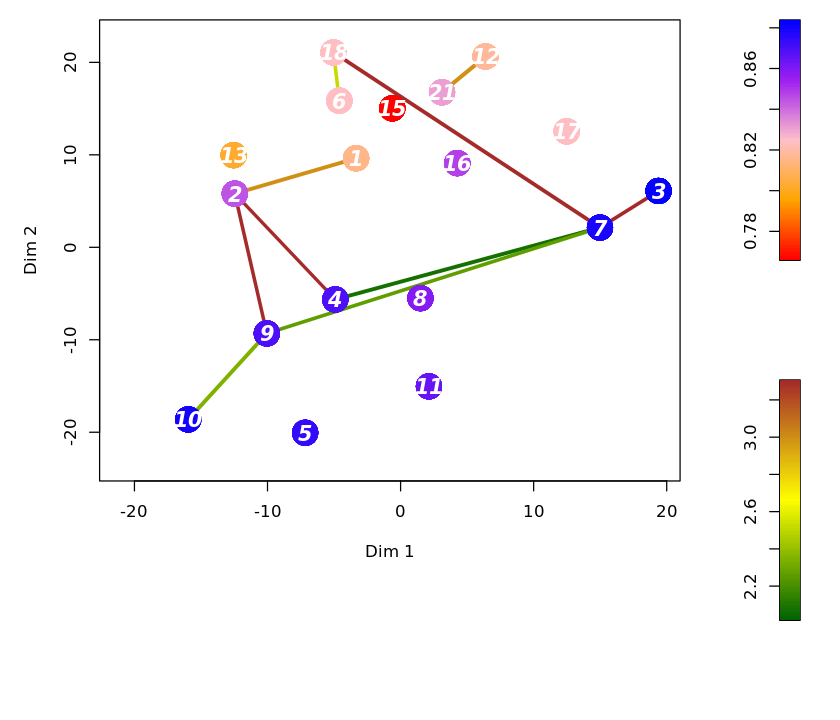

In [661]:
options(repr.plot.height = 6)
plottree(ltr,showCells=F,nmode=T,scthr=0.001)
plottree(ltr,showCells=F,nmode=T,scthr=0.5)

Nodes are coloured by their delta-entropy levels (think: Shannon Entropy, amount of disorder within the vector/cluster). Lower is better, higher is worse, but the difference here is 0.7-0.9 so mostly marginal.

Edges are coloured by the -log10(pvalue) of the link, and the widths indicate the link score.

Above shows all links, and the one below shows the same links filtered for a significance threshold of 0.5

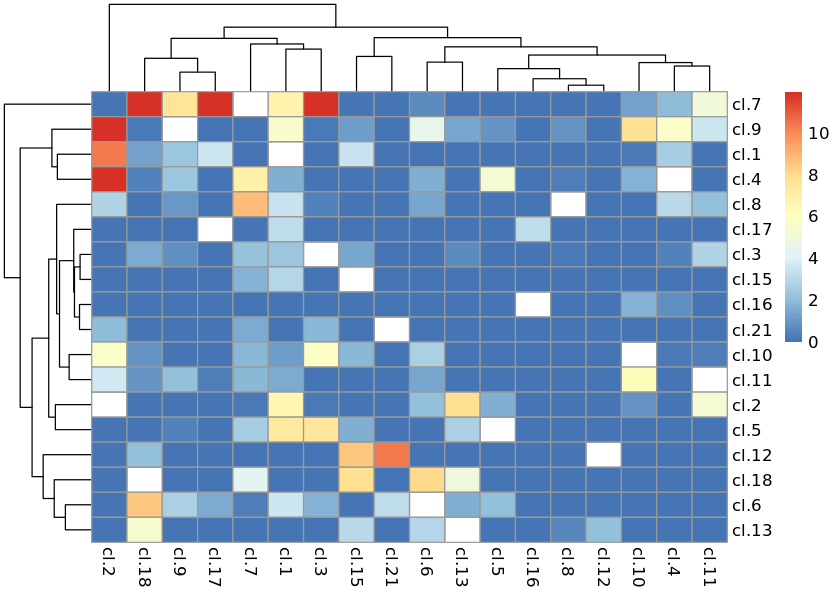

In [664]:
# As above, matrix form
# - row → column, where row is the ingoing link and column is the destination.
options(repr.plot.height=5)
plotlinkpv(ltr)

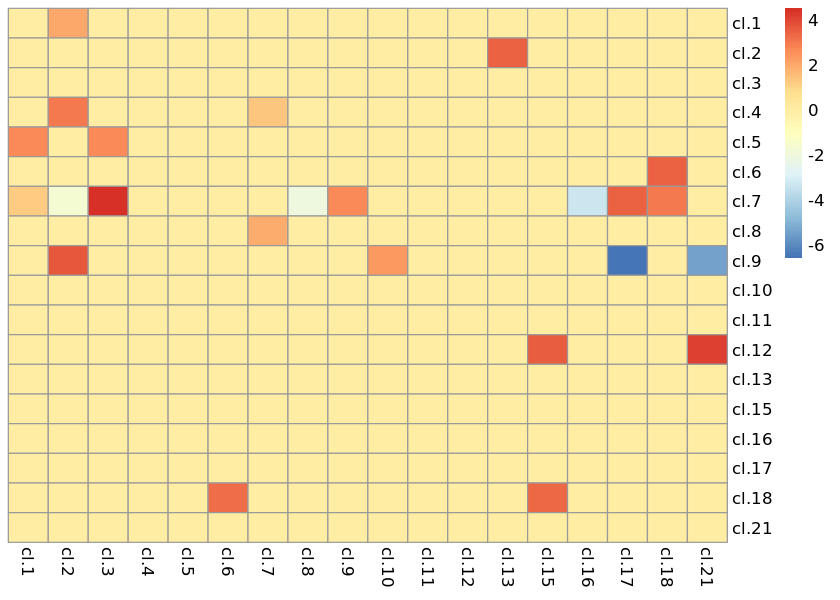

In [665]:
# Log2ratio number cells on a link, against a background model
# -- again row → column
# Colour of the link
projenrichment(ltr)

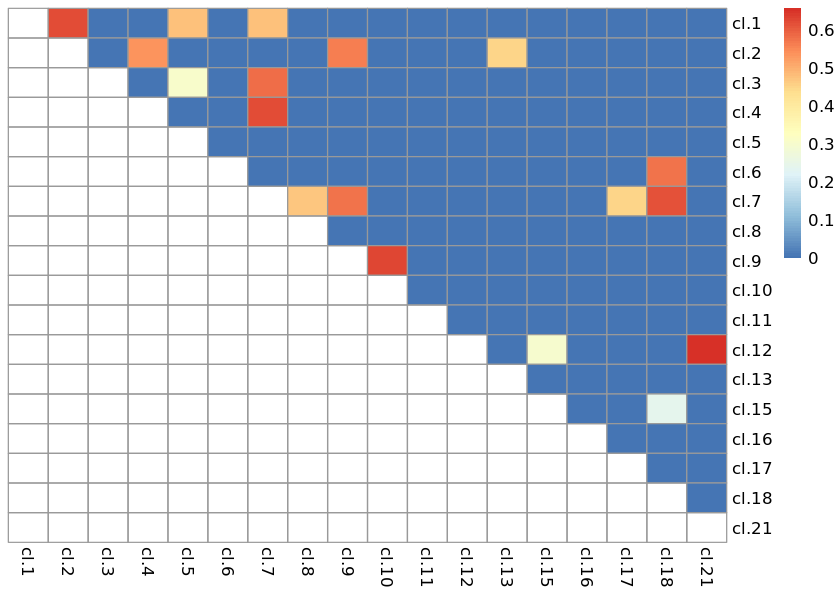

In [667]:
# width of each link (link score) -- population of cells on the link
# -- i.e. how many cells the score describes
# -- This is the main indicator of a differentiation trajectory.
plotlinkscore(ltr)

#### Analysing lineage tree: Cluster / Cell designations

Quick overview of how specific cells fit into their cluster designations. Strong for early cluster numbers, weaker for late.

[1] "Cluster =  1"


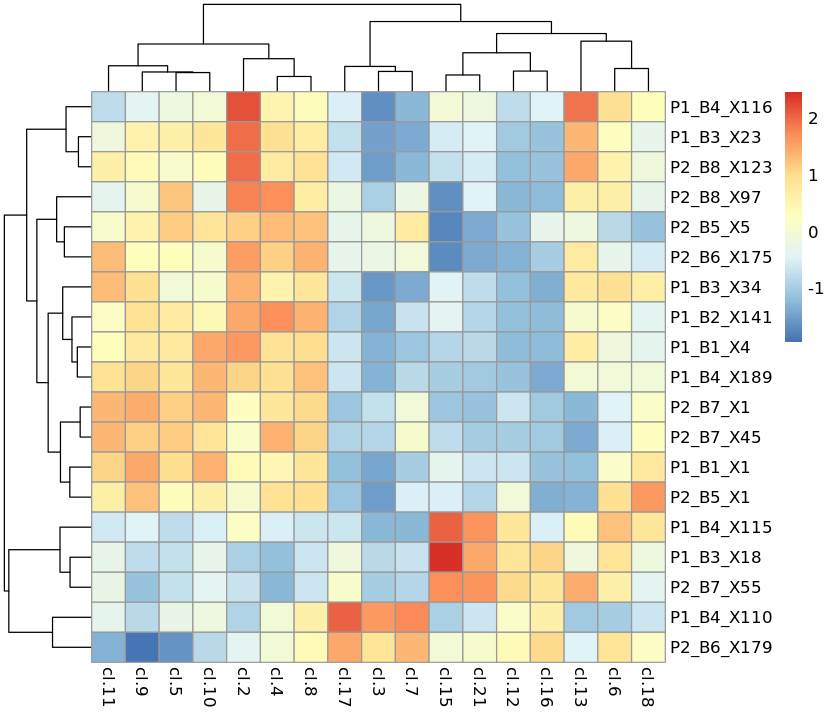

[1] "Cluster =  2"


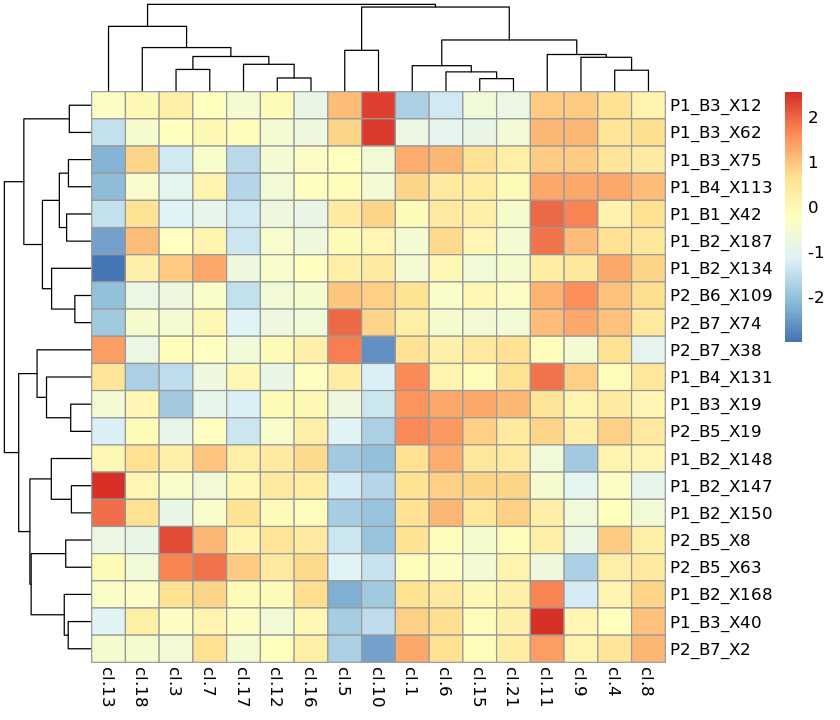

[1] "Cluster =  3"


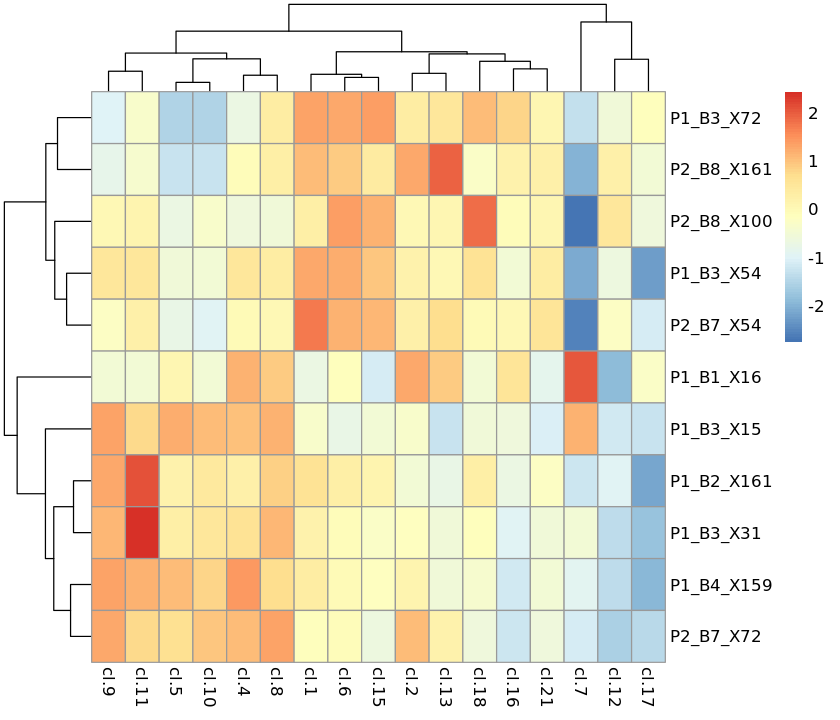

[1] "Cluster =  4"


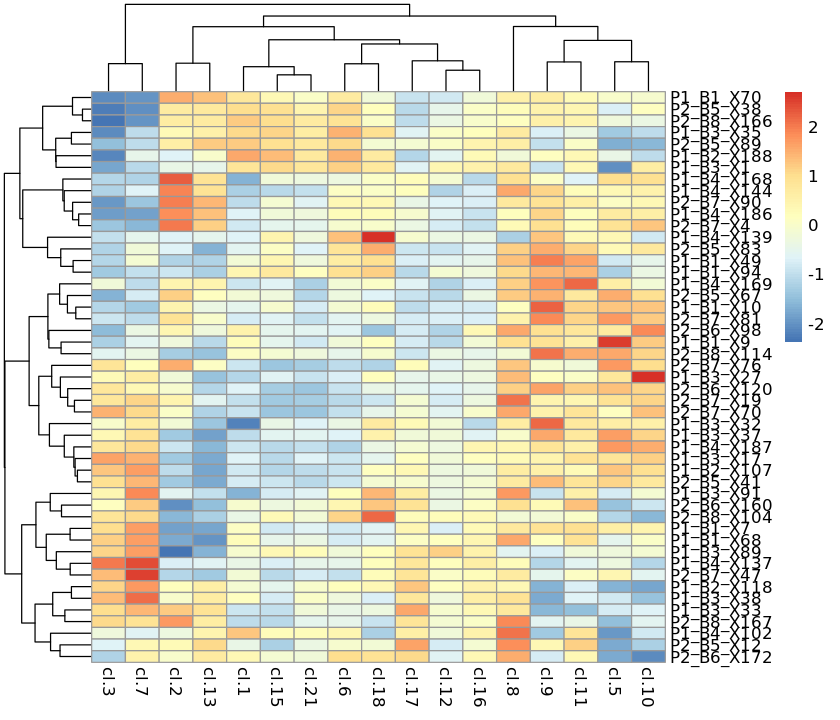

[1] "Cluster =  5"


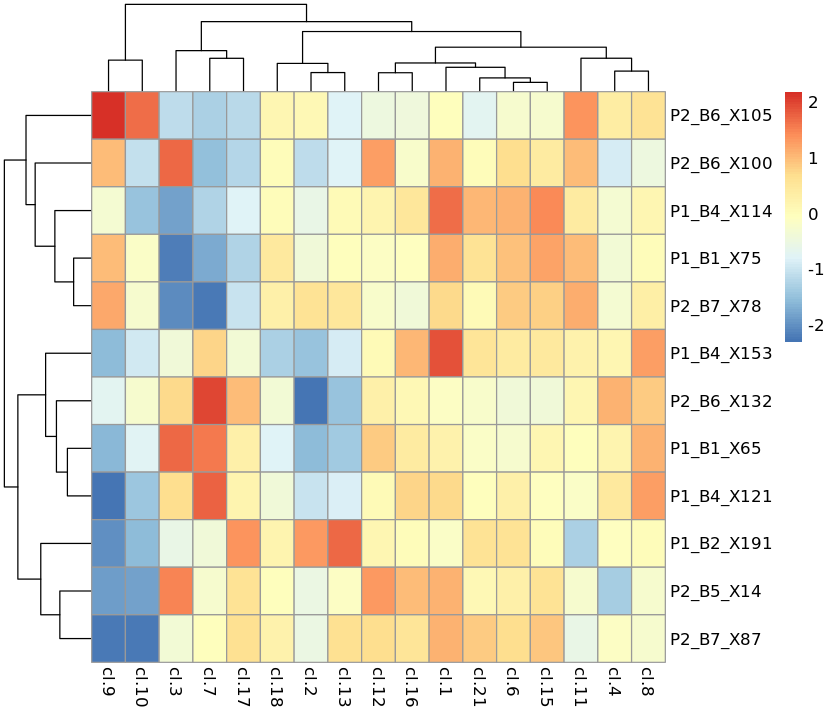

[1] "Cluster =  6"


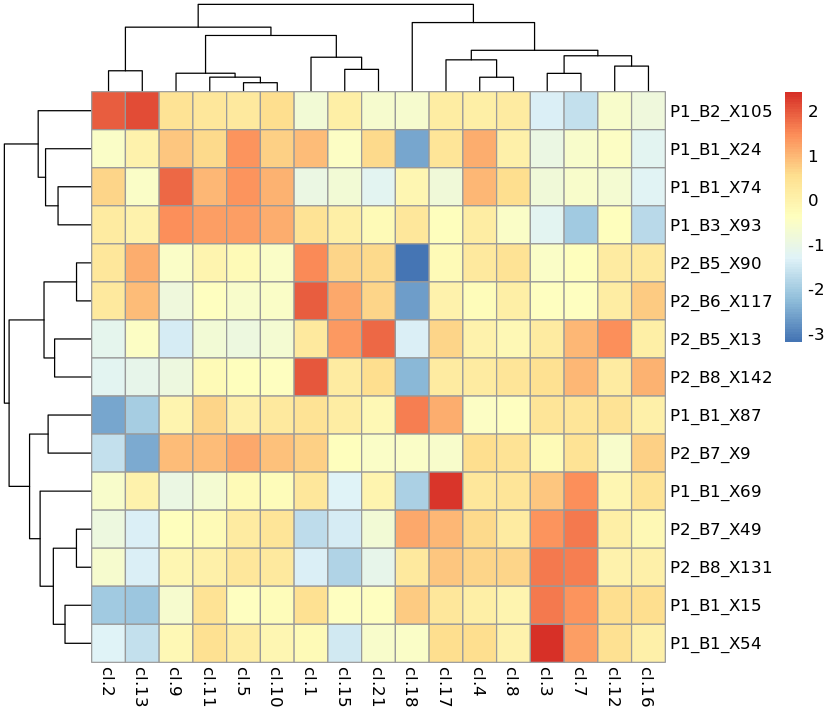

[1] "Cluster =  7"


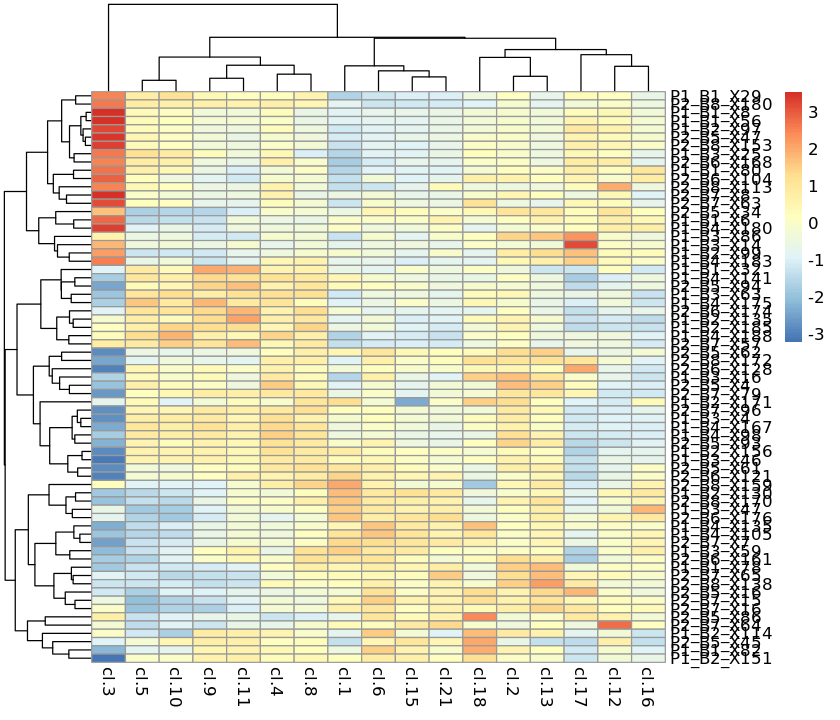

[1] "Cluster =  8"


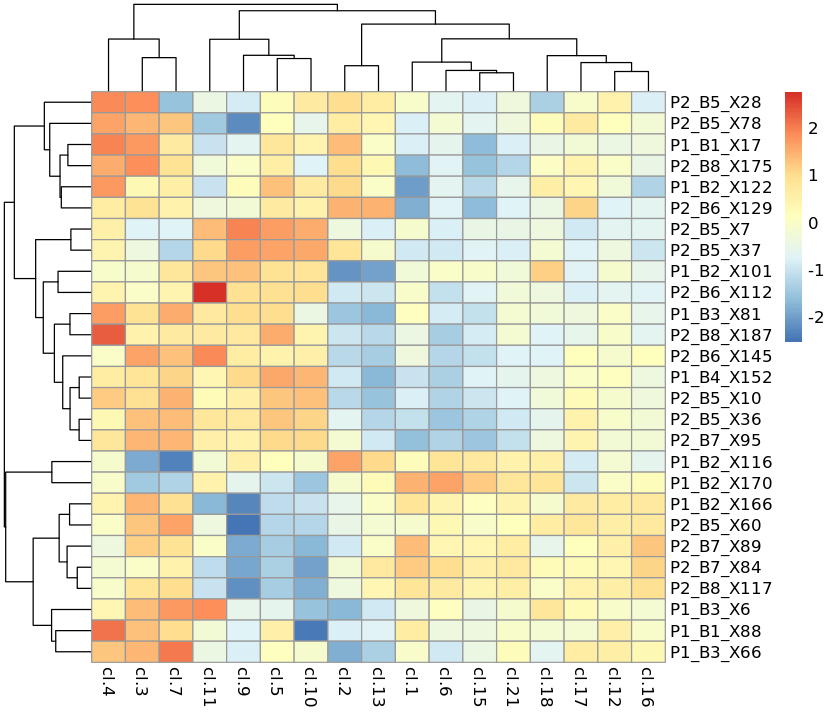

[1] "Cluster =  9"


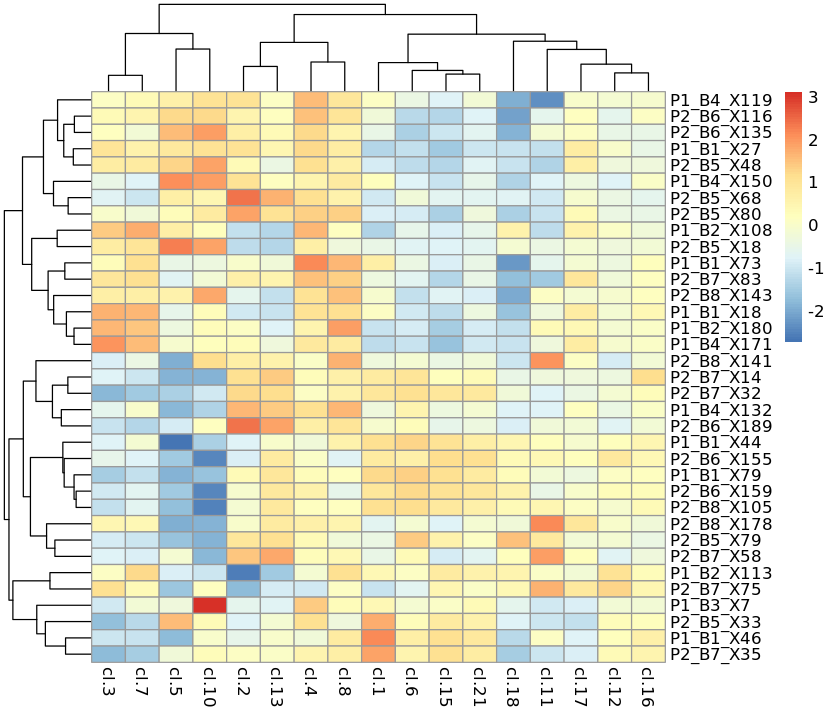

[1] "Cluster =  10"


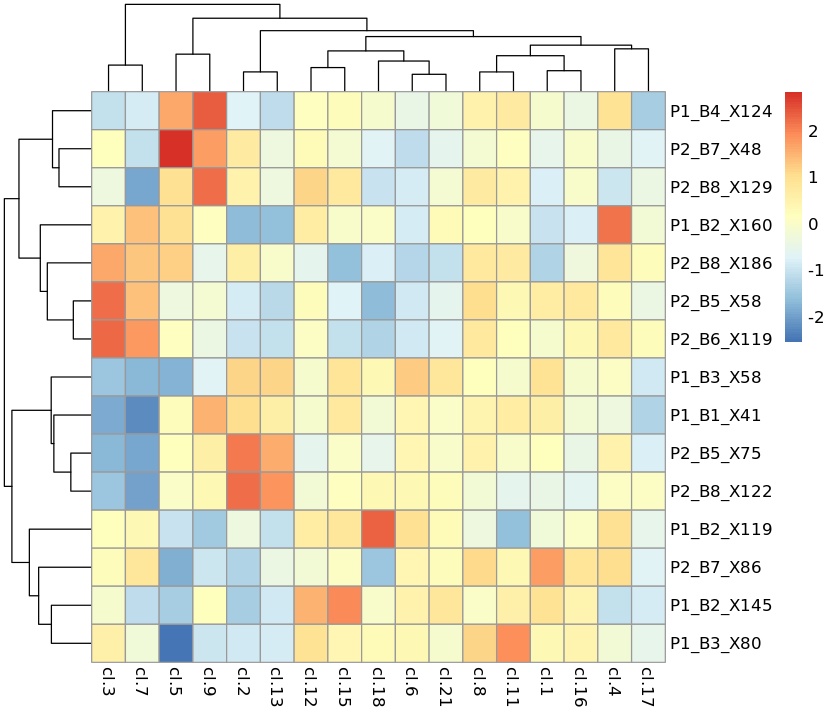

[1] "Cluster =  11"


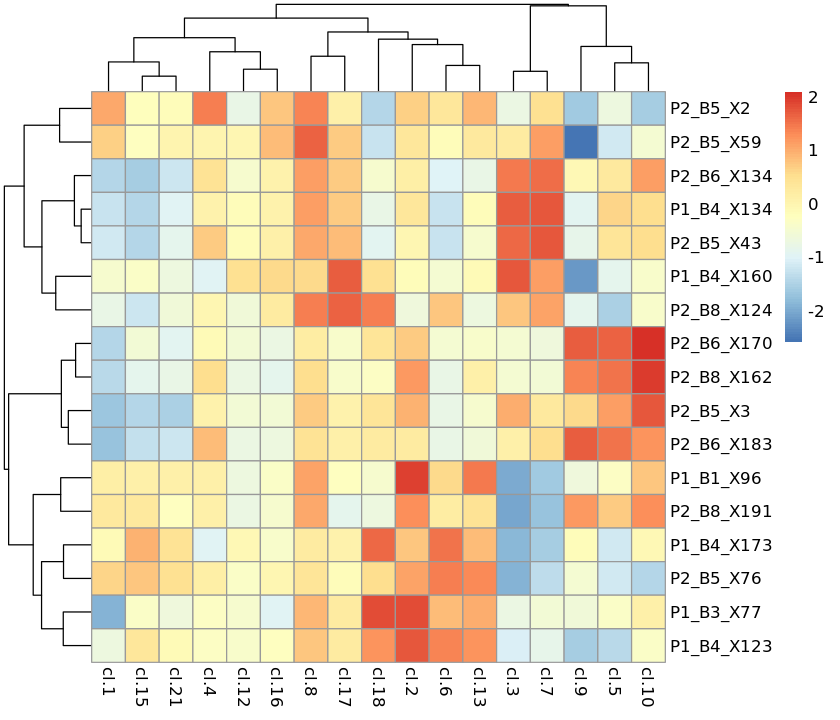

[1] "Cluster =  12"


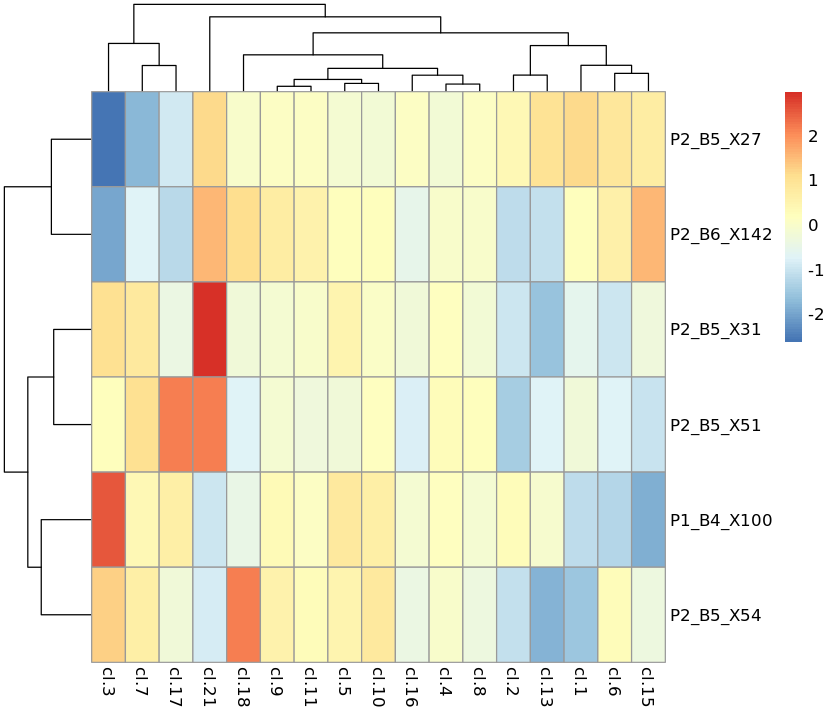

[1] "Cluster =  13"


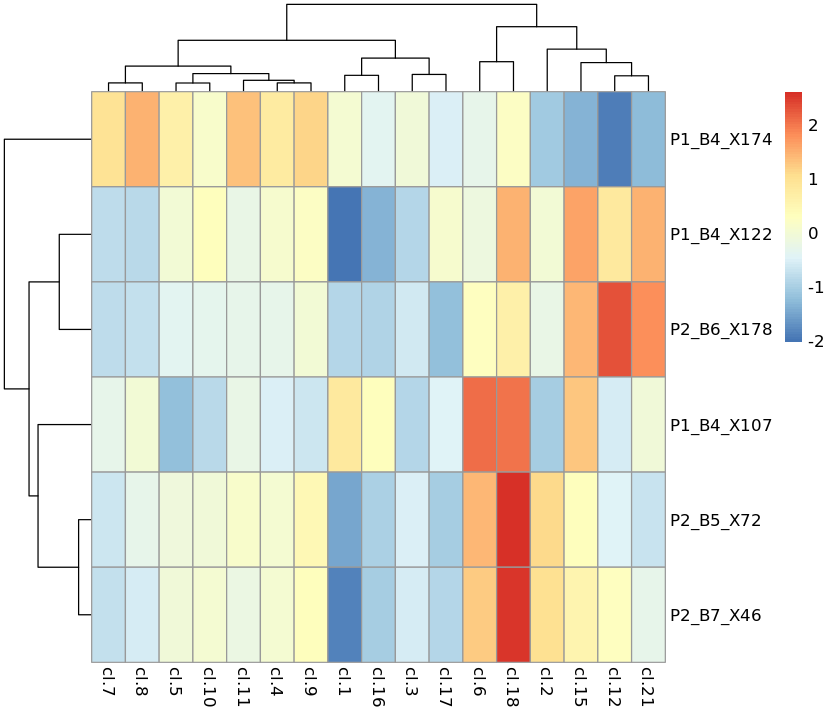

[1] "Cluster =  15"


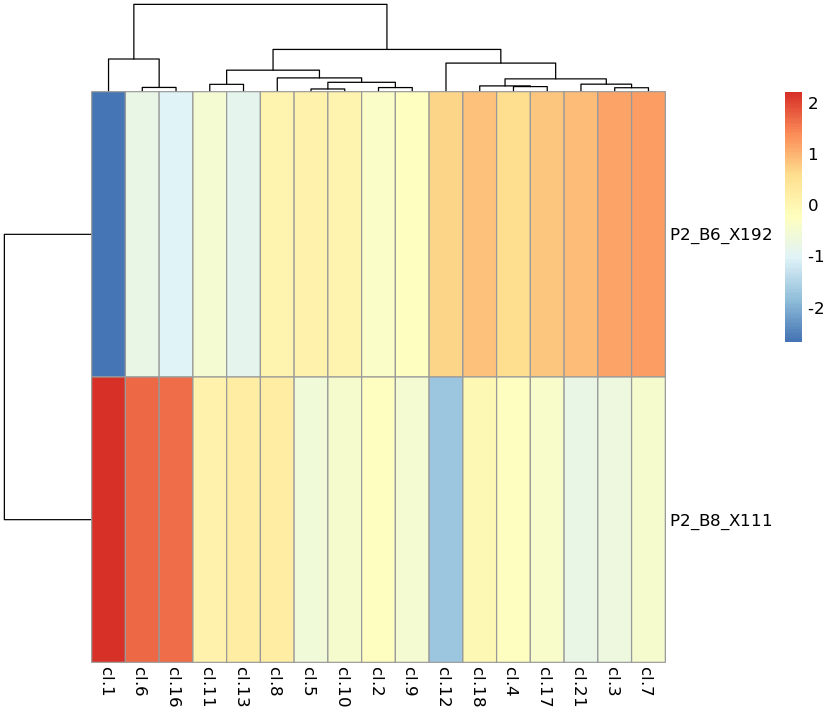

[1] "Cluster =  16"


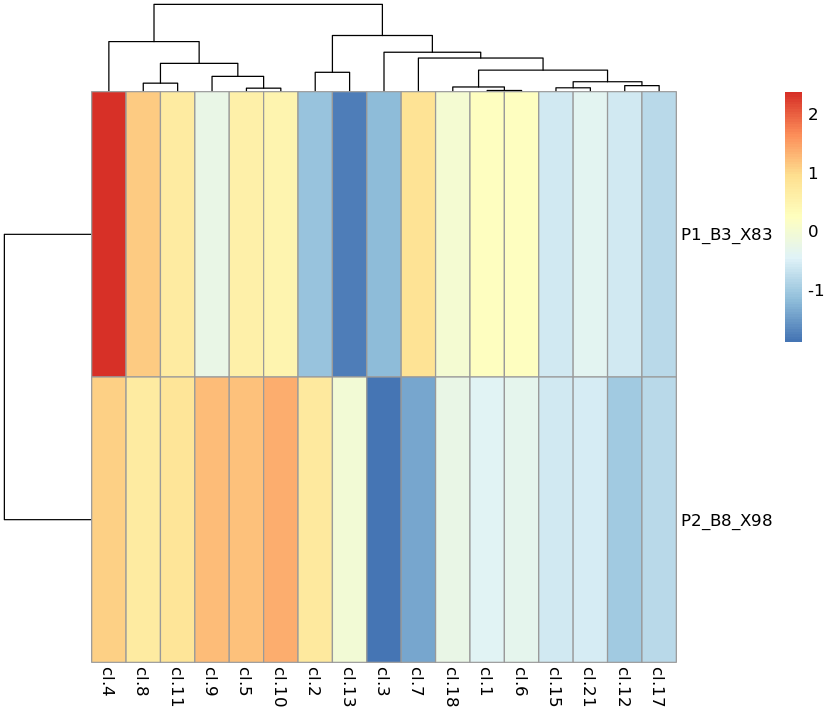

[1] "Cluster =  17"


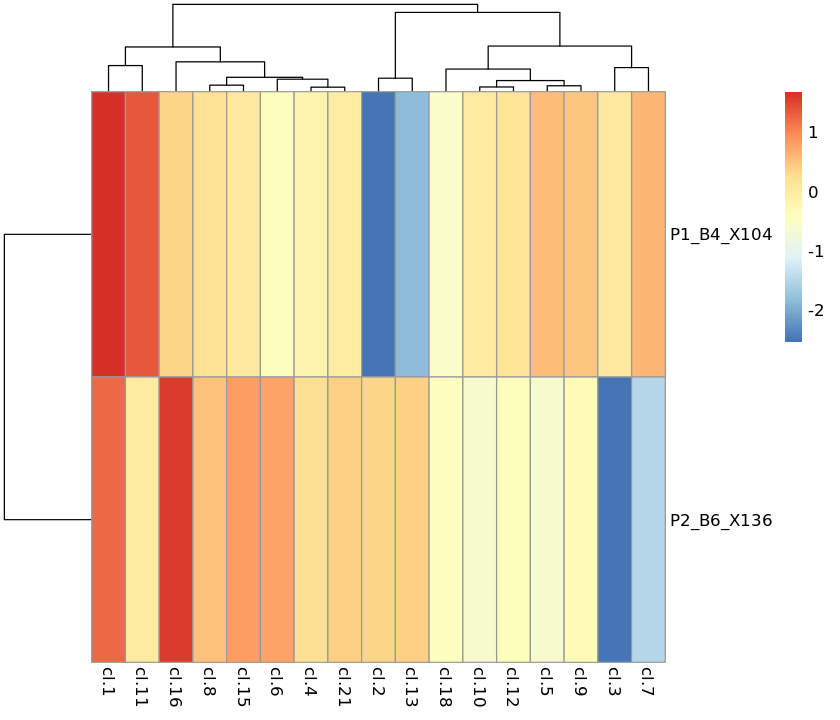

[1] "Cluster =  18"


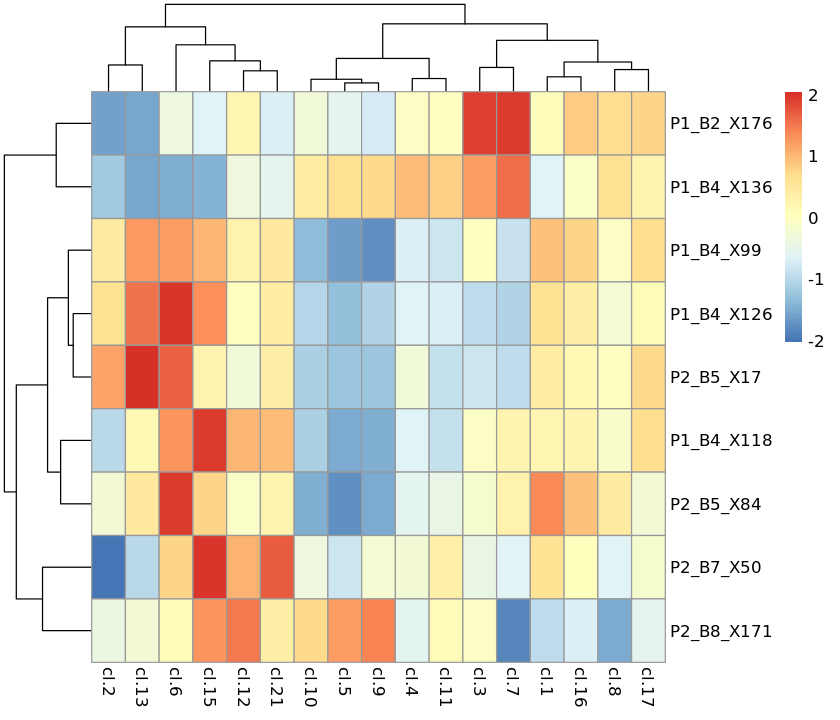

[1] "Cluster =  21"


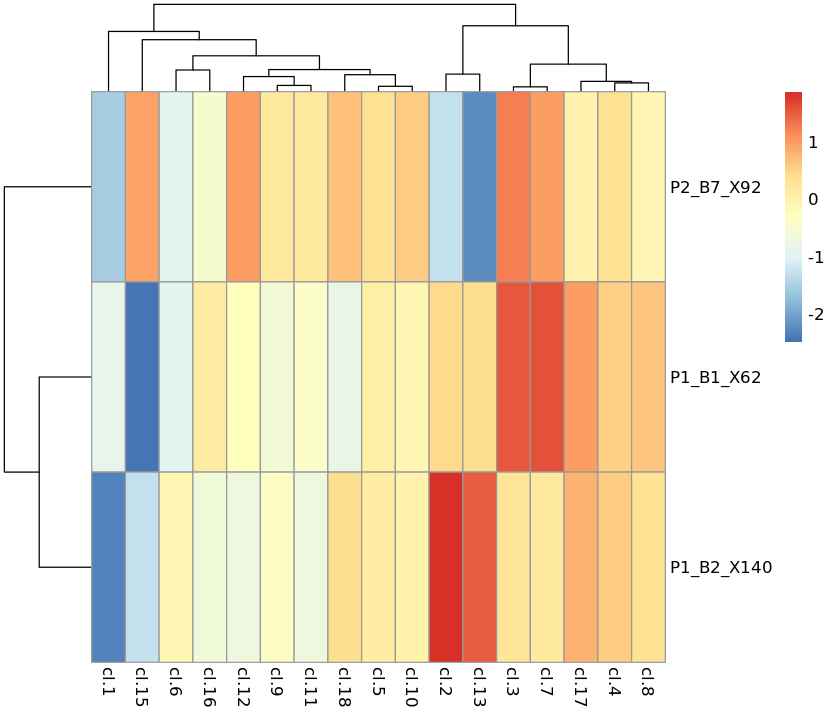

In [685]:
#options(repr.plot.height = 6)
#
clust_nums <- as.integer(sub("cl\\.(\\d+)","\\1", names(ltr@cdata$counts)))
#clust_nums

analyseClust <- function(clnum){
    x <- getproj(ltr,i=clnum)
    pheatmap(x$prz)
    print(sprintf("Cluster =  %d", clnum))
}

x <- lapply(clust_nums, analyseClust)


The intercluster links between all the cells of one cluster, and their link to another cluster.

Notice the strong preference for many cells in Cluster7 to Cluster3 (but not vice versa).



https://github.com/dgrun/RaceID3_StemID2/blob/master/Reference_manual_RaceID3_StemID2.pdf

## Examining Branches

In [562]:
# Methods
examineTop9InOut <- function(one_two_three){
    sects <- unlist(lapply(
        strsplit(one_two_three," → "), as.integer
    ))

    early <- paste(sort(sects[1:2]), collapse=".")
    later <- paste(sort(sects[2:3]), collapse=".")
    
    # insensitive to direction...
    x <- branchcells(ltr, list(later,early))

    lim <- 7
    
    par(mfrow=c(3,3))
    name_list <- names(x$diffgenes$z)[1:lim]
    
    if ("T" %in% names(x$diffgenes$z)){
        if (!("T" %in% name_list)){
            name_list <- c(name_list, "T")
        }
    }
    if ("Eomes" %in% names(x$diffgenes$z)){
        if (!("Eomes" %in% name_list)){
            name_list <- c(name_list, "Eomes")
        }
    }
    
    zz <- lapply(name_list, function(r){
        plotdiffgenes(x$diffgenes,r)
    })
    
    print(one_two_three)
    t(head(x$diffgenes$z,lim))
}

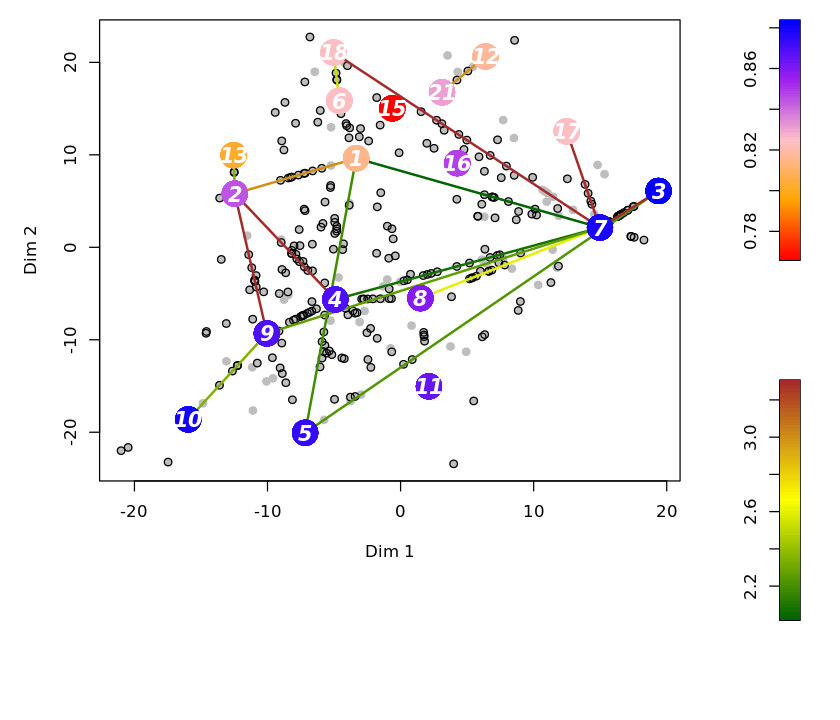

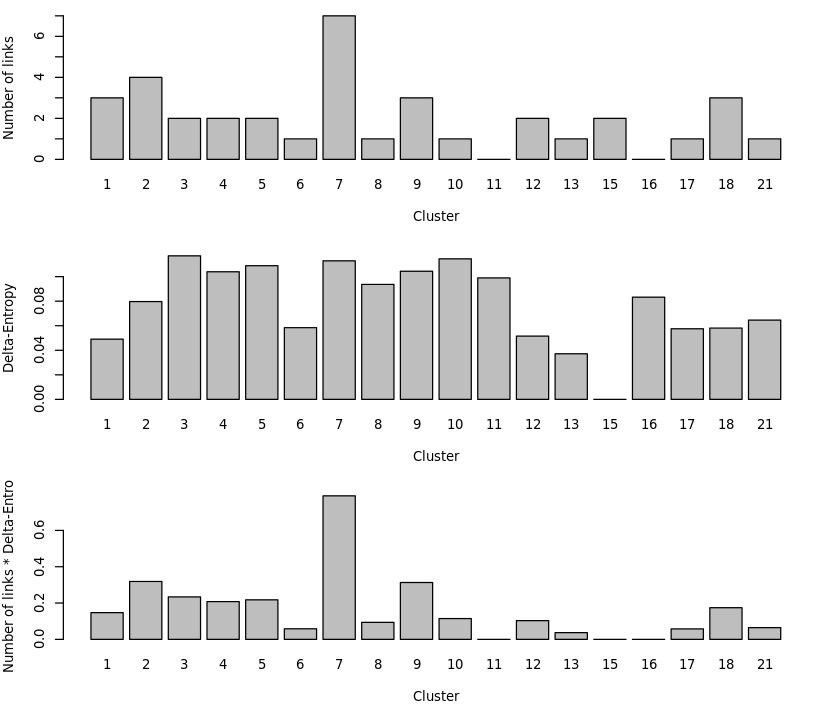

In [623]:
plottree(ltr,showCells=T,nmode=F,scthr=.3)
x <- compscore(ltr)
x <- plotscore(ltr)

Branches to examine:  
 
  | Strong | Moderate | Weak |
  | -----
  | 3 → 7 → 17 | 2 → 17 → 5 | 4 → 10 → 20 |
  | 1 → 2 → 17 | 1 → 17 → 5 |
  | 13 → 2 → 17 | 2 → 13 → 6 |
  |             | 8 → 3 → 11 |
  

### Strong branches

[1] "1 → 2 → 13"


Cnn2,Sltm,Kdm5a,Tpp2,Haus3,T,Mesp1
1.950005,1.839584,1.774125,1.690257,1.633329,1.620452,1.564845


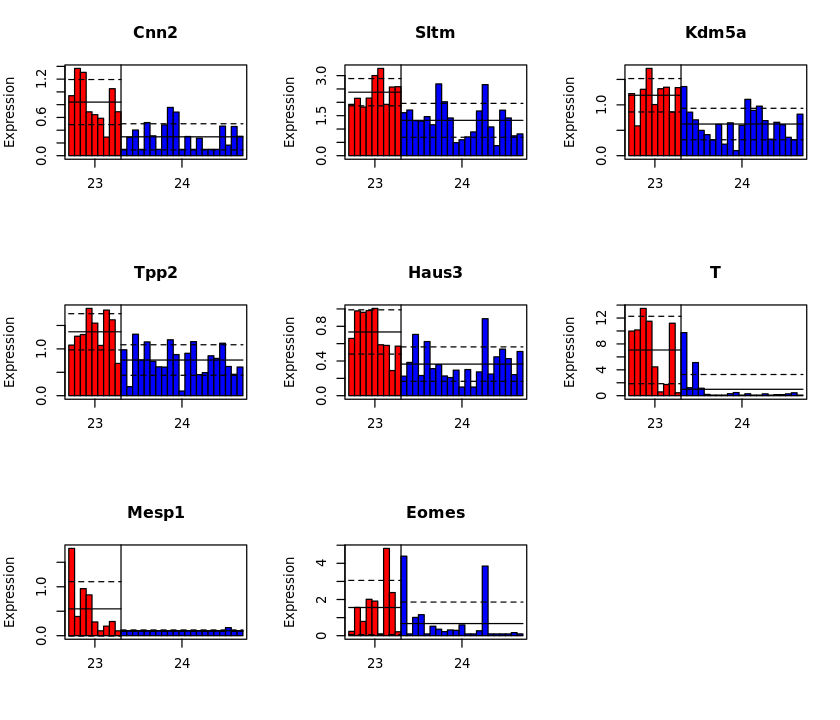

[1] "1 → 2 → 17"


Rps24,Rpl30,Rpl18a,Rps13,Rpl5,Otx2,Ran
1.556505,1.491975,1.472928,1.394318,1.357249,1.337906,1.328027


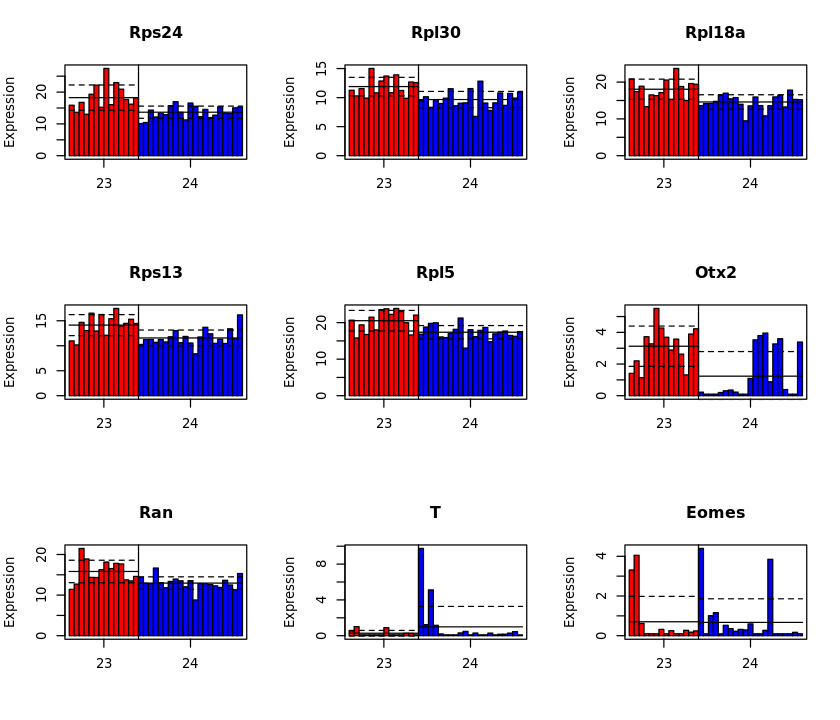

[1] "13 → 2 → 17"


Rpl30,Rps13,Cox7b,Rps24,Atp5g2,Phc1,0610007P14Rik
2.283927,2.1125,2.072632,2.031298,1.970042,1.861513,1.846103


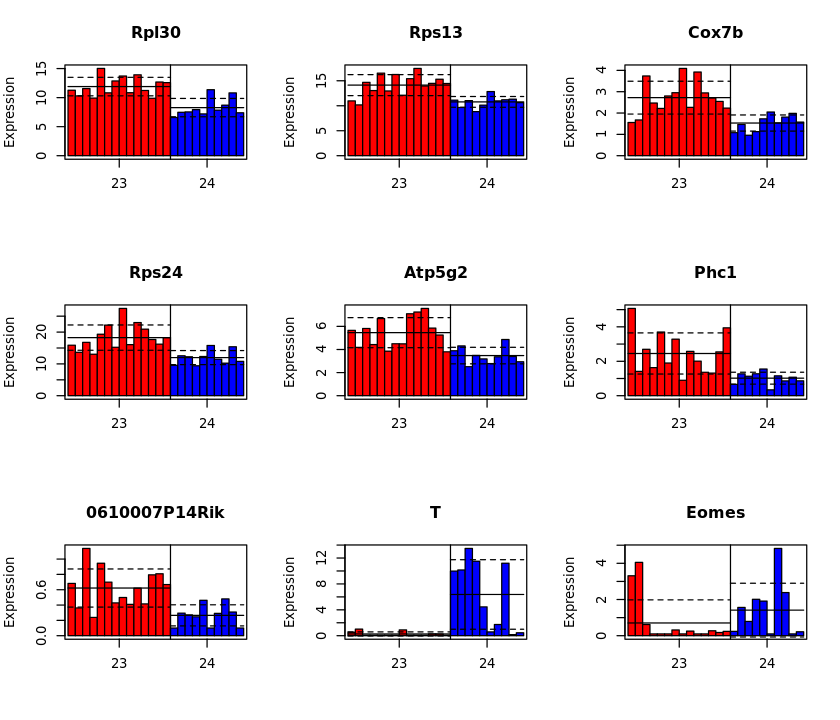

In [563]:
examineTop9InOut("1 → 2 → 13")
examineTop9InOut("1 → 2 → 17")
examineTop9InOut("13 → 2 → 17")

### Moderate branches

[1] "2 → 17 → 5"


Ndufb9,2810004N23Rik,Arxes2,Cisd2,Ddx18,Gtf2e2,Kars
14.10196,9.878239,9.878239,9.878239,9.878239,9.878239,9.878239


[1] "1 → 17 → 5"


Slc16a1,Lap3,Dynll1,Prps2,Seh1l,Clcn3,Ddx42
95.84089,23.62157,12.1838,8.988207,8.988207,7.611793,7.611793


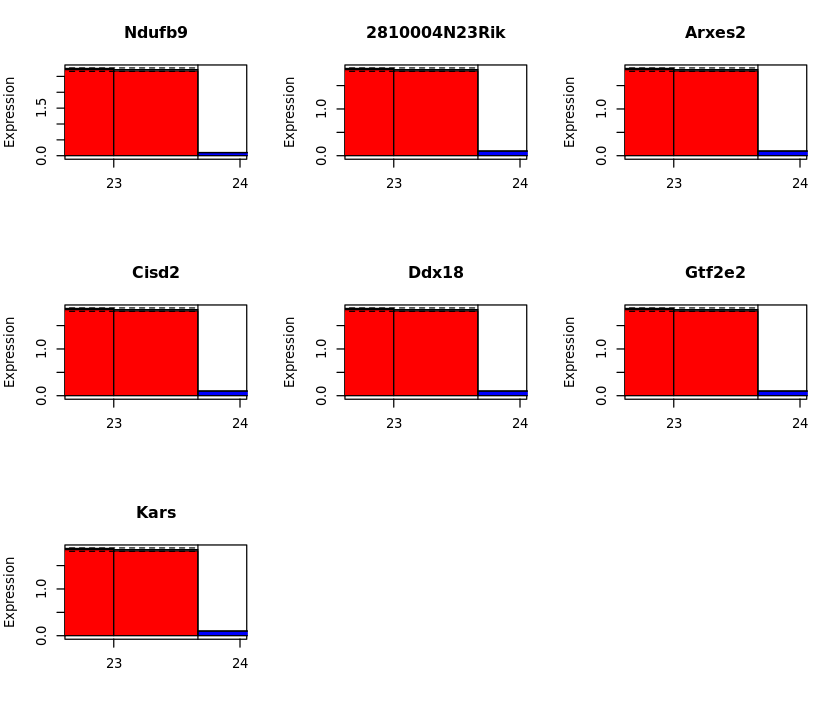

[1] "8 → 3 → 11"


Mphosph10,Cacybp,Gapvd1,Tomm20,Vapa,Cenpb,Tfrc
23.20154,20.37604,12.28814,11.1335,8.800614,8.259391,8.248227


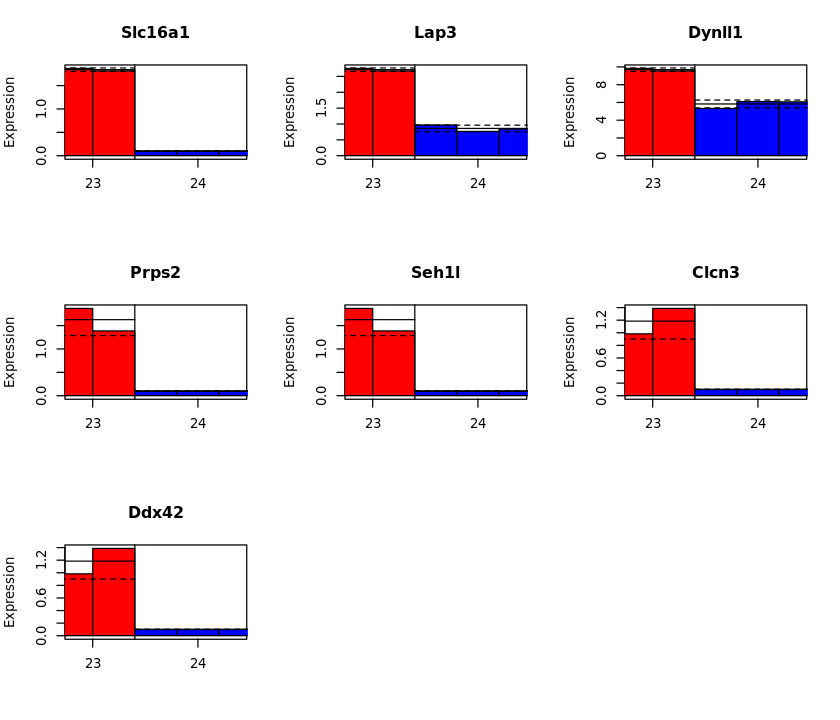

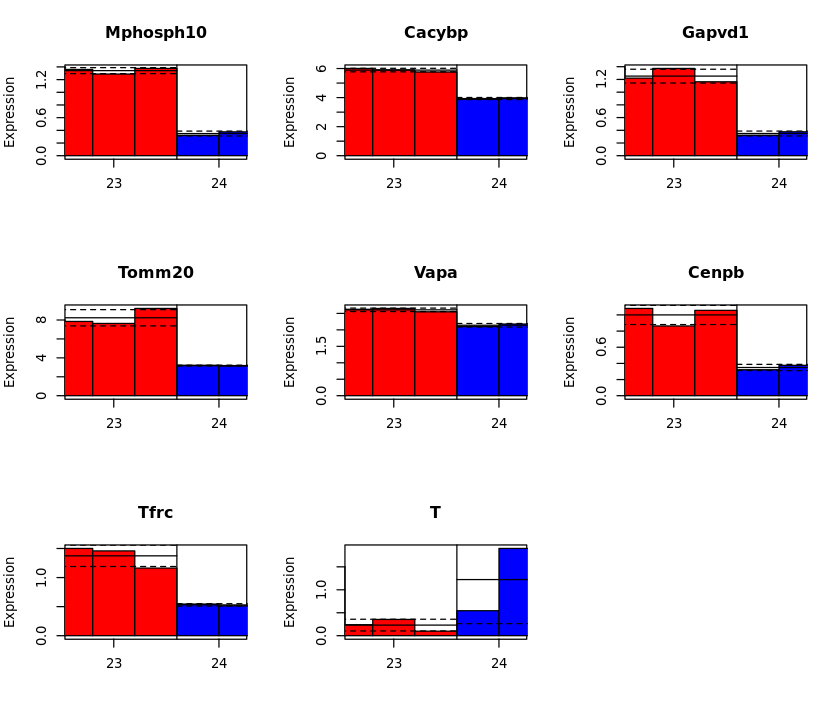

In [566]:
examineTop9InOut("2 → 17 → 5")
examineTop9InOut("1 → 17 → 5")
#examineTop9InOut("2 → 13 → 6") # fails...
examineTop9InOut("8 → 3 → 11")

In [572]:
#x <- branchcells(ltr, list("2.13","6.13"))

### Weak branches

[1] "4 → 10 → 20"


Phlda2,Cited1,Gm43549,Aldh1a2,Vim,Rbp1,Id3
3.212711,3.126568,3.042394,3.018957,2.908409,2.556375,2.431069


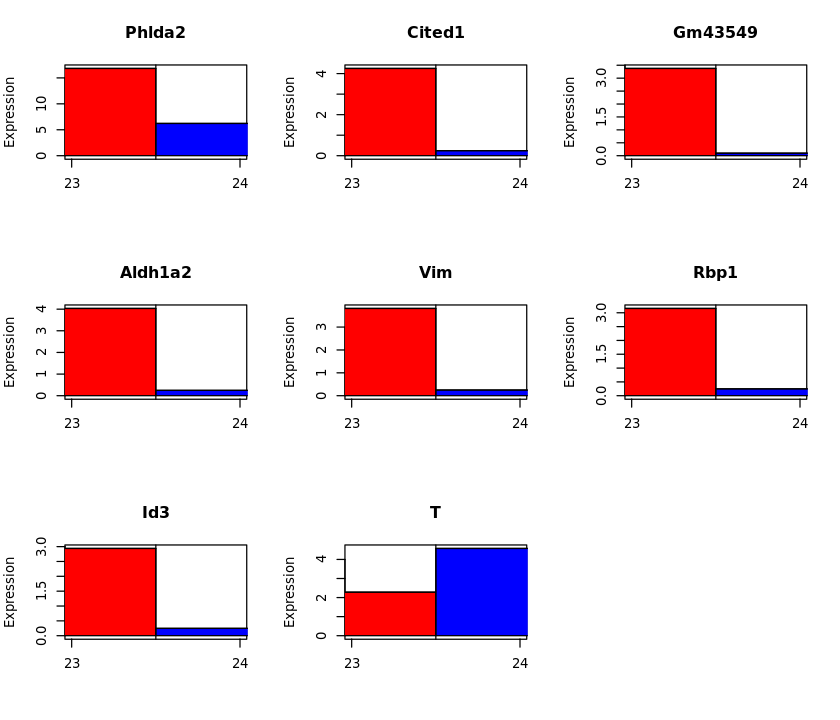

In [573]:
examineTop9InOut("4 → 10 → 20")

## Inspecting pseudo-temporal gene expression changes

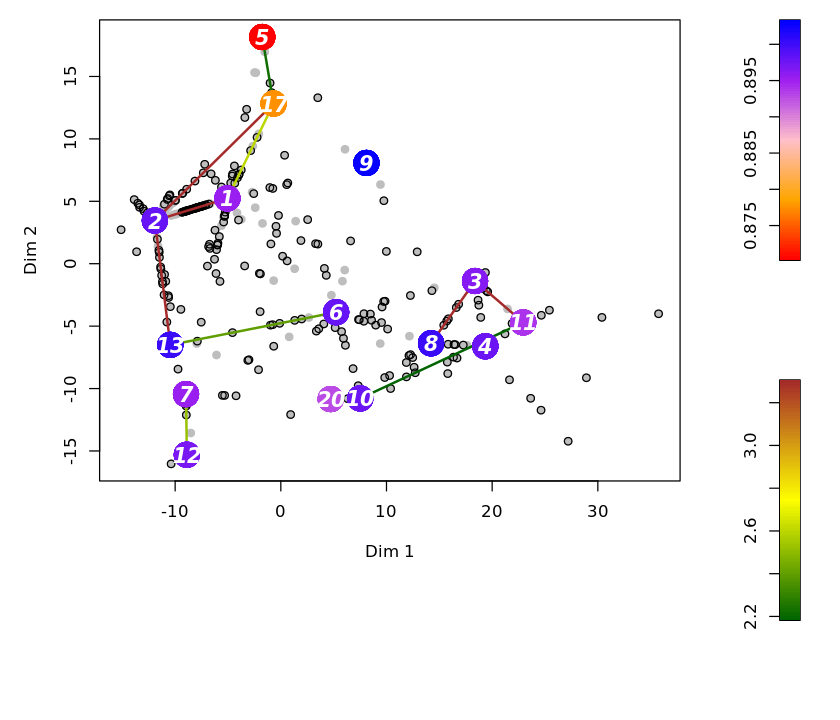

In [575]:
plottree(ltr,showCells=T,nmode=F,scthr=.3)

Genes with significant expression along a given trajectory are grouped by their expression profiles into modules within a z-score transformed SOM.

### How to inspect trajectories?

We could try to see how every possible gene is expressed along every single pathway, but this would be madness to sort. 

It is better to simply investigate how T and Eomes differ along each pathway since they are our main genes of interest.

There are however many more genes of interest that we can discover via this method. None of which are more prevalent than those we have just explored.



#### Methods

In [705]:
# Method to see if T and Eomes diverge significantly 
# for a given trajectory


plotHeats <- function(ps, fcol){
    options(repr.plot.height = 5)
    plotheatmap(ps$nodes.z, xpart=y, xcol=fcol, ypart=unique(ps$nodes), xgrid=F, ygrid=T, xlab=F)
#    plotheatmap(
#        ps$all.z, xpart=y, xcol=fcol, ypart=ps$nodes, 
#        xgrid=F, ygrid=T, xlab=F)
#    plotheatmap(
#        ps$all.e, xpart=y, xcol=fcol, ypart=ps$nodes, 
#        xgrid=F, ygrid=T, xlab=F)
    plotheatmap(ps$all.b, xpart=y, xcol=fcol, ypart=ps$nodes, xgrid=F, ygrid=T, xlab=F)
}

findTandEomesNodes <- function(ps){
    # Find nodes where T and Eomes expressed
    t_node <- ps$nodes[names(ps$nodes) == "T"]
    e_node <- ps$nodes[names(ps$nodes) == "Eomes"]

    t_group_nodes <- names(ps$nodes[ps$nodes == t_node])
    e_group_nodes <- names(ps$nodes[ps$nodes == e_node])

    tab <- setNames(
        data.frame(
            rbind(
                c(t_node, length(t_group_nodes), paste(t_group_nodes, collapse=", ")),
                c(e_node, length(e_group_nodes), paste(e_group_nodes, collapse=", "))
            ),
            row.names = c("T","Eomes")
        ), c("Node", "Num", "Genes in same node")
    )
    
    return(list(
        table = tab,
        t_genes = t_group_nodes,
        e_genes = e_group_nodes
    ))    
}

plotTandE <- function(fs,y, fcol, n, t_nodes, e_nodes){
    #options(repr.plot.height = 8)
    par(mfrow=c(3,2))
    plotexpression(fs,y, t_nodes, n$f, k = 19, col = fcol, name="  T   group genes")
    plotexpression(fs,y, e_nodes, n$f, k = 19, col = fcol, name="Eomes group genes")
    plotexpression(fs,y, "T", n$f, k = 10, col = fcol)
    plotexpression(fs,y, "Eomes", n$f, k = 10, col = fcol)
}

doTrajectory <- function(trajectory){
    n <- cellsfromtree(ltr, trajectory)
    fs <- filterset(ltr@sc@ndata, n=n$f,  minexpr=2, minnumber=1)
    sld <- getsom(fs, nb=1000, k=5, locreg=T, alpha=.5)
    ps <- procsom(sld, corthr=.85, minsom=3)
    
    return(list("ps" = ps, "n" = n, "fs" = fs))
}


trajExplore <- function(trajectory){
    obj <- doTrajectory(trajectory)
    
    ps <- obj$ps
    n <- obj$n
    fs <- obj$fs
    
    t_and_e = findTandEomesNodes(ps)
    
    fcol = ltr@sc@fcol
    y = ltr@sc@cpart[n$f]

    plotHeats(ps, fcol)    

    #plot.new()
    par(mar=c(1,1,1,1))
    plotTandE(fs,y,fcol, n, t_and_e$t_genes, t_and_e$e_genes)
    return(t_and_e$table)
}




### Strong branches

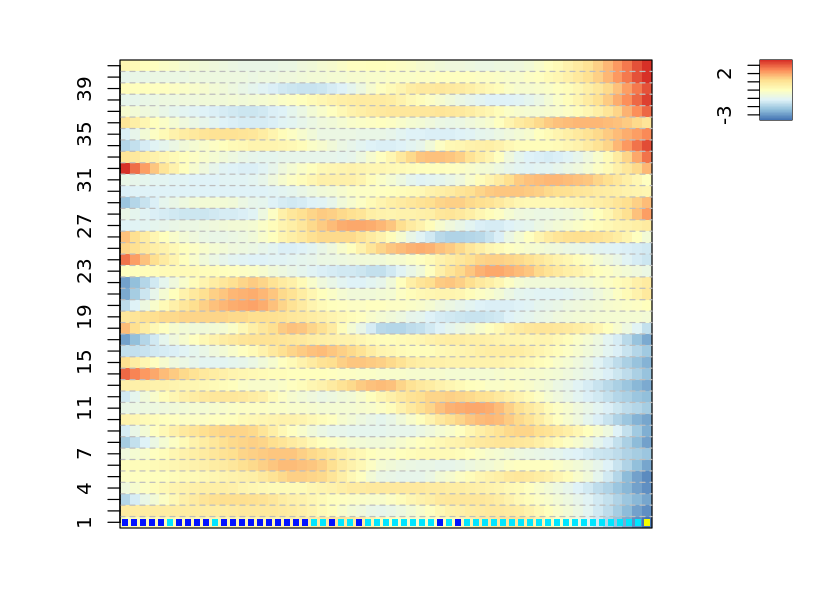

,Node,Num,Genes in same node
T,41,74,"Adgrl2, Adipor1, Ahctf1, Apc, Apln, Btbd1, Cachd1, Cbx2, Cdv3, Cited2, Cnih1, Eif2s3x, Eif4h, Eif5, Epha4, Hmgb3, Hnrnpr, Hspa5, Kcmf1, Mia3, Mns1, Mphosph8, Naa15, Nasp, Pmpcb, Ppp4r2, Prickle1, Prpf4, Sep15, Sept7, Sf3b1, Smarca4, Smc1a, Srsf11, Supt16, Tax1bp1, Tceal8, Tmed10, Trip12, Trnt1, Tsc22d1, Vcp, Wnk1, Ythdc1, Zfr, Ctsl, Dnajc5, Peg3, Pmaip1, Prtg, Thrap3, Fn1, Abi2, Crebbp, Ctbp2, Ddx3x, Dock11, Evx1, Frzb, Fst, Gas1, Hoxb1, Larp1, Meis2, Mixl1, Mtpn, Rab2a, Rai14, Rbbp7, Rlim, Rspo3, Sgk1, T, Tbx6"
Eomes,38,60,"1110004F10Rik, Atp6v1b2, Atp6v1g1, Azin1, Bcat1, Blmh, Braf, Cacybp, Cct5, Cct7, Csnk1a1, Ctdsp2, Cul3, Ddx17, Ddx21, Ddx27, Dnajc2, Dpf2, Eef2, Egln1, Eif1a, Eif2ak1, Eif3l, Eif5b, Elp3, Eomes, Fgf4, Glul, Gm16286, Gm38312, Ifitm1, Itgb5, Ly6e, Mapk1ip1l, Mtf2, Nolc1, Oat, Pafah1b1, Pdha1, Pgk1, Ppp2r1b, Prrc2b, Rbm3, Rps6ka6, Rps9, Rrp1, Sall3, Scd2, Sema6a, Setd8, Slc25a1, Sltm, Tcerg1, Tcf7l2, Tead2, Tomm20, Tpm4, Wdfy1, Zc3h15, Zfp322a"


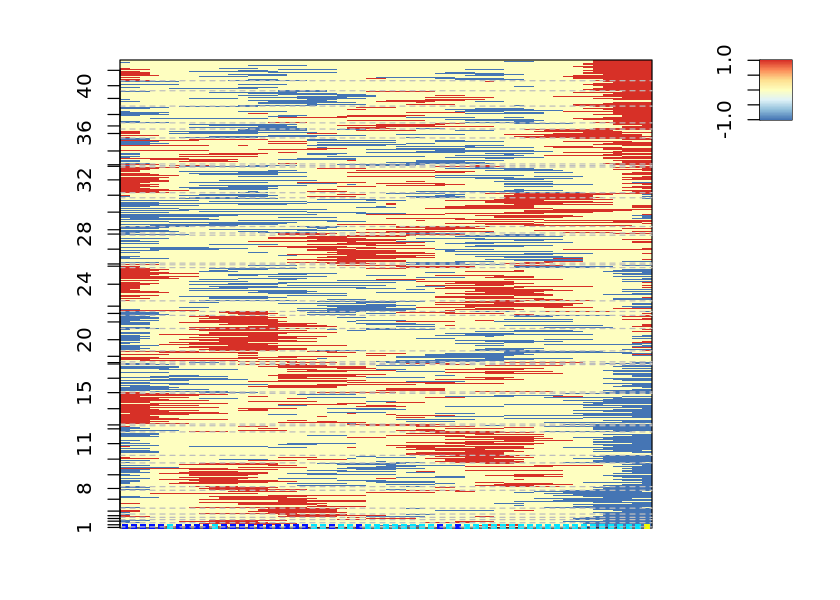

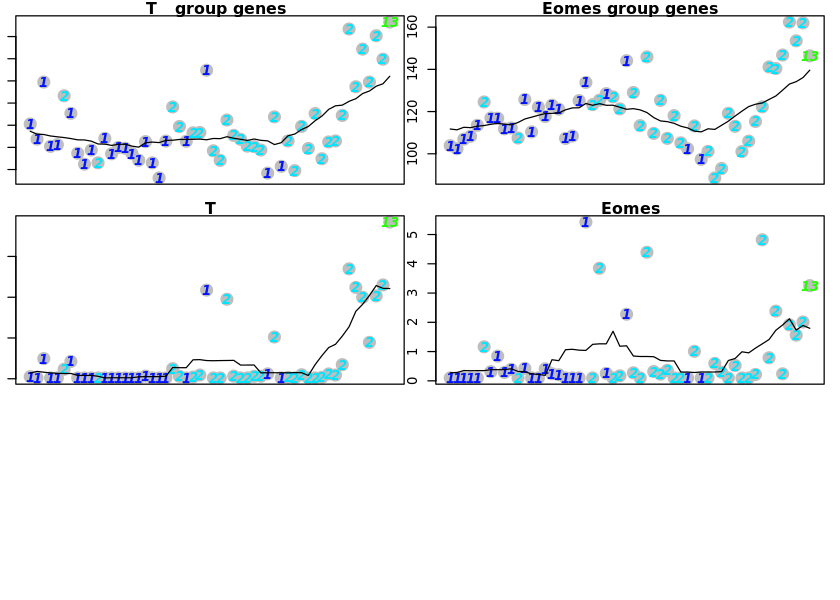

In [706]:
trajExplore(c(1,2,13))

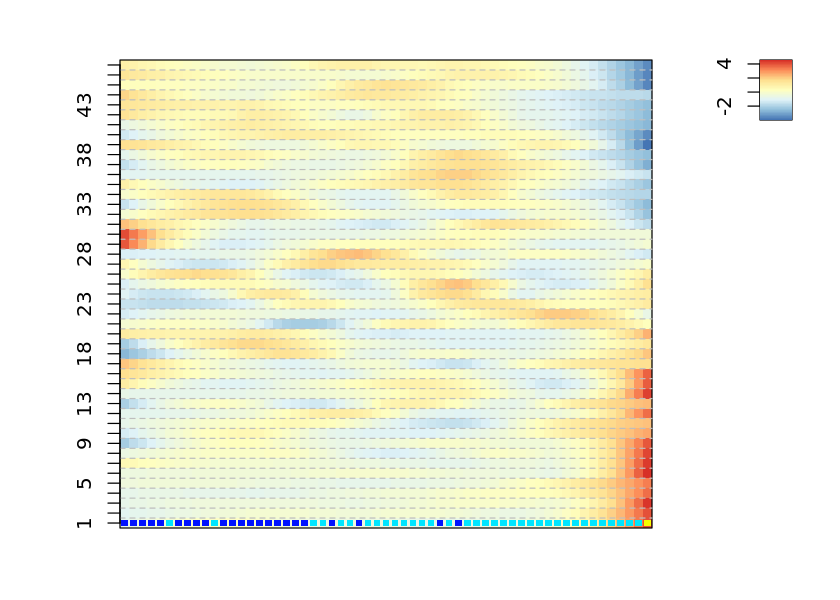

,Node,Num,Genes in same node
T,28,95,"Aars, Abi2, Acat2, Ahsa1, Aldh9a1, Anapc5, Arf1, Atp5b, Atp5g3, Basp1, Cacybp, Caprin1, Car2, Cbx2, Ccnt1, Cct3, Cct5, Ctdsp2, Cyb5a, Cyp26a1, Ddx27, Dgkk, Dnaja1, Dnajc8, Eftud2, Eif3e, Eif4a3, Eomes, Fgf4, Fgf5, Fn1, Frzb, Galk1, Gas1, Gnai2, Golga4, Got2, Gpbp1, Hmga1-rs1, Hras, Hypk, Idh3g, Igf2bp3, Igfbp2, Ilf2, Impdh2, Ireb2, Isyna1, Maea, Map2k2, Mllt10, Morf4l1, Mrfap1, Nol7, Nsa2, Nsmce4a, Nudcd2, Nup62, Orc3, Pdha1, Pgk1, Ppp1cc, Ppp1r14b, Prpf31, Psmc1, Psmd8, Rapgef1, Rep15, Rspo3, Rybp, Sde2, Sema6a, Sesn3, Setd8, Slc16a3, Slc3a2, Smc4, Smc6, Sod1, Sox9, Spop, Srpk1, Srsf2, T, Tcerg1, Tdgf1, Tead2, Tnks2, Trp53i11, Tti1, Ube2n, Ube2r2, Uck2, Uqcrc2, Zranb2"
Eomes,28,95,"Aars, Abi2, Acat2, Ahsa1, Aldh9a1, Anapc5, Arf1, Atp5b, Atp5g3, Basp1, Cacybp, Caprin1, Car2, Cbx2, Ccnt1, Cct3, Cct5, Ctdsp2, Cyb5a, Cyp26a1, Ddx27, Dgkk, Dnaja1, Dnajc8, Eftud2, Eif3e, Eif4a3, Eomes, Fgf4, Fgf5, Fn1, Frzb, Galk1, Gas1, Gnai2, Golga4, Got2, Gpbp1, Hmga1-rs1, Hras, Hypk, Idh3g, Igf2bp3, Igfbp2, Ilf2, Impdh2, Ireb2, Isyna1, Maea, Map2k2, Mllt10, Morf4l1, Mrfap1, Nol7, Nsa2, Nsmce4a, Nudcd2, Nup62, Orc3, Pdha1, Pgk1, Ppp1cc, Ppp1r14b, Prpf31, Psmc1, Psmd8, Rapgef1, Rep15, Rspo3, Rybp, Sde2, Sema6a, Sesn3, Setd8, Slc16a3, Slc3a2, Smc4, Smc6, Sod1, Sox9, Spop, Srpk1, Srsf2, T, Tcerg1, Tdgf1, Tead2, Tnks2, Trp53i11, Tti1, Ube2n, Ube2r2, Uck2, Uqcrc2, Zranb2"


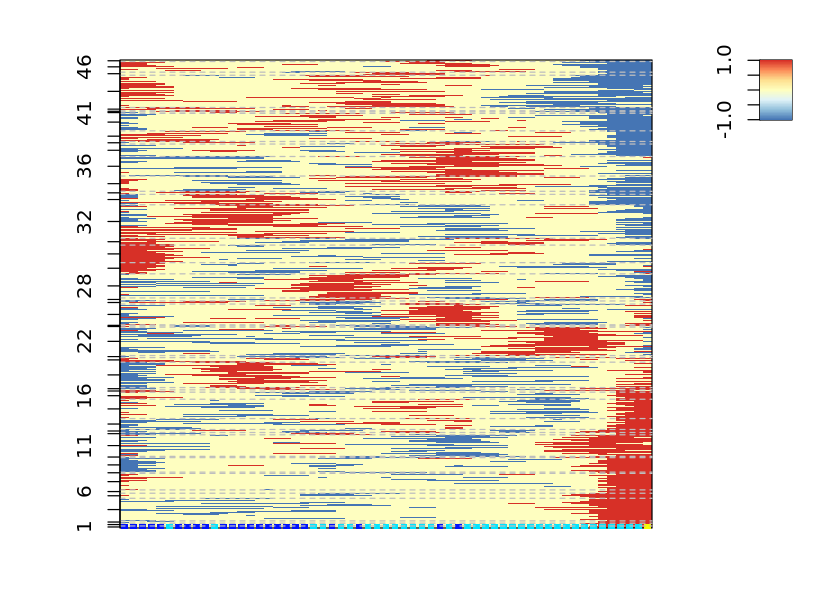

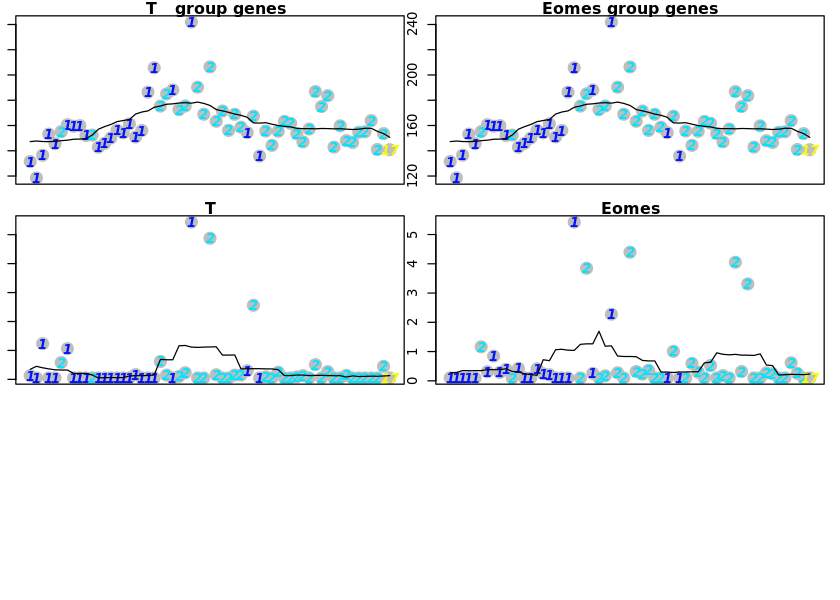

In [707]:
trajExplore(c(1,2,17))

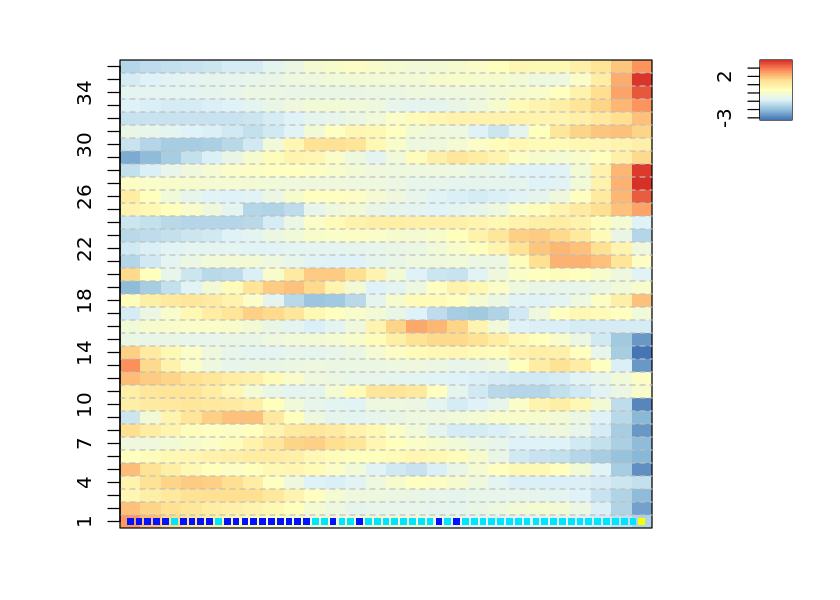

,Node,Num,Genes in same node
T,12,104,"Abcf1, Acp1, Amot, Amotl2, Ankrd11, Anp32b, Arid2, Bclaf1, Ccnd2, Cdc14b, Cebpz, Cited2, Ckap4, Ctcf, Cul3, Cxx1a|Cxx1b, Ddx24, Ddx3x, Dnajb6, Dock11, Dtl, Eif2s3x, Emb, Enah, Epha4, Eprs, Fn1, Frzb, Galnt1, Gja1, Gtf2i, Gusb, Hells, Hmga2, Hmgb3, Hnrnph1, Hnrnpr, Hoxb1, Kif5b, Lamb1, Lig1, Marcksl1, Mcm3, Meis2, Mixl1, Mphosph10, Mphosph8, Mrfap1, Ndufaf4, Nol8, Papola, Pdgfra, Pdha1, Pds5a, Peg3, Pmaip1, Pnn, Polr2m, Prpf4b, Prtg, Psmd1, Purb, Rbbp6, Rdx, Rps6ka6, Rrm2, Serp1, Setd5, Sf3b1, Sfxn1, Slbp, Smarcc1, Smu1, Snx3, Snx5, Snx6, Sox11, Srsf11, Srsf2, Srsf5, Strap, Stt3b, T, Tab2, Tceal8, Tcerg1, Tmed10, Tmem165, Tmem234, Top1, Tpr, Trip12, Tsc22d1, Ube2d2a, Ubxn4, Uhrf2, Ung, Usp10, Whsc1, Ythdc1, Zfp292, Zfp322a, Zfp644, Zranb2"
Eomes,4,50,"Abi2, Aldh9a1, Aldoa, Apoe, Atp5a1, Atp6v1b2, Bnip3l, Braf, Cct2, Cct7, Csnk1a1, Ctbp1, Ctsl, Dars, Dnajc2, Eef2, Egln1, Eif4b, Eif5b, Eomes, Evx1, Gm3839, Got2, Gpi1, Grsf1, Hax1, Helz, Lef1, Lsm14a, Myo10, Nucb1, Nup205, Ptbp1, Ptp4a2, Pum1, Rab2a, Rbbp7, Rspo3, Sdha, Sema6a, Smc2, Smc3, Smc6, Tcf7l2, Tnks2, Uba1, Usp7, Vps35, Xrn2, Ybx1"


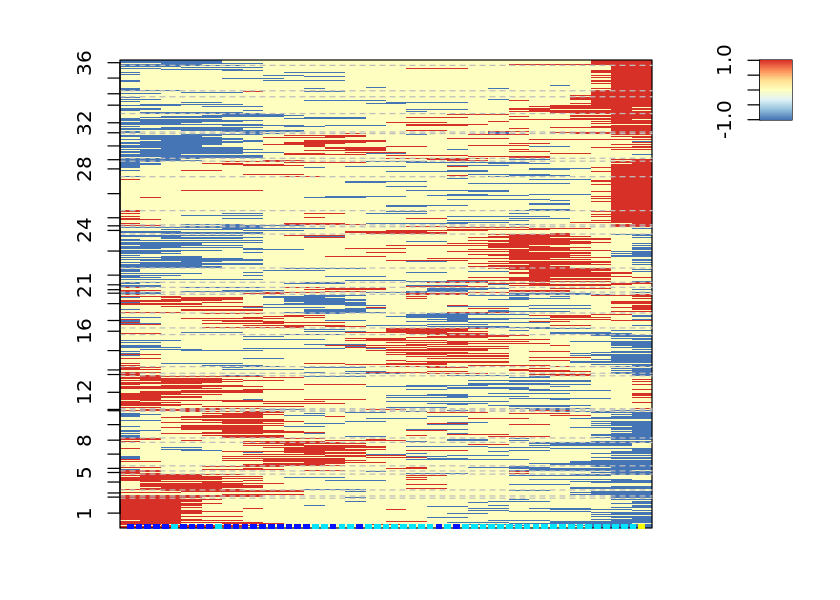

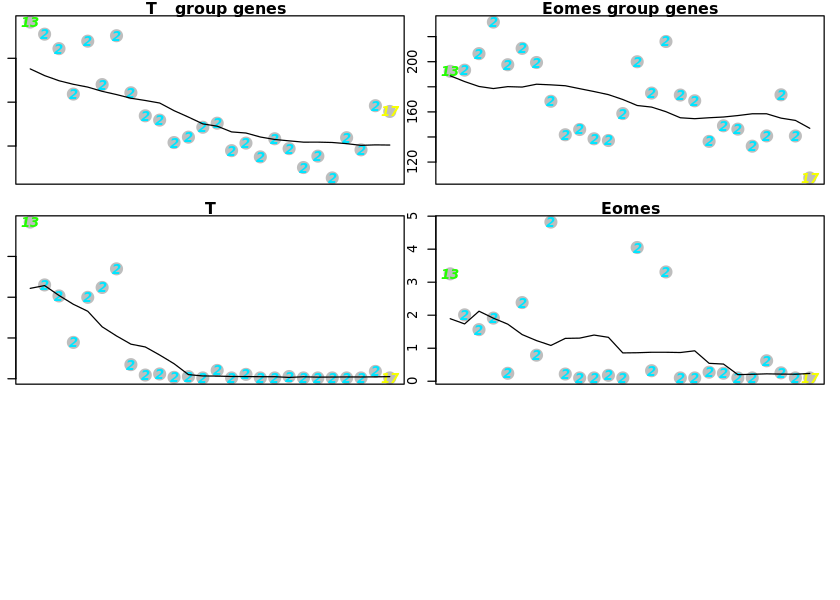

In [708]:
trajExplore(c(13, 2, 17))

### Moderate branches

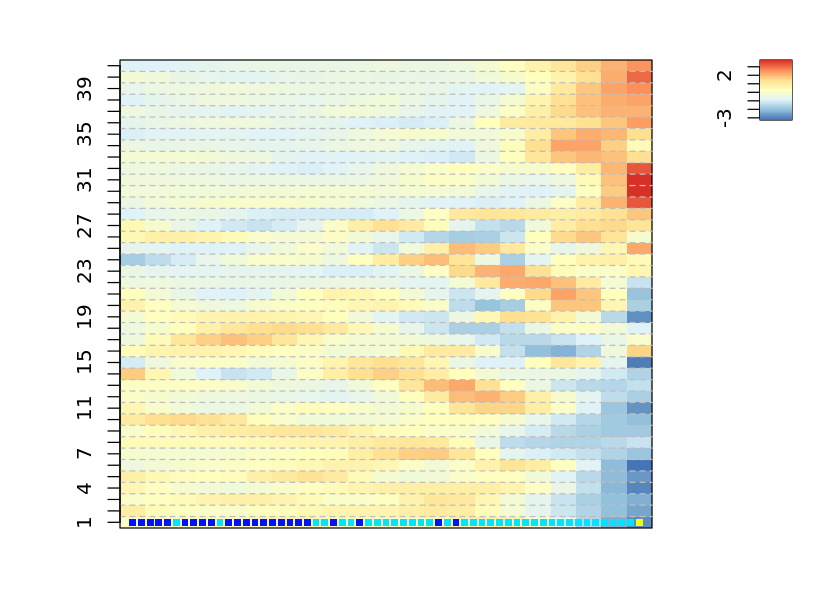

,Node,Num,Genes in same node
T,31,70,"Abhd17b, Ahctf1, Amotl2, Api5, Arl6ip1, Asnsd1, Atf1, Bbip1, BC023829, Bfar, Birc5, Bmi1, Caap1, Ccng1, Cd2ap, Cenpw, Chd6, Csnk1g3, Cst3, Ctnna1, Cul3, Dhx36, Dnajc9, Dnm1l, Eny2, Espl1, H3f3b, Higd2a, Hoxa1, Ifitm3, Klhl24, Lbr, Lgalsl, Lman1, Lrp6, Mcm6, Mettl7a3, Mgea5, Nck1, Ndufc1, Nubp1, Otud4, Parl, Pcgf5, Pdcd5, Pomp, Ppp1cb, Prim1, Psma5, Rab11b, Rad21, Rala, Rpl21, Rtn4, Shfm1, Slc38a4, Spc25, Spcs1, Stt3b, Suv420h1, Suz12, T, Tacc3, Thoc3, Tmeff1, Ubr5, Uqcrq, Xpot, Zfand6, Zmat3"
Eomes,17,116,"Abi2, Aco2, Akap9, Apela, Apoe, Arhgef2, Atp6v1b2, Atxn2l, Aurka, AW549877, Basp1, Bnip3l, Brd3, Bub1, Car2, Car4, Cbl, Ccna2, Cct2, Cdc123, Cebpz, Clic4, Cops4, Csnk1d, Csnk2b, Dad1, Ddx17, Dnajc8, Dtx3, Ebna1bp2, Eif3e, Eif4b, Eif5, Eif5b, Eomes, Fbl, Fbxo5, Fiz1, Fst, Glg1, Glyr1, Gmps, Gnpat, Golga4, Got2, Gpd2, Gtf2f1, Hdlbp, Helz, Hprt, Igf1r, Incenp, Ktn1, L1td1, Lamp1, Larp1, Larp7, Lig1, Luc7l3, Mesdc2, Mis18bp1, Mkrn1, Mphosph8, Msh2, Naa15, Nnat, Nol7, Nop58, Npepps, Nudt21, Ola1, Pfdn6, Pnisr, Pnrc1, Ppat, Pphln1, Ppig, Ppp1cc, Ppp1r15b, Ppp2ca, Prpf38b, Psme3, Rbm25, Rbpms, Rfc1, Rhoa, Rpl3, Scaf11, Sf3b1, Smc3, Snhg14, Snhg5, Sp1, Strbp, Swi5, Syce2, Tars, Tcea1, Tcerg1, Tdgf1, Tdh, Tmbim6, Tmem11, Trh, Trp53, Ubap2l, Ube2r2, Ubqln1, Uhrf2, Upf3b, Wapl, Xrn2, Yap1, Ybx1, Zfp106, Zmynd8"


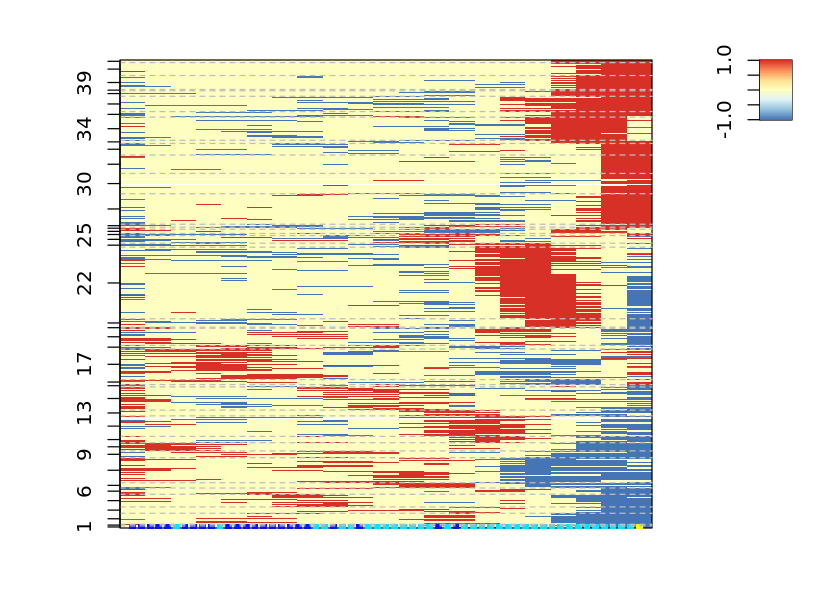

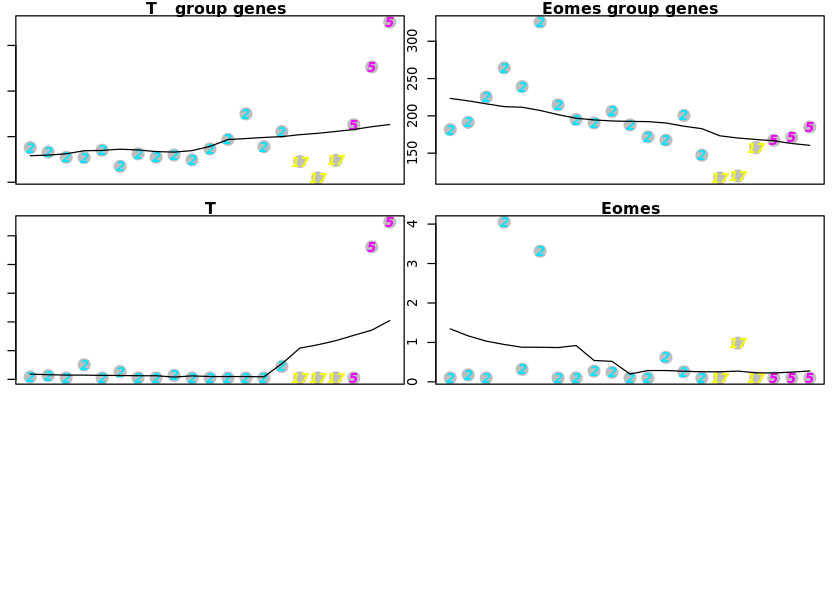

In [709]:
trajExplore(c(2, 17, 5))

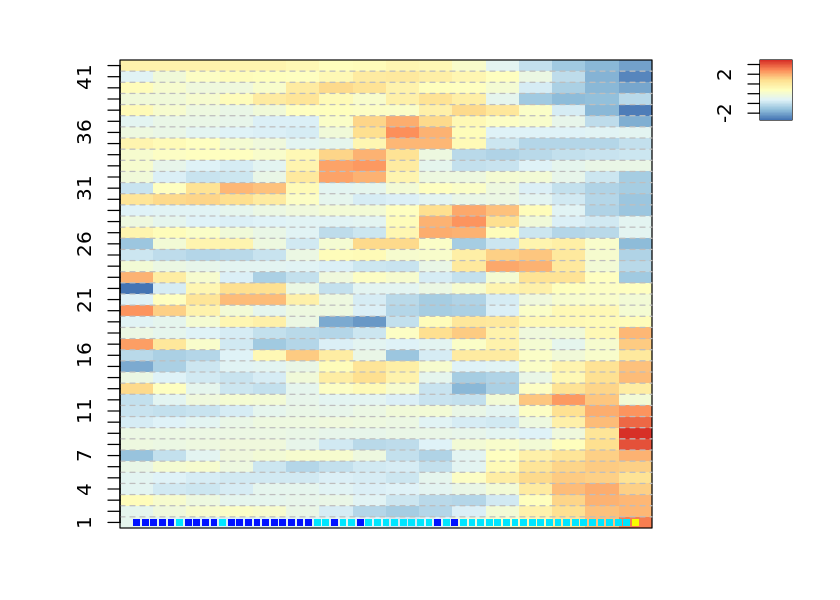

,Node,Num,Genes in same node
T,21,198,"Actn1, Appbp2, Arl6ip4, Asf1a, Atp6v1b2, Atxn7l3b, Bub1, Cct6a, Clic4, Cops7a, Csnk1d, Cul2, Ddx17, Ddx19a, Dennd5b, Ehmt1, Eif4a2, Ghitm, Gja1, Glud1, Gmnn, Gnl3, Grb10, Hcfc1, Helz, Hmga2, Hprt, Iars, Larp1, Mapk1, Mrpl35, Msh6, Mta2, Mtmr4, Ncor1, Ola1, Parn, Pbx1, Pdia3, Polr1d, Puf60, Rac1, Rad23b, Rbm25, Rtf1, Scd2, Seh1l, Sf3b4, Snrpn, Srsf2, Strap, Suz12, Tmed10, Topbp1, Trp53, Ubqln1, Ubr5, Wdr3, Wdr5, Wnk1, Yap1, 1110038B12Rik, 2810474O19Rik, Abce1, Armc1, Arpc5l, Atf4, Atp5g1, Atp6v1a, Bclaf1, Cd63, Cdc123, Cdv3, Chchd1, Clta, Crebbp, Csnk1a1, Cwf19l1, Cxxc5, Dact1, Drap1, Dstn, Eif3l, Eif4a3, Eif5, Etv1, Exosc2, Exosc7, Fam96b, Farsb, Fgf3, Fst, Gins2, Gltscr2, Hectd1, Hes7, Igfbp4, Ilf3, Jph4, Kdelr2, Kdm5a, Kpna6, Ktn1, Lef1, Mapre1, Mixl1, Ndufa10, Nedd8, Nrd1, Peg3, Pgam1, Pih1d1, Plekhg2, Pmaip1, Pphln1, Ppp1r12a, Psap, Psmc2, Ptp4a2, Purb, Rars, Rbm5, Rbp1, Rc3h2, Rpl7l1, Sept2, Setd5, Smc2, Smc3, Smc4, Smg1, Smu1, Spag5, Srp14, Srp68, Srrt, Tbcb, Tln1, Tmbim6, Tmed2, Tpm4, Tsen34, Txnl1, U2surp, Ubald1, Ubap2l, Ubr4, Vapa, Vps25, Ypel3, Ythdf2, Zfp217, Zmynd8, 2010107E04Rik, Akirin2, Capns1, Cbx3, Ccnb1, Cenpf, Clint1, Cnot8, Csnk2b, Cth, Cxx1a|Cxx1b, Dusp6, Fbl, Fkbp3, Got2, Gpc3, Hoxb1, Immp1l, Kif11, Laptm4b, M6pr, Mga, Ndufa12, Ppa1, Prkra, Psma4, Pum1, Rab11b, Rabggtb, Rai14, Rasl11a, Rnf20, Rnf34, Samhd1, Smpd4, Snx6, Stmn1, T, Tab2, Tbl1x, Tle3, Top2a, Ube2b, Wdr36, Wtap"
Eomes,31,94,"2810004N23Rik, Anapc11, Anp32a, Atad3a, Atp5e, Bivm, Blmh, Casp8ap2, Ccnf, Ccni, Cct5, Ctdspl2, Denr, Dnajb1, Dnajc7, Dnajc8, Ecd, Emc7, Esf1, Frzb, Gcn1l1, Hnrnpc, Hsp90ab1, Hspbp1, Immt, Lage3, Map1s, Map2k2, Mcm2, Mcm7, Med28, Mrps17, Mrps22, Nip7, Nudt14, Pafah1b1, Pdgfra, Phgdh, Phlda2, Pkm, Plp2, Pmf1, Ppme1, Prkcsh, Rbbp6, Rps9, Rrm1, Rrp1, Rwdd1, Serf2, Set, Siva1, Six5, Sltm, Snrnp48, Srpk1, Szrd1, Tdgf1, Tia1, Tpr, Trappc12, Ubn1, Ubr2, Uqcrc1, Vars, Xpo1, Ybx1, Zc3h4, Zfp266, Zfp428, Zmat2, Arhgdia, Atp5g3, Csde1, Eomes, Glrx5, Las1l, Mea1, Mrps27, Ngfrap1, Nop2, Pcgf2, Polr1c, Prpf40a, Psmc4, Rapgef6, Rbpms, Sf1, Sp5, Srm, Stag1, Tkt, Tmem234, Utp18"


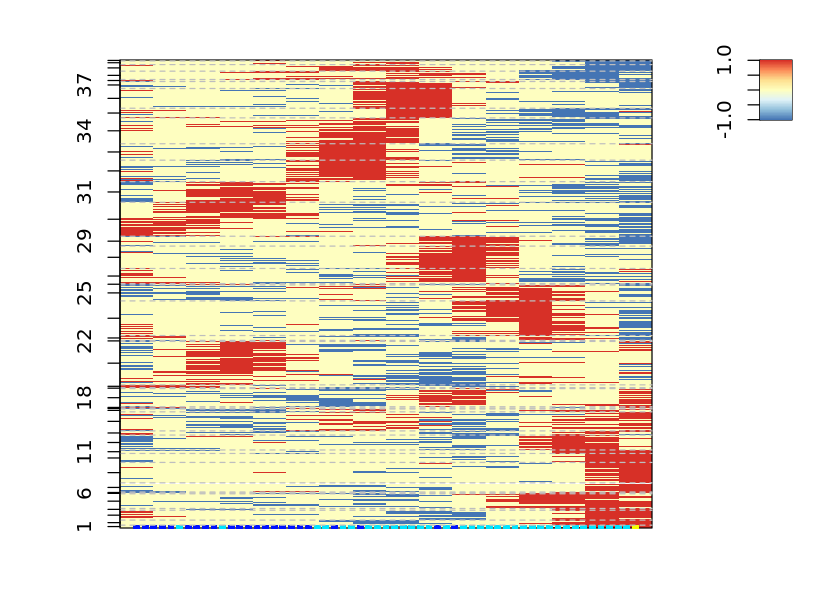

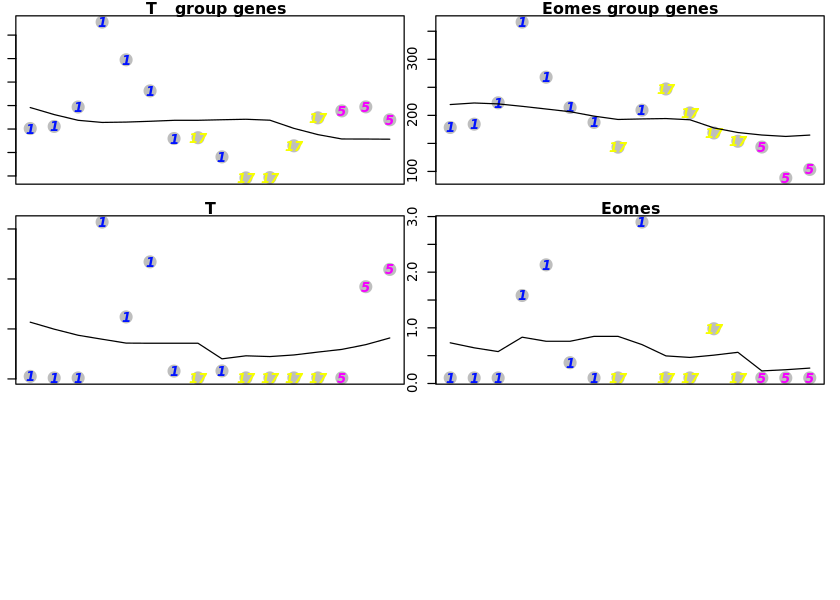

In [710]:
trajExplore(c(1, 17, 5))

Warning message in rbind(...):
“number of columns of result is not a multiple of vector length (arg 2)”

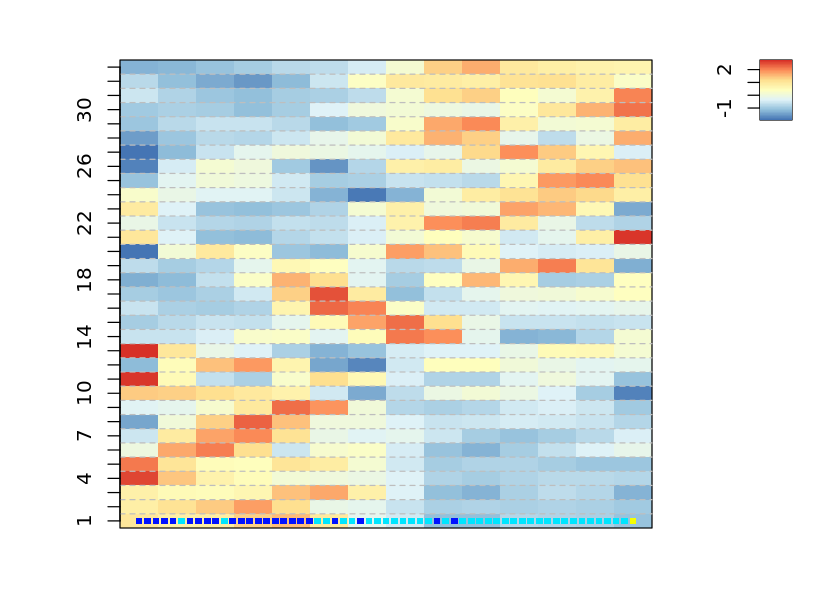

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


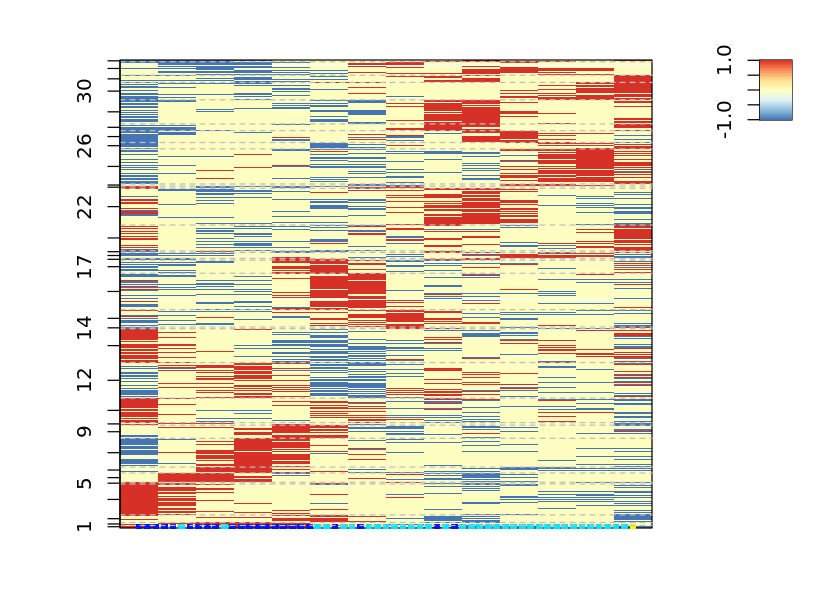

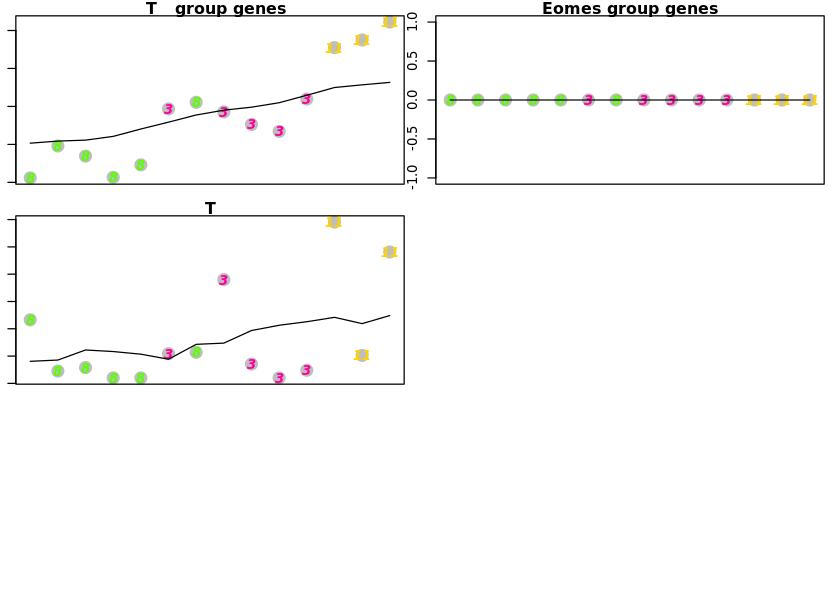

In [712]:
trajExplore(c(8, 3, 11))

Warning message in rbind(...):
“number of columns of result is not a multiple of vector length (arg 1)”

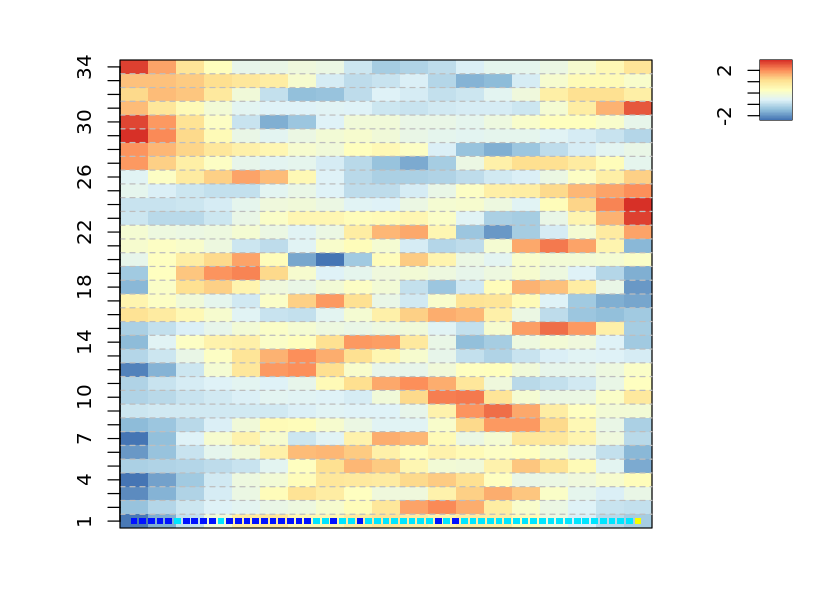

,Node,Num,Genes in same node
T,0,,0
Eomes,14,21,"Baz1b, Ctbp2, Ddx18, Eif4b, Eomes, Gnl3, Iars, Ik, Khdrbs1, L1td1, Mat2a, Mta2, Nap1l1, Pabpc1, Pgm2, Srpk1, Syncrip, Tcea1, U2surp, Zfp36l2, Zfp644"


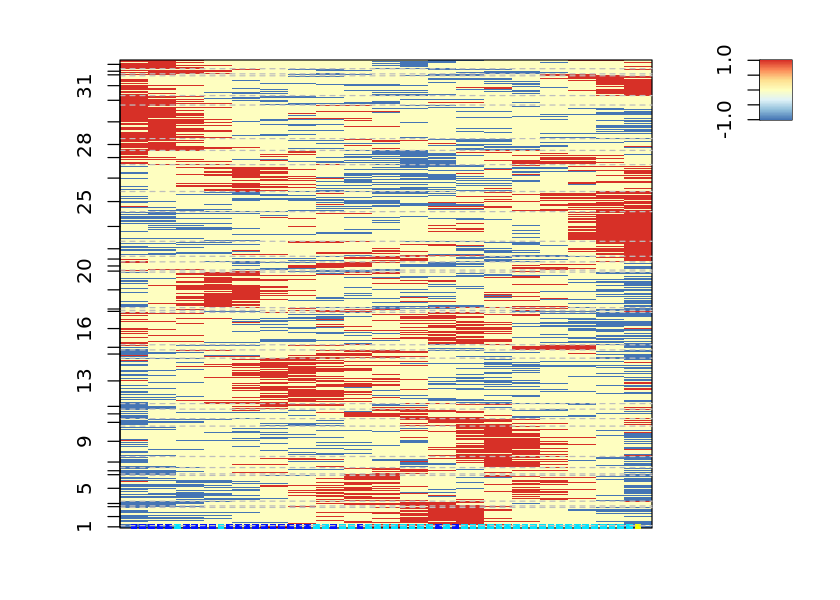

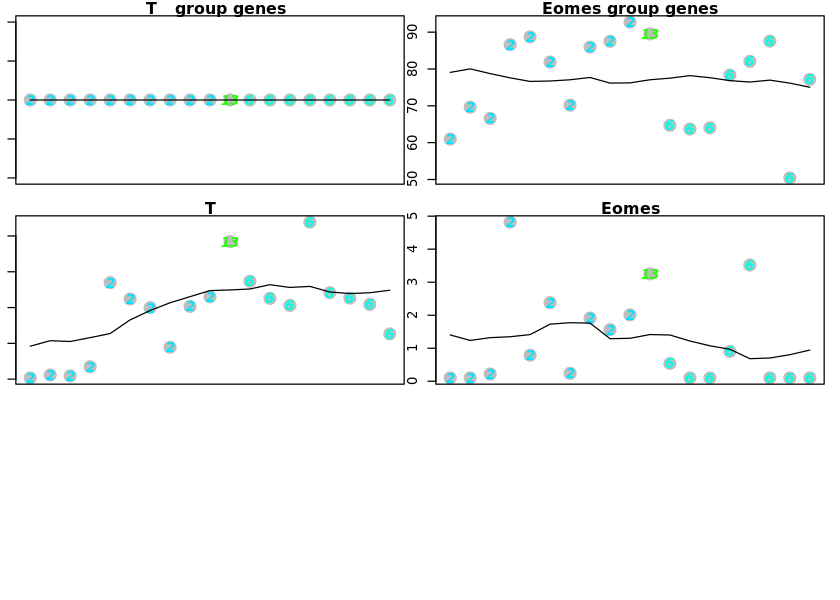

In [711]:
trajExplore(c(2, 13, 6)) # fails...

### Weak branches

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = p

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = de

“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degr

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in sim

“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1006”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.975”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.025”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

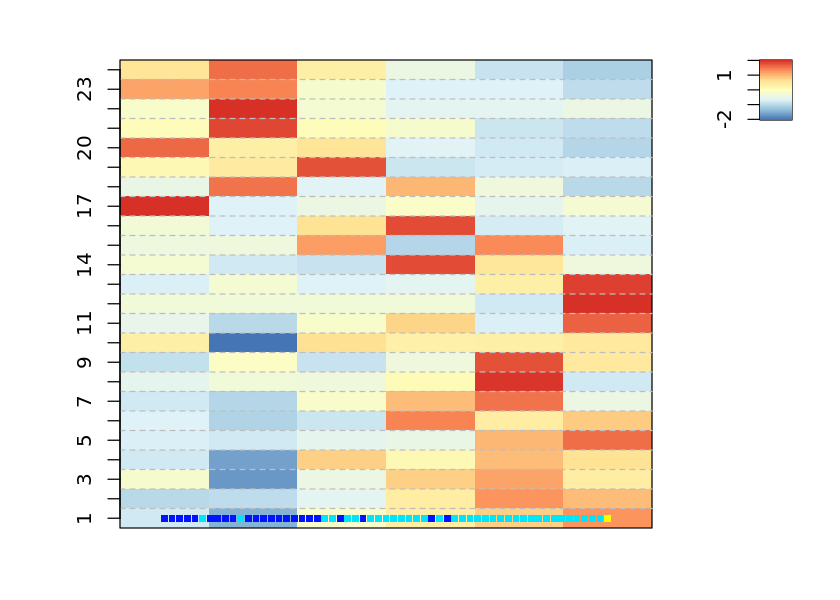

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


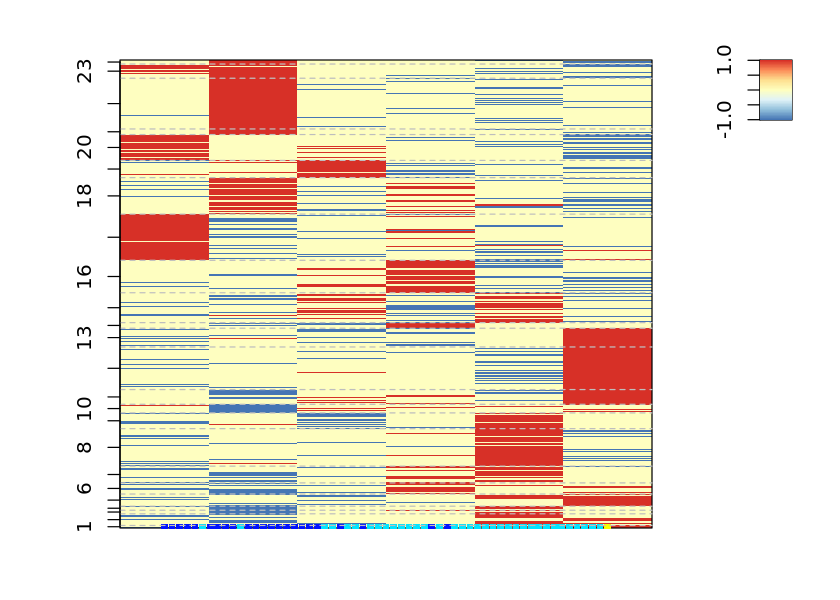

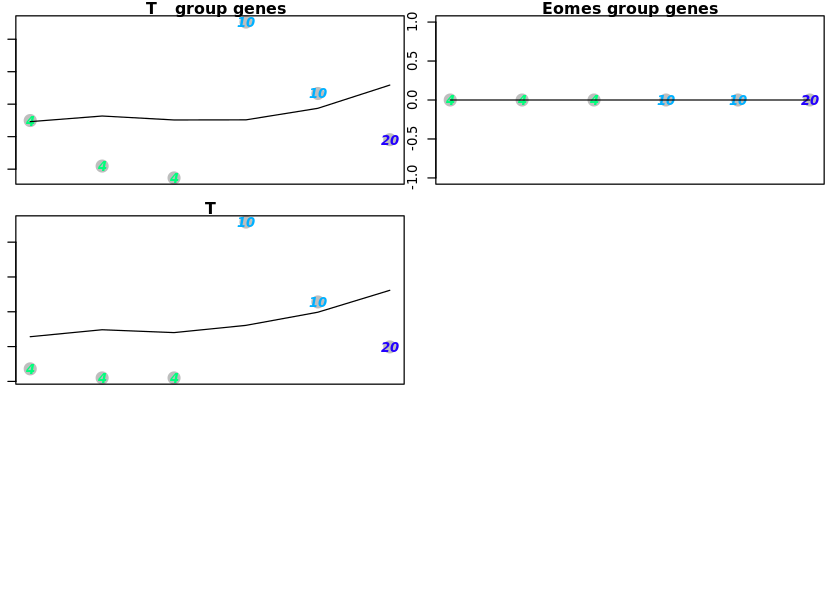

In [713]:
# Not enough values, failed to converge....
trajExplore(c(4, 10, 20))

Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = para

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degre

“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpl

“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“There are other near singularities as well. 4.1209”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“span too small.   fewer data values than degrees of freedom.”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“pseudoinverse used at 0.97”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“neighborhood radius 2.03”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, :
“reciprocal condition number  0”Warning message in simpleLoess(y, x, w, span, degree = degree, parametric = parametr

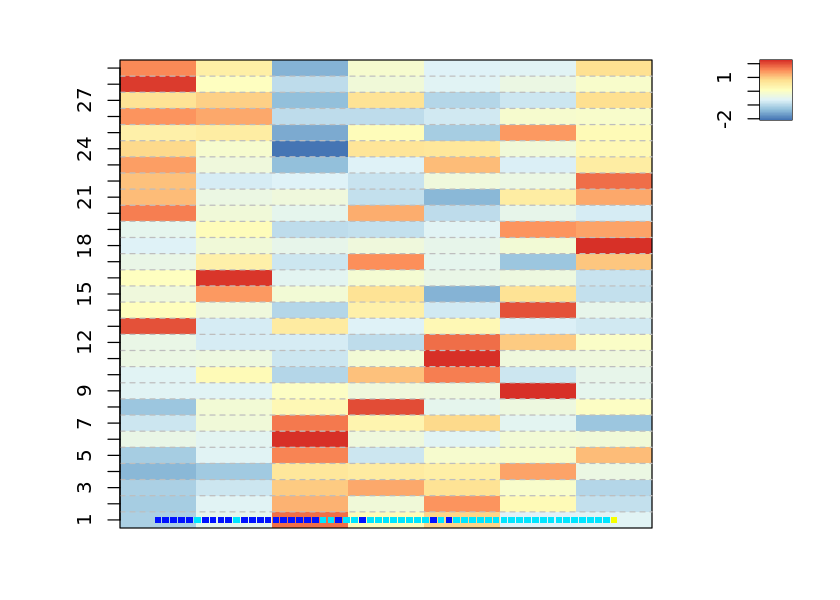

Warning message in min(x):
“no non-missing arguments to min; returning Inf”Warning message in max(x):
“no non-missing arguments to max; returning -Inf”

ERROR: Error in plot.window(...): need finite 'ylim' values


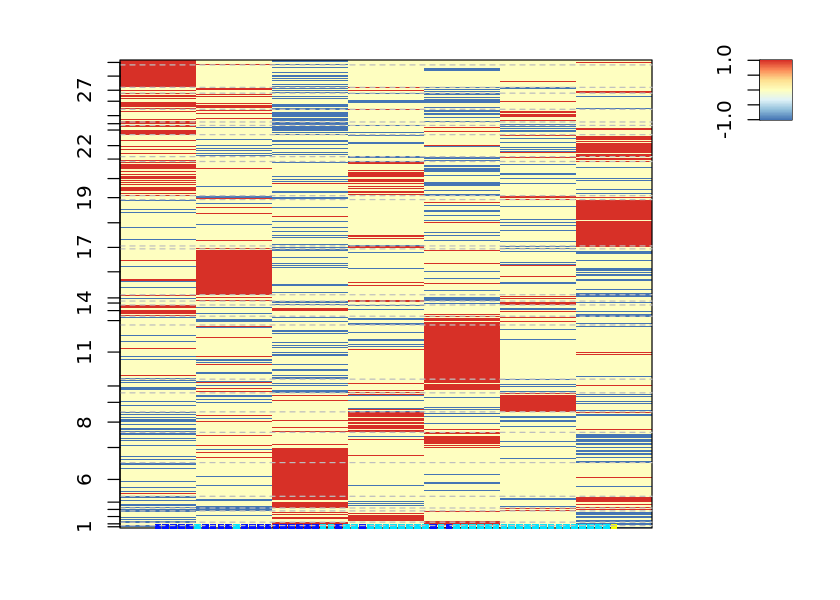

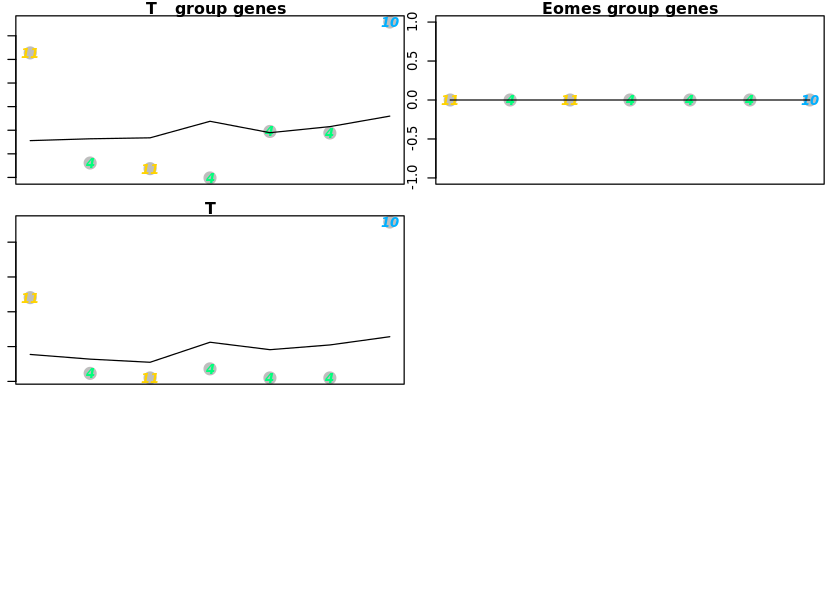

In [714]:
# Also not enough values, failed to converge....
trajExplore(c(11, 4, 10))